# 1. Introduction

Most sections in this notebook align with the corresponding sections in the report. The Ablation Studies (Section 3.3) require code from Section 4 of the notebook; therefore, they have been moved to Section 5.1 in the notebook.

# 2. Data Import

## 2.1 Import Libraries

In [1]:
# Install required Python libraries
# !pip install numpy pandas matplotlib seaborn scikit-learn tqdm torch pytorch-tabnet xgboost lightgbm catboost tensorflow pickle5 optuna
# !pip install -qq pytorch_tabnet

In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

## 2.2 Data Loading

In [3]:
# Define the file path root dir
data_dir = "data/"
model_dir = "model/"

In [4]:
training_data = pd.read_csv(os.path.join(data_dir, "epl-training.csv"))
training_data

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HST,AST,HC,AC,HF,AF,HY,AY,HR,AR
0,19/08/2000,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,14.0,4.0,6.0,6.0,13.0,12.0,1.0,2.0,0.0,0.0
1,19/08/2000,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,10.0,5.0,7.0,7.0,19.0,14.0,1.0,2.0,0.0,0.0
2,19/08/2000,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,3.0,9.0,8.0,4.0,15.0,21.0,5.0,3.0,1.0,0.0
3,19/08/2000,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,4.0,6.0,5.0,8.0,11.0,13.0,1.0,1.0,0.0,0.0
4,19/08/2000,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,8.0,6.0,6.0,4.0,21.0,20.0,1.0,3.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9216,19/05/2024,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,9.0,2.0,10.0,8.0,2.0,4.0,1.0,4.0,0.0,0.0
9217,19/05/2024,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,14.0,3.0,14.0,11.0,10.0,2.0,1.0,1.0,0.0,1.0
9218,19/05/2024,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,6.0,7.0,15.0,20.0,4.0,4.0,5.0,4.0,0.0,0.0
9219,19/05/2024,Man City,West Ham,3.0,1.0,H,2.0,1.0,H,J Brooks,...,12.0,2.0,3.0,12.0,11.0,2.0,0.0,1.0,0.0,0.0


In [5]:
test_data = pd.read_csv(os.path.join(data_dir, "epl-test.csv"))
test_data

,Date,HomeTeam,AwayTeam
0,01-Feb-25,AFC Bournemouth,Liverpool
1,01-Feb-25,Arsenal,Man City
2,01-Feb-25,Brentford,Spurs
3,01-Feb-25,Chelsea,West Ham
4,01-Feb-25,Everton,Leicester City
5,01-Feb-25,Ipswich Town,Southampton
6,01-Feb-25,Man Utd,Crystal Palace
7,01-Feb-25,Newcastle,Fulham
8,01-Feb-25,Nottingham Forest,Brighton
9,01-Feb-25,Wolves,Aston Villa


# 3. Data Transformation & Exploration

## 3.1 Data Cleaning

In [6]:
training_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9221 entries, 0 to 9220
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Date      9220 non-null   object 
 1   HomeTeam  9220 non-null   object 
 2   AwayTeam  9220 non-null   object 
 3   FTHG      9220 non-null   float64
 4   FTAG      9220 non-null   float64
 5   FTR       9220 non-null   object 
 6   HTHG      9220 non-null   float64
 7   HTAG      9220 non-null   float64
 8   HTR       9220 non-null   object 
 9   Referee   9220 non-null   object 
 10  HS        9220 non-null   float64
 11  AS        9220 non-null   float64
 12  HST       9220 non-null   float64
 13  AST       9220 non-null   float64
 14  HC        9220 non-null   float64
 15  AC        9220 non-null   float64
 16  HF        9220 non-null   float64
 17  AF        9220 non-null   float64
 18  HY        9220 non-null   float64
 19  AY        9220 non-null   float64
 20  HR        9220 non-null   floa

In [7]:
training_data[training_data.isnull().any(axis=1)]

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HST,AST,HC,AC,HF,AF,HY,AY,HR,AR
5700,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
training_data = training_data.dropna()
training_data

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HST,AST,HC,AC,HF,AF,HY,AY,HR,AR
0,19/08/2000,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,14.0,4.0,6.0,6.0,13.0,12.0,1.0,2.0,0.0,0.0
1,19/08/2000,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,10.0,5.0,7.0,7.0,19.0,14.0,1.0,2.0,0.0,0.0
2,19/08/2000,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,3.0,9.0,8.0,4.0,15.0,21.0,5.0,3.0,1.0,0.0
3,19/08/2000,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,4.0,6.0,5.0,8.0,11.0,13.0,1.0,1.0,0.0,0.0
4,19/08/2000,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,8.0,6.0,6.0,4.0,21.0,20.0,1.0,3.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9216,19/05/2024,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,9.0,2.0,10.0,8.0,2.0,4.0,1.0,4.0,0.0,0.0
9217,19/05/2024,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,14.0,3.0,14.0,11.0,10.0,2.0,1.0,1.0,0.0,1.0
9218,19/05/2024,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,6.0,7.0,15.0,20.0,4.0,4.0,5.0,4.0,0.0,0.0
9219,19/05/2024,Man City,West Ham,3.0,1.0,H,2.0,1.0,H,J Brooks,...,12.0,2.0,3.0,12.0,11.0,2.0,0.0,1.0,0.0,0.0


In [9]:
# Check Team duplicates on the same day
print(training_data.duplicated(subset=['Date', 'HomeTeam']).sum())  # Should be 0
print(training_data.duplicated(subset=['Date', 'AwayTeam']).sum())  # Should be 0

100
100


In [10]:
# Drop duplicates
training_data = training_data.drop_duplicates(subset=['Date', 'HomeTeam', 'AwayTeam'])
training_data = training_data.drop_duplicates(subset=['Date', 'HomeTeam'])
training_data = training_data.drop_duplicates(subset=['Date', 'AwayTeam'])

print(training_data.duplicated(subset=['Date', 'HomeTeam']).sum())  # Should be 0
print(training_data.duplicated(subset=['Date', 'AwayTeam']).sum())  # Should be 0

0
0


In [11]:
# Sort by Date
training_data["Date"] = pd.to_datetime(training_data["Date"], format='mixed', dayfirst=True)
training_data = training_data.sort_values(by='Date').reset_index(drop=True)
training_data

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HST,AST,HC,AC,HF,AF,HY,AY,HR,AR
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,14.0,4.0,6.0,6.0,13.0,12.0,1.0,2.0,0.0,0.0
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,10.0,5.0,7.0,7.0,19.0,14.0,1.0,2.0,0.0,0.0
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,3.0,9.0,8.0,4.0,15.0,21.0,5.0,3.0,1.0,0.0
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,4.0,6.0,5.0,8.0,11.0,13.0,1.0,1.0,0.0,0.0
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,8.0,6.0,6.0,4.0,21.0,20.0,1.0,3.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Brighton,Man United,0.0,2.0,A,0.0,0.0,D,C Pawson,...,3.0,4.0,10.0,9.0,7.0,5.0,1.0,3.0,0.0,0.0
9116,2024-05-19,Brentford,Newcastle,2.0,4.0,A,0.0,3.0,A,S Hooper,...,5.0,7.0,15.0,11.0,3.0,0.0,4.0,4.0,0.0,0.0
9117,2024-05-19,Arsenal,Everton,2.0,1.0,H,1.0,1.0,D,M Oliver,...,5.0,2.0,8.0,11.0,8.0,1.0,4.0,3.0,0.0,0.0
9118,2024-05-19,Burnley,Nott'm Forest,1.0,2.0,A,0.0,2.0,A,G Scott,...,3.0,6.0,11.0,5.0,4.0,3.0,1.0,0.0,0.0,0.0


In [12]:
training_data.to_csv(os.path.join(data_dir, "epl-training-cleaned.csv"), index=False)

## 3.2 Time-based Analysis

In [13]:
training_data = training_data.copy()
training_data.loc[:, "Date"] = pd.to_datetime(training_data["Date"], dayfirst=True)
training_data

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HST,AST,HC,AC,HF,AF,HY,AY,HR,AR
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,14.0,4.0,6.0,6.0,13.0,12.0,1.0,2.0,0.0,0.0
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,10.0,5.0,7.0,7.0,19.0,14.0,1.0,2.0,0.0,0.0
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,3.0,9.0,8.0,4.0,15.0,21.0,5.0,3.0,1.0,0.0
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,4.0,6.0,5.0,8.0,11.0,13.0,1.0,1.0,0.0,0.0
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,8.0,6.0,6.0,4.0,21.0,20.0,1.0,3.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Brighton,Man United,0.0,2.0,A,0.0,0.0,D,C Pawson,...,3.0,4.0,10.0,9.0,7.0,5.0,1.0,3.0,0.0,0.0
9116,2024-05-19,Brentford,Newcastle,2.0,4.0,A,0.0,3.0,A,S Hooper,...,5.0,7.0,15.0,11.0,3.0,0.0,4.0,4.0,0.0,0.0
9117,2024-05-19,Arsenal,Everton,2.0,1.0,H,1.0,1.0,D,M Oliver,...,5.0,2.0,8.0,11.0,8.0,1.0,4.0,3.0,0.0,0.0
9118,2024-05-19,Burnley,Nott'm Forest,1.0,2.0,A,0.0,2.0,A,G Scott,...,3.0,6.0,11.0,5.0,4.0,3.0,1.0,0.0,0.0,0.0


In [14]:
training_data["Year"] = training_data["Date"].dt.year
training_data["Month"] = training_data["Date"].dt.month
training_data["Day"] = training_data["Date"].dt.day
training_data["Weekday"] = training_data["Date"].dt.weekday
training_data["IsWeekend"] = training_data["Weekday"].isin([5, 6])  # Saturday (5) and Sunday (6)

# Define seasons (assuming standard northern hemisphere seasons)
def assign_season(month):
    if month in [12, 1, 2]:
        return "Winter"
    elif month in [3, 4, 5]:
        return "Spring"
    elif month in [6, 7, 8]:
        return "Summer"
    else:
        return "Autumn"

training_data["Season"] = training_data["Month"].apply(assign_season)
training_data

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HY,AY,HR,AR,Year,Month,Day,Weekday,IsWeekend,Season
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,1.0,2.0,0.0,0.0,2000,8,19,5,True,Summer
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,1.0,2.0,0.0,0.0,2000,8,19,5,True,Summer
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,5.0,3.0,1.0,0.0,2000,8,19,5,True,Summer
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,1.0,1.0,0.0,0.0,2000,8,19,5,True,Summer
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,1.0,3.0,0.0,0.0,2000,8,19,5,True,Summer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Brighton,Man United,0.0,2.0,A,0.0,0.0,D,C Pawson,...,1.0,3.0,0.0,0.0,2024,5,19,6,True,Spring
9116,2024-05-19,Brentford,Newcastle,2.0,4.0,A,0.0,3.0,A,S Hooper,...,4.0,4.0,0.0,0.0,2024,5,19,6,True,Spring
9117,2024-05-19,Arsenal,Everton,2.0,1.0,H,1.0,1.0,D,M Oliver,...,4.0,3.0,0.0,0.0,2024,5,19,6,True,Spring
9118,2024-05-19,Burnley,Nott'm Forest,1.0,2.0,A,0.0,2.0,A,G Scott,...,1.0,0.0,0.0,0.0,2024,5,19,6,True,Spring


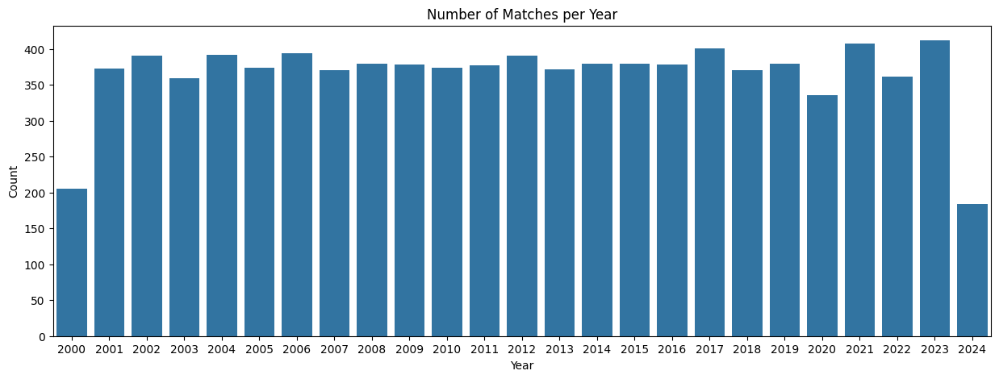

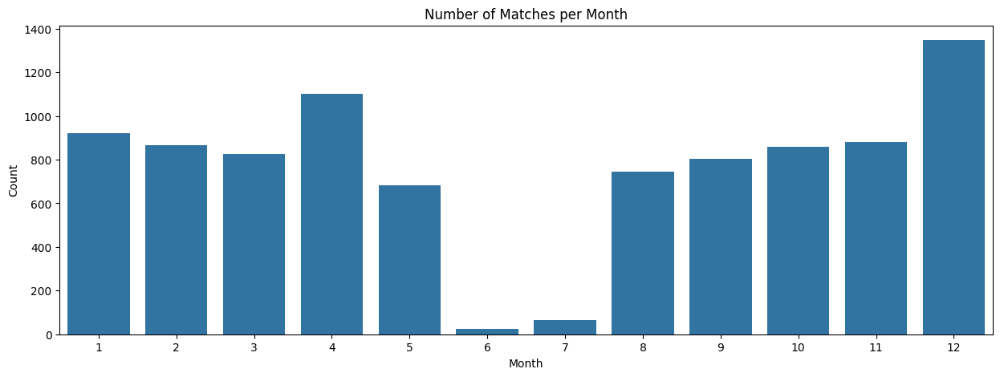

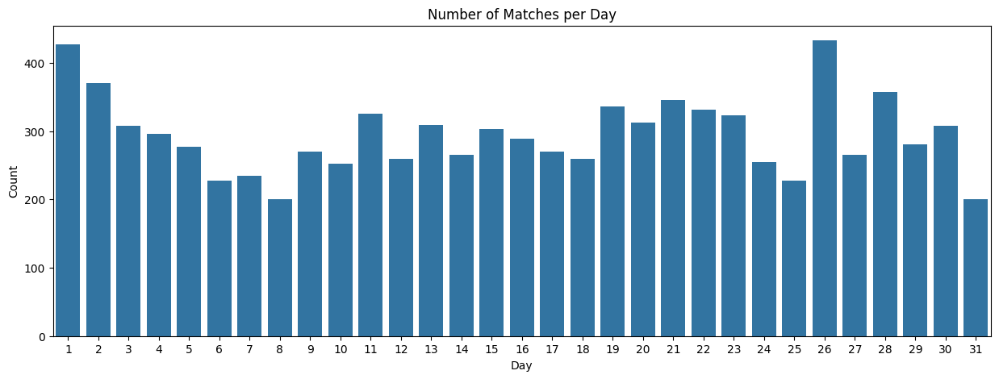

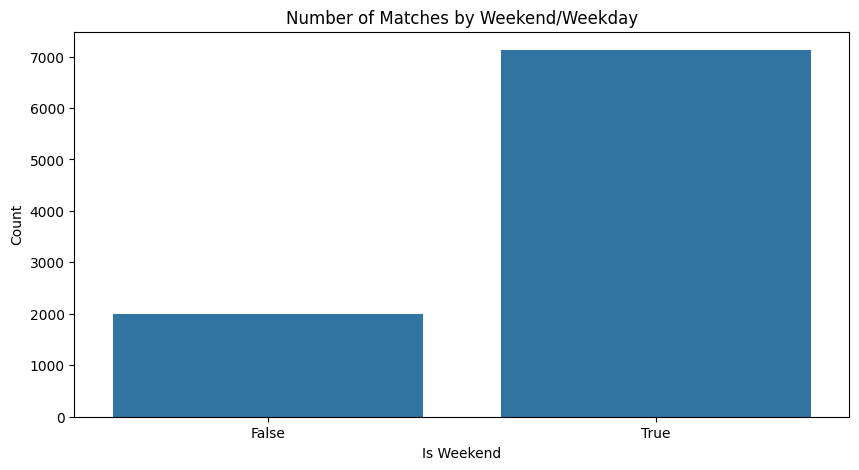

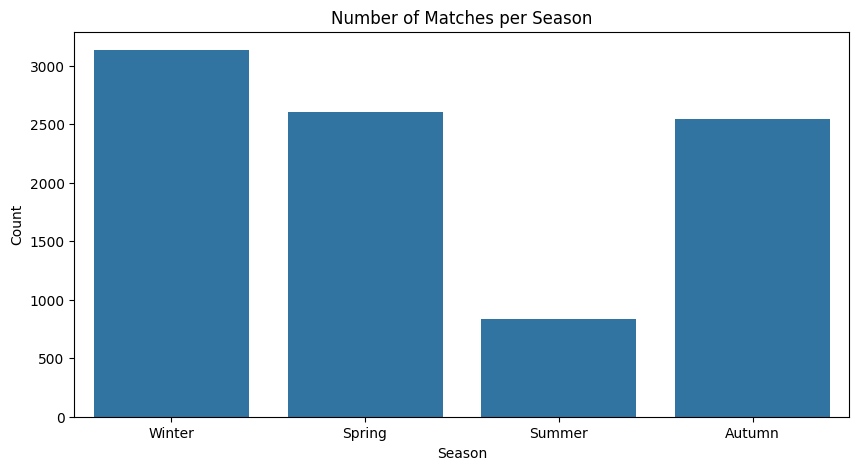

...

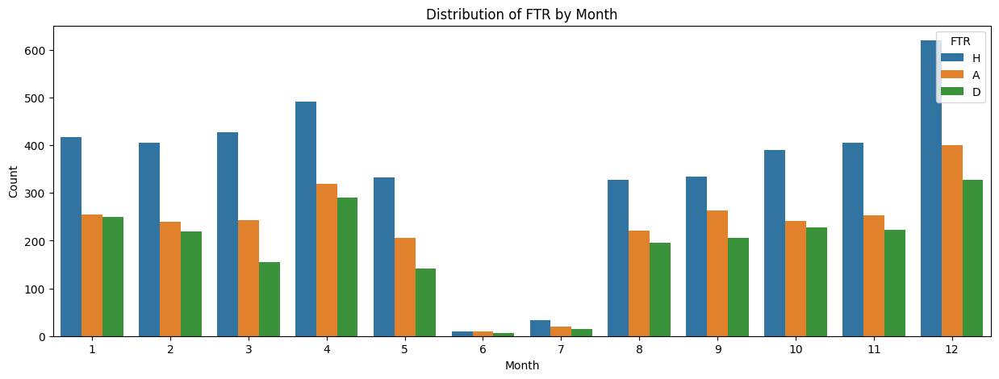

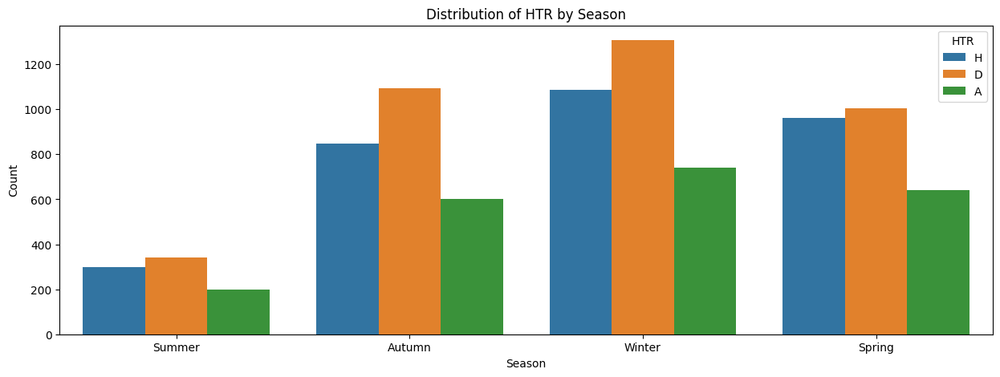

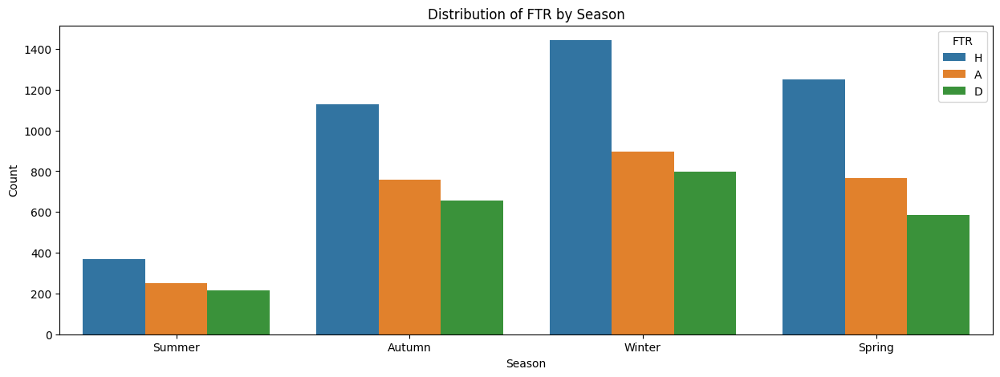

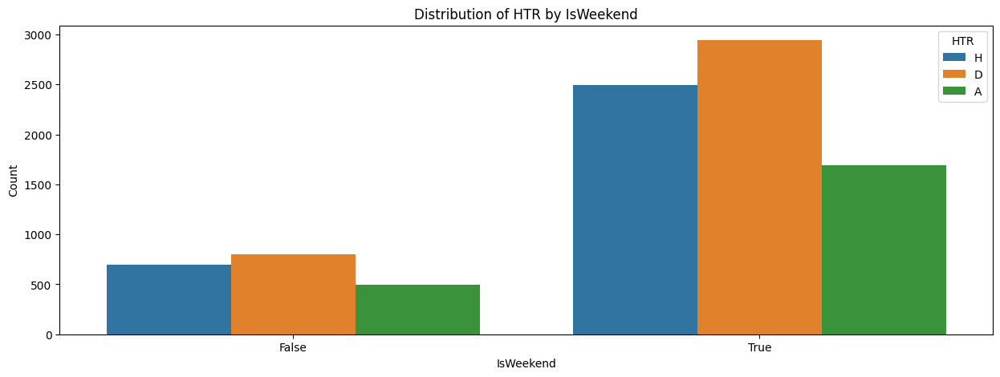

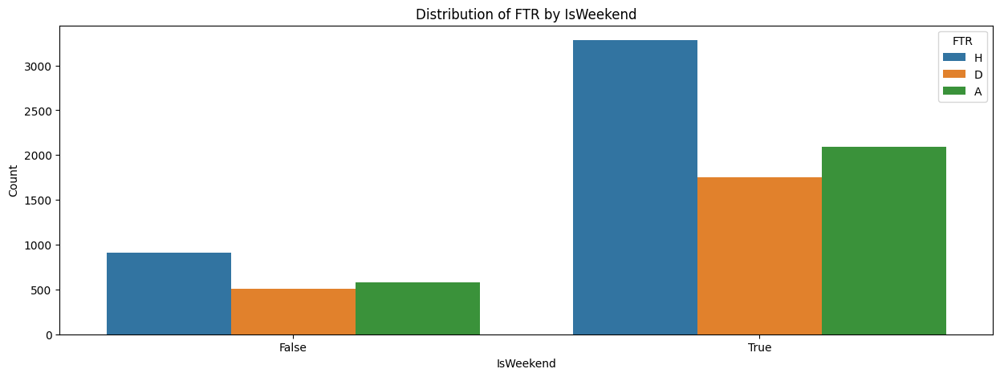

In [15]:
# Visualization: Number of matches per time dimension
plt.figure(figsize=(15, 5))
sns.countplot(data=training_data, x="Year", order=sorted(training_data["Year"].unique()))
plt.title("Number of Matches per Year")
plt.xlabel("Year")
plt.ylabel("Count")
plt.show()

plt.figure(figsize=(15, 5))
sns.countplot(data=training_data, x="Month", order=range(1, 13))
plt.title("Number of Matches per Month")
plt.xlabel("Month")
plt.ylabel("Count")
plt.show()

plt.figure(figsize=(15, 5))
sns.countplot(data=training_data, x="Day", order=range(1, 32))
plt.title("Number of Matches per Day")
plt.xlabel("Day")
plt.ylabel("Count")
plt.show()

plt.figure(figsize=(10, 5))
sns.countplot(data=training_data, x="IsWeekend")
plt.title("Number of Matches by Weekend/Weekday")
plt.xlabel("Is Weekend")
plt.ylabel("Count")
plt.show()

plt.figure(figsize=(10, 5))
sns.countplot(data=training_data, x="Season", order=["Winter", "Spring", "Summer", "Autumn"])
plt.title("Number of Matches per Season")
plt.xlabel("Season")
plt.ylabel("Count")
plt.show()

# Distribution of HTR and FTR for each time dimension
time_dimensions = ["Year", "Month", "Season", "IsWeekend"]

for dimension in time_dimensions:
    plt.figure(figsize=(15, 5))
    sns.countplot(data=training_data, x=dimension, hue="HTR")
    plt.title(f"Distribution of HTR by {dimension}")
    plt.xlabel(dimension)
    plt.ylabel("Count")
    plt.legend(title="HTR", loc="upper right")
    plt.show()

    plt.figure(figsize=(15, 5))
    sns.countplot(data=training_data, x=dimension, hue="FTR")
    plt.title(f"Distribution of FTR by {dimension}")
    plt.xlabel(dimension)
    plt.ylabel("Count")
    plt.legend(title="FTR", loc="upper right")
    plt.show()


## 3.3 Data Feature Analysis

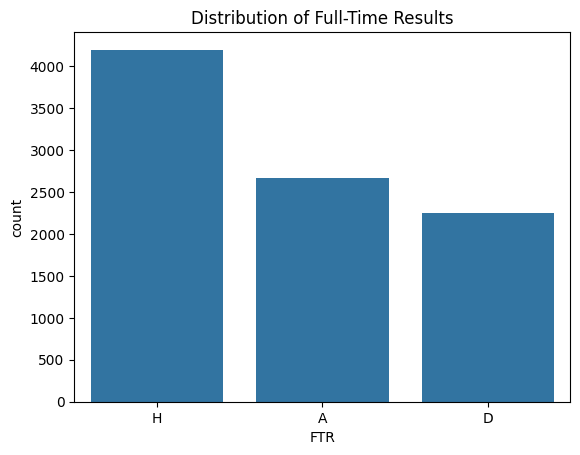

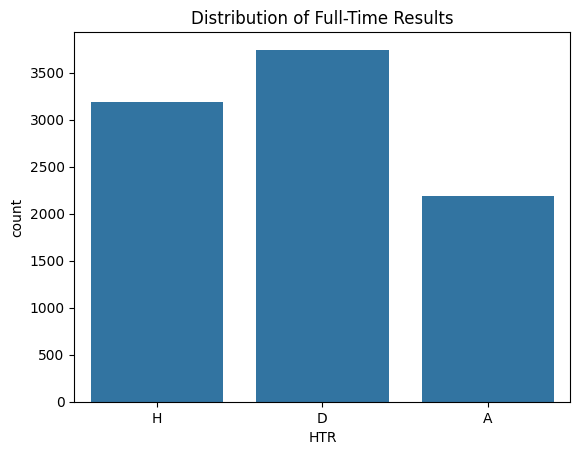

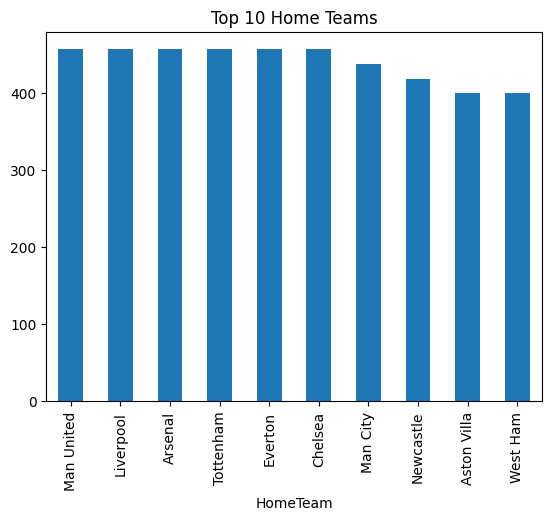

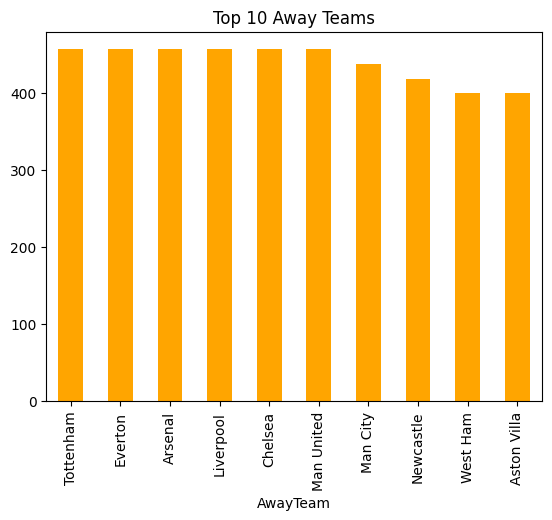

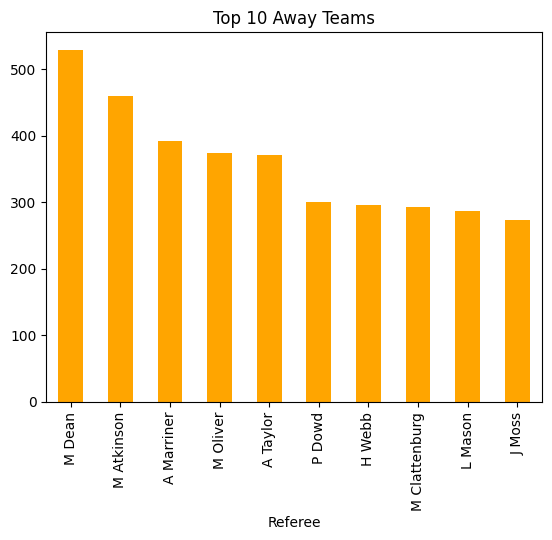

In [16]:
# Plot distribution of FTR (Full-Time Result)
sns.countplot(data=training_data, x="FTR")
plt.title("Distribution of Full-Time Results")
plt.show()

# Plot distribution of HTR (Half-Time Result)
sns.countplot(data=training_data, x="HTR")
plt.title("Distribution of Full-Time Results")
plt.show()

# Plot distribution of other categorical features
training_data["HomeTeam"].value_counts().head(10).plot(kind="bar")
plt.title("Top 10 Home Teams")
plt.show()

training_data["AwayTeam"].value_counts().head(10).plot(kind="bar", color="orange")
plt.title("Top 10 Away Teams")
plt.show()

training_data["Referee"].value_counts().head(10).plot(kind="bar", color="orange")
plt.title("Top 10 Away Teams")
plt.show()

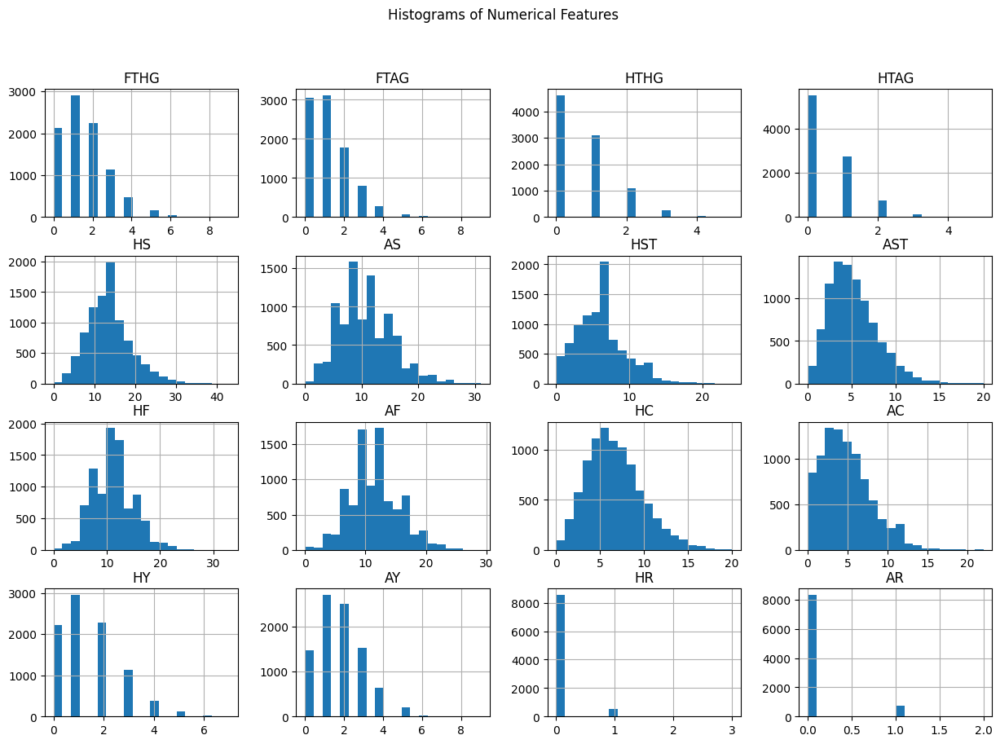

In [17]:
# Plot histograms for numerical features
numerical_cols = ['FTHG', 'FTAG', 'HTHG', 'HTAG', 'HS', 'AS', 'HST', 'AST', 'HF', 'AF', 'HC', 'AC', 'HY', 'AY', 'HR', 'AR']

training_data[numerical_cols].hist(figsize=(15, 10), bins=20)
plt.suptitle("Histograms of Numerical Features")
plt.show()

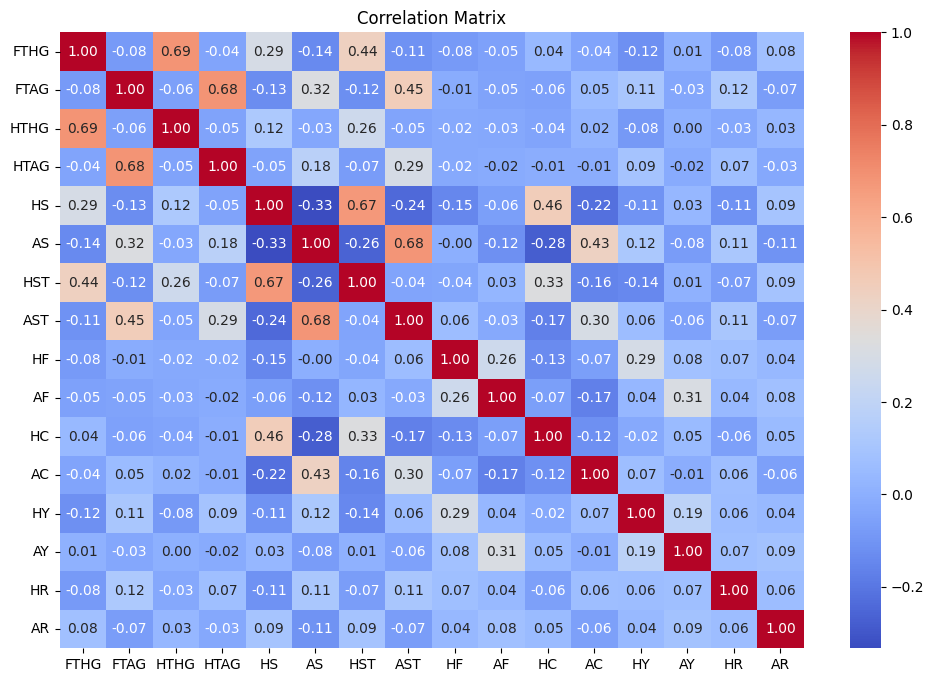

In [18]:
# Compute correlation matrix
correlation_matrix = training_data[numerical_cols].corr()

# Visualize the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix")
plt.show()

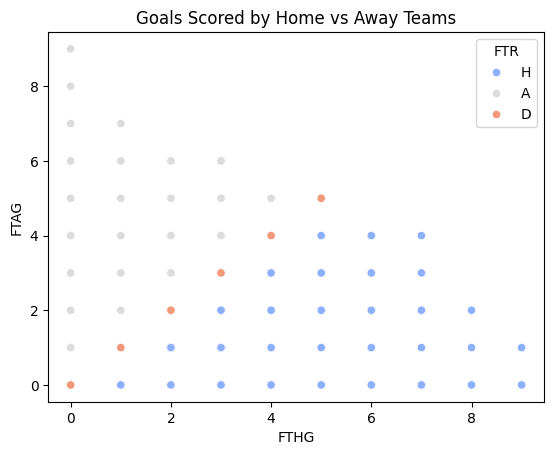

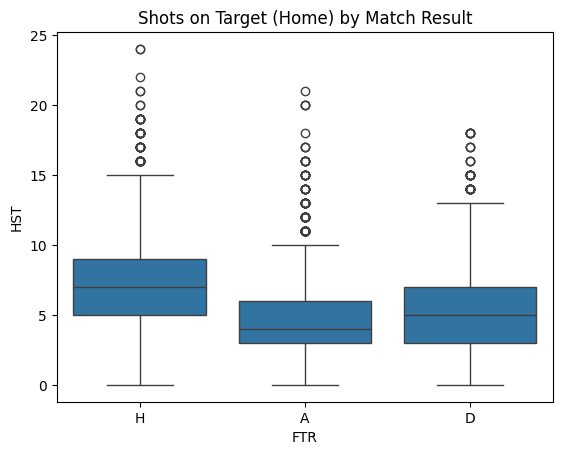

C:\Users\jc\AppData\Local\Temp\ipykernel_8108\2513591357.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=training_data, x="FTR", y="AST", palette="Set2")


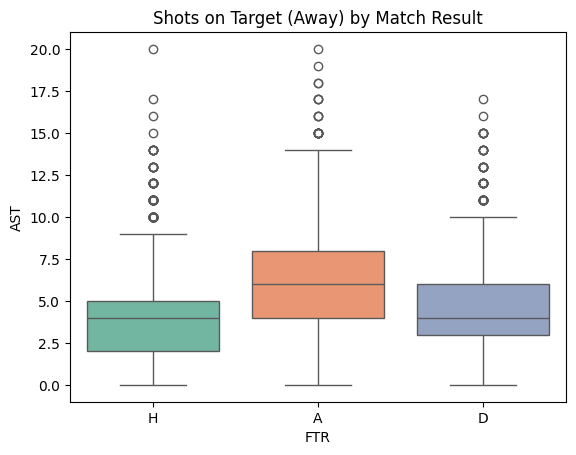

In [19]:
# Scatter plot for goals scored
sns.scatterplot(data=training_data, x="FTHG", y="FTAG", hue="FTR", palette="coolwarm")
plt.title("Goals Scored by Home vs Away Teams")
plt.show()

# Box plots for shots on target
sns.boxplot(data=training_data, x="FTR", y="HST")
plt.title("Shots on Target (Home) by Match Result")
plt.show()

sns.boxplot(data=training_data, x="FTR", y="AST", palette="Set2")
plt.title("Shots on Target (Away) by Match Result")
plt.show()

Average Corners by Match Result:
           HC        AC
FTR                    
A    5.914639  5.112317
D    6.349157  4.939663
H    6.303456  4.892253


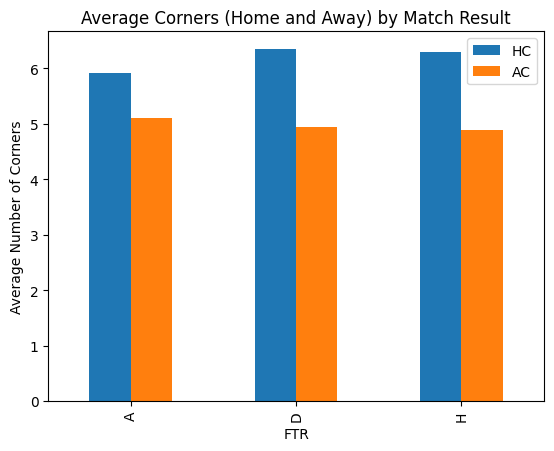

In [20]:
# Average corners by match result
average_corners = training_data.groupby("FTR")[["HC", "AC"]].mean()
print("Average Corners by Match Result:")
print(average_corners)

average_corners.plot(kind="bar")
plt.title("Average Corners (Home and Away) by Match Result")
plt.ylabel("Average Number of Corners")
plt.show()

In [21]:
# Check if referees impact yellow or red cards
referee_cards = training_data.groupby("Referee")[["HY", "AY", "HR", "AR"]].mean()
print("Average Cards Issued by Referee:")
print(referee_cards.sort_values(by="HY", ascending=False).head(10))

Average Cards Issued by Referee:
                HY   AY   HR   AR
Referee                          
F Taylor       5.0  3.0  0.0  0.0
Andy D'Urso    5.0  3.0  1.0  0.0
R Martin       4.0  2.0  0.0  0.0
J. T. Winter   4.0  5.0  0.0  2.0
L Smith        4.0  1.5  0.0  0.5
l Mason        4.0  1.0  0.0  0.0
M Donohue      3.5  3.0  0.0  0.0
Yates, N       3.0  4.0  0.0  0.0
A.G. Wiley     3.0  4.0  0.0  0.0
P. A. Durkin   3.0  2.0  0.0  0.0


In [22]:
# Pivot table of HomeTeam vs. FTR
home_team_pivot = pd.crosstab(training_data["HomeTeam"], training_data["FTR"])
home_team_pivot

FTR,A,D,H
HomeTeam,,,
Arsenal,55,91,310
Aston Villa,129,114,156
Birmingham,37,46,50
Blackburn,64,59,86
Blackpool,9,5,5
Bolton,65,63,81
Bournemouth,51,35,47
Bradford,8,7,4
Brentford,18,17,22


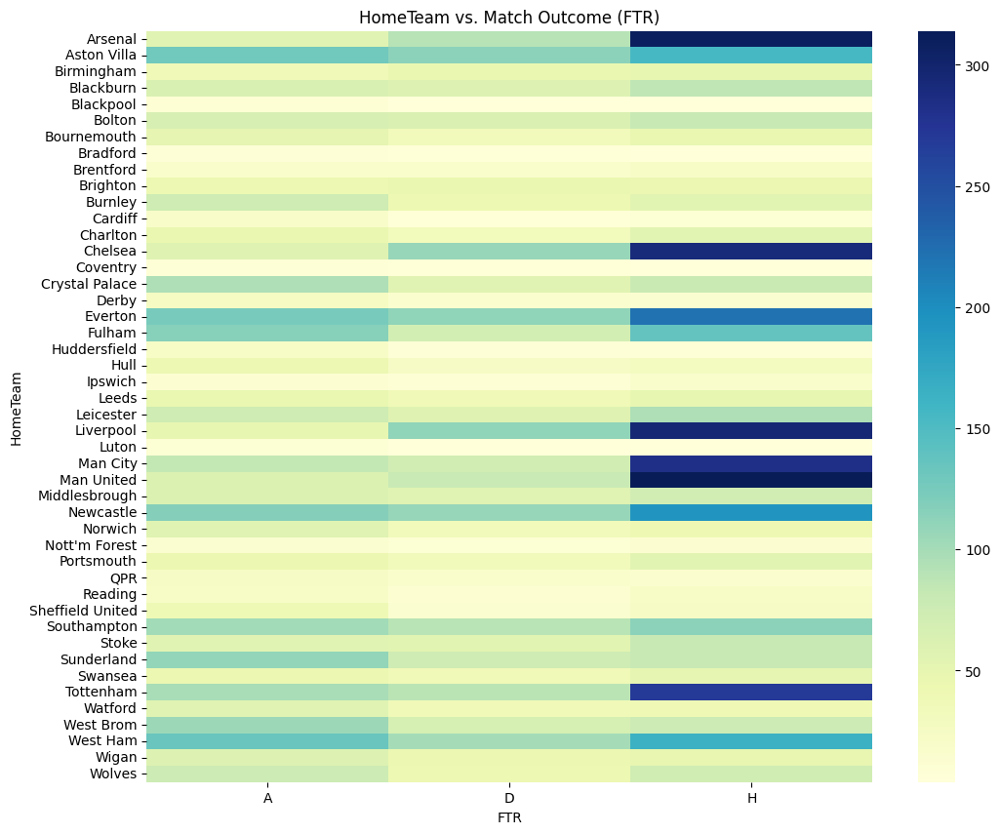

In [23]:
# Heatmap of HomeTeam vs. FTR
plt.figure(figsize=(12,10))
sns.heatmap(home_team_pivot, annot=False, cmap="YlGnBu")
plt.title("HomeTeam vs. Match Outcome (FTR)")
plt.show()

Half-Time Result vs. Full-Time Result (%):
 FTR          A          D          H
HTR                                 
A    69.949611  19.743472  10.306917
D    25.961538  36.725427  37.313034
H     5.386784  14.030692  80.582524


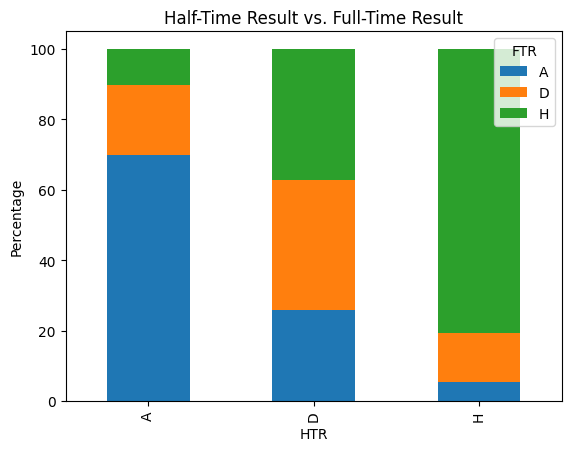

In [24]:
# Half-Time vs. Full-Time Performance
htr_ftr_matrix = pd.crosstab(training_data["HTR"], training_data["FTR"], normalize="index") * 100
print("Half-Time Result vs. Full-Time Result (%):\n", htr_ftr_matrix)

# Plotting the relationship
htr_ftr_matrix.plot(kind="bar", stacked=True)
plt.title("Half-Time Result vs. Full-Time Result")
plt.ylabel("Percentage")
plt.show()

Second Half Performance Changes (%):
 SecondHalfPerformance
No Change        60.032895
Home Improved    15.317982
Away Improved    10.657895
Away Decline      7.192982
Home Decline      6.798246
Name: proportion, dtype: float64


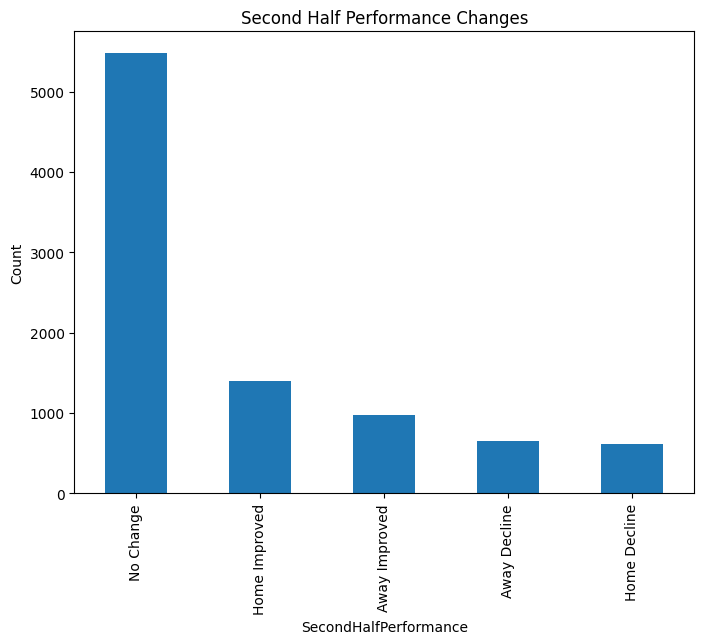

In [25]:
# Create feature indicating improvement or decline in the second half
def performance_change(row):
    if row["HTR"] == row["FTR"]:
        return "No Change"
    elif row["HTR"] == "H" and row["FTR"] != "H":
        return "Home Decline"
    elif row["HTR"] == "A" and row["FTR"] != "A":
        return "Away Decline"
    elif row["HTR"] == "D":
        if row["FTR"] == "H":
            return "Home Improved"
        elif row["FTR"] == "A":
            return "Away Improved"
    else:
        return "Change"

training_data["SecondHalfPerformance"] = training_data.apply(performance_change, axis=1)

# Analyze the impact of second-half performance
performance_counts = training_data["SecondHalfPerformance"].value_counts(normalize=True) * 100
print("Second Half Performance Changes (%):\n", performance_counts)

# Plotting
plt.figure(figsize=(8,6))
training_data["SecondHalfPerformance"].value_counts().plot(kind="bar")
plt.title("Second Half Performance Changes")
plt.ylabel("Count")
plt.show()

## 3.4. Feature Engineering

In [70]:
df = training_data.copy()

In [71]:
df['FTREncoded'] = df['FTR'].map({'H': 0, 'D': 1, 'A': 2})
df['Year'] = df['Date'].dt.year

### 3.4.1 Team-Based Wining Features

1. **Home Team Goals Scored per Game at Home**:  
   **Formula**: `Goals Scored at Home / Matches Played at Home`.  
   **Reason and Benefit**: Reflects the home team’s offensive capability and helps estimate potential goals in future matches.

2. **Home Team Goals Conceded per Game at Home**:  
   **Formula**: `Goals Conceded at Home / Matches Played at Home`.  
   **Reason and Benefit**: Indicates defensive weaknesses of the home team, aiding in predicting goals conceded.

3. **Home Team Win Percentage**:  
   **Formula**: `Total Wins / Total Matches Played (HomeTeam)`.  
   **Reason and Benefit**: Shows the likelihood of the home team winning future matches.

4. **Away Team Win Percentage**:  
   **Formula**: `Total Wins / Total Matches Played (AwayTeam)`.  
   **Reason and Benefit**: Measures the away team’s capability to secure victories in away matches.

5. **Away Team Win Percentage at Away vs Home Team**:  
   **Formula**: `Away Win % (Away Team) vs Home Win % (Home Team)`.  
   **Reason and Benefit**: Directly compares the strengths of the teams in their respective environments.

6. **Home Team Win Percentage at Home vs Away Team**:  
   **Formula**: `Home Win % (Home Team) vs Away Win % (Away Team)`.  
   **Reason and Benefit**: Highlights home dominance relative to the away team’s form.

7. **Away Team Win Percentage**:  
    **Formula**: `Total Away Wins / Total Matches Played`.  
    **Reason and Benefit**: Demonstrates overall away performance trends.

8. **Home Team Win Percentage**:  
    **Formula**: `Total Home Wins / Total Matches Played`.  
    **Reason and Benefit**: Represents overall home team performance trends.

9. **Away Team Goals Scored per Game at Away**:  
    **Formula**: `Goals Scored Away / Matches Played Away`.  
    **Reason and Benefit**: Captures offensive capabilities of the away team.

In [72]:
def calculate_historical_features(df):
    # Ensure Date is in datetime format and sort the dataframe
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.sort_values(by='Date').reset_index(drop=True)

    # Initialize features in the dataframe
    features = ['HomeGoalsPerGame', 'HomeGoalsConcededPerGame', 'HomeWinPercentage',
                'AwayWinPercentage', 'AwayWinPercentageAtAwayVsHome', 'HomeWinPercentageAtHomeVsAway',
                'AwayGoalsPerGameAtAway', 'AwayWinPercentageOverall', 'HomeWinPercentageOverall']
    for feature in features:
        df[feature] = 0.0

    # Iterate through each row to compute historical features
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Historical data only
        historical_data = df[df['Date'] < current_date]

        # Historical data for the home team
        home_hist = historical_data[(historical_data['HomeTeam'] == home_team) | 
                                    (historical_data['AwayTeam'] == home_team)]

        # Compute Home Team Features
        if not home_hist.empty:
            home_games_at_home = home_hist[home_hist['HomeTeam'] == home_team]
            home_games_as_away = home_hist[home_hist['AwayTeam'] == home_team]

            goals_scored_at_home = home_games_at_home['FTHG'].sum()
            matches_played_at_home = len(home_games_at_home)
            goals_conceded_at_home = home_games_at_home['FTAG'].sum()

            total_home_wins = home_games_at_home[home_games_at_home['FTR'] == 'H'].shape[0]
            total_matches_home_team = len(home_hist)

            df.at[idx, 'HomeGoalsPerGame'] = goals_scored_at_home / matches_played_at_home if matches_played_at_home > 0 else 0
            df.at[idx, 'HomeGoalsConcededPerGame'] = goals_conceded_at_home / matches_played_at_home if matches_played_at_home > 0 else 0
            df.at[idx, 'HomeWinPercentage'] = total_home_wins / matches_played_at_home if matches_played_at_home > 0 else 0
            df.at[idx, 'HomeWinPercentageOverall'] = total_home_wins / total_matches_home_team if total_matches_home_team > 0 else 0

        # Historical data for the away team
        away_hist = historical_data[(historical_data['HomeTeam'] == away_team) | 
                                    (historical_data['AwayTeam'] == away_team)]

        # Compute Away Team Features
        if not away_hist.empty:
            away_games_as_away = away_hist[away_hist['AwayTeam'] == away_team]
            away_games_at_home = away_hist[away_hist['HomeTeam'] == away_team]

            goals_scored_at_away = away_games_as_away['FTAG'].sum()
            matches_played_at_away = len(away_games_as_away)

            total_away_wins = away_games_as_away[away_games_as_away['FTR'] == 'A'].shape[0]
            total_matches_away_team = len(away_hist)

            df.at[idx, 'AwayGoalsPerGameAtAway'] = goals_scored_at_away / matches_played_at_away if matches_played_at_away > 0 else 0
            df.at[idx, 'AwayWinPercentage'] = total_away_wins / matches_played_at_away if matches_played_at_away > 0 else 0
            df.at[idx, 'AwayWinPercentageOverall'] = total_away_wins / total_matches_away_team if total_matches_away_team > 0 else 0

        # Compute Comparative Features (Home vs Away)
        home_win_percentage_at_home = df.at[idx, 'HomeWinPercentage'] if not pd.isna(df.at[idx, 'HomeWinPercentage']) else 0
        away_win_percentage_at_away = df.at[idx, 'AwayWinPercentage'] if not pd.isna(df.at[idx, 'AwayWinPercentage']) else 0

        df.at[idx, 'AwayWinPercentageAtAwayVsHome'] = away_win_percentage_at_away - home_win_percentage_at_home
        df.at[idx, 'HomeWinPercentageAtHomeVsAway'] = home_win_percentage_at_home - away_win_percentage_at_away

    return df

df = calculate_historical_features(df)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,FTREncoded,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,HomeWinPercentageOverall
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,2,1.444444,1.833333,0.222222,0.161491,-0.060732,0.060732,0.916149,0.080620,0.108108
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,0,1.171806,1.255507,0.339207,0.268844,-0.070363,0.070363,1.143216,0.134253,0.169231
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,0,2.063736,0.775824,0.646154,0.222222,-0.423932,0.423932,0.968254,0.110818,0.322722
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,0,2.052747,0.839560,0.637363,0.250000,-0.387363,0.387363,1.121212,0.124528,0.318332


### 3.4.2 Head-to-Head (H2H) Features
1. **Head-to-Head Away Win**:  
   **Formula**: `Away Wins in Head-to-Head Matches`.  
   **Reason and Benefit**: Tracks historical dominance of the away team in this specific matchup.

2. **Head-to-Head Home Win**:  
   **Formula**: `Home Wins in Head-to-Head Matches`.  
   **Reason and Benefit**: Indicates historical home team dominance against the current opponent.

3. **Head-to-Head Draw**:  
   **Formula**: `Draws in Head-to-Head Matches`.  
   **Reason and Benefit**: Highlights the frequency of draws in historical matches.

4. **Head-to-Head FTR Mode**:  
    **Formula**: `The mode of FTR result in histrocial H2H matches`.  
    **Reason and Benefit**: Reference from the max likelihood result.

5. **Head-to-Head Corner Dominance**:  
    **Formula**: `HC / (HC + AC)` and `AC / (HC + AC)`.  
    **Reason and Benefit**: Captures set-piece opportunities and offensive pressure in historical matchups.

In [73]:
def calculate_h2h_features(df):
    # Initialize columns for the new features
    df['H2HAwayWin'] = 0
    df['H2HHomeWin'] = 0
    df['H2HDraw'] = 0
    df['H2HFTRMode'] = 1
    df['H2HCornerDominance'] = 0.0

    # Iterate through each row to calculate features
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Filter historical matches between the two teams
        h2h_matches = df[(df['Date'] < current_date) & (
            ((df['HomeTeam'] == home_team) & (df['AwayTeam'] == away_team)) |
            ((df['HomeTeam'] == away_team) & (df['AwayTeam'] == home_team))
        )]

        if not h2h_matches.empty:
            # Head-to-Head Away Win
            away_wins = h2h_matches[
                ((h2h_matches['HomeTeam'] == away_team) & (h2h_matches['FTR'] == 'H')) |
                ((h2h_matches['AwayTeam'] == away_team) & (h2h_matches['FTR'] == 'A'))
            ].shape[0]

            # Head-to-Head Home Win
            home_wins = h2h_matches[
                ((h2h_matches['HomeTeam'] == home_team) & (h2h_matches['FTR'] == 'H')) |
                ((h2h_matches['AwayTeam'] == home_team) & (h2h_matches['FTR'] == 'A'))
            ].shape[0]

            # Head-to-Head Draw
            draws = h2h_matches[h2h_matches['FTR'] == 'D'].shape[0]

            # Head-to-Head FTR Mode
            ftr_mode = h2h_matches['FTREncoded'].mode().iloc[0] if not h2h_matches['FTREncoded'].mode().empty else 1

            # Head-to-Head Corner Dominance
            total_corners_home = h2h_matches.loc[h2h_matches['HomeTeam'] == home_team, 'HC'].sum() + \
                                 h2h_matches.loc[h2h_matches['AwayTeam'] == home_team, 'AC'].sum()
            total_corners_away = h2h_matches.loc[h2h_matches['HomeTeam'] == away_team, 'HC'].sum() + \
                                 h2h_matches.loc[h2h_matches['AwayTeam'] == away_team, 'AC'].sum()

            corner_dominance = total_corners_home / (total_corners_home + total_corners_away) if (total_corners_home + total_corners_away) > 0 else np.nan

            # Assign values to the dataframe
            df.at[idx, 'H2HAwayWin'] = away_wins
            df.at[idx, 'H2HHomeWin'] = home_wins
            df.at[idx, 'H2HDraw'] = draws
            df.at[idx, 'H2HFTRMode'] = ftr_mode
            df.at[idx, 'H2HCornerDominance'] = corner_dominance

    return df

df = calculate_h2h_features(df)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,HomeWinPercentageOverall,H2HAwayWin,H2HHomeWin,H2HDraw,H2HFTRMode,H2HCornerDominance
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,0,1,0.000000
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,0,1,0.000000
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,0,1,0.000000
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,0,1,0.000000
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,0,1,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,-0.060732,0.060732,0.916149,0.080620,0.108108,1,0,0,0,0.250000
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,-0.070363,0.070363,1.143216,0.134253,0.169231,7,7,3,0,0.537975
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,-0.423932,0.423932,0.968254,0.110818,0.322722,2,15,2,0,0.627907
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,-0.387363,0.387363,1.121212,0.124528,0.318332,4,7,2,2,0.595092


### 3.4.3 Last Season League Points
1. **Away Team Last Season League Points**:  
   **Formula**: `Total Points Earned in Previous Season (Away Team)`.  
   **Reason and Benefit**: Serves as a long-term performance indicator for the away team.

2. **Home Team Last Season League Points**:  
   **Formula**: `Total Points Earned in Previous Season (Home Team)`.  
   **Reason and Benefit**: Reflects the home team’s prior season success as a baseline.

In [74]:
def calculate_league_points(df, team_col, year_col, ftr_col):
    # Assign points based on FTR (Win = 3, Draw = 1, Loss = 0)
    df['Points'] = df[ftr_col].map({'H': 3, 'D': 1, 'A': 0})
    
    # Group by team and year to calculate total points
    league_points = df.groupby([team_col, year_col])['Points'].sum().reset_index()
    league_points.rename(columns={'Points': 'TotalPoints', team_col: 'Team'}, inplace=True)
    
    return league_points

# Calculate league points for home and away teams separately
home_points = calculate_league_points(
    df[['HomeTeam', 'Year', 'FTR']].rename(columns={'HomeTeam': 'Team'}),
    team_col='Team', year_col='Year', ftr_col='FTR'
)

away_points = calculate_league_points(
    df[['AwayTeam', 'Year', 'FTR']].rename(columns={'AwayTeam': 'Team', 'FTR': 'FTR_Away'}),
    team_col='Team', year_col='Year', ftr_col='FTR_Away'
)

# Combine home and away points to get total league points per team per year
league_points = pd.concat([home_points, away_points])
league_points = league_points.groupby(['Team', 'Year'])['TotalPoints'].sum().reset_index()

def get_last_season_points(row, league_points, team_col):
    team = row[team_col]
    year = row['Year']
    previous_season_points = league_points[(league_points['Team'] == team) & (league_points['Year'] == year - 1)]
    
    if not previous_season_points.empty:
        return previous_season_points['TotalPoints'].values[0]
    return 1  # Default to 1 (Draw) if no data is available

# Add features for last season league points
df['AwayTeamLastSeasonPoints'] = df.apply(lambda row: get_last_season_points(row, league_points, 'AwayTeam'), axis=1)
df['HomeTeamLastSeasonPoints'] = df.apply(lambda row: get_last_season_points(row, league_points, 'HomeTeam'), axis=1)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,HomeWinPercentageOverall,H2HAwayWin,H2HHomeWin,H2HDraw,H2HFTRMode,H2HCornerDominance,AwayTeamLastSeasonPoints,HomeTeamLastSeasonPoints
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,0.000000,0.000000,0.000000,0,0,0,1,0.000000,1,1
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,0.000000,0.000000,0.000000,0,0,0,1,0.000000,1,1
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,0.000000,0.000000,0.000000,0,0,0,1,0.000000,1,1
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,0.000000,0.000000,0.000000,0,0,0,1,0.000000,1,1
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,0.000000,0.000000,0.000000,0,0,0,1,0.000000,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,0.916149,0.080620,0.108108,1,0,0,0,0.250000,72,27
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,1.143216,0.134253,0.169231,7,7,3,0,0.537975,79,62
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,0.968254,0.110818,0.322722,2,15,2,0,0.627907,83,72
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,1.121212,0.124528,0.318332,4,7,2,2,0.595092,60,63


### 3.4.4 Result Streak based Features
1. **Streak**:  
   **Formula**: `Mean of Result Scores (Win = 3, Draw = 1, Loss = 0) over 3*k, Last k Games`.  
   **Reason and Benefit**: Tracks overall form trends irrespective of opponents.

2. **Weighted Streak**:  
    **Formula**: `Time-Weighted Result Scores over Last k Games`. For jth match:

   \[
    \omega_j = \sum_{p=j-k}^{j-1} \frac{2 \cdot (p - (j-k-1)) \cdot res_p}{3 \cdot k \cdot (k+1)}
   \]

   **Reason and Benefit**: Places higher emphasis on more recent performances.

4. **Away Team Last 2 Matches Winning Streak**:  
   **Formula**: `Win Streak in Last 2 Matches (Away Team)`.  
   **Reason and Benefit**: Reflects short-term momentum and form.

In [75]:
def calculate_result_score(row):
    if row['FTR'] == 'H':
        return 3
    elif row['FTR'] == 'A':
        return 0
    else:
        return 1

def calculate_streak_features(df, k=5):
    # Initialize columns
    df['Streak'] = 0.0
    df['WeightedStreak'] = 0.0
    df['Last2MatchesWinStreak'] = 0.0

    # Expand dataset for team-level calculation
    expanded_data = pd.concat([
        df[['Date', 'HomeTeam', 'FTR']].rename(columns={'HomeTeam': 'Team'}),
        df[['Date', 'AwayTeam', 'FTR']].rename(columns={'AwayTeam': 'Team'})
    ]).sort_values('Date').reset_index(drop=True)

    # Reverse FTR for away team
    expanded_data['ReversedFTR'] = expanded_data.apply(
        lambda row: 'H' if row['FTR'] == 'A' else ('A' if row['FTR'] == 'H' else 'D'), axis=1
    )
    expanded_data['Result'] = np.where(expanded_data['FTR'] == 'A', expanded_data['ReversedFTR'], expanded_data['FTR'])

    # Map results to scores
    expanded_data['ResultScore'] = expanded_data['Result'].map({'H': 3, 'D': 1, 'A': 0})

    # Calculate streak features for each team
    streak_features = []
    grouped = expanded_data.groupby('Team')

    for team, matches in grouped:
        matches = matches.sort_values('Date').reset_index(drop=True)
        streaks = []
        weighted_streaks = []
        last_2_streaks = []

        for idx in range(len(matches)):
            if idx == 0:
                streaks.append(0)
                weighted_streaks.append(0)
                last_2_streaks.append(0)
            else:
                # Filter historical data strictly before the current date
                recent_matches = matches.loc[max(0, idx - k):idx - 1]

                # Calculate streak
                recent_scores = recent_matches['ResultScore']
                streak = recent_scores.sum() / (3 * k)

                # Calculate weighted streak
                weights = 2 * (np.arange(1, len(recent_scores) + 1)) / (3 * k * (k + 1))
                weighted_streak = (recent_scores * weights).sum()

                # Calculate last 2 matches win streak
                last_2_matches = recent_scores.tail(2)
                last_2_win_streak = (last_2_matches == 3).sum()

                streaks.append(streak)
                weighted_streaks.append(weighted_streak)
                last_2_streaks.append(last_2_win_streak)

        matches['Streak'] = streaks
        matches['WeightedStreak'] = weighted_streaks
        matches['Last2MatchesWinStreak'] = last_2_streaks
        streak_features.append(matches[['Date', 'Team', 'Streak', 'WeightedStreak', 'Last2MatchesWinStreak']])

    streak_features = pd.concat(streak_features)

    # Merge streak features back into the main dataframe
    home_features = streak_features.rename(columns={
        'Team': 'HomeTeam',
        'Streak': 'HomeStreak',
        'WeightedStreak': 'HomeWeightedStreak',
        'Last2MatchesWinStreak': 'HomeLast2WinStreak'
    })
    away_features = streak_features.rename(columns={
        'Team': 'AwayTeam',
        'Streak': 'AwayStreak',
        'WeightedStreak': 'AwayWeightedStreak',
        'Last2MatchesWinStreak': 'AwayLast2WinStreak'
    })

    df = df.merge(home_features, on=['Date', 'HomeTeam'], how='left')
    df = df.merge(away_features, on=['Date', 'AwayTeam'], how='left')

    return df

df = calculate_streak_features(df, k=20)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HomeTeamLastSeasonPoints,Streak,WeightedStreak,Last2MatchesWinStreak,HomeStreak,HomeWeightedStreak,HomeLast2WinStreak,AwayStreak,AwayWeightedStreak,AwayLast2WinStreak
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,1,0.0,0.0,0.0,0.000000,0.000000,0,0.000000,0.000000,0
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,1,0.0,0.0,0.0,0.000000,0.000000,0,0.000000,0.000000,0
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,1,0.0,0.0,0.0,0.000000,0.000000,0,0.000000,0.000000,0
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,1,0.0,0.0,0.0,0.000000,0.000000,0,0.000000,0.000000,0
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,1,0.0,0.0,0.0,0.000000,0.000000,0,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,27,0.0,0.0,0.0,0.833333,0.844444,1,0.833333,0.806349,1
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,62,0.0,0.0,0.0,0.833333,0.841270,2,0.800000,0.777778,1
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,72,0.0,0.0,0.0,0.833333,0.796825,1,0.900000,0.898413,2
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,63,0.0,0.0,0.0,0.833333,0.819048,2,0.833333,0.869841,2


### 3.4.5 Recent `k` matches' Performance Features
1. **Recent Corners, Shots on Target, and Goals (Past k Games) For HomeTeam and AwayTeam**:  
    **Formula**: `Sum of Metrics over Last k Matches / k`.  
    **Reason and Benefit**: Captures recent trends in offensive and defensive pressure metrics.

2. **Past k matches' Goal Difference (GD)**:  
    **Formula**: `Cumulative Goals Scored - Cumulative Goals Conceded`.  
    **Reason and Benefit**: Provides an overall measure of team strength and form.

3. **Past k mateches' Corners Differential**:  
    **Formula**: `Corners(Home Team) - Corners(Away Team)`.  
    **Reason and Benefit**: Measures pressure exerted on opponents.

4. **Past k matches' Shots on Target Differential**:  
    **Formula**: `Shots on Target (Home) - Shots on Target (Away)`.  
    **Reason and Benefit**: Measures recent attacking effectiveness.

5. **Past k matches' Shot Accuracy Difference**:  
    **Formula**: `(HST / HS) - (AST / AS)` in the last `k` matches.  
    **Reason and Benefit**: Tracks shooting efficiency.

6. **Past k matches' Goal Conversion Rate Difference**:  
    **Formula**: (Goals scored / Shots on target (`HST`)) - Goals scored / Shots on target (`AST`).  
    **Reason and Benefit**: Highlights how efficiently the home team converts chances to away team.

In [76]:
def calculate_recent_performance_features(df, k=5):
    # Initialize columns for recent performance features
    df['HomeRecentPerformance'] = 0.0
    df['AwayRecentPerformance'] = 0.0
    df['RecentGoalDifference'] = 0.0
    df['RecentCornersDifferential'] = 0.0
    df['RecentShotsOnTargetDifferential'] = 0.0
    df['RecentShotAccuracyDifference'] = 0.0
    df['RecentGoalConversionRateDifference'] = 0.0

    def compute_recent_features(row):
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Filter historical data
        historical_data = df[df['Date'] < current_date]

        # Historical data for home team
        home_hist = historical_data[
            (historical_data['HomeTeam'] == home_team) |
            (historical_data['AwayTeam'] == home_team)
        ].sort_values('Date', ascending=False).head(k)

        # Historical data for away team
        away_hist = historical_data[
            (historical_data['HomeTeam'] == away_team) |
            (historical_data['AwayTeam'] == away_team)
        ].sort_values('Date', ascending=False).head(k)

        # Compute home team metrics
        home_corners = home_hist['HC'][(home_hist['HomeTeam'] == home_team)].sum() + \
                       home_hist['AC'][(home_hist['AwayTeam'] == home_team)].sum()

        home_shots_on_target = home_hist['HST'][(home_hist['HomeTeam'] == home_team)].sum() + \
                               home_hist['AST'][(home_hist['AwayTeam'] == home_team)].sum()

        home_goals = home_hist['FTHG'][(home_hist['HomeTeam'] == home_team)].sum() + \
                     home_hist['FTAG'][(home_hist['AwayTeam'] == home_team)].sum()

        home_total_shots = home_hist['HS'][(home_hist['HomeTeam'] == home_team)].sum() + \
                           home_hist['AS'][(home_hist['AwayTeam'] == home_team)].sum()

        # Compute away team metrics
        away_corners = away_hist['HC'][(away_hist['HomeTeam'] == away_team)].sum() + \
                       away_hist['AC'][(away_hist['AwayTeam'] == away_team)].sum()

        away_shots_on_target = away_hist['HST'][(away_hist['HomeTeam'] == away_team)].sum() + \
                               away_hist['AST'][(away_hist['AwayTeam'] == away_team)].sum()

        away_goals = away_hist['FTHG'][(away_hist['HomeTeam'] == away_team)].sum() + \
                     away_hist['FTAG'][(away_hist['AwayTeam'] == away_team)].sum()

        away_total_shots = away_hist['HS'][(away_hist['HomeTeam'] == away_team)].sum() + \
                           away_hist['AS'][(away_hist['AwayTeam'] == away_team)].sum()

        # Calculate performance metrics
        recent_performance_home = (home_goals + home_corners + home_shots_on_target) / k
        recent_performance_away = (away_goals + away_corners + away_shots_on_target) / k

        goal_difference = (home_goals - away_goals) / k
        corners_differential = (home_corners - away_corners) / k
        shots_on_target_differential = (home_shots_on_target - away_shots_on_target) / k

        # Calculate shot accuracy and goal conversion rates
        home_shot_accuracy = home_shots_on_target / home_total_shots if home_total_shots > 0 else 0
        away_shot_accuracy = away_shots_on_target / away_total_shots if away_total_shots > 0 else 0
        shot_accuracy_difference = home_shot_accuracy - away_shot_accuracy

        home_goal_conversion_rate = home_goals / home_shots_on_target if home_shots_on_target > 0 else 0
        away_goal_conversion_rate = away_goals / away_shots_on_target if away_shots_on_target > 0 else 0
        goal_conversion_rate_difference = home_goal_conversion_rate - away_goal_conversion_rate

        return {
            'HomeRecentPerformance': recent_performance_home,
            'AwayRecentPerformance': recent_performance_away,
            'RecentGoalDifference': goal_difference,
            'RecentCornersDifferential': corners_differential,
            'RecentShotsOnTargetDifferential': shots_on_target_differential,
            'RecentShotAccuracyDifference': shot_accuracy_difference,
            'RecentGoalConversionRateDifference': goal_conversion_rate_difference
        }

    # Apply the computation to each row
    performance_features = df.apply(compute_recent_features, axis=1)

    # Update the DataFrame with the new features
    for key in performance_features.iloc[0].keys():
        df[key] = performance_features.apply(lambda x: x[key])

    return df

df = calculate_recent_performance_features(df, k=10)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,AwayStreak,AwayWeightedStreak,AwayLast2WinStreak,HomeRecentPerformance,AwayRecentPerformance,RecentGoalDifference,RecentCornersDifferential,RecentShotsOnTargetDifferential,RecentShotAccuracyDifference,RecentGoalConversionRateDifference
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,0.000000,0.000000,0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,0.000000,0.000000,0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,0.000000,0.000000,0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,0.000000,0.000000,0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,0.000000,0.000000,0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,0.833333,0.806349,1,16.2,15.7,0.0,1.7,-1.2,0.088889,0.075789
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,0.800000,0.777778,1,19.6,16.1,0.3,1.6,1.6,0.065657,-0.106988
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,0.900000,0.898413,2,21.3,18.0,1.0,-1.6,3.9,-0.044691,0.000000
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,0.833333,0.869841,2,20.5,20.9,1.2,-3.8,2.2,0.064206,0.068889


### 3.4.6 Team Strength Features
1. **Home Defensive Strength**:  
   **Formula**: `Total FTAG Conceded / Total Matches`.  
   **Reason and Benefit**: Evaluates how well the home team defends against attacks.

2. **Away Defensive Strength**:  
   **Formula**: `Total FTHG Conceded / Total Matches`.  
   **Reason and Benefit**: Reflects the defensive performance of the away team.

3. **Home Aggression Index**:  
   **Formula**: `(HF + HY*2 + HR*4) / (Total Matches * normalized aggression)`.  
   **Reason and Benefit**: Tracks disciplinary behavior and risk-taking by home teams.

4. **Away Aggression Index**:  
   **Formula**: `(AF + AY*2 + AR*4) / (Total Matches * normalized aggression)`.  
   **Reason and Benefit**: Highlights away team discipline and risk behavior.

5. **Defensive Balance**:
   **Formula**: `abs(HST - AST)`
   **Reason and Benefit**: To measure how evenly matched the teams are in attacking quality.

In [77]:
def calculate_defensive_and_aggression_features(df):
    # Initialize new columns
    df['HomeDefensiveStrength'] = 0.0
    df['AwayDefensiveStrength'] = 0.0
    df['HomeAggressionIndex'] = 0.0
    df['AwayAggressionIndex'] = 0.0
    df['DefensiveBalance'] = 0.0

    def compute_features(row):
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']
        referee = row['Referee']

        # Filter historical data
        historical_data = df[df['Date'] < current_date]

        # Historical data for the home team
        home_hist = historical_data[
            (historical_data['HomeTeam'] == home_team) |
            (historical_data['AwayTeam'] == home_team)
        ]

        # Historical data for the away team
        away_hist = historical_data[
            (historical_data['HomeTeam'] == away_team) |
            (historical_data['AwayTeam'] == away_team)
        ]

        # Defensive Strength
        home_defensive_strength = home_hist['FTAG'][(home_hist['HomeTeam'] == home_team)].sum() / \
                                  max(1, len(home_hist[home_hist['HomeTeam'] == home_team]))
        away_defensive_strength = home_hist['FTHG'][(home_hist['AwayTeam'] == home_team)].sum() / \
                                  max(1, len(away_hist[away_hist['AwayTeam'] == away_team]))

        # Aggression Index
        normalized_aggression = historical_data[['HF', 'HY', 'HR']].mean().sum()
        home_aggression = (home_hist['HF'][(home_hist['HomeTeam'] == home_team)].sum() +
                           2 * home_hist['HY'][(home_hist['HomeTeam'] == home_team)].sum() +
                           4 * home_hist['HR'][(home_hist['HomeTeam'] == home_team)].sum()) / \
                          max(1, len(home_hist[home_hist['HomeTeam'] == home_team]) * normalized_aggression)

        away_aggression = (away_hist['AF'][(away_hist['AwayTeam'] == away_team)].sum() +
                           2 * away_hist['AY'][(away_hist['AwayTeam'] == away_team)].sum() +
                           4 * away_hist['AR'][(away_hist['AwayTeam'] == away_team)].sum()) / \
                          max(1, len(away_hist[away_hist['AwayTeam'] == away_team]) * normalized_aggression)
        
        # Compute Defensive Balance
        defensive_balance = abs(home_hist['HST'].mean() - away_hist['AST'].mean()) or 0.0

        return {
            'HomeDefensiveStrength': home_defensive_strength,
            'AwayDefensiveStrength': away_defensive_strength,
            'HomeAggressionIndex': home_aggression,
            'AwayAggressionIndex': away_aggression,
            'DefensiveBalance': defensive_balance
        }

    # Apply the computation to each row
    features = df.apply(compute_features, axis=1)

    # Update the DataFrame with the new features
    for key in features.iloc[0].keys():
        df[key] = features.apply(lambda x: x[key])

    return df

df = calculate_defensive_and_aggression_features(df)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,RecentGoalDifference,RecentCornersDifferential,RecentShotsOnTargetDifferential,RecentShotAccuracyDifference,RecentGoalConversionRateDifference,HomeDefensiveStrength,AwayDefensiveStrength,HomeAggressionIndex,AwayAggressionIndex,DefensiveBalance
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,0.0,1.7,-1.2,0.088889,0.075789,1.833333,0.149068,0.897974,1.217468,0.740122
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,0.3,1.6,1.6,0.065657,-0.106988,1.255507,0.922111,1.151784,1.323155,0.183838
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,1.0,-1.6,3.9,-0.044691,0.000000,0.775824,2.873016,0.970245,1.170599,1.437581
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,1.2,-3.8,2.2,0.064206,0.068889,0.839560,3.666667,1.082189,1.007682,1.997730


### 3.4.7 Expected Goal Features
1. **Expected Goals (xG) for HomeTeam and AwayTeam**:  
   **Formula**: `Sum of Shot Probabilities for Each Team`.  
   **Reason and Benefit**: Predicts goal-scoring potential by factoring shot quality and location.

2. **In-Match Goals Difference for HomeTeam and AwayTeam**:  
   **Formula**: `(Goals Scored - Goals Conceded) / matches_played`.  
   **Reason and Benefit**: Predicts IN-Match goal strength.

In [78]:
def calculate_xg_probability(row):
    if row['Shots'] > 0:
        return row['ShotsOnTarget'] / row['Shots']
    return 0.0

def calculate_expected_goals(df):
    # Expand the dataset for team-level calculations
    expanded_data = pd.concat([
        df[['Date', 'HomeTeam', 'HS', 'HST', 'FTHG']].rename(columns={
            'HomeTeam': 'Team', 'HS': 'Shots', 'HST': 'ShotsOnTarget', 'FTHG': 'Goals'
        }),
        df[['Date', 'AwayTeam', 'AS', 'AST', 'FTAG']].rename(columns={
            'AwayTeam': 'Team', 'AS': 'Shots', 'AST': 'ShotsOnTarget', 'FTAG': 'Goals'
        })
    ]).sort_values('Date').reset_index(drop=True)

    # Add xG probability for each match
    expanded_data['xGProb'] = expanded_data.apply(calculate_xg_probability, axis=1)

    # Group by team and calculate average xG over the last k matches
    grouped = expanded_data.groupby('Team')
    xg_features = []
    for team, matches in grouped:
        matches = matches.sort_values('Date').reset_index(drop=True)
        xg_values = []
        for idx in range(len(matches)):
            if idx == 0:
                xg_values.append(0.0)  # No historical data for the first match
            else:
                # Filter for the last k matches
                recent_matches = matches.iloc[:idx]
                xg = (recent_matches['ShotsOnTarget'] * recent_matches['xGProb']).sum() / len(recent_matches)
                xg_values.append(xg)
        matches['ExpectedGoals'] = xg_values
        xg_features.append(matches[['Date', 'Team', 'ExpectedGoals']])

    xg_features = pd.concat(xg_features)

    # Merge xG back into the main DataFrame
    home_xg = xg_features.rename(columns={'Team': 'HomeTeam', 'ExpectedGoals': 'HomeExpectedGoals'})
    away_xg = xg_features.rename(columns={'Team': 'AwayTeam', 'ExpectedGoals': 'AwayExpectedGoals'})

    df = df.merge(home_xg, on=['Date', 'HomeTeam'], how='left')
    df = df.merge(away_xg, on=['Date', 'AwayTeam'], how='left')

    return df

df = calculate_expected_goals(df)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,RecentShotsOnTargetDifferential,RecentShotAccuracyDifference,RecentGoalConversionRateDifference,HomeDefensiveStrength,AwayDefensiveStrength,HomeAggressionIndex,AwayAggressionIndex,DefensiveBalance,HomeExpectedGoals,AwayExpectedGoals
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,-1.2,0.088889,0.075789,1.833333,0.149068,0.897974,1.217468,0.740122,1.457545,2.781613
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,1.6,0.065657,-0.106988,1.255507,0.922111,1.151784,1.323155,0.183838,1.600894,2.608640
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,3.9,-0.044691,0.000000,0.775824,2.873016,0.970245,1.170599,1.437581,3.465217,2.195911
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,2.2,0.064206,0.068889,0.839560,3.666667,1.082189,1.007682,1.997730,3.380469,1.605391


In [79]:
def calculate_goal_difference(df):
    # Initialize columns for goal difference
    df['HomeGoalDifference'] = 0.0
    df['AwayGoalDifference'] = 0.0

    def calculate_team_goal_difference(row, team_col):
        team = row[team_col]
        current_date = row['Date']

        # Filter historical matches for this team up to the current date
        historical_matches = pd.concat([
            df[(df['HomeTeam'] == team) & (df['Date'] < current_date)][['FTHG', 'FTAG']],
            df[(df['AwayTeam'] == team) & (df['Date'] < current_date)][['FTAG', 'FTHG']].rename(columns={'FTAG': 'FTHG', 'FTHG': 'FTAG'})
        ])
        
        if not historical_matches.empty:
            goals_scored = historical_matches['FTHG'].sum()
            goals_conceded = historical_matches['FTAG'].sum()
            matches_played = len(historical_matches)
            return (goals_scored - goals_conceded) / matches_played
        else:
            return 0.0

    # Apply the helper function for both home and away teams
    df['HomeGoalDifference'] = df.apply(lambda row: calculate_team_goal_difference(row, 'HomeTeam'), axis=1)
    df['AwayGoalDifference'] = df.apply(lambda row: calculate_team_goal_difference(row, 'AwayTeam'), axis=1)

    return df

df = calculate_goal_difference(df)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,RecentGoalConversionRateDifference,HomeDefensiveStrength,AwayDefensiveStrength,HomeAggressionIndex,AwayAggressionIndex,DefensiveBalance,HomeExpectedGoals,AwayExpectedGoals,HomeGoalDifference,AwayGoalDifference
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,0.075789,1.833333,0.149068,0.897974,1.217468,0.740122,1.457545,2.781613,-0.837838,-0.319380
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,-0.106988,1.255507,0.922111,1.151784,1.323155,0.183838,1.600894,2.608640,-0.290110,-0.148055
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,0.000000,0.775824,2.873016,0.970245,1.170599,1.437581,3.465217,2.195911,0.855104,-0.459103
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,0.068889,0.839560,3.666667,1.082189,1.007682,1.997730,3.380469,1.605391,0.861690,-0.509434


### 3.4.8 HTR-Related Features
1. **HTR to FTR Transition**:


   **Formula**:  `HTR -> FTR = Count of transitions from HTR 'D' to FTR 'H' / Total transitions from HTR 'D'`


   **Reason and Benefit**: Captures the tendency of teams to convert a half-time draw (HTR 'D') into a home win (FTR 'H'), highlighting team behavior trends in match outcomes.

3. **Weighted Influence of HTR Transitions**:


   **Formula**: `HTR -> FTR · (Recent Goals Scored + Goa lDifference)`


   **Reason and Benefit**: Amplifies the transition probability by incorporating match-specific contextual metrics like recent offensive performance and the current goal difference, which reflect team form and momentum.

5. **Pressure Index**: 


   **Formula**: `(HST + AST + Corners) · HTR-Encoded`


   **Reason and Benefit**: Combines attacking pressure metrics (shots and corners) with encoded HTR states (H = 1, D = 0, A = -1), providing insight into how team dominance at half-time translates into match outcomes.

7. **HTR to FTR Conditioned on Shots Difference**  


   **Formula**: `P(HTR -> FTR | Shots Difference > 0)`


   **Reason and Benefit**: Measures the probability of HTR transitions under the condition of a favorable shots difference, capturing the influence of attacking superiority on match outcomes.  

In [80]:
def calculate_htr_features(df):
    # Initialize features
    df['HTRtoFTRTransition'] = 0.0
    df['WeightedHTRTransition'] = 0.0
    df['PressureIndex'] = 0.0
    df['HTRtoFTRConditioned'] = 0.0

    # Prepare a list to store feature values
    results = []

    # Iterate through each row in the DataFrame
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Historical data strictly before the current match date
        historical_data = df[df['Date'] < current_date].copy()

        if historical_data.empty:
            results.append({
                'HTRtoFTRTransition': 0.0,
                'WeightedHTRTransition': 0.0,
                'PressureIndex': 0.0,
                'HTRtoFTRConditioned': 0.0
            })
            continue

        # Transform FTR to align with the current team perspective
        historical_data['TransformedFTR'] = historical_data.apply(
            lambda x: x['FTR'] if x['HomeTeam'] == home_team else 
                      ('H' if x['FTR'] == 'A' else 'A' if x['FTR'] == 'H' else 'D'),
            axis=1
        )

        # Calculate HTR transitions for matches with HTR 'D'
        htr_d_matches = historical_data[historical_data['HTR'] == 'D']
        if not htr_d_matches.empty:
            transition_count = htr_d_matches['TransformedFTR'].isin(['H', 'A']).sum()
            htr_to_ftr_transition = transition_count / len(htr_d_matches)
        else:
            htr_to_ftr_transition = 0.0

        # Calculate Weighted Influence of HTR Transitions
        recent_goals = (
            historical_data[historical_data['HomeTeam'] == home_team]['FTHG'].sum() +
            historical_data[historical_data['AwayTeam'] == home_team]['FTAG'].sum()
        )
        goal_difference = (
            historical_data[historical_data['HomeTeam'] == home_team]['FTHG'].sum() -
            historical_data[historical_data['AwayTeam'] == home_team]['FTAG'].sum()
        )
        weighted_htr_transition = htr_to_ftr_transition * (recent_goals + goal_difference)

        # Calculate Pressure Index
        hst = historical_data[historical_data['HomeTeam'] == home_team]['HST'].sum()
        ast = historical_data[historical_data['AwayTeam'] == home_team]['AST'].sum()
        corners = (
            historical_data[historical_data['HomeTeam'] == home_team]['HC'].sum() +
            historical_data[historical_data['AwayTeam'] == home_team]['AC'].sum()
        )
        pressure_index = (hst + ast + corners)

        # Calculate HTR to FTR Conditioned on Shots Difference
        shots_diff_matches = htr_d_matches[
            (htr_d_matches['HST'] - htr_d_matches['AST']) > 0
        ]
        if not shots_diff_matches.empty:
            conditioned_transitions = shots_diff_matches['TransformedFTR'].isin(['H', 'A']).sum()
            htr_to_ftr_conditioned = conditioned_transitions / len(shots_diff_matches)
        else:
            htr_to_ftr_conditioned = 0.0

        # Append results for the current row
        results.append({
            'HTRtoFTRTransition': htr_to_ftr_transition,
            'WeightedHTRTransition': weighted_htr_transition,
            'PressureIndex': pressure_index,
            'HTRtoFTRConditioned': htr_to_ftr_conditioned
        })

    # Create a DataFrame from results and merge back into the original DataFrame
    results_df = pd.DataFrame(results)
    df = pd.concat([df.reset_index(drop=True), results_df], axis=1)

    return df

df = calculate_htr_features(df)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HomeGoalDifference,AwayGoalDifference,HTRtoFTRTransition,WeightedHTRTransition,PressureIndex,HTRtoFTRConditioned,HTRtoFTRTransition,WeightedHTRTransition,PressureIndex,HTRtoFTRConditioned
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,-0.837838,-0.319380,0.0,0.0,0.0,0.0,0.632549,32.892571,500.0,0.643333
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,-0.290110,-0.148055,0.0,0.0,0.0,0.0,0.632549,336.516301,4216.0,0.643333
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,0.855104,-0.459103,0.0,0.0,0.0,0.0,0.632549,1187.927846,12373.0,0.643333
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,0.861690,-0.509434,0.0,0.0,0.0,0.0,0.632549,1181.602352,11861.0,0.643333


### 3.4.9 Form-Based Features
1. **Form**:  


   **Formula**: `Updated Coefficients After Each Match`.


   **Reason and Benefit**: Incorporates relative performance strength by accounting for the quality of opponents.

   
    - Case 1 - H:
    \begin{aligned}
    \xi_j^\alpha &= \xi_{j-1}^\alpha + \gamma \xi_{j-1}^\beta \\
    \xi_j^\beta &= \xi_{j-1}^\beta - \gamma \xi_{j-1}^\beta
    \end{aligned}


    - Case 2 - A:
    \begin{aligned}
    \xi_j^\beta &= \xi_{j-1}^\beta + \gamma \xi_{j-1}^\alpha \\
    \xi_j^\alpha &= \xi_{j-1}^\alpha - \gamma \xi_{j-1}^\alpha
    \end{aligned}

    - Case 3 - D:
    \begin{aligned}
    \xi_j^\alpha &= \xi_{j-1}^\alpha - \gamma \left(\xi_{j-1}^\alpha - \xi_{j-1}^\beta\right) \\
    \xi_j^\beta &= \xi_{j-1}^\beta - \gamma \left(\xi_{j-1}^\beta - \xi_{j-1}^\alpha\right)
    \end{aligned}
    
3. **Form Differential**:  


   **Formula**: `Form(Home Team) - Form(Away Team)`.  


   **Reason and Benefit**: Directly compares the relative strength of teams based on recent performance.

In [81]:
def calculate_form_features(df, gamma=0.1):
    # Initialize form values
    teams = pd.concat([df['HomeTeam'], df['AwayTeam']]).unique()
    form_values = {team: 1.0 for team in teams}

    # Initialize new columns
    df['HomeForm'] = 0.0
    df['AwayForm'] = 0.0
    df['FormDifferential'] = 0.0

    historical_data = []

    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Get the form values before the match
        home_form = form_values[home_team]
        away_form = form_values[away_team]

        # Record current form values
        df.at[idx, 'HomeForm'] = home_form
        df.at[idx, 'AwayForm'] = away_form
        df.at[idx, 'FormDifferential'] = home_form - away_form

        # Determine result using only historical matches
        home_wins = sum(1 for match in historical_data if match['HomeTeam'] == home_team and match['FTR'] == 'H')
        away_wins = sum(1 for match in historical_data if match['AwayTeam'] == home_team and match['FTR'] == 'A')
        home_losses = sum(1 for match in historical_data if match['HomeTeam'] == away_team and match['FTR'] == 'A')
        away_losses = sum(1 for match in historical_data if match['AwayTeam'] == away_team and match['FTR'] == 'H')
        draws = sum(1 for match in historical_data if match['HomeTeam'] in [home_team, away_team] and match['FTR'] == 'D')

        # Update form values based on historical results
        total_matches = home_wins + away_wins + home_losses + away_losses + draws
        if total_matches > 0:
            if home_team == row['HomeTeam'] and away_team == row['AwayTeam']:
                if row['FTR'] == 'H':
                    form_values[home_team] += gamma * away_form
                    form_values[away_team] -= gamma * away_form
                elif row['FTR'] == 'A':
                    form_values[home_team] -= gamma * home_form
                    form_values[away_team] += gamma * home_form
                else:  # Draw
                    form_diff = home_form - away_form
                    form_values[home_team] -= gamma * form_diff
                    form_values[away_team] += gamma * form_diff

        # Append the current match to historical data
        historical_data.append({
            'Date': current_date,
            'HomeTeam': home_team,
            'AwayTeam': away_team,
            'FTR': row['FTR']
        })

    return df

df = calculate_form_features(df, gamma=0.1)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,WeightedHTRTransition,PressureIndex,HTRtoFTRConditioned,HTRtoFTRTransition,WeightedHTRTransition,PressureIndex,HTRtoFTRConditioned,HomeForm,AwayForm,FormDifferential
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,2.0,4.0,A,1.0,2.0,A,M Donohue,...,0.0,0.0,0.0,0.632549,32.892571,500.0,0.643333,0.479424,0.982106,-0.502682
9116,2024-05-19,Crystal Palace,Aston Villa,5.0,0.0,H,2.0,0.0,H,D Bond,...,0.0,0.0,0.0,0.632549,336.516301,4216.0,0.643333,1.526550,2.086107,-0.559556
9117,2024-05-19,Liverpool,Wolves,2.0,0.0,H,2.0,0.0,H,C Kavanagh,...,0.0,0.0,0.0,0.632549,1187.927846,12373.0,0.643333,2.869750,0.792650,2.077100
9118,2024-05-19,Chelsea,Bournemouth,2.0,1.0,H,1.0,0.0,H,A Taylor,...,0.0,0.0,0.0,0.632549,1181.602352,11861.0,0.643333,2.107178,0.995742,1.111435


### 3.4.10 Yealy-Weighted Recent Values

1. Weighted Home Features: FTHG, HTHG, HS, HST, HF, HC, HY, HR
2. Weighted Away Features: FTAG, HTAG, AS, AST, AF, AC, AY, AR
3. Average Year Difference: Averaged Year Difference for each featrue

In [82]:
train_df = pd.read_csv(os.path.join(data_dir, "epl-training.csv"))
train_df = train_df.dropna()
train_df["Date"] = pd.to_datetime(train_df["Date"], format='mixed', dayfirst=True)
train_df = train_df.sort_values(by='Date').reset_index(drop=True)
train_df = train_df.drop_duplicates(subset=['Date', 'HomeTeam', 'AwayTeam'])
train_df = train_df.drop_duplicates(subset=['Date', 'HomeTeam'])
train_df = train_df.drop_duplicates(subset=['Date', 'AwayTeam'])
full_train_df = train_df.copy()

# Define the required features
home_features = {'FTHG', 'HTHG', 'HS', 'HST', 'HF', 'HC', 'HY', 'HR'}
away_features = {'FTAG', 'HTAG', 'AS', 'AST', 'AF', 'AC', 'AY', 'AR'}
num_games = 10

rows = []

# Iterate over each match and compute the yearly-weighted historcial features
from tqdm import tqdm
for index, row in tqdm(train_df.iterrows(), total=len(train_df)):
    home_team = row['HomeTeam']
    away_team = row['AwayTeam']
    match_date = row['Date']
    match_year = match_date.year

    # Select the matches before the current year
    past_home_matches = train_df[(train_df['HomeTeam'] == home_team) & 
                                 (train_df['Date'] < match_date) & 
                                 (train_df['Date'].dt.year < match_year)]
    past_away_matches = train_df[(train_df['AwayTeam'] == away_team) & 
                                 (train_df['Date'] < match_date) & 
                                 (train_df['Date'].dt.year < match_year)]

    # Get the recent matches
    recent_home_matches = past_home_matches.sort_values(by='Date').tail(num_games)
    recent_away_matches = past_away_matches.sort_values(by='Date').tail(num_games)

    new_row = row.copy()

    # Initilize the year difference value
    home_year_diff_mean = 0
    away_year_diff_mean = 0

    # If no histocial data, filled with 0
    if recent_home_matches.empty:
        for feature in home_features:
            new_row[feature] = 0
    else:
        # Compute the weighted average, larger weight for more recent match
        year_diffs_home = match_year - recent_home_matches['Date'].dt.year
        weights_home = 1 / (year_diffs_home + 1)
        weights_home /= weights_home.sum()
        for feature in home_features:
            new_row[feature] = (recent_home_matches[feature] * weights_home).sum()
        home_year_diff_mean = year_diffs_home.mean()

    if recent_away_matches.empty:
        for feature in away_features:
            new_row[feature] = 0
    else:
        year_diffs_away = match_year - recent_away_matches['Date'].dt.year
        weights_away = 1 / (year_diffs_away + 1)
        weights_away /= weights_away.sum()
        for feature in away_features:
            new_row[feature] = (recent_away_matches[feature] * weights_away).sum()
        away_year_diff_mean = year_diffs_away.mean()

    # Add the year difference to the new row
    new_row['HomeYearDiffMean'] = home_year_diff_mean
    new_row['AwayYearDiffMean'] = away_year_diff_mean

    rows.append(new_row)

# Conver to dataframe
train_with_avg = pd.DataFrame(rows)

# Sort with date
train_with_avg = train_with_avg.sort_values(by='Date').reset_index(drop=True)
train_with_avg

100%|██████████████████████████████████████████████████████████████████████████████| 9120/9120 [02:15<00:00, 67.49it/s]


,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HC,AC,HF,AF,HY,AY,HR,AR,HomeYearDiffMean,AwayYearDiffMean
0,2000-08-19,Charlton,Man City,0.0,0.0,H,0.0,0.0,H,Rob Harris,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2000-08-19,Chelsea,West Ham,0.0,0.0,H,0.0,0.0,H,Graham Barber,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2000-08-19,Coventry,Middlesbrough,0.0,0.0,A,0.0,0.0,D,Barry Knight,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2000-08-19,Derby,Southampton,0.0,0.0,D,0.0,0.0,A,Andy D'Urso,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2000-08-19,Leeds,Everton,0.0,0.0,H,0.0,0.0,H,Dermot Gallagher,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,1.3,0.9,A,0.3,0.4,A,M Donohue,...,12.0,9.7,6.8,4.3,2.2,2.3,0.0,0.2,1.0,1.0
9116,2024-05-19,Crystal Palace,Aston Villa,1.1,1.4,H,0.4,0.7,H,D Bond,...,9.5,10.1,7.9,7.7,2.0,2.5,0.1,0.1,1.0,1.0
9117,2024-05-19,Liverpool,Wolves,2.3,1.4,H,1.1,0.4,H,C Kavanagh,...,10.3,11.2,9.2,4.9,1.2,2.7,0.1,0.1,1.0,1.0
9118,2024-05-19,Chelsea,Bournemouth,1.7,1.7,H,0.8,0.7,H,A Taylor,...,10.5,11.1,5.7,7.4,2.6,2.2,0.1,0.0,1.0,1.0


In [83]:
# Ensure both DataFrames have the same number of rows
assert len(train_with_avg) == len(df), "DataFrames must have the same number of rows"

# Replace columns in `df` with corresponding columns from `train_with_avg`
for column in train_with_avg.columns:
    df[column] = train_with_avg[column]
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HTRtoFTRConditioned,HTRtoFTRTransition,WeightedHTRTransition,PressureIndex,HTRtoFTRConditioned,HomeForm,AwayForm,FormDifferential,HomeYearDiffMean,AwayYearDiffMean
0,2000-08-19,Charlton,Man City,0.0,0.0,H,0.0,0.0,H,Rob Harris,...,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000,0.0,0.0
1,2000-08-19,Chelsea,West Ham,0.0,0.0,H,0.0,0.0,H,Graham Barber,...,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000,0.0,0.0
2,2000-08-19,Coventry,Middlesbrough,0.0,0.0,A,0.0,0.0,D,Barry Knight,...,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000,0.0,0.0
3,2000-08-19,Derby,Southampton,0.0,0.0,D,0.0,0.0,A,Andy D'Urso,...,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000,0.0,0.0
4,2000-08-19,Leeds,Everton,0.0,0.0,H,0.0,0.0,H,Dermot Gallagher,...,0.0,0.000000,0.000000,0.0,0.000000,1.000000,1.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,1.3,0.9,A,0.3,0.4,A,M Donohue,...,0.0,0.632549,32.892571,500.0,0.643333,0.479424,0.982106,-0.502682,1.0,1.0
9116,2024-05-19,Crystal Palace,Aston Villa,1.1,1.4,H,0.4,0.7,H,D Bond,...,0.0,0.632549,336.516301,4216.0,0.643333,1.526550,2.086107,-0.559556,1.0,1.0
9117,2024-05-19,Liverpool,Wolves,2.3,1.4,H,1.1,0.4,H,C Kavanagh,...,0.0,0.632549,1187.927846,12373.0,0.643333,2.869750,0.792650,2.077100,1.0,1.0
9118,2024-05-19,Chelsea,Bournemouth,1.7,1.7,H,0.8,0.7,H,A Taylor,...,0.0,0.632549,1181.602352,11861.0,0.643333,2.107178,0.995742,1.111435,1.0,1.0


### 3.4.11 FootStat Predictive Features

1. **Matches Played (MP)**:
   - **Formula**:  
     `MP_Home = Total Matches Played at Home in Last League`  
     `MP_Away = Total Matches Played Away in Last League`
   - **Reason and Benefit**: Provides the count of games contributing to other aggregate statistics.

2. **Wins (W)**:
   - **Formula**:  
     `W_Home = Total Wins at Home in Last League`  
     `W_Away = Total Wins Away in Last League`
   - **Reason and Benefit**: Captures the team's ability to secure victories in home or away matches.

3. **Draws (D)**:
   - **Formula**:  
     `D_Home = Total Draws at Home in Last League`  
     `D_Away = Total Draws Away in Last League`
   - **Reason and Benefit**: Indicates the team's tendency for balanced outcomes in home or away matches.

4. **Losses (L)**:
   - **Formula**:  
     `L_Home = Total Losses at Home in Last League`  
     `L_Away = Total Losses Away in Last League`
   - **Reason and Benefit**: Highlights vulnerabilities of the team in home or away matches.

5. **Goals For (GF)**:
   - **Formula**:  
     `GF_Home = Sum of Full-Time Home Goals (FTHG)`  
     `GF_Away = Sum of Full-Time Away Goals (FTAG)`
   - **Reason and Benefit**: Represents the offensive strength of the team.

6. **Goals Against (GA)**:
   - **Formula**:  
     `GA_Home = Sum of Full-Time Away Goals (FTAG)`  
     `GA_Away = Sum of Full-Time Home Goals (FTHG)`
   - **Reason and Benefit**: Reflects the defensive weaknesses of the team.

7. **Goal Difference (GD)**:
   - **Formula**:  
     `GD_Home = GF_Home - GA_Home`  
     `GD_Away = GF_Away - GA_Away`
   - **Reason and Benefit**: Indicates overall performance balance for the team.

8. **Points (Pts)**:
   - **Formula**:  
     `Pts_Home = 3 * W_Home + 1 * D_Home`  
     `Pts_Away = 3 * W_Away + 1 * D_Away`
   - **Reason and Benefit**: Measures the total points earned by the team in home or away matches.

9. **Points Per Game (PPG)**:
   - **Formula**:  
     `PPG_Home = Pts_Home / MP_Home`  
     `PPG_Away = Pts_Away / MP_Away`
   - **Reason and Benefit**: Normalizes performance by the number of matches played.

10. **Clean Sheets Percentage (CSPercentage)**:
    - **Formula**:  
      `CSPercentage_Home = (Matches with FTAG == 0) / MP_Home`  
      `CSPercentage_Away = (Matches with FTHG == 0) / MP_Away`
    - **Reason and Benefit**: Tracks the team's ability to prevent goals.

11. **Both Teams To Score Percentage (BTTSPercentage)**:
    - **Formula**:  
      `BTTSPercentage_Home = Matches where Both Teams Scored / MP_Home`  
      `BTTSPercentage_Away = Matches where Both Teams Scored / MP_Away`
    - **Reason and Benefit**: Reflects the balance between offense and defense in games.

12. **Goals Over 1.5 (Goals15)**:
    - **Formula**:  
      `Goals15_Home = Matches with (FTHG + FTAG > 1.5)`  
      `Goals15_Away = Matches with (FTHG + FTAG > 1.5)`
    - **Reason and Benefit**: Indicates the tendency of high-scoring games.

13. **Goals Over 2.5 (Goals25)**:
    - **Formula**:  
      `Goals25_Home = Matches with (FTHG + FTAG > 2.5)`  
      `Goals25_Away = Matches with (FTHG + FTAG > 2.5)`
    - **Reason and Benefit**: Measures propensity for very high-scoring games.

14. **Average Goals (AVG)**:
    - **Formula**:  
      `AVG_Home = (GF_Home + GA_Home) / MP_Home`  
      `AVG_Away = (GF_Away + GA_Away) / MP_Away`
    - **Reason and Benefit**: Provides a summary of scoring and conceding trends.

15. **Last 5 Weighted Sum (Last5WeightedSum)**:
    - **Formula**:  
      `Last5WeightedSum_Home = Sum(Weights * Recent Results_Home) / Sum(Weights)`  
      `Last5WeightedSum_Away = Sum(Weights * Recent Results_Away) / Sum(Weights)`  
      - Weights: `[5, 4, 3, 2, 1]` for the last 5 matches.
    - **Reason and Benefit**: Places greater importance on recent form.

16. **Last 5 Encoded Sum (Last5EncodedSum)**:
    - **Formula**:  
      `Last5EncodedSum_Home = Sum(Encoded Results_Home)`  
      `Last5EncodedSum_Away = Sum(Encoded Results_Away)`  
      - Encoded as: Win = 3, Draw = 1, Loss = 0.
    - **Reason and Benefit**: Simple aggregate measure of recent performance for the team.

In [85]:
def calculate_team_features_for_all_data(df):
    # Initialize columns for new features
    feature_columns = [
        'MPHome', 'WHome', 'DHome', 'LHome', 'GFHome', 'GAHome', 'GDHome', 'PtsHome',
        'PPGHome', 'CSPercentageHome', 'BTTSPercentageHome', 'Goals15Home', 'Goals25Home', 'AVGHome',
        'MPAway', 'WAway', 'DAway', 'LAway', 'GFAway', 'GAAway', 'GDAway', 'PtsAway',
        'PPGAway', 'CSPercentageAway', 'BTTSPercentageAway', 'Goals15Away', 'Goals25Away', 'AVGAway'
    ]
    for col in feature_columns:
        df[col] = 0.0

    # Iterate over each row in the dataset
    for idx, row in df.iterrows():
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']
        current_year = row['Year']
        current_date = row['Date']

        # Select historical data for the previous year
        last_year_data = df[(df['Year'] == current_year) & (df['Date'] < current_date)]

        # Filter home and away matches for the current home team
        home_team_matches = last_year_data[
            (last_year_data['HomeTeam'] == home_team) | (last_year_data['AwayTeam'] == home_team)
        ]
        # Calculate features for the home team
        home_matches_played = len(home_team_matches)
        home_wins = ((home_team_matches['HomeTeam'] == home_team) & (home_team_matches['FTR'] == 'H')).sum() + \
                    ((home_team_matches['AwayTeam'] == home_team) & (home_team_matches['FTR'] == 'A')).sum()
        home_draws = ((home_team_matches['FTR'] == 'D')).sum()
        home_losses = home_matches_played - home_wins - home_draws
        home_goals_for = home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTHG'].sum() + \
                         home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTAG'].sum()
        home_goals_against = home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTAG'].sum() + \
                             home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTHG'].sum()
        home_goal_difference = home_goals_for - home_goals_against
        home_points = 3 * home_wins + home_draws
        home_ppg = home_points / home_matches_played if home_matches_played > 0 else 0
        home_clean_sheets = ((home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTAG'] == 0).sum() +
                             (home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTHG'] == 0).sum())
        home_clean_sheet_percentage = home_clean_sheets / home_matches_played if home_matches_played > 0 else 0
        home_btts = (((home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTHG'] > 0) &
                      (home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTAG'] > 0)).sum() +
                     ((home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTAG'] > 0) &
                      (home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTHG'] > 0)).sum())
        home_btts_percentage = home_btts / home_matches_played if home_matches_played > 0 else 0
        home_goals_15 = ((home_team_matches['FTHG'] + home_team_matches['FTAG']) > 1.5).sum()
        home_goals_25 = ((home_team_matches['FTHG'] + home_team_matches['FTAG']) > 2.5).sum()
        home_avg_goals = (home_goals_for + home_goals_against) / home_matches_played if home_matches_played > 0 else 0

        # Update the current row with home team features
        df.at[idx, 'MPHome'] = home_matches_played
        df.at[idx, 'WHome'] = home_wins
        df.at[idx, 'DHome'] = home_draws
        df.at[idx, 'LHome'] = home_losses
        df.at[idx, 'GFHome'] = home_goals_for
        df.at[idx, 'GAHome'] = home_goals_against
        df.at[idx, 'GDHome'] = home_goal_difference
        df.at[idx, 'PtsHome'] = home_points
        df.at[idx, 'PPGHome'] = home_ppg
        df.at[idx, 'CSPercentageHome'] = home_clean_sheet_percentage
        df.at[idx, 'BTTSPercentageHome'] = home_btts_percentage
        df.at[idx, 'Goals15Home'] = home_goals_15
        df.at[idx, 'Goals25Home'] = home_goals_25
        df.at[idx, 'AVGHome'] = home_avg_goals

        # Filter home and away matches for the current away team
        away_team_matches = last_year_data[
            (last_year_data['HomeTeam'] == away_team) | (last_year_data['AwayTeam'] == away_team)
        ]
        # Calculate features for the away team
        away_matches_played = len(away_team_matches)
        away_wins = ((away_team_matches['HomeTeam'] == away_team) & (away_team_matches['FTR'] == 'H')).sum() + \
                    ((away_team_matches['AwayTeam'] == away_team) & (away_team_matches['FTR'] == 'A')).sum()
        away_draws = ((away_team_matches['FTR'] == 'D')).sum()
        away_losses = away_matches_played - away_wins - away_draws
        away_goals_for = away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTHG'].sum() + \
                         away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTAG'].sum()
        away_goals_against = away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTAG'].sum() + \
                             away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTHG'].sum()
        away_goal_difference = away_goals_for - away_goals_against
        away_points = 3 * away_wins + away_draws
        away_ppg = away_points / away_matches_played if away_matches_played > 0 else 0
        away_clean_sheets = ((away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTAG'] == 0).sum() +
                             (away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTHG'] == 0).sum())
        away_clean_sheet_percentage = away_clean_sheets / away_matches_played if away_matches_played > 0 else 0
        away_btts = (((away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTHG'] > 0) &
                      (away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTAG'] > 0)).sum() +
                     ((away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTAG'] > 0) &
                      (away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTHG'] > 0)).sum())
        away_btts_percentage = away_btts / away_matches_played if away_matches_played > 0 else 0
        away_goals_15 = ((away_team_matches['FTHG'] + away_team_matches['FTAG']) > 1.5).sum()
        away_goals_25 = ((away_team_matches['FTHG'] + away_team_matches['FTAG']) > 2.5).sum()
        away_avg_goals = (away_goals_for + away_goals_against) / away_matches_played if away_matches_played > 0 else 0

        # Update the current row with away team features
        df.at[idx, 'MPAway'] = away_matches_played
        df.at[idx, 'WAway'] = away_wins
        df.at[idx, 'DAway'] = away_draws
        df.at[idx, 'LAway'] = away_losses
        df.at[idx, 'GFAway'] = away_goals_for
        df.at[idx, 'GAAway'] = away_goals_against
        df.at[idx, 'GDAway'] = away_goal_difference
        df.at[idx, 'PtsAway'] = away_points
        df.at[idx, 'PPGAway'] = away_ppg
        df.at[idx, 'CSPercentageAway'] = away_clean_sheet_percentage
        df.at[idx, 'BTTSPercentageAway'] = away_btts_percentage
        df.at[idx, 'Goals15Away'] = away_goals_15
        df.at[idx, 'Goals25Away'] = away_goals_25
        df.at[idx, 'AVGAway'] = away_avg_goals

    return df

# Apply the function to compute features and append them
df = calculate_team_features_for_all_data(df)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,GFAway,GAAway,GDAway,PtsAway,PPGAway,CSPercentageAway,BTTSPercentageAway,Goals15Away,Goals25Away,AVGAway
0,2000-08-19,Charlton,Man City,0.0,0.0,H,0.0,0.0,H,Rob Harris,...,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000
1,2000-08-19,Chelsea,West Ham,0.0,0.0,H,0.0,0.0,H,Graham Barber,...,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000
2,2000-08-19,Coventry,Middlesbrough,0.0,0.0,A,0.0,0.0,D,Barry Knight,...,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000
3,2000-08-19,Derby,Southampton,0.0,0.0,D,0.0,0.0,A,Andy D'Urso,...,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000
4,2000-08-19,Leeds,Everton,0.0,0.0,H,0.0,0.0,H,Dermot Gallagher,...,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,1.3,0.9,A,0.3,0.4,A,M Donohue,...,24.3,26.400000,-2.100000,20.0,1.176471,0.0,1.0,17.0,12.0,2.982353
9116,2024-05-19,Crystal Palace,Aston Villa,1.1,1.4,H,0.4,0.7,H,D Bond,...,37.3,27.500000,9.800000,26.0,1.529412,0.0,1.0,17.0,15.0,3.811765
9117,2024-05-19,Liverpool,Wolves,2.3,1.4,H,1.1,0.4,H,C Kavanagh,...,25.6,26.511111,-0.911111,18.0,1.058824,0.0,1.0,17.0,13.0,3.065359
9118,2024-05-19,Chelsea,Bournemouth,1.7,1.7,H,0.8,0.7,H,A Taylor,...,24.6,27.811111,-3.211111,23.0,1.277778,0.0,1.0,18.0,11.0,2.911728


In [86]:
def compute_last_5_features(df):
    # Initialize new columns
    df['Last5WeightedSumHome'] = 0.0
    df['Last5EncodedSumHome'] = 0.0
    df['Last5WeightedSumAway'] = 0.0
    df['Last5EncodedSumAway'] = 0.0

    # Map FTR to results for home and away
    def map_results(row, is_home=True):
        if is_home:
            return 'W' if row['FTR'] == 'H' else ('L' if row['FTR'] == 'A' else 'D')
        else:
            return 'W' if row['FTR'] == 'A' else ('L' if row['FTR'] == 'H' else 'D')

    # Process each row to compute features
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Get historical matches for the home team
        home_matches = df[
            ((df['HomeTeam'] == home_team) | (df['AwayTeam'] == home_team)) &
            (df['Date'] < current_date)
        ].sort_values('Date')

        # Align FTR results for home team perspective
        home_matches['Result'] = home_matches.apply(
            lambda x: map_results(x, is_home=(x['HomeTeam'] == home_team)), axis=1
        )

        # Get historical matches for the away team
        away_matches = df[
            ((df['HomeTeam'] == away_team) | (df['AwayTeam'] == away_team)) &
            (df['Date'] < current_date)
        ].sort_values('Date')

        # Align FTR results for away team perspective
        away_matches['Result'] = away_matches.apply(
            lambda x: map_results(x, is_home=(x['HomeTeam'] == away_team)), axis=1
        )

        # Compute features for the home team
        home_last5 = home_matches.tail(5)
        home_weights = np.arange(5, 0, -1)[:len(home_last5)]
        home_result_mapping = {'W': 3, 'D': 1, 'L': 0}
        home_encoded_sum = home_last5['Result'].map(home_result_mapping).sum()
        home_weighted_sum = np.dot(home_last5['Result'].map(home_result_mapping), home_weights) / sum(home_weights) \
            if len(home_weights) > 0 else 0

        # Compute features for the away team
        away_last5 = away_matches.tail(5)
        away_weights = np.arange(5, 0, -1)[:len(away_last5)]
        away_result_mapping = {'W': 3, 'D': 1, 'L': 0}
        away_encoded_sum = away_last5['Result'].map(away_result_mapping).sum()
        away_weighted_sum = np.dot(away_last5['Result'].map(away_result_mapping), away_weights) / sum(away_weights) \
            if len(away_weights) > 0 else 0

        # Add features to the current row
        df.at[idx, 'Last5WeightedSumHome'] = home_weighted_sum
        df.at[idx, 'Last5EncodedSumHome'] = home_encoded_sum
        df.at[idx, 'Last5WeightedSumAway'] = away_weighted_sum
        df.at[idx, 'Last5EncodedSumAway'] = away_encoded_sum

    return df

df = compute_last_5_features(df)
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,PPGAway,CSPercentageAway,BTTSPercentageAway,Goals15Away,Goals25Away,AVGAway,Last5WeightedSumHome,Last5EncodedSumHome,Last5WeightedSumAway,Last5EncodedSumAway
0,2000-08-19,Charlton,Man City,0.0,0.0,H,0.0,0.0,H,Rob Harris,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
1,2000-08-19,Chelsea,West Ham,0.0,0.0,H,0.0,0.0,H,Graham Barber,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
2,2000-08-19,Coventry,Middlesbrough,0.0,0.0,A,0.0,0.0,D,Barry Knight,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
3,2000-08-19,Derby,Southampton,0.0,0.0,D,0.0,0.0,A,Andy D'Urso,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
4,2000-08-19,Leeds,Everton,0.0,0.0,H,0.0,0.0,H,Dermot Gallagher,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,1.3,0.9,A,0.3,0.4,A,M Donohue,...,1.176471,0.0,1.0,17.0,12.0,2.982353,0.133333,1.0,1.333333,5.0
9116,2024-05-19,Crystal Palace,Aston Villa,1.1,1.4,H,0.4,0.7,H,D Bond,...,1.529412,0.0,1.0,17.0,15.0,3.811765,2.600000,13.0,2.066667,8.0
9117,2024-05-19,Liverpool,Wolves,2.3,1.4,H,1.1,0.4,H,C Kavanagh,...,1.058824,0.0,1.0,17.0,13.0,3.065359,1.666667,8.0,0.600000,3.0
9118,2024-05-19,Chelsea,Bournemouth,1.7,1.7,H,0.8,0.7,H,A Taylor,...,1.277778,0.0,1.0,18.0,11.0,2.911728,2.333333,13.0,1.400000,6.0


### 3.4.12 Clean the Feature Dataframe

In [87]:
# Drop duplicate columns while keeping the last occurrence
df = df.loc[:, ~df.columns.duplicated(keep='last')]
df

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,PPGAway,CSPercentageAway,BTTSPercentageAway,Goals15Away,Goals25Away,AVGAway,Last5WeightedSumHome,Last5EncodedSumHome,Last5WeightedSumAway,Last5EncodedSumAway
0,2000-08-19,Charlton,Man City,0.0,0.0,H,0.0,0.0,H,Rob Harris,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
1,2000-08-19,Chelsea,West Ham,0.0,0.0,H,0.0,0.0,H,Graham Barber,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
2,2000-08-19,Coventry,Middlesbrough,0.0,0.0,A,0.0,0.0,D,Barry Knight,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
3,2000-08-19,Derby,Southampton,0.0,0.0,D,0.0,0.0,A,Andy D'Urso,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
4,2000-08-19,Leeds,Everton,0.0,0.0,H,0.0,0.0,H,Dermot Gallagher,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,1.3,0.9,A,0.3,0.4,A,M Donohue,...,1.176471,0.0,1.0,17.0,12.0,2.982353,0.133333,1.0,1.333333,5.0
9116,2024-05-19,Crystal Palace,Aston Villa,1.1,1.4,H,0.4,0.7,H,D Bond,...,1.529412,0.0,1.0,17.0,15.0,3.811765,2.600000,13.0,2.066667,8.0
9117,2024-05-19,Liverpool,Wolves,2.3,1.4,H,1.1,0.4,H,C Kavanagh,...,1.058824,0.0,1.0,17.0,13.0,3.065359,1.666667,8.0,0.600000,3.0
9118,2024-05-19,Chelsea,Bournemouth,1.7,1.7,H,0.8,0.7,H,A Taylor,...,1.277778,0.0,1.0,18.0,11.0,2.911728,2.333333,13.0,1.400000,6.0


In [88]:
# Encode FTR
df['FTREncoded'] = df['FTR'].map({'H': 0, 'D': 1, 'A': 2})

# Encode teams and referees
teams = pd.concat([df['HomeTeam'], df['AwayTeam']]).unique()
team_mapping = {team: idx for idx, team in enumerate(teams)}
df['HomeTeamEncoded'] = df['HomeTeam'].map(team_mapping)
df['AwayTeamEncoded'] = df['AwayTeam'].map(team_mapping)
df

C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1668208653.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['FTREncoded'] = df['FTR'].map({'H': 0, 'D': 1, 'A': 2})
C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1668208653.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['HomeTeamEncoded'] = df['HomeTeam'].map(team_mapping)
C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1668208653.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_inde

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,BTTSPercentageAway,Goals15Away,Goals25Away,AVGAway,Last5WeightedSumHome,Last5EncodedSumHome,Last5WeightedSumAway,Last5EncodedSumAway,HomeTeamEncoded,AwayTeamEncoded
0,2000-08-19,Charlton,Man City,0.0,0.0,H,0.0,0.0,H,Rob Harris,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0,14
1,2000-08-19,Chelsea,West Ham,0.0,0.0,H,0.0,0.0,H,Graham Barber,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,1,17
2,2000-08-19,Coventry,Middlesbrough,0.0,0.0,A,0.0,0.0,D,Barry Knight,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,2,13
3,2000-08-19,Derby,Southampton,0.0,0.0,D,0.0,0.0,A,Andy D'Urso,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,3,15
4,2000-08-19,Leeds,Everton,0.0,0.0,H,0.0,0.0,H,Dermot Gallagher,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,4,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,Luton,Fulham,1.3,0.9,A,0.3,0.4,A,M Donohue,...,1.0,17.0,12.0,2.982353,0.133333,1.0,1.333333,5.0,45,22
9116,2024-05-19,Crystal Palace,Aston Villa,1.1,1.4,H,0.4,0.7,H,D Bond,...,1.0,17.0,15.0,3.811765,2.600000,13.0,2.066667,8.0,28,19
9117,2024-05-19,Liverpool,Wolves,2.3,1.4,H,1.1,0.4,H,C Kavanagh,...,1.0,17.0,13.0,3.065359,1.666667,8.0,0.600000,3.0,6,26
9118,2024-05-19,Chelsea,Bournemouth,1.7,1.7,H,0.8,0.7,H,A Taylor,...,1.0,18.0,11.0,2.911728,2.333333,13.0,1.400000,6.0,1,40


In [89]:
df.drop(columns=[
    'HomeTeamLastSeasonPoints', 'Streak', 'WeightedStreak',
    'HomeTeam', 'AwayTeam', 'Referee', 'HTR', 'FTR'
], inplace=True)
df

C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1476022787.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=[


,Date,FTHG,FTAG,HTHG,HTAG,HS,AS,HST,AST,HC,...,BTTSPercentageAway,Goals15Away,Goals25Away,AVGAway,Last5WeightedSumHome,Last5EncodedSumHome,Last5WeightedSumAway,Last5EncodedSumAway,HomeTeamEncoded,AwayTeamEncoded
0,2000-08-19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0,14
1,2000-08-19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,1,17
2,2000-08-19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,2,13
3,2000-08-19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,3,15
4,2000-08-19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,4,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,1.3,0.9,0.3,0.4,12.3,8.5,3.5,3.9,12.0,...,1.0,17.0,12.0,2.982353,0.133333,1.0,1.333333,5.0,45,22
9116,2024-05-19,1.1,1.4,0.4,0.7,11.9,13.8,4.1,4.6,9.5,...,1.0,17.0,15.0,3.811765,2.600000,13.0,2.066667,8.0,28,19
9117,2024-05-19,2.3,1.4,1.1,0.4,21.2,12.0,7.3,4.2,10.3,...,1.0,17.0,13.0,3.065359,1.666667,8.0,0.600000,3.0,6,26
9118,2024-05-19,1.7,1.7,0.8,0.7,13.7,13.9,4.9,4.9,10.5,...,1.0,18.0,11.0,2.911728,2.333333,13.0,1.400000,6.0,1,40


In [90]:
# Convert all float64 columns to float32
float64_cols = df.select_dtypes(include=['float64']).columns
df[float64_cols] = df[float64_cols].astype('float32')

# Round all float32 columns to 2 decimal places
float32_cols = df.select_dtypes(include=['float32']).columns
df[float32_cols] = df[float32_cols].round(2)

# Convert all int64 columns to int32
int64_cols = df.select_dtypes(include=['int64']).columns
df[int64_cols] = df[int64_cols].astype('int32')
df.info()

C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1533587613.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[float64_cols] = df[float64_cols].astype('float32')
C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1533587613.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[float32_cols] = df[float32_cols].round(2)
C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1533587613.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9120 entries, 0 to 9119
Columns: 106 entries, Date to AwayTeamEncoded
dtypes: bool(1), datetime64[ns](1), float32(88), int32(14), object(2)
memory usage: 3.8+ MB


In [91]:
numeric_df = df.select_dtypes(include=[np.number])
print("Infinite values:", np.isinf(numeric_df).sum().sum())
print("NaN values:", np.isnan(numeric_df).sum().sum())

Infinite values: 0
NaN values: 35


In [93]:
df = df.fillna(0.0)

In [94]:
df.to_csv(os.path.join(data_dir, "epl_training_features.csv"), index=False)
df

,Date,FTHG,FTAG,HTHG,HTAG,HS,AS,HST,AST,HC,...,BTTSPercentageAway,Goals15Away,Goals25Away,AVGAway,Last5WeightedSumHome,Last5EncodedSumHome,Last5WeightedSumAway,Last5EncodedSumAway,HomeTeamEncoded,AwayTeamEncoded
0,2000-08-19,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.00,0.0,0.00,0.0,0,14
1,2000-08-19,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.00,0.0,0.00,0.0,1,17
2,2000-08-19,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.00,0.0,0.00,0.0,2,13
3,2000-08-19,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.00,0.0,0.00,0.0,3,15
4,2000-08-19,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.00,0.0,0.00,0.0,4,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9115,2024-05-19,1.3,0.9,0.3,0.4,12.300000,8.5,3.5,3.9,12.0,...,1.0,17.0,12.0,2.98,0.13,1.0,1.33,5.0,45,22
9116,2024-05-19,1.1,1.4,0.4,0.7,11.900000,13.8,4.1,4.6,9.5,...,1.0,17.0,15.0,3.81,2.60,13.0,2.07,8.0,28,19
9117,2024-05-19,2.3,1.4,1.1,0.4,21.200001,12.0,7.3,4.2,10.3,...,1.0,17.0,13.0,3.07,1.67,8.0,0.60,3.0,6,26
9118,2024-05-19,1.7,1.7,0.8,0.7,13.700000,13.9,4.9,4.9,10.5,...,1.0,18.0,11.0,2.91,2.33,13.0,1.40,6.0,1,40


## 3.5 Feature Exploratory Data Analysis (EDA)

In [99]:
df.columns

Index(['Date', 'FTHG', 'FTAG', 'HTHG', 'HTAG', 'HS', 'AS', 'HST', 'AST', 'HC',
       ...
       'BTTSPercentageAway', 'Goals15Away', 'Goals25Away', 'AVGAway',
       'Last5WeightedSumHome', 'Last5EncodedSumHome', 'Last5WeightedSumAway',
       'Last5EncodedSumAway', 'HomeTeamEncoded', 'AwayTeamEncoded'],
      dtype='object', length=106)

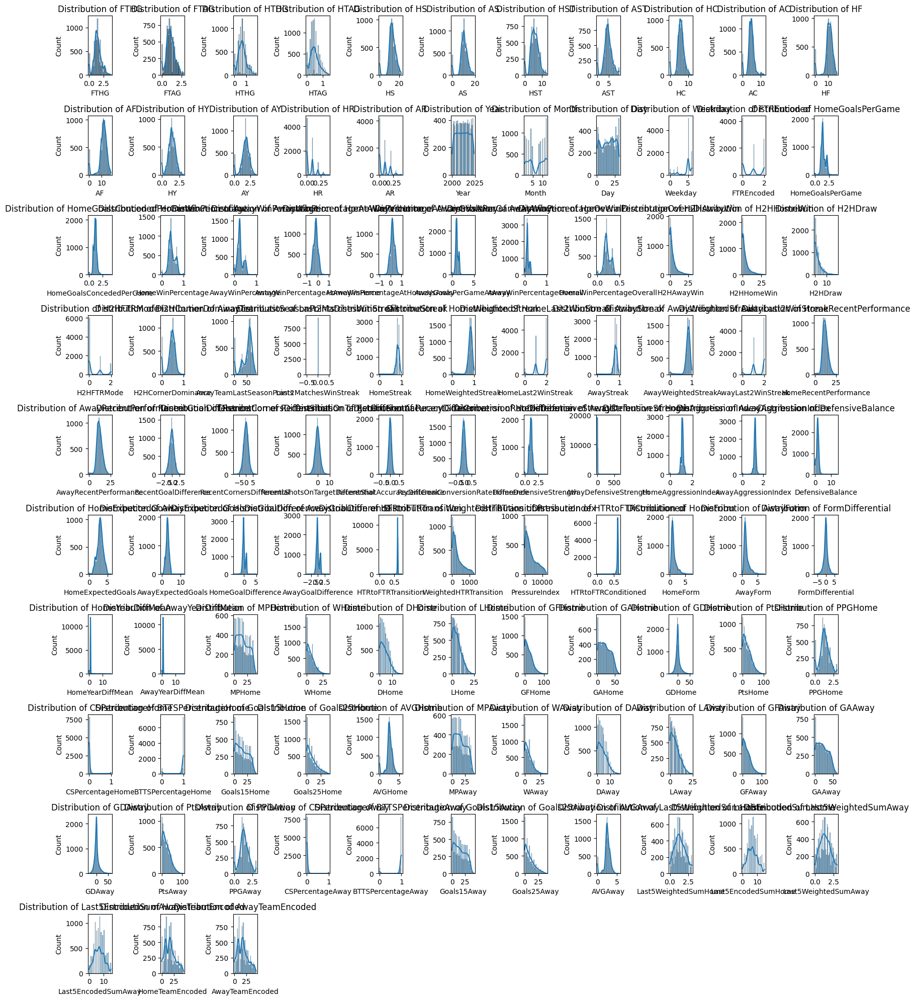

In [100]:
# Visualize distributions for numeric features
numeric_columns = df.select_dtypes(include=['float32', 'int32']).columns

plt.figure(figsize=(16, 20))
for i, col in enumerate(numeric_columns):
    plt.subplot(10, 11, i + 1)
    sns.histplot(df[col], kde=True, bins=30)
    plt.title(f'Distribution of {col}')
    plt.tight_layout()
plt.show()

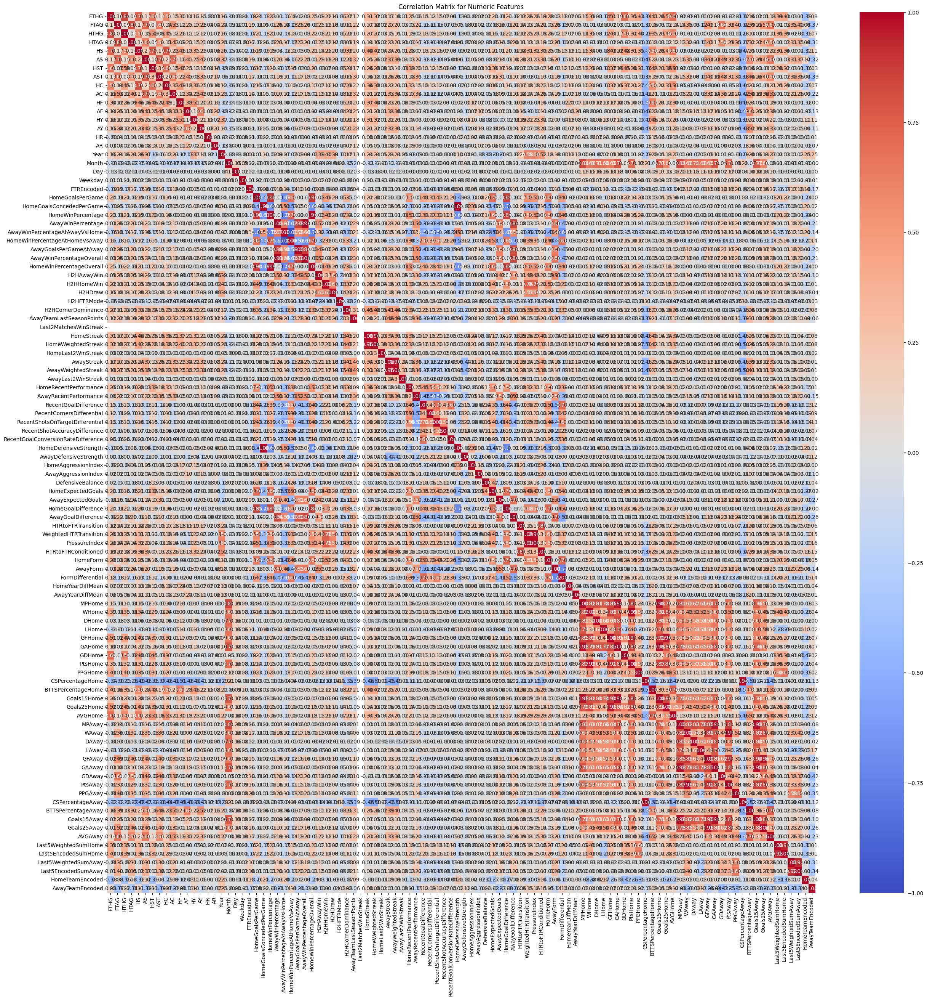

In [101]:
# Correlation matrix for numeric features
numeric_df = df.select_dtypes(include=['number'])

correlation_matrix = numeric_df.corr()

plt.figure(figsize=(30, 30))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title("Correlation Matrix for Numeric Features")
plt.show()

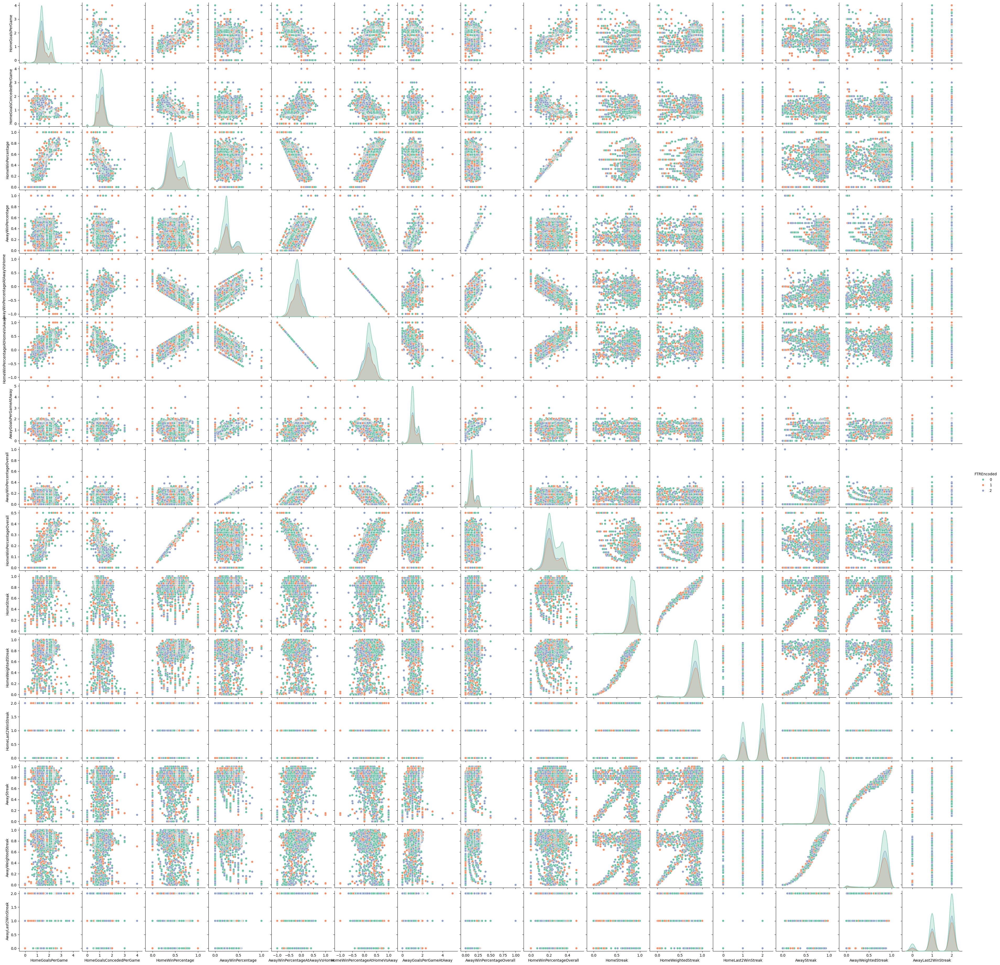

In [102]:
# Pairplot for selected features
selected_features = [
       'HomeGoalsPerGame', 'HomeGoalsConcededPerGame', 'HomeWinPercentage',
       'AwayWinPercentage', 'AwayWinPercentageAtAwayVsHome',
       'HomeWinPercentageAtHomeVsAway', 'AwayGoalsPerGameAtAway',
       'AwayWinPercentageOverall', 'HomeWinPercentageOverall','HomeStreak',
       'HomeWeightedStreak', 'HomeLast2WinStreak', 'AwayStreak',
       'AwayWeightedStreak', 'AwayLast2WinStreak', 'FTREncoded']
sns.pairplot(df[selected_features], hue='FTREncoded', diag_kind='kde', palette='Set2')
plt.show()

In [103]:
# Categorical feature value counts
categorical_columns = ['HomeTeamEncoded', 'AwayTeamEncoded']

for col in categorical_columns:
    print(f"Value Counts for {col}:")
    print(df[col].value_counts())
    print("\n")

Value Counts for HomeTeamEncoded:
HomeTeamEncoded
8     456
6     456
10    456
9     456
16    456
1     456
14    437
18    418
17    399
19    399
22    323
15    304
7     266
24    247
5     228
28    228
20    209
21    209
13    190
34    190
26    190
35    171
29    152
38    133
40    133
32    133
41    133
0     133
23    133
27    133
25    133
4     133
33     95
31     76
30     57
43     57
3      57
37     57
39     38
42     38
12     38
44     38
36     19
11     19
2      19
45     19
Name: count, dtype: int64


Value Counts for AwayTeamEncoded:
AwayTeamEncoded
8     456
16    456
10    456
6     456
1     456
9     456
14    437
18    418
17    399
19    399
22    323
15    304
7     266
24    247
28    228
5     228
21    209
20    209
34    190
13    190
26    190
35    171
29    152
40    133
38    133
41    133
27    133
32    133
25    133
23    133
4     133
0     133
33     95
31     76
43     57
30     57
3      57
37     57
44     38
42     38
12     38
39

C:\Users\jc\AppData\Local\Temp\ipykernel_8108\3014321035.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set3')
C:\Users\jc\AppData\Local\Temp\ipykernel_8108\3014321035.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set3')


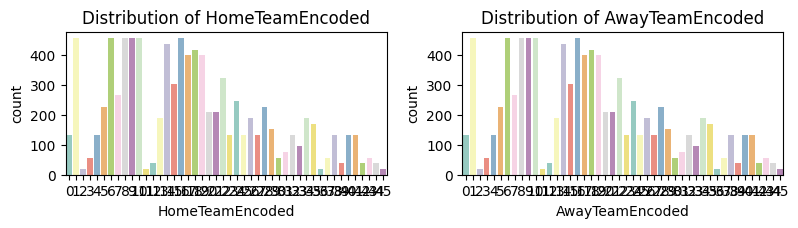

In [104]:
# Visualization of categorical features
plt.figure(figsize=(12, 8))
for i, col in enumerate(categorical_columns):
    plt.subplot(2, 2, i + 1)
    sns.countplot(x=col, data=df, palette='Set3')
    plt.title(f'Distribution of {col}')
    plt.tight_layout()
plt.show()

C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1083016479.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='FTREncoded', y=col, data=df, palette='Set2')
C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1083016479.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='FTREncoded', y=col, data=df, palette='Set2')
C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1083016479.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='FTREncoded', y=col, data=df, palette='Set2')
C:\Users\jc\AppData\Local\Temp\ipykernel_8108\1083016479.py:8: FutureWarning

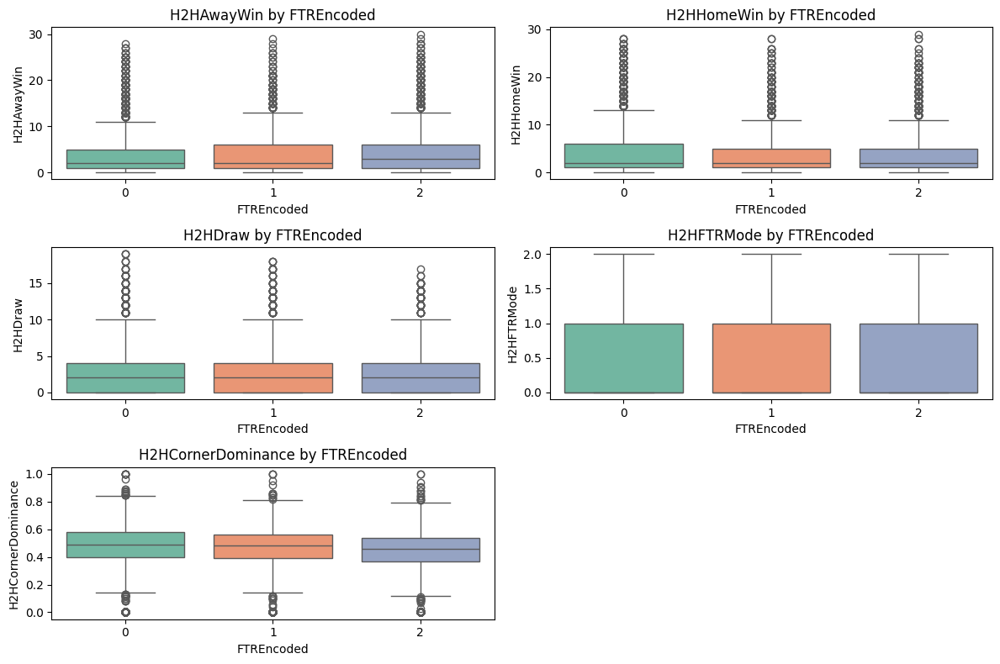

In [105]:
# Analyze FTREncoded in relation to other features
target_relations = ['H2HAwayWin', 'H2HHomeWin', 'H2HDraw', 'H2HFTRMode', 'H2HCornerDominance',]

plt.figure(figsize=(12, 8))
for i, col in enumerate(target_relations):
    plt.subplot(3, 2, i + 1)
    sns.boxplot(x='FTREncoded', y=col, data=df, palette='Set2')
    plt.title(f'{col} by FTREncoded')
    plt.tight_layout()
plt.show()

Correlation of Features with FTREncoded:


FTREncoded               1.000000
PPGAway                  0.201833
FTAG                     0.191644
AS                       0.188165
Last5EncodedSumAway      0.184373
                           ...   
Last5EncodedSumHome     -0.173561
PPGHome                 -0.185785
GDHome                  -0.187634
FTHG                    -0.190979
Last2MatchesWinStreak         NaN
Name: FTREncoded, Length: 102, dtype: float64

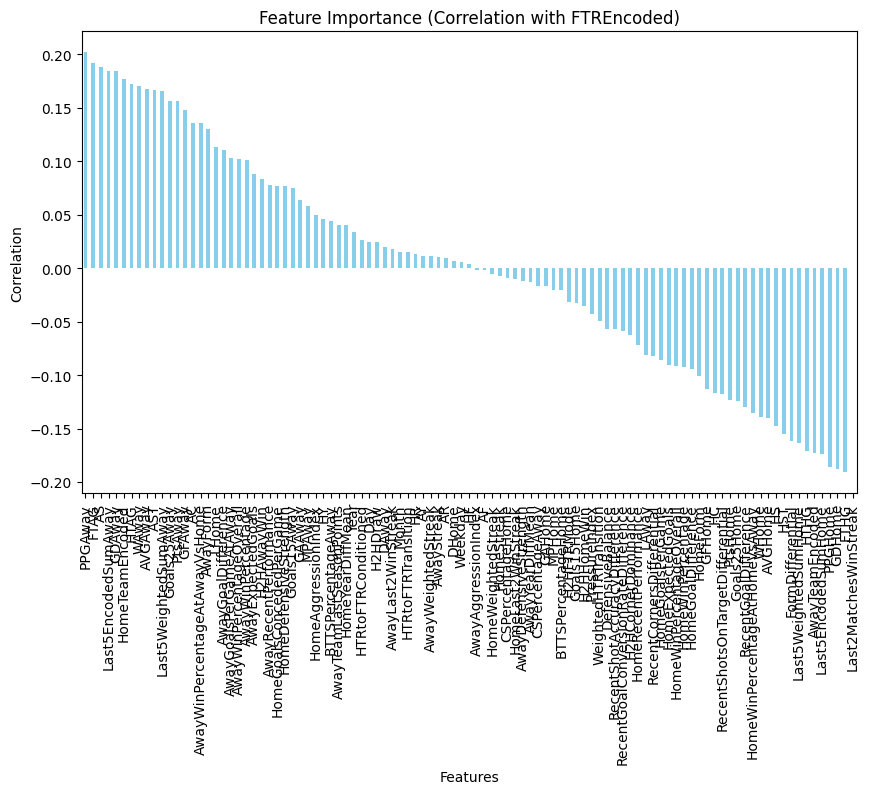

In [106]:
# Correlation of features with the target feature (FTREncoded)
target_correlation = correlation_matrix['FTREncoded'].sort_values(ascending=False)

print("Correlation of Features with FTREncoded:")
display(target_correlation)

# Bar plot of feature importance by correlation
plt.figure(figsize=(10, 6))
target_correlation.drop('FTREncoded').plot(kind='bar', color='skyblue')
plt.title("Feature Importance (Correlation with FTREncoded)")
plt.xlabel("Features")
plt.ylabel("Correlation")
plt.show()

## 3.6 Feature Selection

In [107]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.inspection import permutation_importance
from sklearn.feature_selection import SelectKBest, chi2

In [108]:
# selected_columns = [
#     # 'Date', 
#     # 'FTHG', 'FTAG', 'HTHG', 'HTAG', 
#     'HS', 'AS', 
#     # 'HST', 'AST', 
#     # 'HC',
#     # 'AC', 'HF', 'AF', 'HY', 'AY', 'HR', 'AR', 'Year',
#     'FTREncoded', 
#     # 'HomeGoalsPerGame', 'HomeGoalsConcededPerGame', 
#     'HomeWinPercentage',
#     'AwayWinPercentage', 
#     # 'AwayWinPercentageAtAwayVsHome',
#     # 'HomeWinPercentageAtHomeVsAway', 
#     # 'AwayGoalsPerGameAtAway',
#     'AwayWinPercentageOverall',
#     'HomeWinPercentageOverall', 
#     'H2HAwayWin',
#     'H2HHomeWin', 
#     # 'H2HDraw', 'H2HFTRMode', 'H2HCornerDominance',
#     # 'AwayTeamLastSeasonPoints', 
#     'HomeStreak',
#     # 'HomeWeightedStreak', 
#     # 'HomeLast2WinStreak', 
#     'AwayStreak',
#     # 'AwayWeightedStreak',
#     # 'AwayLast2WinStreak', 
#     'HomeRecentPerformance',
#     'AwayRecentPerformance', 
#     # 'RecentGoalDifference',
#     'RecentCornersDifferential', 'RecentShotsOnTargetDifferential',
#     'RecentShotAccuracyDifference', 'RecentGoalConversionRateDifference',
#     # 'HomeDefensiveStrength', 'AwayDefensiveStrength', 
#     # 'HomeAggressionIndex',
#     # 'AwayAggressionIndex', 'RefereeAggressionIndex', 
#     'DefensiveBalance',
#     'HomeExpectedGoals', 'AwayExpectedGoals', 
#     'HomeGoalDifference', 'AwayGoalDifference', 
#     # 'HTRtoFTRTransition', 'WeightedHTRTransition',
#     # 'PressureIndex', 'HTRtoFTRConditioned', 
#     'HomeForm', 'AwayForm', 'FormDifferential', 
#     # 'HomeYearDiffMean', 'AwayYearDiffMean',
# ]
selected_columns = [
    # 'MPHome', 
    # 'WHome', 
    # 'DHome', 
    # 'LHome', 
    # 'GFHome',
    # 'GAHome', 
    # 'GDHome', 
    'PtsHome', 
    'PPGHome', 
    'CSPercentageHome',
    # 'BTTSPercentageHome', 
    'Goals15Home', 'Goals25Home', 
    # 'AVGHome', 
    # 'MPAway',
    # 'WAway',
    # 'DAway', 
    # 'LAway', 
    # 'GFAway', 
    # 'GAAway', 
    # 'GDAway', 
    'PtsAway',
    'PPGAway', 
    'CSPercentageAway', 
    # 'BTTSPercentageAway', 
    'Goals15Away',
    'Goals25Away', 
    # 'AVGAway', 
    # 'Last5WeightedSumHome', 
    'Last5EncodedSumHome',
    # 'Last5WeightedSumAway', 
    'Last5EncodedSumAway',

    
    'HS', 'AS', 
    'FTREncoded', 
    # 'HomeWinPercentage',
    # 'AwayWinPercentage', 
    # 'AwayWinPercentageAtAwayVsHome',
    # 'HomeWinPercentageAtHomeVsAway', 
    'AwayGoalsPerGameAtAway',
    'AwayWinPercentageOverall',
    # 'HomeWinPercentageOverall', 
    # 'H2HAwayWin',
    # 'H2HHomeWin', 
    # 'HomeStreak',
    # 'AwayStreak',
    'HomeRecentPerformance',
    'AwayRecentPerformance', 
    'RecentCornersDifferential', 'RecentShotsOnTargetDifferential',
    'RecentShotAccuracyDifference', 'RecentGoalConversionRateDifference',
    'DefensiveBalance',
    'HomeExpectedGoals', 'AwayExpectedGoals', 
    'HomeGoalDifference', 'AwayGoalDifference',
    'HomeForm', 'AwayForm', 'FormDifferential', 
]

In [109]:
train_set = df[df["Year"] <= 2022][selected_columns]
validation_set = df[df["Year"] > 2022][selected_columns]
X_train = train_set.drop(columns=['FTREncoded'])
y_train = train_set['FTREncoded']
X_val = validation_set.drop(columns=['FTREncoded'])
y_val = validation_set['FTREncoded']

# Fit the scaler
scaler = MinMaxScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns, index=X_train.index)
X_val = pd.DataFrame(scaler.transform(X_val), columns=X_val.columns, index=X_val.index)

print("Training features shape:", X_train.shape)
print("Validation features shape:", X_val.shape)
print("Training labels shape:", y_train.shape)
print("Validation labels shape:", y_val.shape)

Training features shape: (8524, 30)
Validation features shape: (596, 30)
Training labels shape: (8524,)
Validation labels shape: (596,)


Chi-Square Feature Selection Results:
                Feature  Chi-Square Score       P-Value
9           Goals25Away         42.891657  4.855066e-10
6               PPGAway         33.340723  5.756439e-08
11  Last5EncodedSumAway         32.875797  7.262921e-08
5               PtsAway         29.227606  4.500969e-07
10  Last5EncodedSumHome         27.537354  1.047947e-06
1               PPGHome         25.811096  2.484230e-06
4           Goals25Home         24.510691  4.759607e-06
13                   AS         18.055398  1.200384e-04
0               PtsHome         16.825312  2.220393e-04
28             AwayForm         11.070823  3.944585e-03


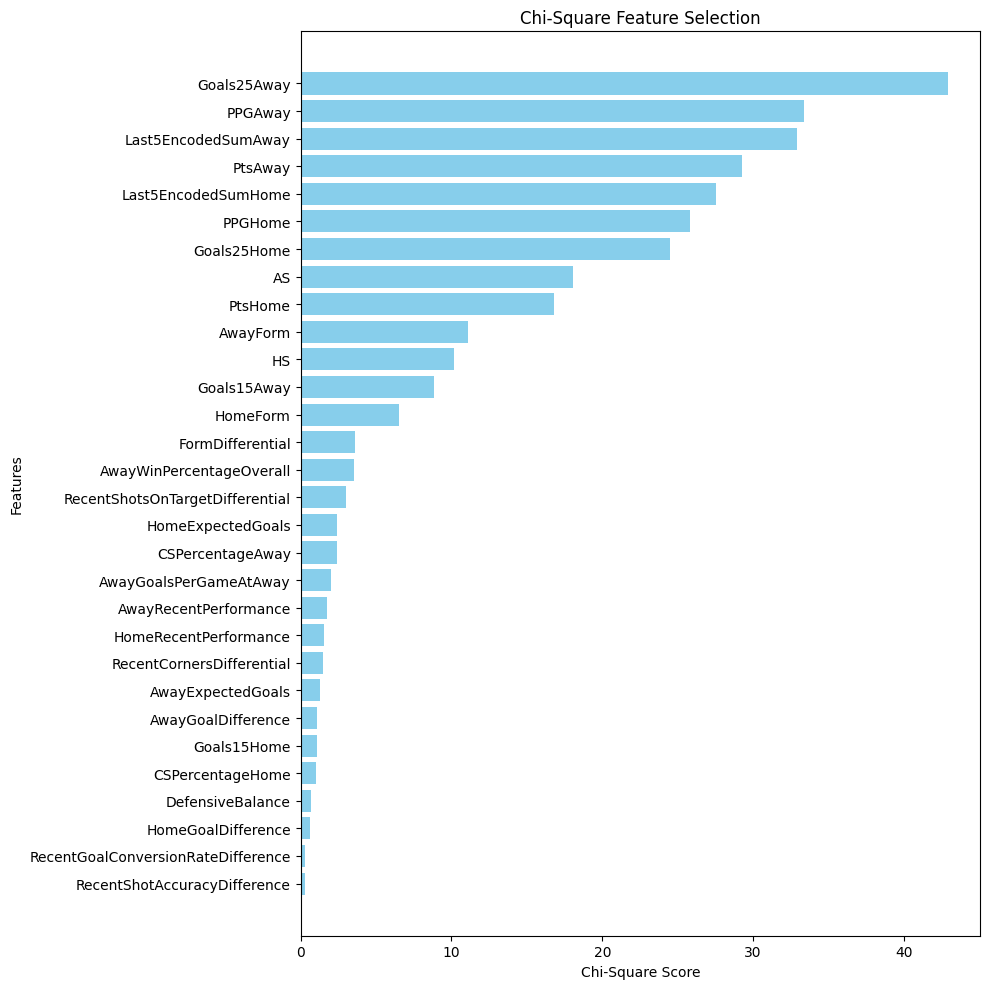

In [110]:
# Perform Chi-Square test
chi2_selector = SelectKBest(score_func=chi2, k='all')
chi2_selector.fit(X_train, y_train)

# Get Chi-Square scores and p-values
chi2_scores = chi2_selector.scores_
chi2_pvalues = chi2_selector.pvalues_

# Create a DataFrame for better visualization
chi2_results = pd.DataFrame({
    'Feature': X_train.columns,
    'Chi-Square Score': chi2_scores,
    'P-Value': chi2_pvalues
}).sort_values(by='Chi-Square Score', ascending=False)

# Display top features
print("Chi-Square Feature Selection Results:")
print(chi2_results.head(10))  # Display top 10 features

# Plot the Chi-Square scores
plt.figure(figsize=(10, 10))
plt.barh(chi2_results['Feature'], chi2_results['Chi-Square Score'], color='skyblue')
plt.xlabel('Chi-Square Score')
plt.ylabel('Features')
plt.title('Chi-Square Feature Selection')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.tight_layout()
plt.show()

In [ ]:
def plot_model_importance(models, X_val, y_val):
    for model_name, model in models.items():
        print(f"Evaluating importance for {model_name}...")
        result = permutation_importance(model, X_val, y_val, scoring='accuracy')
        feature_names = X_val.columns if hasattr(X_val, 'columns') else [f"Feature {i}" for i in range(X_val.shape[1])]
        importance = result.importances_mean

        sorted_idx = np.argsort(importance)[::-1]
        plt.figure(figsize=(10, 6))
        plt.barh(np.array(feature_names)[sorted_idx], importance[sorted_idx])
        plt.xlabel('Feature Importance')
        plt.title(f'Feature Importance for {model_name}')
        plt.gca().invert_yaxis()
        plt.show()

plot_model_importance(models, X_val, y_val)

# 4. Methodology Overview

In [114]:
import os
import time
import pickle
import itertools
from tqdm import tqdm

from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.svm import SVC, LinearSVC
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, classification_report, make_scorer
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.model_selection import cross_validate
from sklearn.inspection import permutation_importance
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.feature_selection import SelectKBest, mutual_info_classif

import tensorflow as tf
from tensorflow.keras.layers import (
    Input, LSTM, Dense, Dropout, Bidirectional, Conv1D, MaxPooling1D, Flatten, BatchNormalization,
    MultiHeadAttention, LayerNormalization, GlobalAveragePooling1D, Add, Multiply
)
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import backend as K

import torch
from pytorch_tabnet.tab_model import TabNetClassifier

import warnings
warnings.filterwarnings('ignore')

RANDOM_SEED = 42

NUM_FOLD = 5

In [116]:
print(train_set['FTREncoded'].value_counts(normalize=True))

FTREncoded
0    0.459057
2    0.291999
1    0.248944
Name: proportion, dtype: float64


In [117]:
#  Inverse weight of class proportion
inverse_class_proportion = {
    0: 1 / 0.459057,
    1: 1 / 0.248944,
    2: 1 / 0.291999
}

In [125]:
# Initialize model dictionary
tuning_models = {
    'KNN': KNeighborsClassifier(),
    'SVM': SVC(class_weight=inverse_class_proportion, random_state=RANDOM_SEED, probability=True),
    'LogisticRegression': LogisticRegression(random_state=RANDOM_SEED),
    'NaiveBayes': GaussianNB(),
    'DecisionTree': DecisionTreeClassifier(random_state=RANDOM_SEED),
    'RandomForest': RandomForestClassifier(random_state=RANDOM_SEED, verbose=0),
    'ExtraTrees': ExtraTreesClassifier(random_state=RANDOM_SEED, verbose=0),
    'XGBoost': XGBClassifier(random_state=RANDOM_SEED, verbosity=0),
    'LightGBM': LGBMClassifier(random_state=RANDOM_SEED, verbose=-1),
    'CatBoost': CatBoostClassifier(random_state=RANDOM_SEED, verbose=0),
    'GradientBoosting': GradientBoostingClassifier(random_state=RANDOM_SEED, verbose=0)
}

scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision_weighted',
    'recall': 'recall_weighted',
    'f1_weighted': 'f1_weighted'
}

# 5. Model Training & Validation

## 5.1 Ablation studies via modeling

### 5.1.1 Experiements

In [200]:
features_to_ablate = ['Year', 'HomeTeamEncoded', 'AwayTeamEncoded', 'HTRtoFTRTransition', 'WeightedHTRTransition', 'PressureIndex', 'HTRtoFTRConditioned']
ablation_features = selected_columns + features_to_ablate
train_set_ablation = df[df["Year"] <= 2022][ablation_features]
validation_set_ablation = df[df["Year"] > 2022][ablation_features]

In [ ]:
# Initialize storage for results
ablation_results = []

# Loop through the features to perform ablation
for feature in [None] + features_to_ablate:  
    if feature is not None:
        X_train_data = train_set_ablation.drop(columns=['FTREncoded', feature])
        y_train_data = train_set_ablation['FTREncoded']
        X_val_data = validation_set_ablation.drop(columns=['FTREncoded', feature])
        y_val_data = validation_set_ablation['FTREncoded']
        ablation_name = f"Without {feature}"
    else:
        X_train_data = train_set_ablation.drop(columns=['FTREncoded'])
        y_train_data = train_set_ablation['FTREncoded']
        X_val_data = validation_set_ablation.drop(columns=['FTREncoded'])
        y_val_data = validation_set_ablation['FTREncoded']
        ablation_name = "All Features"

    # Standardize the data
    scaler = MinMaxScaler()
    X_train_data = scaler.fit_transform(X_train_data)
    X_val_data = scaler.transform(X_val_data)

    # Initialize metrics storage
    model_names = []
    cv_mean_accuracies = []
    cv_std_accuracies = []
    cv_mean_precisions = []
    cv_std_precisions = []
    cv_mean_recalls = []
    cv_std_recalls = []
    cv_mean_f1s = []
    cv_std_f1s = []
    holdout_accuracies = []
    holdout_precisions = []
    holdout_recalls = []
    holdout_f1s = []
    holdout_cms = []

    # Train and evaluate each model
    for model_name, model in tqdm(tuning_models.items(), desc=f"Training models for {ablation_name}"):
        # Perform cross-validation
        cv_results = cross_validate(model, X_train_data, y_train_data, cv=NUM_FOLD, scoring=scoring, n_jobs=-1)

        # Compute CV mean and std for metrics
        cv_mean_accuracy = np.mean(cv_results['test_accuracy'])
        cv_std_accuracy = np.std(cv_results['test_accuracy'])
        cv_mean_precision = np.mean(cv_results['test_precision'])
        cv_std_precision = np.std(cv_results['test_precision'])
        cv_mean_recall = np.mean(cv_results['test_recall'])
        cv_std_recall = np.std(cv_results['test_recall'])
        cv_mean_f1 = np.mean(cv_results['test_f1_weighted'])
        cv_std_f1 = np.std(cv_results['test_f1_weighted'])

        # Train and evaluate on the holdout set
        model.fit(X_train_data, y_train_data)
        y_pred = model.predict(X_val_data)

        holdout_acc = accuracy_score(y_val_data, y_pred)
        holdout_precision = precision_score(y_val_data, y_pred, average='weighted', zero_division=0)
        holdout_recall = recall_score(y_val_data, y_pred, average='weighted', zero_division=0)
        holdout_f1 = f1_score(y_val_data, y_pred, average='weighted', zero_division=0)
        holdout_cm = confusion_matrix(y_val_data, y_pred)

        # Store results
        model_names.append(model_name)
        cv_mean_accuracies.append(cv_mean_accuracy)
        cv_std_accuracies.append(cv_std_accuracy)
        cv_mean_precisions.append(cv_mean_precision)
        cv_std_precisions.append(cv_std_precision)
        cv_mean_recalls.append(cv_mean_recall)
        cv_std_recalls.append(cv_std_recall)
        cv_mean_f1s.append(cv_mean_f1)
        cv_std_f1s.append(cv_std_f1)
        holdout_accuracies.append(holdout_acc)
        holdout_precisions.append(holdout_precision)
        holdout_recalls.append(holdout_recall)
        holdout_f1s.append(holdout_f1)
        holdout_cms.append((model_name, holdout_cm))

    # Append results for this ablation
    ablation_results.append(pd.DataFrame({
        'Model': model_names,
        'Ablation': ablation_name,
        'CV_Mean_Accuracy': cv_mean_accuracies,
        'CV_Std_Accuracy': cv_std_accuracies,
        'CV_Mean_Precision': cv_mean_precisions,
        'CV_Std_Precision': cv_std_precisions,
        'CV_Mean_Recall': cv_mean_recalls,
        'CV_Std_Recall': cv_std_recalls,
        'CV_Mean_F1': cv_mean_f1s,
        'CV_Std_F1': cv_std_f1s,
        'Holdout_Accuracy': holdout_accuracies,
        'Holdout_Precision': holdout_precisions,
        'Holdout_Recall': holdout_recalls,
        'Holdout_F1': holdout_f1s
    }))

# Combine results into a single DataFrame
ablation_results_df = pd.concat(ablation_results, ignore_index=True)

# Save results to CSV
ablation_results_df.to_csv(os.path.join(data_dir, "ablation_results.csv"), index=False)
ablation_results_df

Training models for Without HTRtoFTRTransition:  82%|████████████████████████████▋      | 9/11 [03:13<00:30, 15.19s/it]

In [ ]:
def plot_all_vs_ablation_with_errorbars(
    ablation_results_df,
    baseline_label='All Features',
    ablation_name='Without Year',
    metric='Accuracy', 
    cv_prefix='CV_Mean', cv_std_prefix='CV_Std',
    holdout_prefix='Holdout',
    figsize=(12, 6)
):
    """
    Compare the performance of "All Features" with a specified Ablation on a given metric in a single plot.
    Each model will have 4 bars:
      1. CV_Mean_[metric] for "All Features" (with CV_Std error bars)
      2. Holdout_[metric] for "All Features" (without error bars)
      3. CV_Mean_[metric] for the specified Ablation (with CV_Std error bars)
      4. Holdout_[metric] for the specified Ablation (without error bars)
    
    Parameters:
    - ablation_results_df: DataFrame containing results for "All Features" and other Ablations.
      Must include columns: ['Ablation', 'Model', 'CV_Mean_[metric]', 'CV_Std_[metric]', 'Holdout_[metric]']
    - baseline_label: The label for the baseline Ablation, e.g., 'All Features'
    - ablation_name: The name of the Ablation to compare against
    - metric: The metric to compare, e.g., 'Accuracy'
    - cv_prefix: Prefix for CV mean values (default: 'CV_Mean')
    - cv_std_prefix: Prefix for CV standard deviation (default: 'CV_Std')
    - holdout_prefix: Prefix for Holdout values (default: 'Holdout')
    - figsize: Size of the plot
    """
    
    df = ablation_results_df.set_index(['Ablation', 'Model'])
    
    baseline_df = df.loc[baseline_label]
    ablation_df = df.loc[ablation_name]
    
    models = baseline_df.index
    
    cv_mean_col = f"{cv_prefix}_{metric}"
    cv_std_col = f"{cv_std_prefix}_{metric}"
    holdout_col = f"{holdout_prefix}_{metric}"
    
    all_cv_mean_values = baseline_df[cv_mean_col].values
    all_cv_std_values = baseline_df[cv_std_col].values
    all_holdout_values = baseline_df[holdout_col].values

    abl_cv_mean_values = ablation_df[cv_mean_col].values
    abl_cv_std_values = ablation_df[cv_std_col].values
    abl_holdout_values = ablation_df[holdout_col].values
    
    x = np.arange(len(models))
    width = 0.2
    
    fig, ax = plt.subplots(figsize=figsize)

    bars_all_cv = ax.bar(x - 1.5*width, all_cv_mean_values, width, 
                         yerr=all_cv_std_values, capsize=5, label=f'All {cv_mean_col}', 
                         color='blue', alpha=0.7)

    bars_all_holdout = ax.bar(x - 0.5*width, all_holdout_values, width, 
                              label=f'All {holdout_col}', color='lightblue', alpha=0.7)

    bars_abl_cv = ax.bar(x + 0.5*width, abl_cv_mean_values, width, 
                         yerr=abl_cv_std_values, capsize=5, label=f'{ablation_name} {cv_mean_col}', 
                         color='orange', alpha=0.7)

    bars_abl_holdout = ax.bar(x + 1.5*width, abl_holdout_values, width, 
                              label=f'{ablation_name} {holdout_col}', color='yellow', alpha=0.7)

    ax.set_xticks(x)
    ax.set_xticklabels(models, rotation=45, ha='right')
    ax.set_ylabel(metric)
    ax.set_title(f"{baseline_label} vs {ablation_name} - {metric}")

    ax.legend()

    # View value above bar
    def autolabel(bars):
        for bar in bars:
            height = bar.get_height()
            ax.annotate(f'{height:.3f}',
                        xy=(bar.get_x() + bar.get_width()/2, height),
                        xytext=(0, 3),
                        textcoords="offset points",
                        ha='center', va='bottom', fontsize=8)
    
    autolabel(bars_all_cv)
    autolabel(bars_all_holdout)
    autolabel(bars_abl_cv)
    autolabel(bars_abl_holdout)

    fig.tight_layout()
    plt.show()

### 5.1.2 Visualizations

#### Year

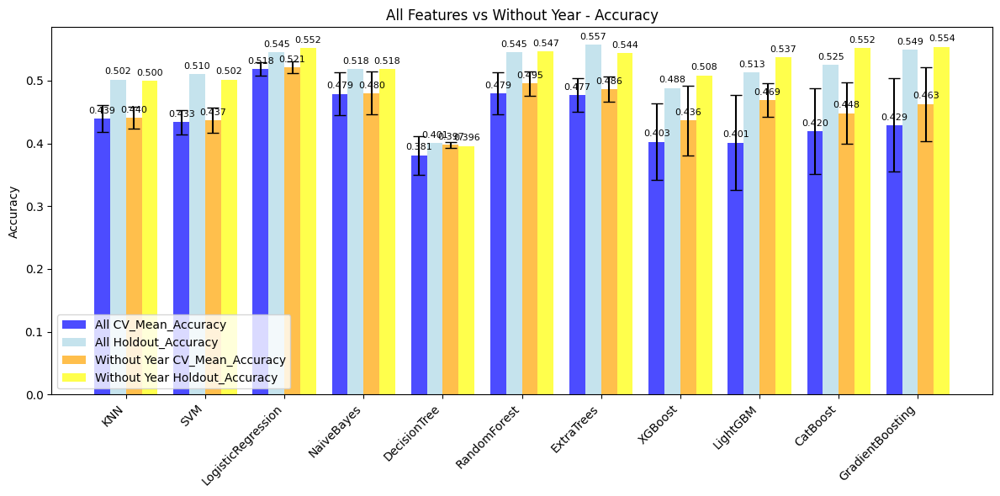

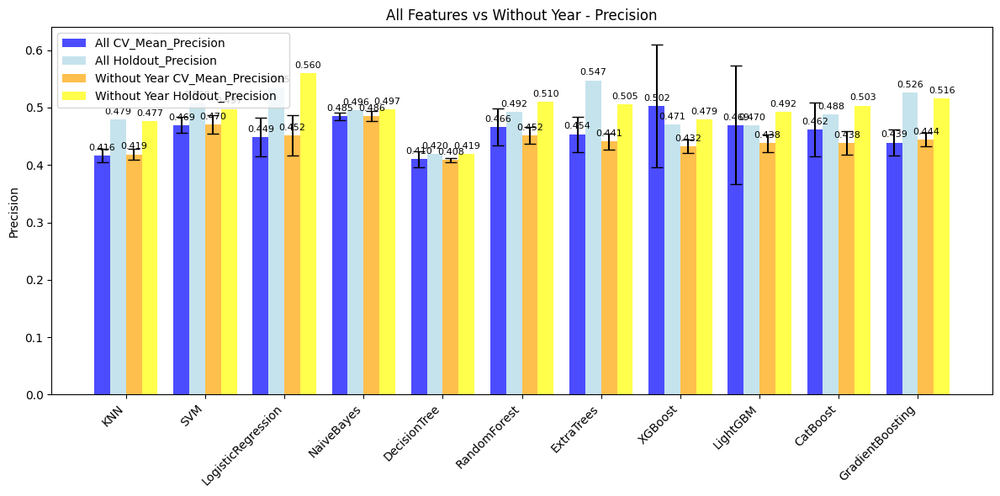

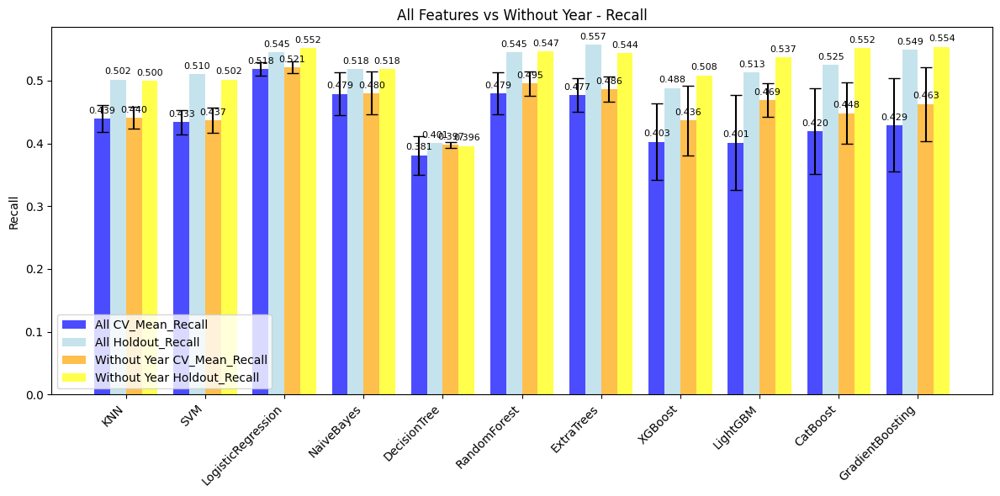

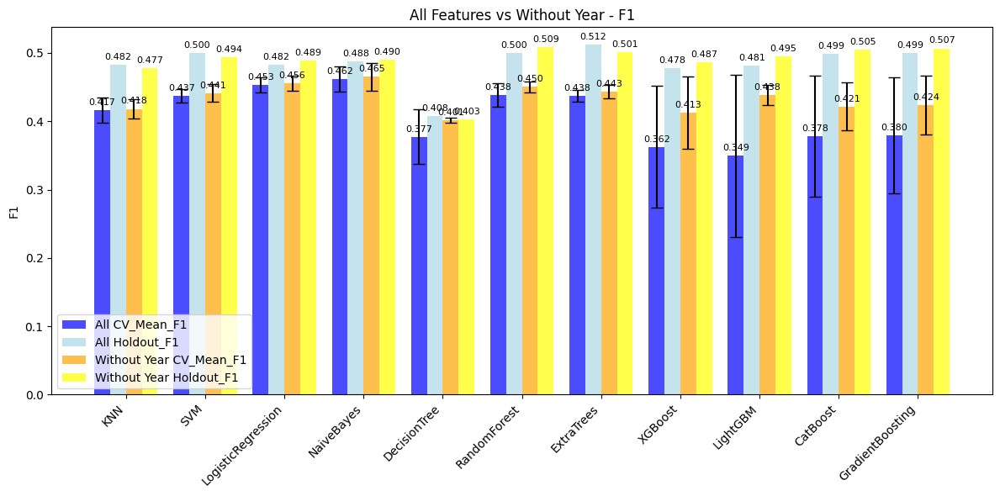

In [66]:
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without Year', metric='Accuracy')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without Year', metric='Precision')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without Year', metric='Recall')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without Year', metric='F1')

#### HomeTeamEncoded

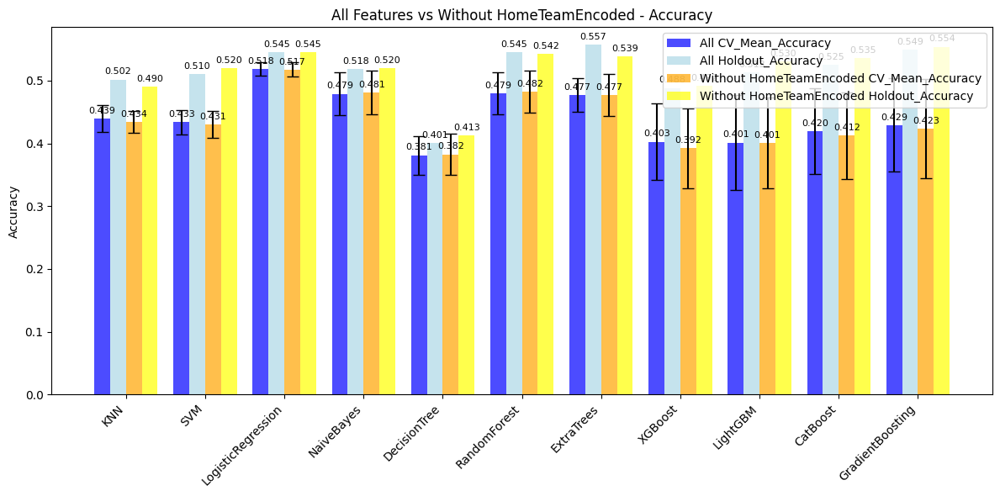

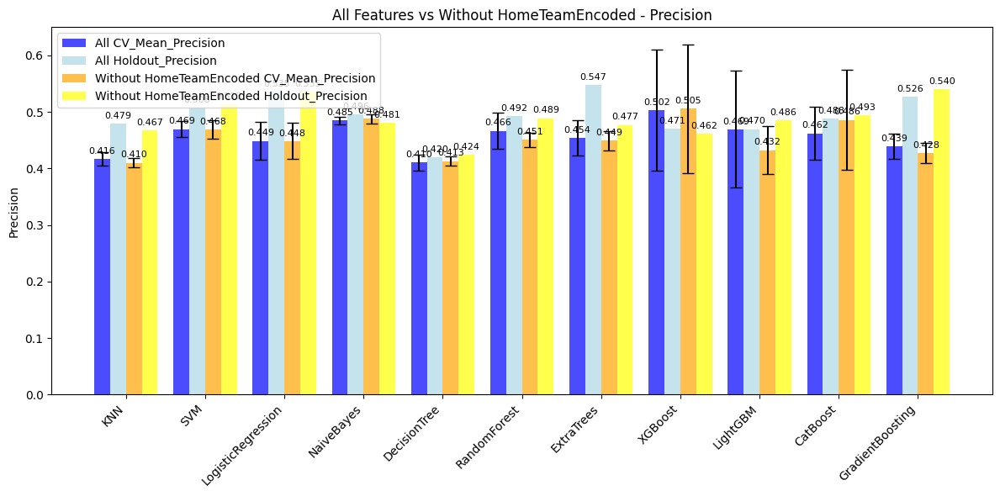

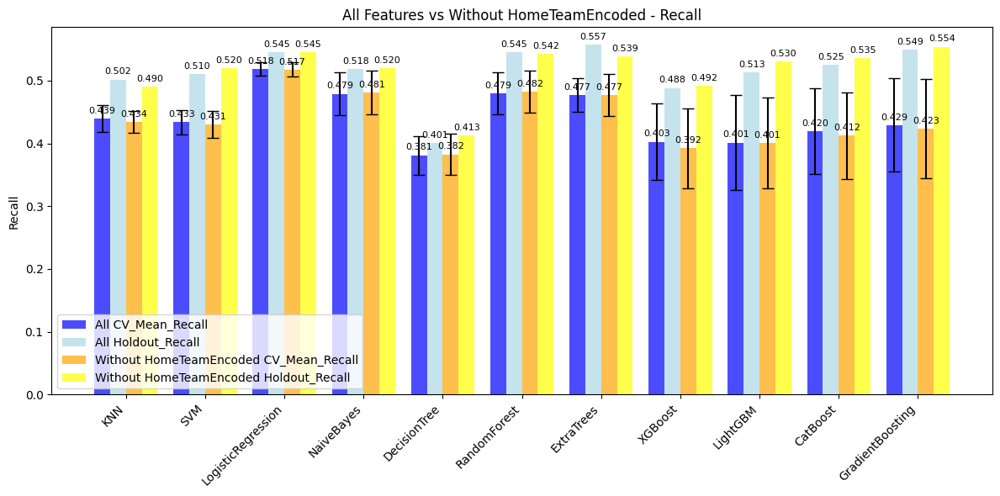

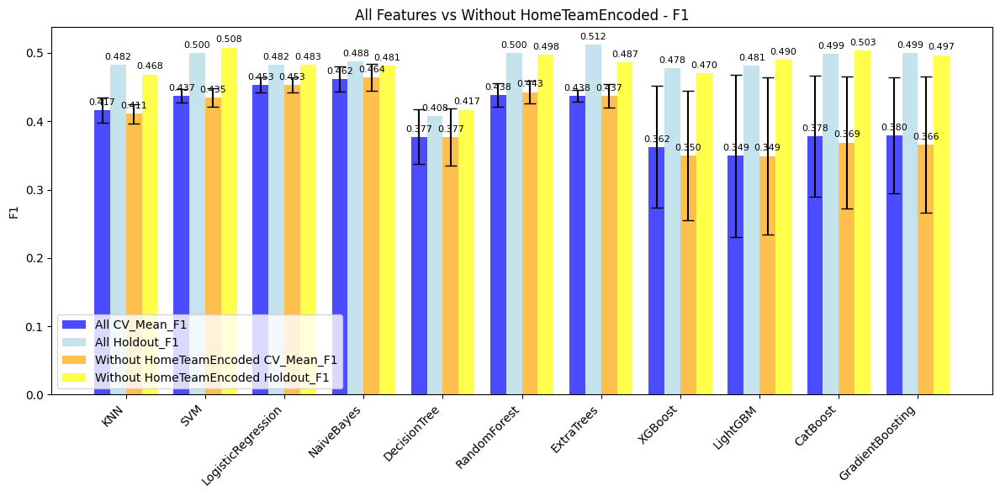

In [67]:
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HomeTeamEncoded', metric='Accuracy')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HomeTeamEncoded', metric='Precision')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HomeTeamEncoded', metric='Recall')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HomeTeamEncoded', metric='F1')

#### AwayTeamEncoded

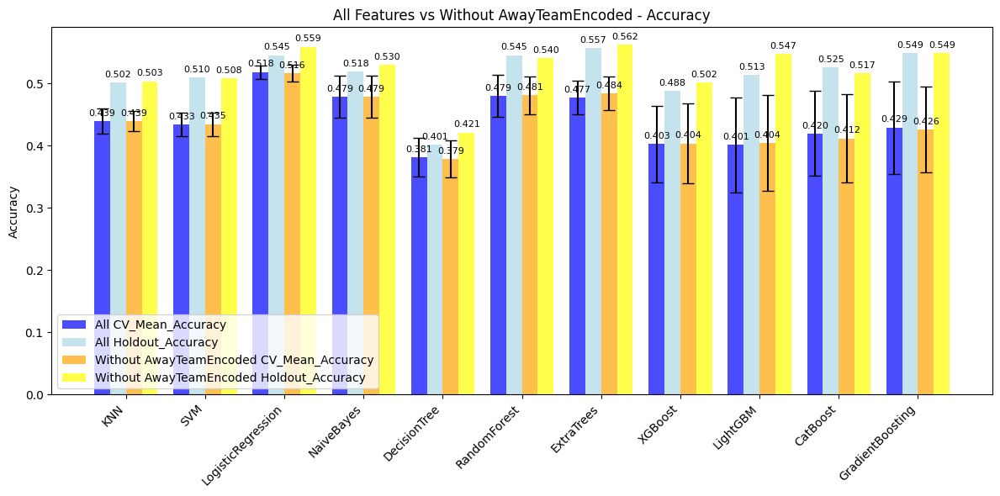

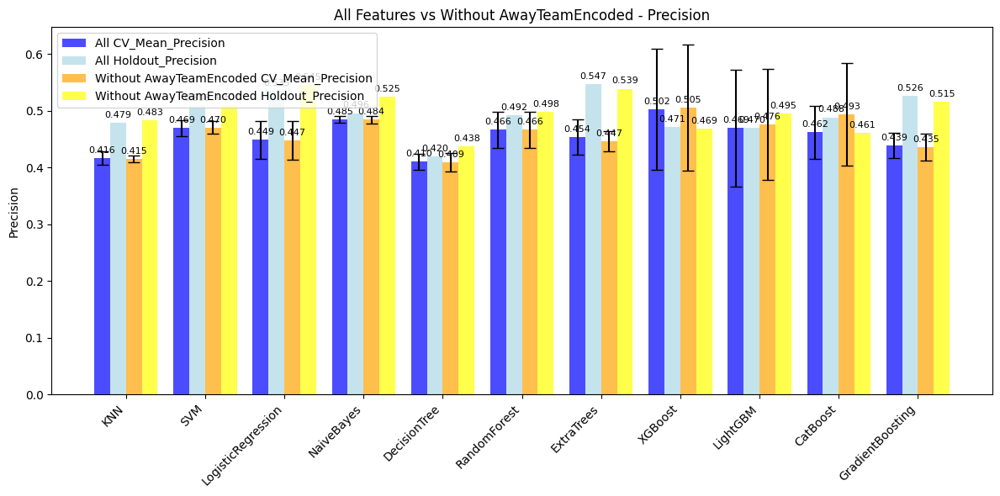

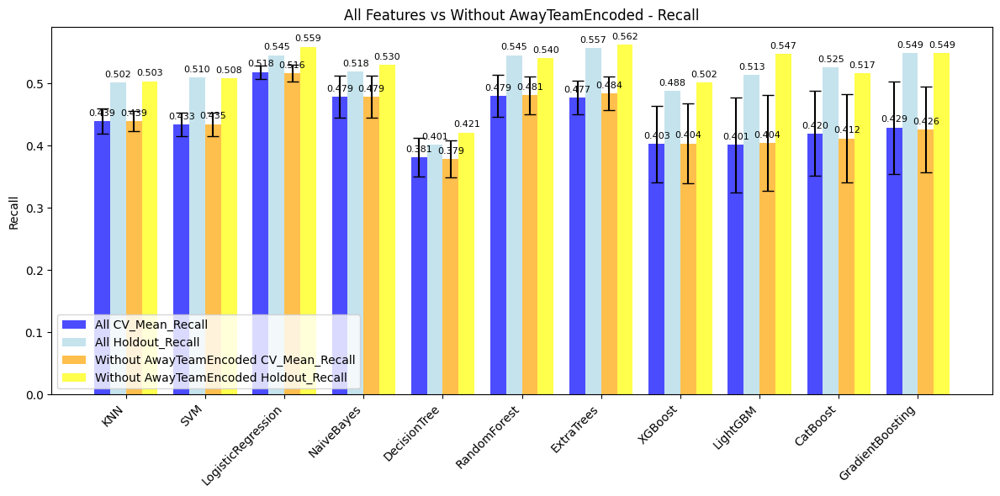

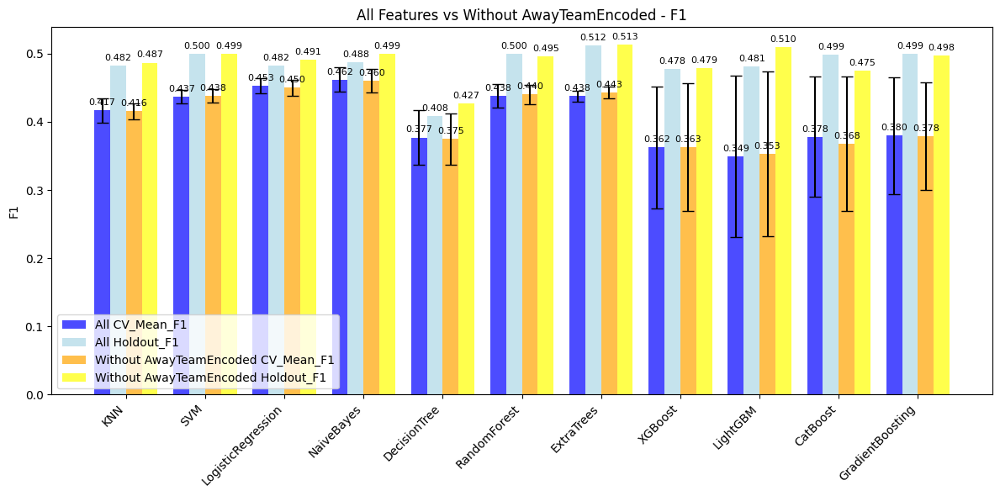

In [68]:
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without AwayTeamEncoded', metric='Accuracy')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without AwayTeamEncoded', metric='Precision')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without AwayTeamEncoded', metric='Recall')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without AwayTeamEncoded', metric='F1')

#### HTR

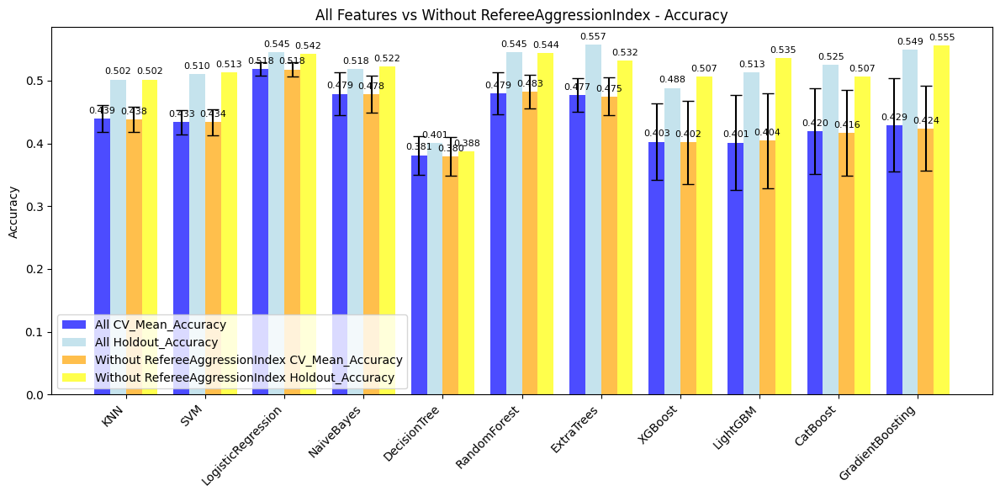

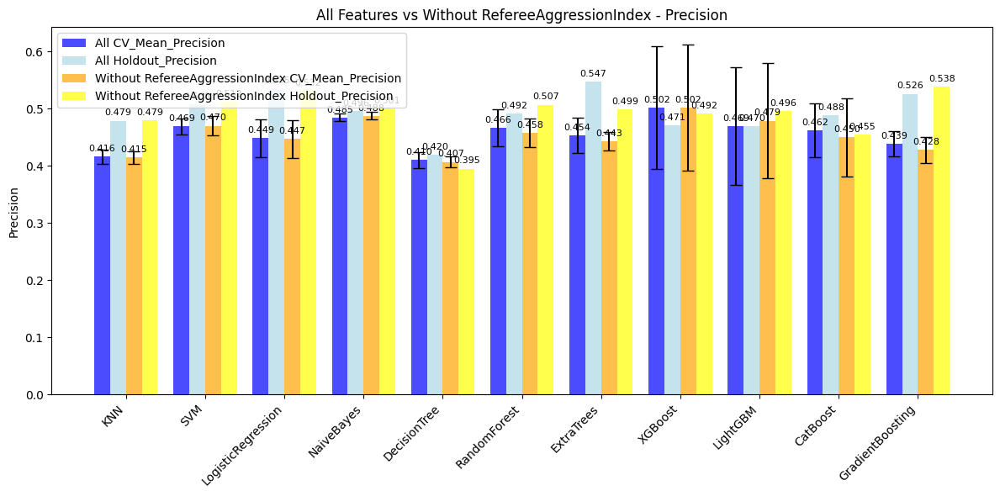

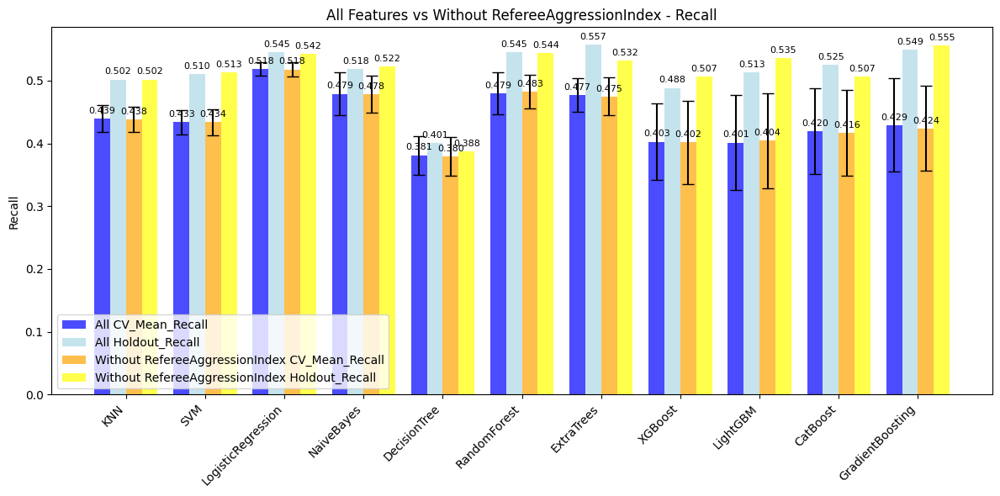

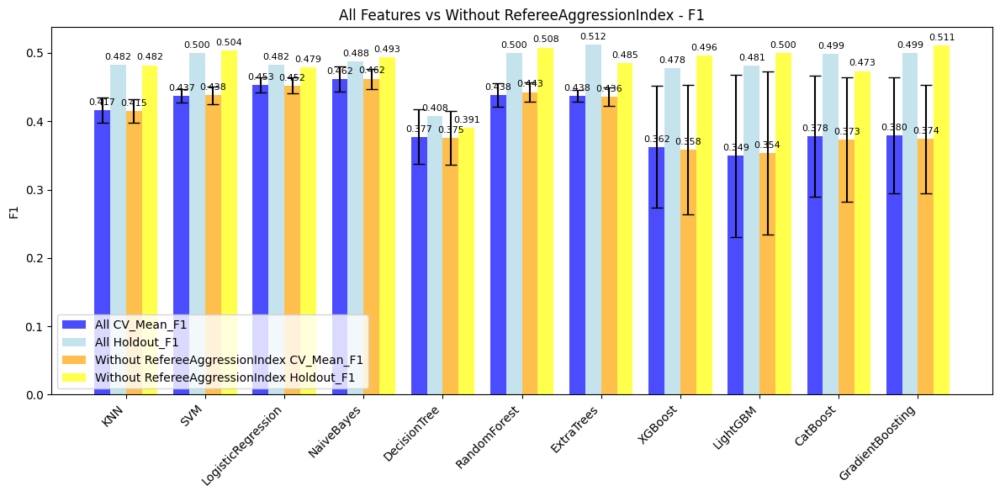

In [69]:
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HTRtoFTRTransition', metric='Accuracy')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HTRtoFTRTransition', metric='Precision')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HTRtoFTRTransition', metric='Recall')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HTRtoFTRTransition', metric='F1')

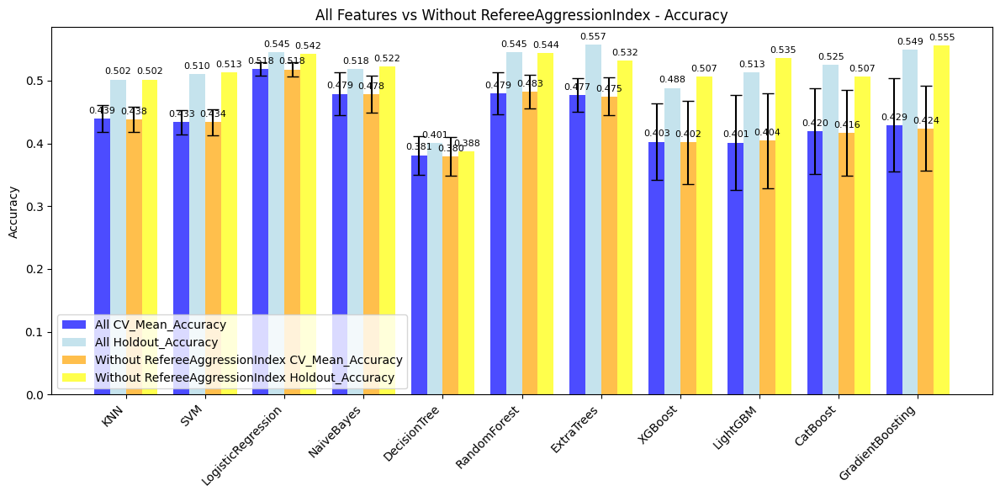

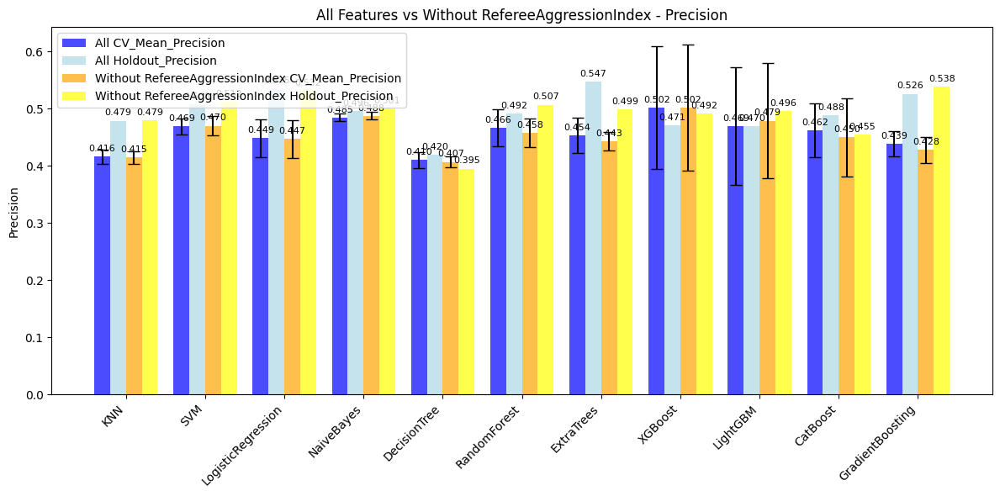

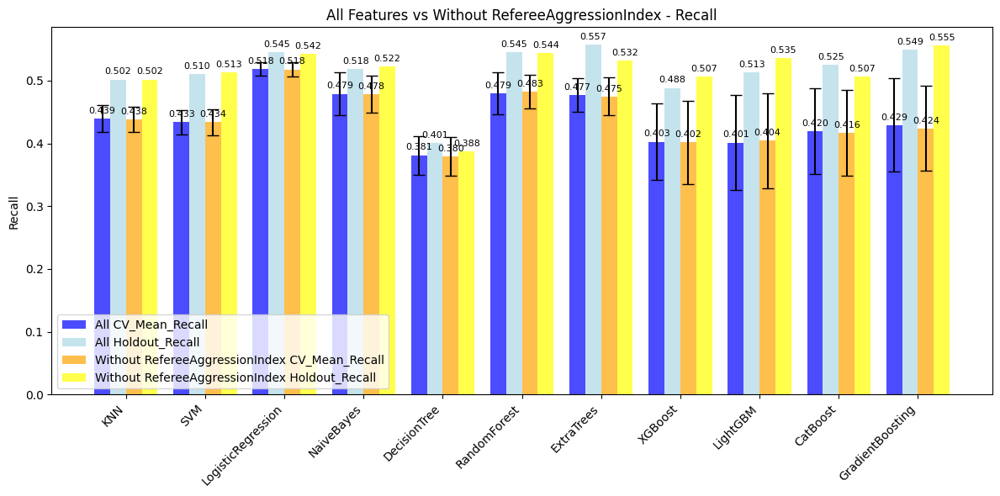

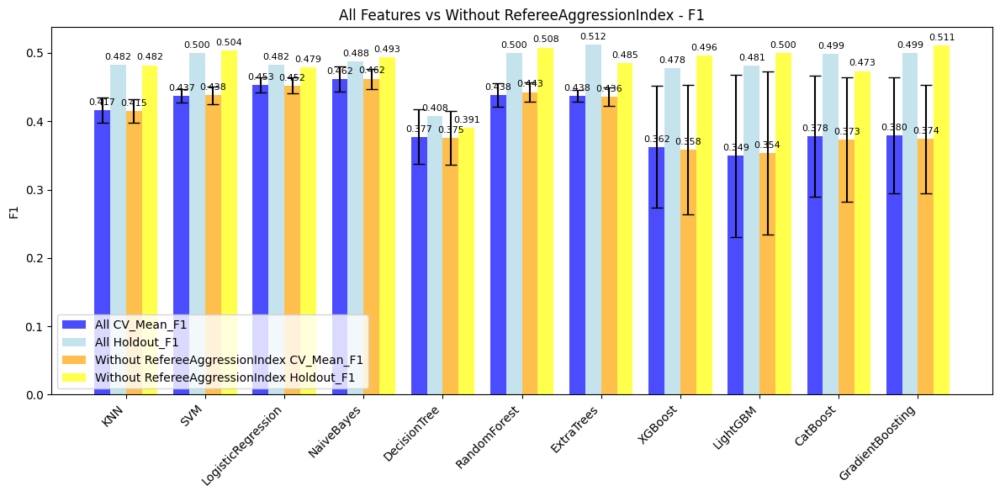

In [69]:
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without WeightedHTRTransition', metric='Accuracy')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without WeightedHTRTransition', metric='Precision')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without WeightedHTRTransition', metric='Recall')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without WeightedHTRTransition', metric='F1')

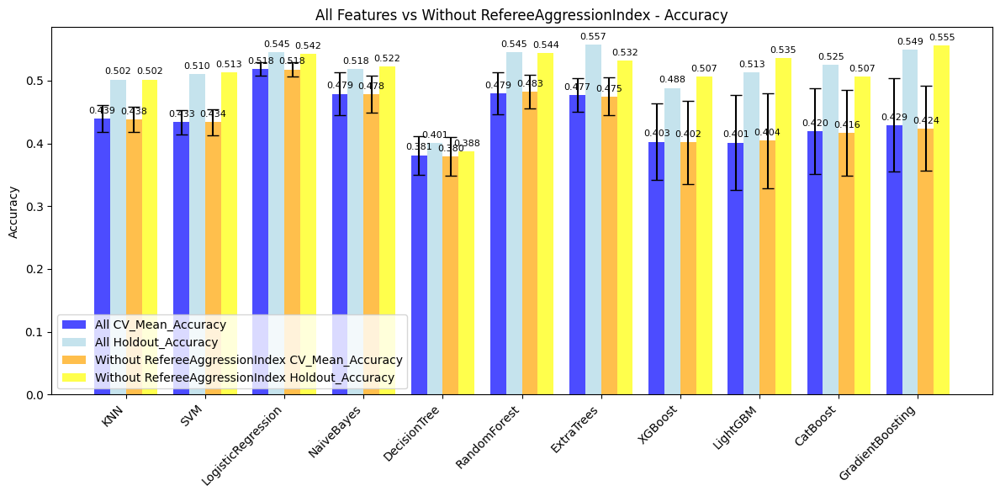

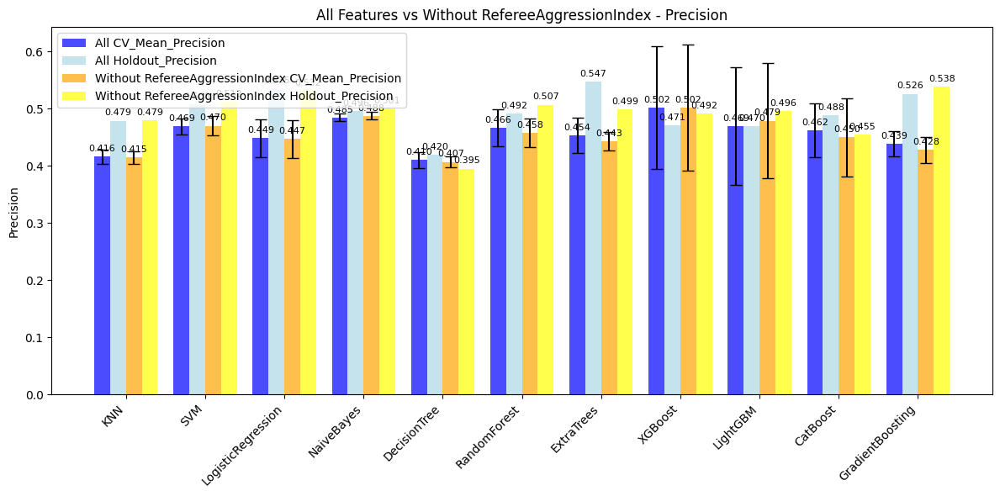

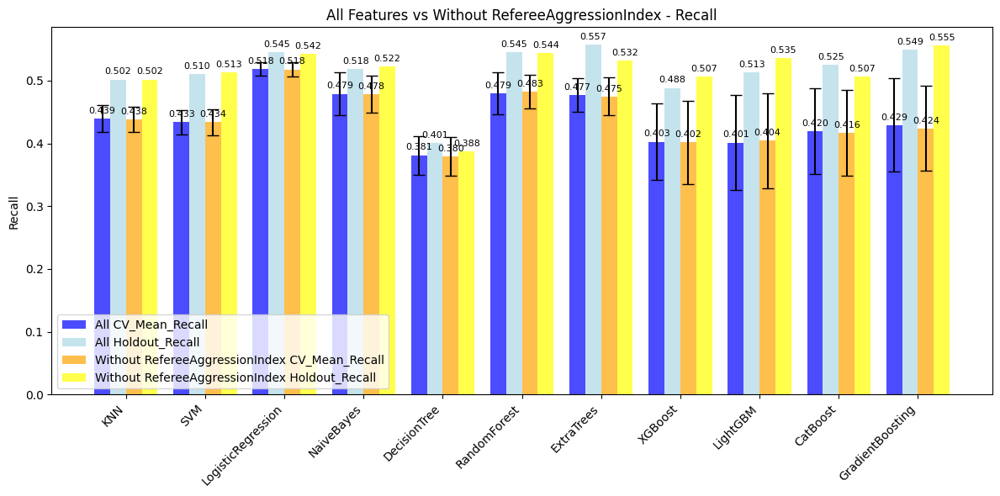

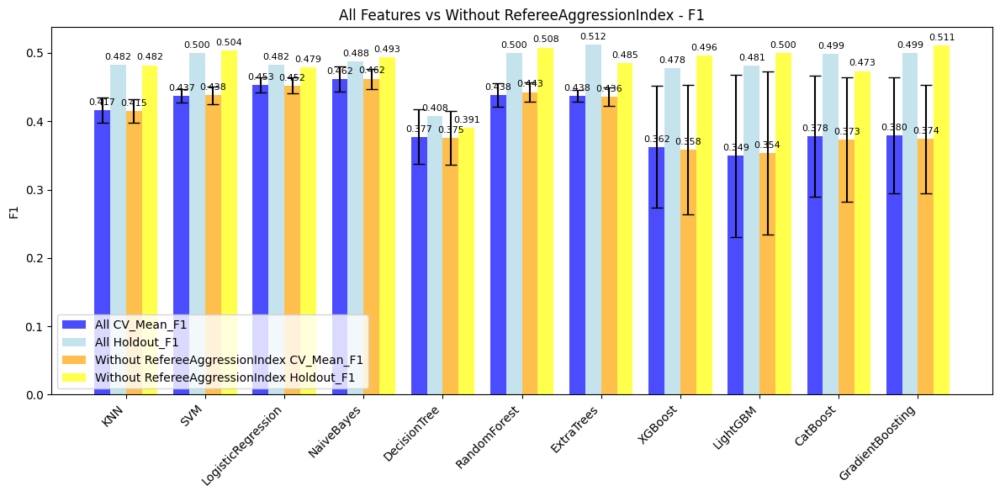

In [69]:
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without PressureIndex', metric='Accuracy')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without PressureIndex', metric='Precision')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without PressureIndex', metric='Recall')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without PressureIndex', metric='F1')

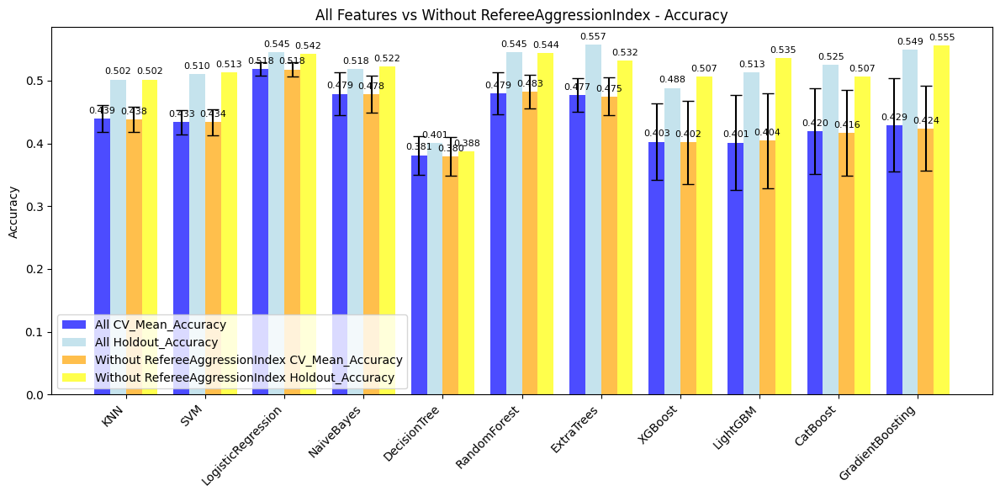

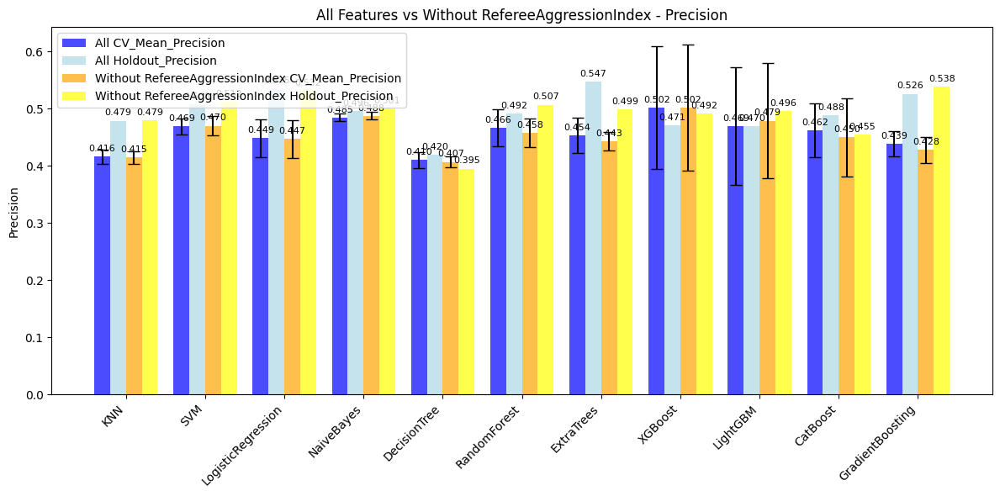

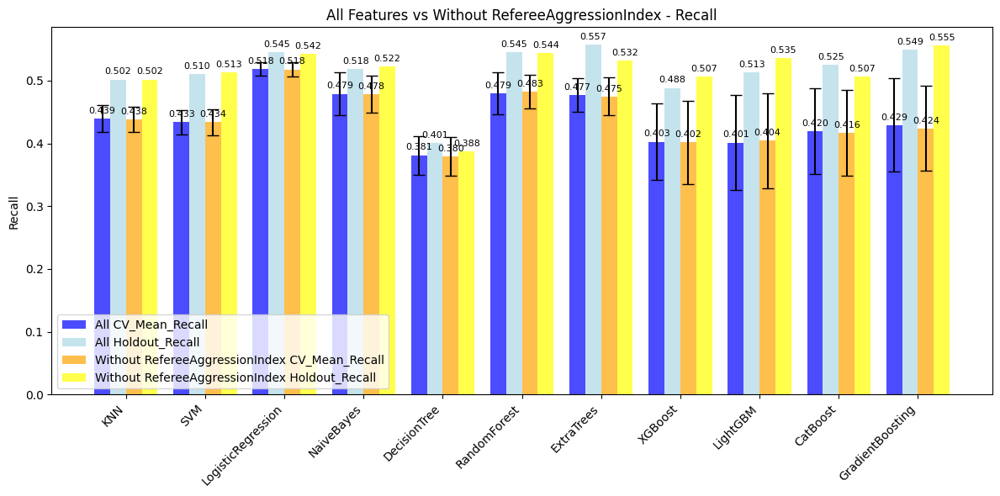

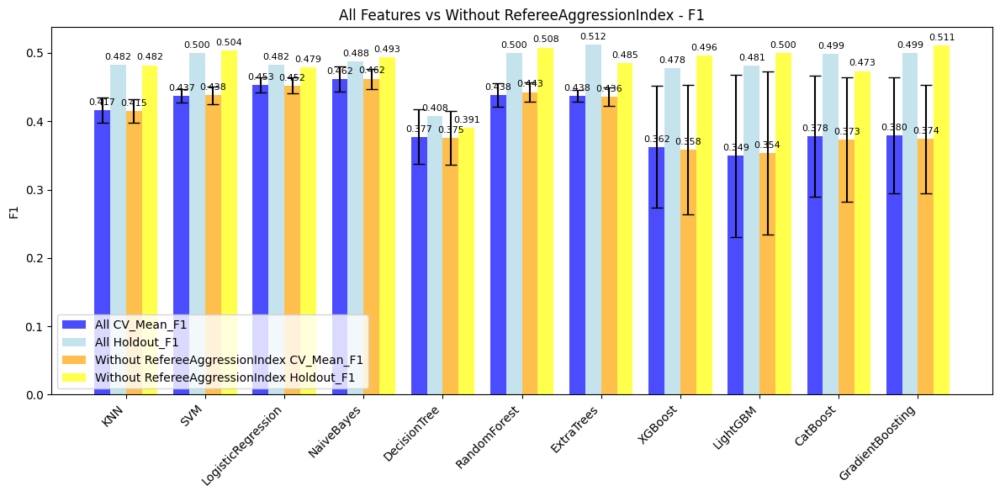

In [69]:
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HTRtoFTRConditioned', metric='Accuracy')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HTRtoFTRConditioned', metric='Precision')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HTRtoFTRConditioned', metric='Recall')
plot_all_vs_ablation_with_errorbars(ablation_results_df, baseline_label='All Features', ablation_name='Without HTRtoFTRConditioned', metric='F1')

## 5.2 Training with Traditional ML Models

### 5.2.1 Hyperparameter Tuning Setup

In [119]:
param_grids = {
    'KNN': {
        'n_neighbors': [5, 7, 9, 11],
        'weights': ['uniform', 'distance'],
        'metric': ['minkowski', 'euclidean', 'manhattan']
    },
    'SVM': {
        'kernel': ['rbf', 'sigmoid'],
        'C': [1, 10, 100, 1000],
        'gamma': [0.001, 0.01, 0.1, 1]
    },
    'LogisticRegression': {
        'C': [0.1, 1, 10, 100],
        'penalty': ['l1', 'l2'],
        'solver': ['liblinear', 'saga']
    },
    'NaiveBayes': {
        'var_smoothing': [1e-9, 1e-8, 1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1.0]
    },
    'DecisionTree': {
        'criterion': ['gini', 'entropy'],
        'max_depth': [5, 10, 20],
        'min_samples_split': [2, 5, 10]
    },
    'RandomForest': {
        'n_estimators': [50, 100, 200],
        'max_depth': [10, 20],
        'class_weight': ['balanced', inverse_class_proportion]
    },
    'ExtraTrees': {
        'n_estimators': [50, 100, 200],
        'max_depth': [10, 20],
        'min_samples_split': [2, 5, 10]
    },
    'LightGBM': {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.2],
        'num_leaves': [31, 63, 127]
    },
    'XGBoost': {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 6, 10]
    },
    'CatBoost': {
        'depth': [4, 6, 8],
        'learning_rate': [0.01, 0.1, 0.2],
        'l2_leaf_reg': [1, 3, 5]
    },
    'GradientBoosting': {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.2],
        'min_samples_split': [2, 5, 10]
    }
}

best_params_dict = {}

In [120]:
def create_2d_mapping(param_grid):
    """
    Map a multi-dimensional parameter space into a 2D mapping.
    """
    keys = list(param_grid.keys())
    
    # Less than 2 parameters
    if len(keys) < 2:
        raise ValueError("Parameter grid must have at least two parameters for 2D mapping.")
    
    # 2 parameters: direct combination
    if len(keys) == 2:
        x_combinations = param_grid[keys[0]]
        y_combinations = param_grid[keys[1]]
    
    # 3 parameters: horizontal axis is keys[0] and keys[1], vertical axis is keys[2]
    elif len(keys) == 3:
        x_combinations = list(itertools.product(param_grid[keys[0]], param_grid[keys[1]]))
        y_combinations = param_grid[keys[2]]
    
    else:
        raise ValueError("Parameter grid must have at most four parameters for 2D mapping.")
    
    return x_combinations, y_combinations

def tune_and_plot_1d(model_name, model, param_grid, X_train, y_train):
    print(f"Tuning {model_name}...")
    default_params = model.get_params()

    # Define cross-validation
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    
    # Perform hyperparameter search using GridSearchCV
    grid_search = GridSearchCV(
        estimator=model,
        param_grid=param_grid,
        scoring='f1_weighted',
        cv=cv,
        n_jobs=-1,
        verbose=1
    )
    grid_search.fit(X_train, y_train)
    
    # Extract results
    results = grid_search.cv_results_
    mean_test_scores = results['mean_test_score']
    param_name = list(param_grid.keys())[0]  # The single parameter name
    param_values = param_grid[param_name]   # List of parameter values

    # Print the best hyperparameter combination
    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    print(f"Best parameters for {model_name}: {best_params}")
    print(f"Best CV F1 Weighted: {best_score:.4f}")
    merged_params = {**default_params, **best_params}
    best_params_dict[model_name] = merged_params
    
    # Construct heatmap data
    scores = np.array(mean_test_scores).reshape(1, -1)  # Convert to a 2D array with shape (1, n)
    x_labels = [f"{val:.1e}" for val in param_values]  # Format x-axis labels
    y_labels = ['']  # Placeholder for the y-axis

    # Adjust heatmap figure size
    plt.figure(figsize=(len(param_values) * 1.2, 2))  # Dynamically adjust width based on parameter count
    sns.heatmap(
        scores,
        annot=True,
        fmt=".4f",
        xticklabels=x_labels,
        yticklabels=False,
        cmap="coolwarm",
        cbar_kws={'label': 'Mean CV F1 Weighted'}
    )
    plt.title(f"{model_name} Hyperparameter Tuning")
    plt.xlabel(param_name)
    plt.tight_layout()
    plt.show()

def tune_and_plot_3d(model_name, model, param_grid, X_train, y_train):
    print(f"Tuning {model_name}...")
    default_params = model.get_params()
    # Define cross-validation
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    
    # Perform hyperparameter search using GridSearchCV
    grid_search = GridSearchCV(
        estimator=model,
        param_grid=param_grid,
        scoring='f1_weighted',
        cv=cv,
        n_jobs=-1,
        verbose=1
    )
    grid_search.fit(X_train, y_train)
    
    # Extract results
    results = grid_search.cv_results_
    mean_test_scores = results['mean_test_score']
    param_combinations = pd.DataFrame(grid_search.cv_results_['params'])
    param_combinations['mean_test_score'] = mean_test_scores
    
    # Print the best hyperparameter combination
    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    print(f"Best parameters for {model_name}: {best_params}")
    print(f"Best CV f1_weighted: {best_score:.4f}")
    merged_params = {**default_params, **best_params}
    best_params_dict[model_name] = merged_params
    
    # Map to 2D space: the first two parameters map to the horizontal axis, the 3rd parameter maps to the vertical axis
    keys = list(param_grid.keys())
    x_combinations = list(itertools.product(param_grid[keys[0]], param_grid[keys[1]]))
    y_combinations = param_grid[keys[2]]
    scores = np.zeros((len(y_combinations), len(x_combinations)))

    for i, x in enumerate(x_combinations):
        for j, y in enumerate(y_combinations):
            mask = (
                (param_combinations[keys[0]] == x[0]) &
                (param_combinations[keys[1]] == x[1]) &
                (param_combinations[keys[2]] == y)
            )
            if mask.any():
                scores[j, i] = param_combinations.loc[mask, 'mean_test_score'].values[0]
    
    # Plot heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(
        scores,
        annot=True,
        fmt=".4f",
        xticklabels=x_combinations,
        yticklabels=y_combinations,
        cmap="coolwarm", 
        cbar_kws={'label': 'Mean CV F1 Weighted'}
    )
    plt.title(f"{model_name} Hyperparameter Tuning")
    plt.xlabel(f"{keys[0]} and {keys[1]}")
    plt.ylabel(f"{keys[2]}")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

### 5.2.2 Model Tuning

Tuning all models:   0%|                                                                        | 0/11 [00:00<?, ?it/s]

Tuning KNN...
Fitting 5 folds for each of 24 candidates, totalling 120 fits
Best parameters for KNN: {'metric': 'minkowski', 'n_neighbors': 11, 'weights': 'distance'}
Best CV f1_weighted: 0.4633


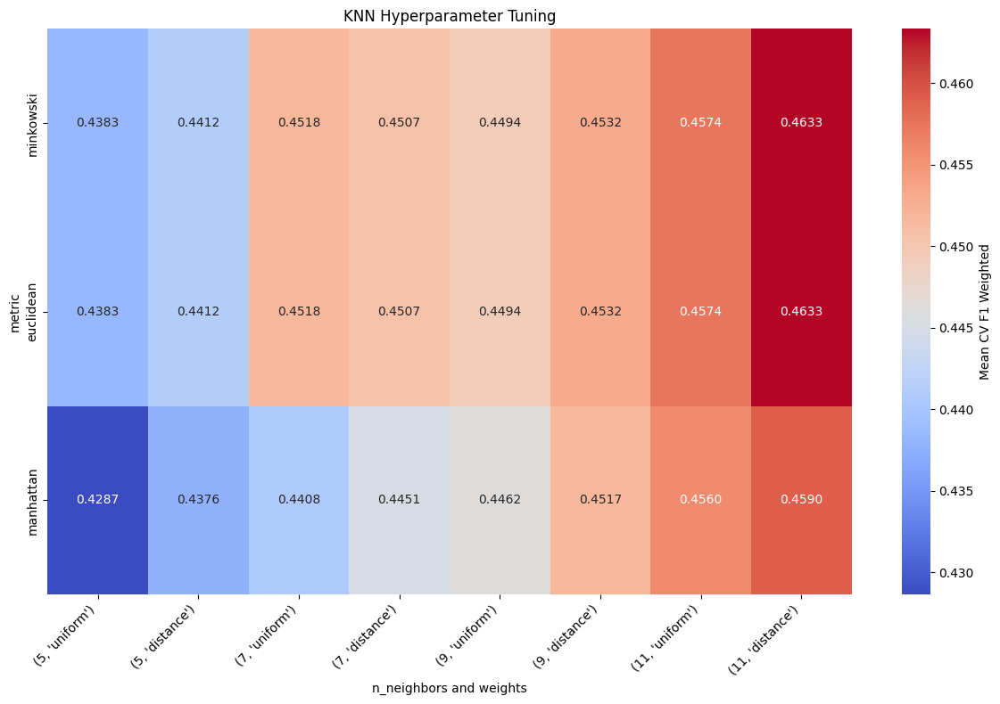

Tuning all models:   9%|█████▊                                                          | 1/11 [00:36<06:05, 36.58s/it]

Tuning SVM...
Fitting 5 folds for each of 32 candidates, totalling 160 fits
Best parameters for SVM: {'C': 100, 'gamma': 0.001, 'kernel': 'rbf'}
Best CV f1_weighted: 0.4876


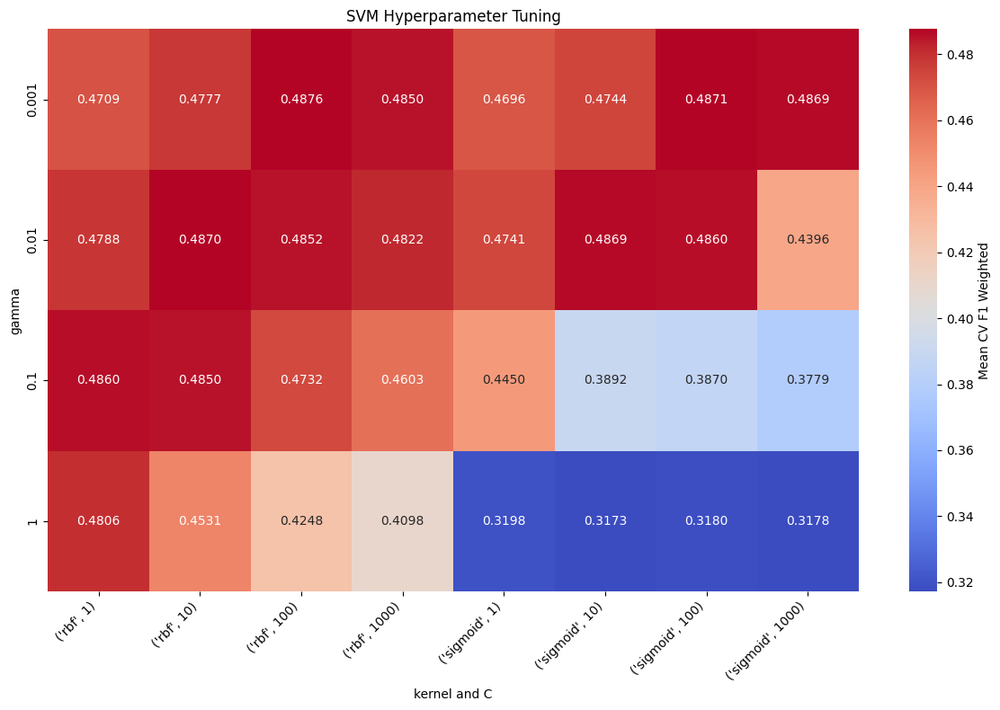

Tuning all models:  18%|███████████                                                  | 2/11 [15:24<1:20:34, 537.16s/it]

Tuning LogisticRegression...
Fitting 5 folds for each of 16 candidates, totalling 80 fits
Best parameters for LogisticRegression: {'C': 1, 'penalty': 'l2', 'solver': 'saga'}
Best CV f1_weighted: 0.4444


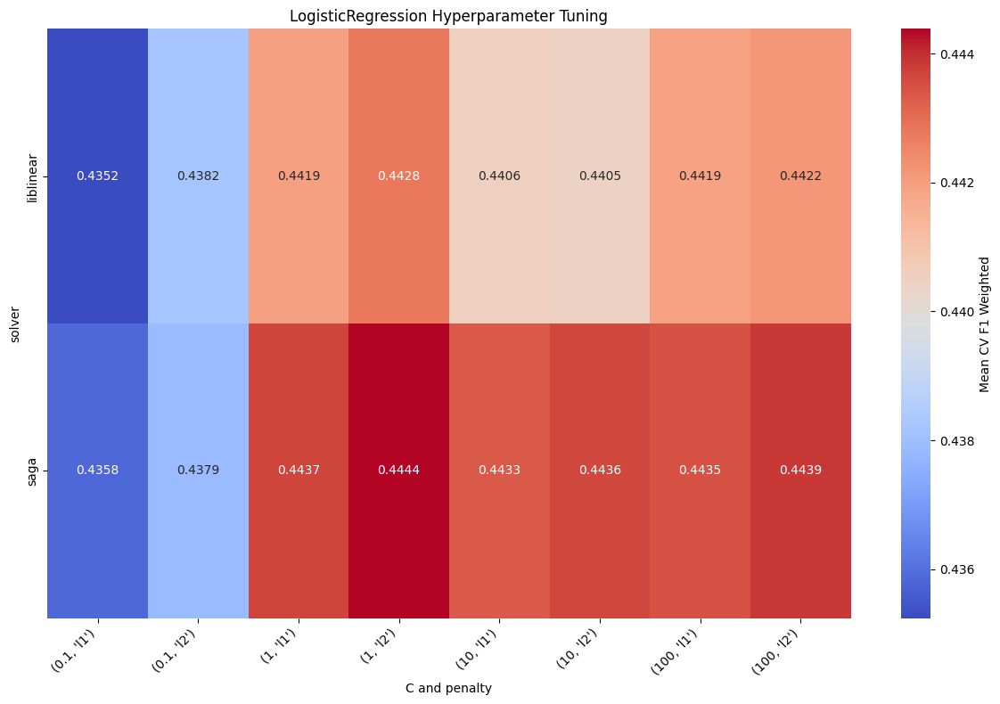

Tuning all models:  27%|█████████████████▏                                             | 3/11 [16:04<41:22, 310.33s/it]

Tuning NaiveBayes...
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best parameters for NaiveBayes: {'var_smoothing': 0.0001}
Best CV F1 Weighted: 0.4455


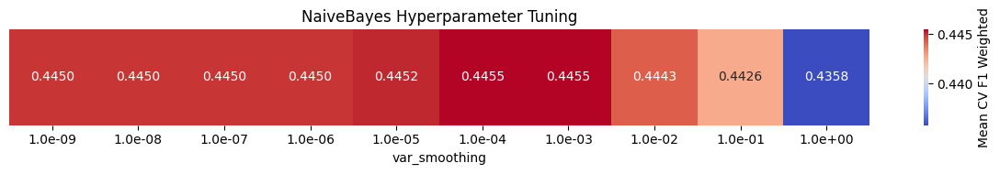

Tuning all models:  36%|██████████████████████▉                                        | 4/11 [16:05<21:56, 188.08s/it]

Tuning DecisionTree...
Fitting 5 folds for each of 18 candidates, totalling 90 fits
Best parameters for DecisionTree: {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10}
Best CV f1_weighted: 0.4380


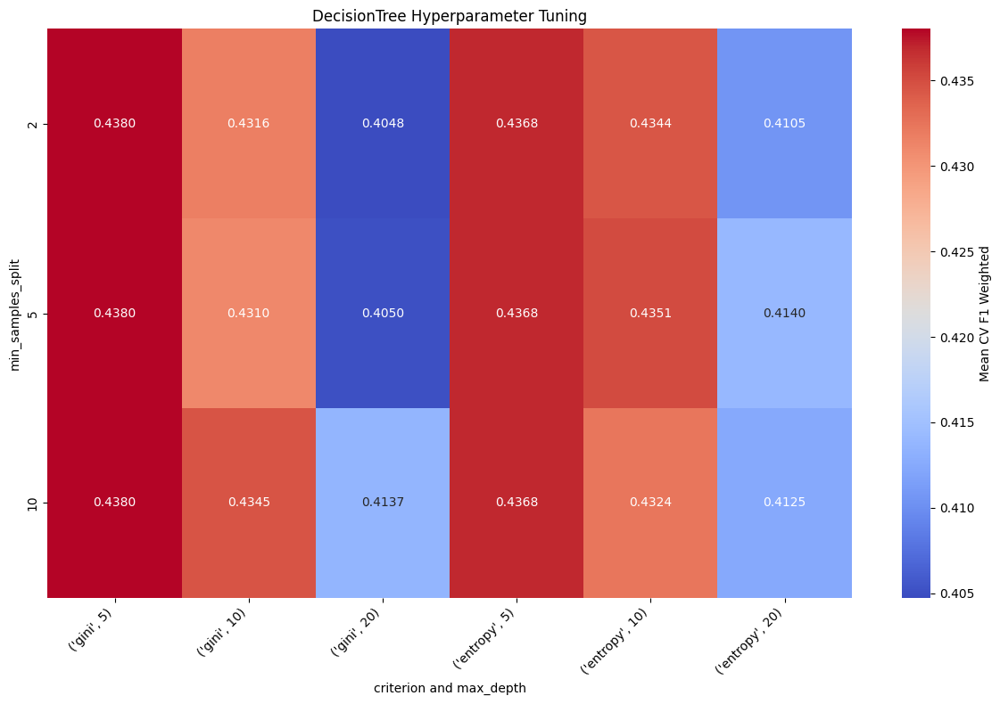

Tuning all models:  45%|████████████████████████████▋                                  | 5/11 [16:09<12:09, 121.63s/it]

Tuning RandomForest...
Fitting 5 folds for each of 12 candidates, totalling 60 fits
Best parameters for RandomForest: {'class_weight': {0: 2.1783787198539617, 1: 4.01696767144418, 2: 3.4246692625659674}, 'max_depth': 10, 'n_estimators': 200}
Best CV f1_weighted: 0.4942


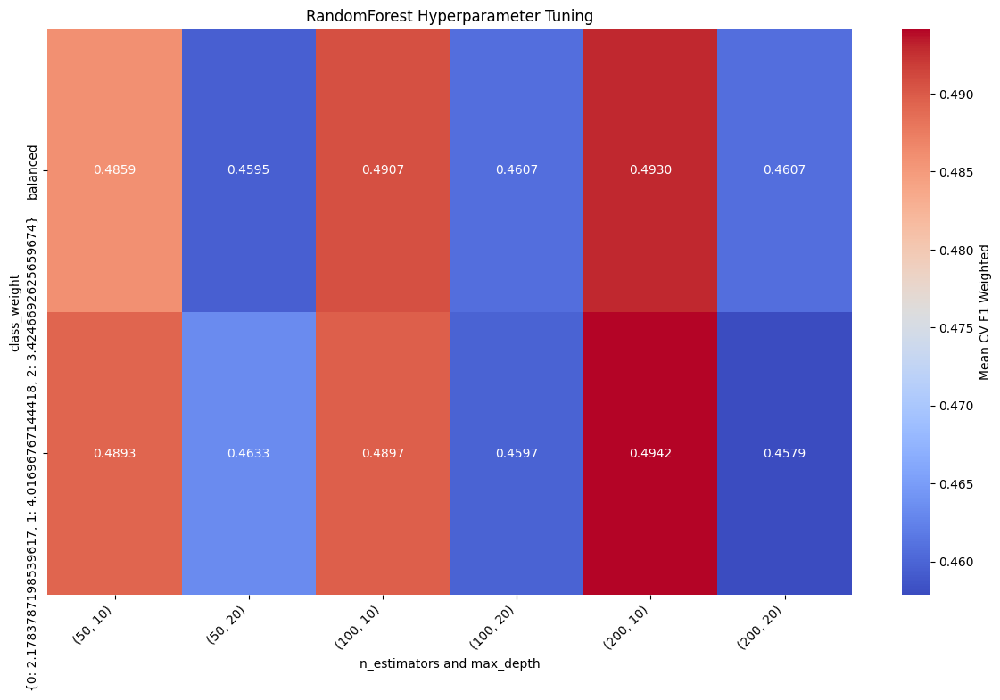

Tuning all models:  55%|██████████████████████████████████▉                             | 6/11 [16:50<07:52, 94.48s/it]

Tuning ExtraTrees...
Fitting 5 folds for each of 18 candidates, totalling 90 fits
Best parameters for ExtraTrees: {'max_depth': 20, 'min_samples_split': 2, 'n_estimators': 50}
Best CV f1_weighted: 0.4569


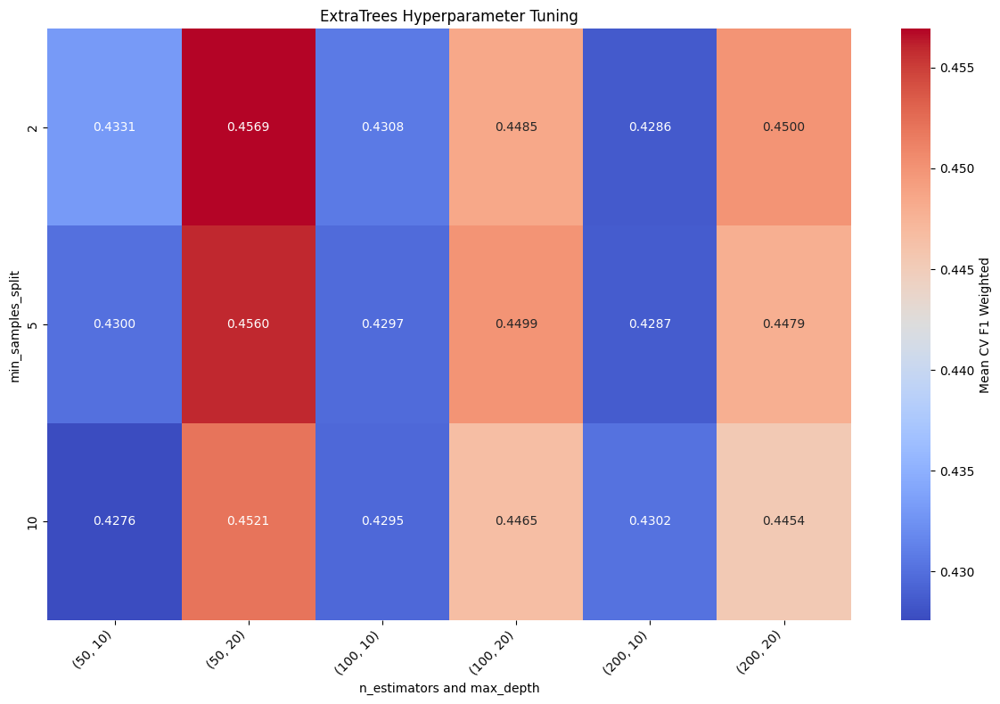

Tuning all models:  64%|████████████████████████████████████████▋                       | 7/11 [17:09<04:39, 69.78s/it]

Tuning XGBoost...
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best parameters for XGBoost: {'learning_rate': 0.1, 'max_depth': 10, 'n_estimators': 100}
Best CV f1_weighted: 0.4682


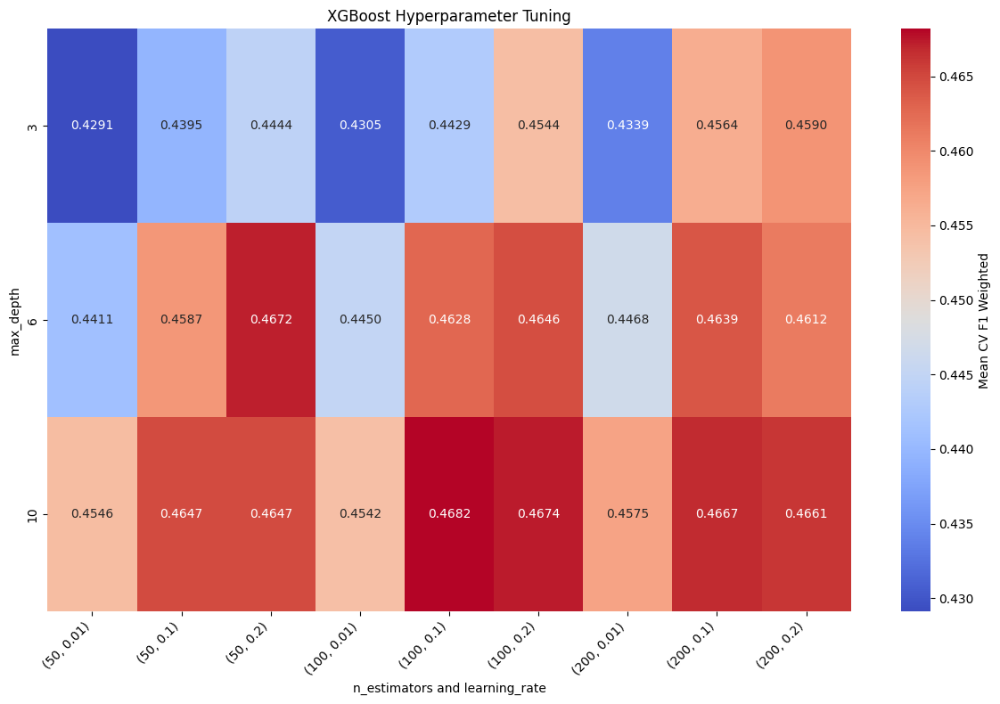

Tuning all models:  73%|██████████████████████████████████████████████▌                 | 8/11 [18:54<04:03, 81.03s/it]

Tuning LightGBM...
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best parameters for LightGBM: {'learning_rate': 0.1, 'n_estimators': 200, 'num_leaves': 127}
Best CV f1_weighted: 0.4689


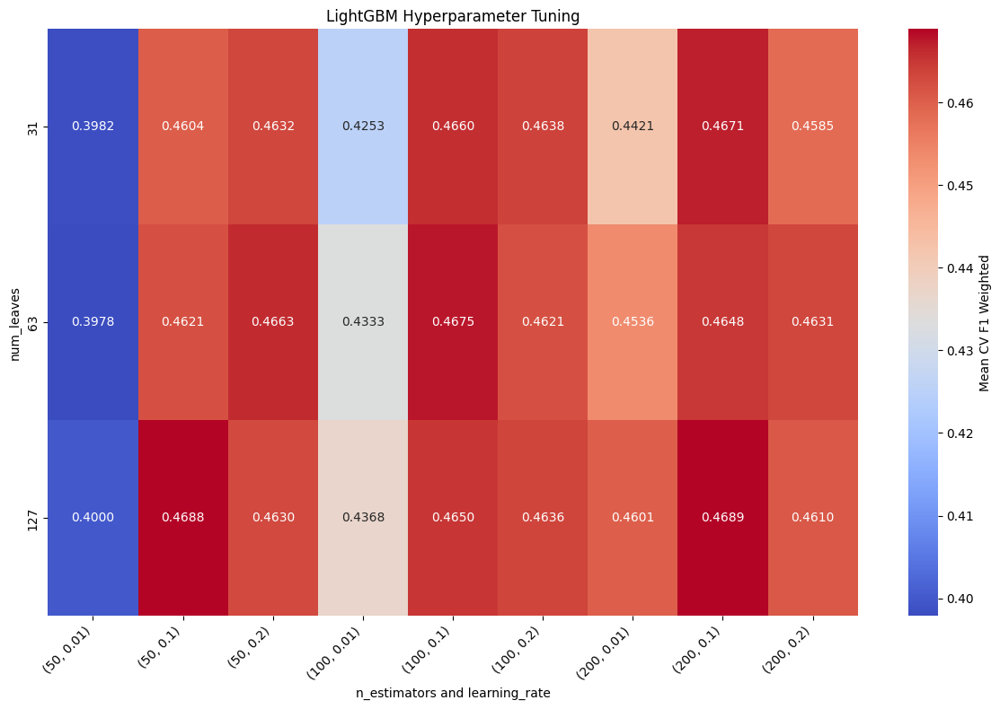

Tuning all models:  82%|███████████████████████████████████████████████████▌           | 9/11 [26:26<06:33, 196.93s/it]

Tuning CatBoost...
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best parameters for CatBoost: {'depth': 4, 'l2_leaf_reg': 1, 'learning_rate': 0.1}
Best CV f1_weighted: 0.4704


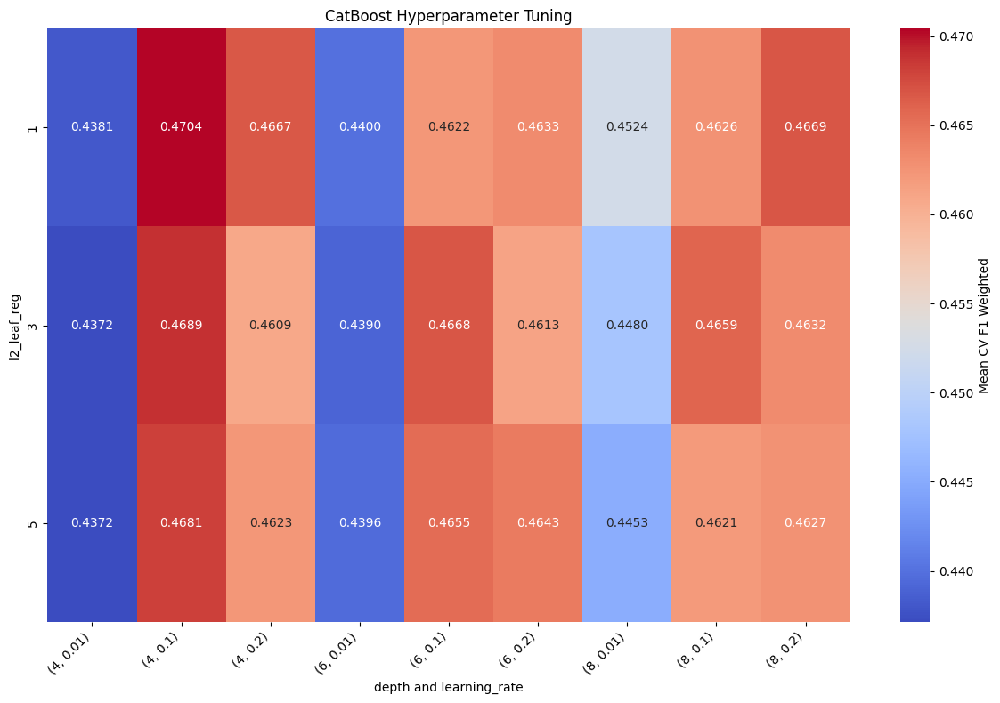

Tuning all models:  91%|██████████████████████████████████████████████████████▌     | 10/11 [1:00:56<12:55, 775.01s/it]

Tuning GradientBoosting...
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best parameters for GradientBoosting: {'learning_rate': 0.2, 'min_samples_split': 5, 'n_estimators': 200}
Best CV f1_weighted: 0.4682


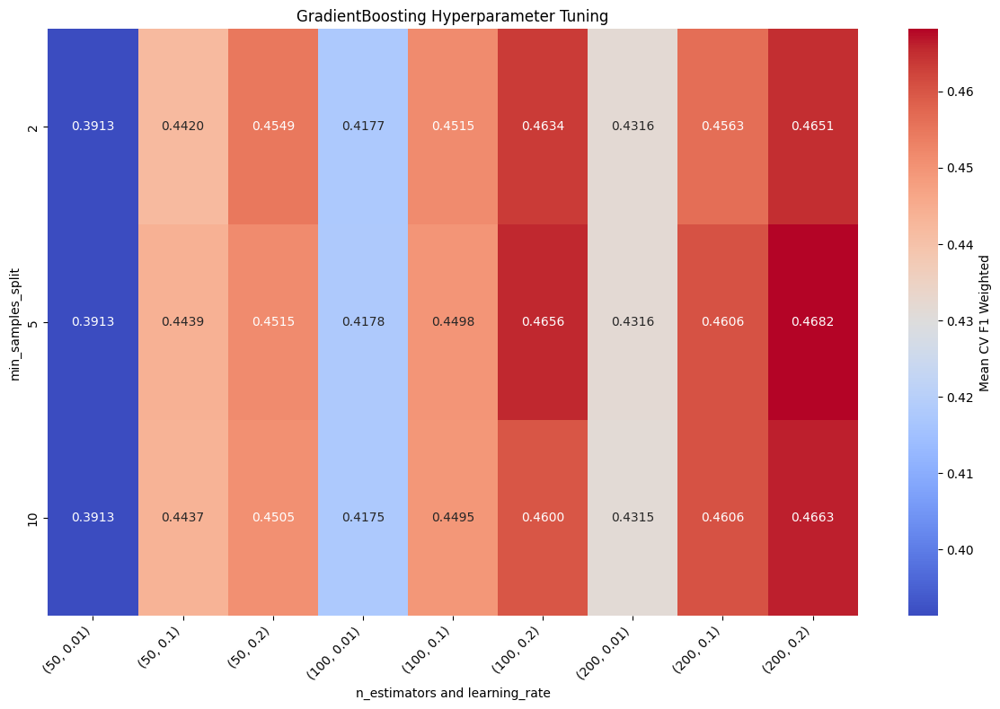

Tuning all models: 100%|████████████████████████████████████████████████████████████| 11/11 [1:06:22<00:00, 362.06s/it]


FileNotFoundError: [Errno 2] No such file or directory: 'model/best_params_dict.pkl'

In [121]:
for model_name, model in tqdm(tuning_models.items(), desc="Tuning all models"):
    if model_name in param_grids:
        param_grid = param_grids[model_name]
        if len(param_grid) == 1:
            tune_and_plot_1d(model_name, model, param_grid, X_train, y_train)
        else:
            tune_and_plot_3d(model_name, model, param_grid, X_train, y_train)
    else:
        print(f"No hyperparameter grid defined for {model_name}.")

In [131]:
best_params_dict["SVM"]["probability"] = True

with open(os.path.join(model_dir, 'best_params_dict.pkl'), 'wb') as file:
    pickle.dump(best_params_dict, file)
print(f"Best parameters dictionary saved to '{model_dir}best_params_dict.pkl'")

# Set model to best params
models = {}
for model_name, model in tuning_models.items():
    if model_name in best_params_dict:
        models[model_name] = tuning_models[model_name].__class__(**best_params_dict[model_name])
    else:
        models[model_name] = tuning_models[model_name].__class__()
best_params_dict

Best parameters dictionary saved to 'model/best_params_dict.pkl'


{'KNN': {'algorithm': 'auto',
  'leaf_size': 30,
  'metric': 'minkowski',
  'metric_params': None,
  'n_jobs': None,
  'n_neighbors': 11,
  'p': 2,
  'weights': 'distance'},
 'SVM': {'C': 100,
  'break_ties': False,
  'cache_size': 200,
  'class_weight': {0: 2.1783787198539617,
   1: 4.01696767144418,
   2: 3.4246692625659674},
  'coef0': 0.0,
  'decision_function_shape': 'ovr',
  'degree': 3,
  'gamma': 0.001,
  'kernel': 'rbf',
  'max_iter': -1,
  'probability': True,
  'random_state': 42,
  'shrinking': True,
  'tol': 0.001,
  'verbose': False},
 'LogisticRegression': {'C': 1,
  'class_weight': None,
  'dual': False,
  'fit_intercept': True,
  'intercept_scaling': 1,
  'l1_ratio': None,
  'max_iter': 100,
  'multi_class': 'auto',
  'n_jobs': None,
  'penalty': 'l2',
  'random_state': 42,
  'solver': 'saga',
  'tol': 0.0001,
  'verbose': 0,
  'warm_start': False},
 'NaiveBayes': {'priors': None, 'var_smoothing': 0.0001},
 'DecisionTree': {'ccp_alpha': 0.0,
  'class_weight': None,
  '

### 5.2.3 Define the Validation Metrics

In [127]:
# Define Scoring Functions
def ignorance_score(y_true, y_pred_proba):
    # One-hot encode the true labels
    y_true_one_hot = np.zeros_like(y_pred_proba)
    y_true_one_hot[np.arange(len(y_true)), y_true] = 1
    
    # Ensure probabilities are clipped to avoid log(0)
    y_pred_proba = np.clip(y_pred_proba, 1e-15, 1 - 1e-15)
    
    # Compute Ignorance Score (Log Loss)
    ign_score = -np.mean(np.sum(y_true_one_hot * np.log2(y_pred_proba), axis=1))
    return ign_score

def ranked_probability_score(y_true, y_pred_proba):
    # Get the number of classes
    r = y_pred_proba.shape[1]
    
    # One-hot encode the true labels
    y_true_one_hot = np.zeros_like(y_pred_proba)
    y_true_one_hot[np.arange(len(y_true)), y_true] = 1
    
    # Initialize RPS
    RPS = 0
    
    # Compute cumulative probabilities for true and predicted labels
    for i in range(1, r):
        cumulative_prob_true = np.cumsum(y_true_one_hot[:, :i], axis=1)
        cumulative_prob_pred = np.cumsum(y_pred_proba[:, :i], axis=1)
        RPS += np.mean((cumulative_prob_true - cumulative_prob_pred) ** 2)
    
    # Normalize RPS
    RPS /= (r - 1)
    return RPS


# Custom scoring functions for cross-validation
scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision_weighted',
    'recall': 'recall_weighted',
    'f1_weighted': 'f1_weighted',
    'ignorance_score': make_scorer(ignorance_score, needs_proba=True),
    'rps': make_scorer(ranked_probability_score, needs_proba=True)
}

### 5.2.4 Compute Evaluation Results

In [132]:
# Store results
model_names = []
cv_mean_accuracies = []
cv_std_accuracies = []
cv_mean_precisions = []
cv_std_precisions = []
cv_mean_recalls = []
cv_std_recalls = []
cv_mean_f1s = []
cv_std_f1s = []
cv_mean_ignorances = []
cv_std_ignorances = []
cv_mean_rps_values = []
cv_std_rps_values = []

holdout_accuracies = []
holdout_precisions = []
holdout_recalls = []
holdout_f1s = []
holdout_cms = []
holdout_ignorances = []
holdout_rps_values = []

for model_name, model in tqdm(models.items(), desc="Training on model:"):
    start_time = time.time()
    X_train_data, y_train_data = X_train, y_train
    X_val_data, y_val_data = X_val, y_val
        
    cv_results = cross_validate(model, X_train_data, y_train_data, cv=NUM_FOLD, scoring=scoring, n_jobs=-1)

    # Compute mean and std for CV metrics
    cv_mean_accuracy = np.mean(cv_results['test_accuracy'])
    cv_std_accuracy = np.std(cv_results['test_accuracy'])
    cv_mean_precision = np.mean(cv_results['test_precision'])
    cv_std_precision = np.std(cv_results['test_precision'])
    cv_mean_recall = np.mean(cv_results['test_recall'])
    cv_std_recall = np.std(cv_results['test_recall'])
    cv_mean_f1 = np.mean(cv_results['test_f1_weighted'])
    cv_std_f1 = np.std(cv_results['test_f1_weighted'])
    cv_mean_ignorance = np.mean(cv_results['test_ignorance_score'])
    cv_std_ignorance = np.std(cv_results['test_ignorance_score'])
    cv_mean_rps = np.mean(cv_results['test_rps'])
    cv_std_rps = np.std(cv_results['test_rps'])

    print(f"{model_name} - CV Mean Accuracy: {cv_mean_accuracy:.4f}, "
          f"Precision: {cv_mean_precision:.4f}, Recall: {cv_mean_recall:.4f}, F1: {cv_mean_f1:.4f}, "
          f"Ignorance: {cv_mean_ignorance:.4f}, RPS: {cv_mean_rps:.4f}")

    # Train and evaluate on holdout set
    model.fit(X_train_data, y_train_data)
    y_pred = model.predict(X_val_data)
    y_pred_proba = model.predict_proba(X_val_data)

    # Holdout metrics
    holdout_acc = accuracy_score(y_val_data, y_pred)
    holdout_precision = precision_score(y_val_data, y_pred, average='weighted', zero_division=0)
    holdout_recall = recall_score(y_val_data, y_pred, average='weighted', zero_division=0)
    holdout_f1 = f1_score(y_val_data, y_pred, average='weighted', zero_division=0)
    holdout_ignorance = ignorance_score(y_val_data, y_pred_proba)
    holdout_rps = ranked_probability_score(y_val_data, y_pred_proba)

    holdout_cm = confusion_matrix(y_val_data, y_pred)

    print(f"{model_name} - Holdout Accuracy: {holdout_acc:.4f}, Precision: {holdout_precision:.4f}, "
          f"Recall: {holdout_recall:.4f}, F1-Score: {holdout_f1:.4f}, "
          f"Ignorance: {holdout_ignorance:.4f}, RPS: {holdout_rps:.4f}")


    # Save the model
    with open(os.path.join(model_dir, f'{model_name}.pkl'), 'wb') as f:
        pickle.dump(model, f)

    # Append results
    model_names.append(model_name)
    cv_mean_accuracies.append(cv_mean_accuracy)
    cv_std_accuracies.append(cv_std_accuracy)
    cv_mean_precisions.append(cv_mean_precision)
    cv_std_precisions.append(cv_std_precision)
    cv_mean_recalls.append(cv_mean_recall)
    cv_std_recalls.append(cv_std_recall)
    cv_mean_f1s.append(cv_mean_f1)
    cv_std_f1s.append(cv_std_f1)
    cv_mean_ignorances.append(cv_mean_ignorance)
    cv_std_ignorances.append(cv_std_ignorance)
    cv_mean_rps_values.append(cv_mean_rps)
    cv_std_rps_values.append(cv_std_rps)

    holdout_accuracies.append(holdout_acc)
    holdout_precisions.append(holdout_precision)
    holdout_recalls.append(holdout_recall)
    holdout_f1s.append(holdout_f1)
    holdout_cms.append((model_name, holdout_cm))
    holdout_ignorances.append(holdout_ignorance)
    holdout_rps_values.append(holdout_rps)

    end_time = time.time()
    duration = end_time - start_time
    print(f"{model_name} completed in {duration:.2f} seconds.")


# Create summary dataframe
ml_metrics_df = pd.DataFrame({
    'Model': model_names,
    'CV_Mean_Accuracy': cv_mean_accuracies,
    'CV_Std_Accuracy': cv_std_accuracies,
    'CV_Mean_Precision': cv_mean_precisions,
    'CV_Std_Precision': cv_std_precisions,
    'CV_Mean_Recall': cv_mean_recalls,
    'CV_Std_Recall': cv_std_recalls,
    'CV_Mean_F1': cv_mean_f1s,
    'CV_Std_F1': cv_std_f1s,
    'CV_Mean_Ignorances': cv_mean_ignorances,
    'CV_Std_Ignorances': cv_std_ignorances,
    'CV_Mean_RPS': cv_mean_rps_values,
    'CV_Std_RPS': cv_std_rps_values,
    'Holdout_Accuracy': holdout_accuracies,
    'Holdout_Precision': holdout_precisions,
    'Holdout_Recall': holdout_recalls,
    'Holdout_F1': holdout_f1s,
    'Holdout_ignorances': holdout_ignorances,
    'Holdout_RPS': holdout_rps_values
})

ml_holdout_cms = holdout_cms.copy()
with open(os.path.join(model_dir, 'ml_holdout_cms.pkl'), 'wb') as f:
    pickle.dump(ml_holdout_cms, f)
ml_metrics_df.to_csv(os.path.join(model_dir, 'ml_model_metrics_summary.csv'), index=False)
ml_metrics_df.sort_values(by='Holdout_F1', ascending=False)

Training on model::   9%|█████▋                                                         | 1/11 [00:02<00:27,  2.79s/it]

KNN - CV Mean Accuracy: 0.4798, Precision: 0.4519, Recall: 0.4798, F1: 0.4563, Ignorance: 2.6473, RPS: 0.2313
KNN - Holdout Accuracy: 0.4950, Precision: 0.4654, Recall: 0.4950, F1-Score: 0.4735, Ignorance: 2.4998, RPS: 0.2242
KNN completed in 2.79 seconds.
SVM - CV Mean Accuracy: 0.4716, Precision: 0.4963, Recall: 0.4716, F1: 0.4731, Ignorance: 1.4453, RPS: 0.2145


Training on model::  18%|███████████▍                                                   | 2/11 [01:08<05:59, 39.96s/it]

SVM - Holdout Accuracy: 0.5084, Precision: 0.4904, Recall: 0.5084, F1-Score: 0.4944, Ignorance: 1.3977, RPS: 0.2076
SVM completed in 65.97 seconds.
LogisticRegression - CV Mean Accuracy: 0.5127, Precision: 0.4493, Recall: 0.5127, F1: 0.4445, Ignorance: 1.4498, RPS: 0.2149


Training on model::  27%|█████████████████▏                                             | 3/11 [01:11<03:02, 22.84s/it]

LogisticRegression - Holdout Accuracy: 0.5520, Precision: 0.4247, Recall: 0.5520, F1-Score: 0.4763, Ignorance: 1.3968, RPS: 0.2071
LogisticRegression completed in 2.47 seconds.


Training on model::  36%|██████████████████████▉                                        | 4/11 [01:12<01:40, 14.37s/it]

NaiveBayes - CV Mean Accuracy: 0.4748, Precision: 0.4558, Recall: 0.4748, F1: 0.4399, Ignorance: 2.9921, RPS: 0.2761
NaiveBayes - Holdout Accuracy: 0.5453, Precision: 0.5392, Recall: 0.5453, F1-Score: 0.4870, Ignorance: 2.1558, RPS: 0.2630
NaiveBayes completed in 1.39 seconds.


Training on model::  45%|████████████████████████████▋                                  | 5/11 [01:12<00:55,  9.31s/it]

DecisionTree - CV Mean Accuracy: 0.4924, Precision: 0.4339, Recall: 0.4924, F1: 0.4310, Ignorance: 1.6145, RPS: 0.2251
DecisionTree - Holdout Accuracy: 0.5201, Precision: 0.4380, Recall: 0.5201, F1-Score: 0.4581, Ignorance: 1.4222, RPS: 0.2141
DecisionTree completed in 0.34 seconds.
RandomForest - CV Mean Accuracy: 0.4948, Precision: 0.4859, Recall: 0.4948, F1: 0.4833, Ignorance: 1.4690, RPS: 0.2198


Training on model::  55%|██████████████████████████████████▎                            | 6/11 [01:22<00:47,  9.52s/it]

RandomForest - Holdout Accuracy: 0.5403, Precision: 0.5032, Recall: 0.5403, F1-Score: 0.5097, Ignorance: 1.4199, RPS: 0.2139
RandomForest completed in 9.93 seconds.
ExtraTrees - CV Mean Accuracy: 0.5077, Precision: 0.4664, Recall: 0.5077, F1: 0.4556, Ignorance: 1.4735, RPS: 0.2169


Training on model::  64%|████████████████████████████████████████                       | 7/11 [01:24<00:27,  6.98s/it]

ExtraTrees - Holdout Accuracy: 0.5386, Precision: 0.4845, Recall: 0.5386, F1-Score: 0.4863, Ignorance: 1.4048, RPS: 0.2108
ExtraTrees completed in 1.74 seconds.
XGBoost - CV Mean Accuracy: 0.4832, Precision: 0.4474, Recall: 0.4832, F1: 0.4485, Ignorance: 1.6009, RPS: 0.2310


Training on model::  73%|█████████████████████████████████████████████▊                 | 8/11 [01:37<00:26,  8.78s/it]

XGBoost - Holdout Accuracy: 0.5302, Precision: 0.4718, Recall: 0.5302, F1-Score: 0.4871, Ignorance: 1.4844, RPS: 0.2164
XGBoost completed in 12.63 seconds.
LightGBM - CV Mean Accuracy: 0.4787, Precision: 0.4457, Recall: 0.4787, F1: 0.4481, Ignorance: 1.9962, RPS: 0.2635


Training on model::  82%|███████████████████████████████████████████████████▌           | 9/11 [02:32<00:46, 23.45s/it]

LightGBM - Holdout Accuracy: 0.5000, Precision: 0.4348, Recall: 0.5000, F1-Score: 0.4581, Ignorance: 1.7614, RPS: 0.2446
LightGBM completed in 55.72 seconds.
CatBoost - CV Mean Accuracy: 0.4879, Precision: 0.4522, Recall: 0.4879, F1: 0.4538, Ignorance: 1.5181, RPS: 0.2219


Training on model::  91%|████████████████████████████████████████████████████████▎     | 10/11 [02:55<00:23, 23.18s/it]

CatBoost - Holdout Accuracy: 0.5285, Precision: 0.4770, Recall: 0.5285, F1-Score: 0.4929, Ignorance: 1.4335, RPS: 0.2108
CatBoost completed in 22.57 seconds.
GradientBoosting - CV Mean Accuracy: 0.4691, Precision: 0.4401, Recall: 0.4691, F1: 0.4410, Ignorance: 1.6088, RPS: 0.2312


Training on model:: 100%|██████████████████████████████████████████████████████████████| 11/11 [03:59<00:00, 21.76s/it]

GradientBoosting - Holdout Accuracy: 0.5034, Precision: 0.4515, Recall: 0.5034, F1-Score: 0.4691, Ignorance: 1.4759, RPS: 0.2170
GradientBoosting completed in 63.80 seconds.


,Model,CV_Mean_Accuracy,CV_Std_Accuracy,CV_Mean_Precision,CV_Std_Precision,CV_Mean_Recall,CV_Std_Recall,CV_Mean_F1,CV_Std_F1,CV_Mean_Ignorances,CV_Std_Ignorances,CV_Mean_RPS,CV_Std_RPS,Holdout_Accuracy,Holdout_Precision,Holdout_Recall,Holdout_F1,Holdout_ignorances,Holdout_RPS
5,RandomForest,0.494839,0.015907,0.485901,0.010473,0.494839,0.015907,0.483309,0.013079,1.468963,0.015831,0.219755,0.003571,0.540268,0.503168,0.540268,0.509695,1.419921,0.213949
1,SVM,0.471613,0.027533,0.496279,0.017033,0.471613,0.027533,0.473137,0.020372,1.445344,0.021040,0.214514,0.004718,0.508389,0.490445,0.508389,0.494390,1.397731,0.207639
9,CatBoost,0.487919,0.022260,0.452155,0.010904,0.487919,0.022260,0.453818,0.012630,1.518133,0.037342,0.221938,0.007281,0.528523,0.476998,0.528523,0.492940,1.433472,0.210831
7,XGBoost,0.483226,0.014288,0.447381,0.008803,0.483226,0.014288,0.448475,0.009866,1.600863,0.026402,0.231049,0.005303,0.530201,0.471829,0.530201,0.487086,1.484448,0.216355
3,NaiveBayes,0.474779,0.020631,0.455823,0.018138,0.474779,0.020631,0.439886,0.014739,2.992105,1.581562,0.276070,0.007899,0.545302,0.539207,0.545302,0.487044,2.155834,0.263014
6,ExtraTrees,0.507744,0.020297,0.466375,0.012699,0.507744,0.020297,0.455591,0.009370,1.473488,0.019044,0.216896,0.004498,0.538591,0.484536,0.538591,0.486278,1.404807,0.210782
2,LogisticRegression,0.512671,0.018022,0.449284,0.031500,0.512671,0.018022,0.444524,0.004846,1.449783,0.031171,0.214906,0.006362,0.552013,0.424691,0.552013,0.476279,1.396809,0.207133
0,KNN,0.479823,0.009594,0.451932,0.005452,0.479823,0.009594,0.456253,0.005462,2.647309,0.228801,0.231255,0.002127,0.494966,0.465360,0.494966,0.473452,2.499754,0.224228
10,GradientBoosting,0.469148,0.020345,0.440129,0.010158,0.469148,0.020345,0.440965,0.010740,1.608832,0.103947,0.231169,0.010506,0.503356,0.451501,0.503356,0.469139,1.475883,0.216988
4,DecisionTree,0.492374,0.009916,0.433863,0.011356,0.492374,0.009916,0.430952,0.014447,1.614505,0.072472,0.225085,0.003749,0.520134,0.438041,0.520134,0.458109,1.422213,0.214145


### 5.2.5 Results Visualization

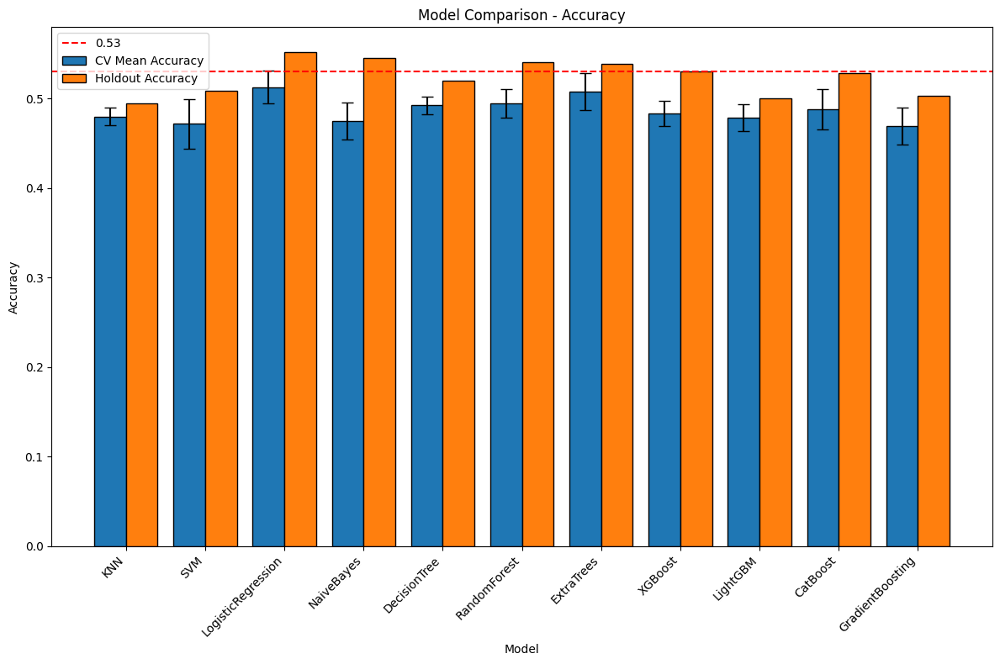

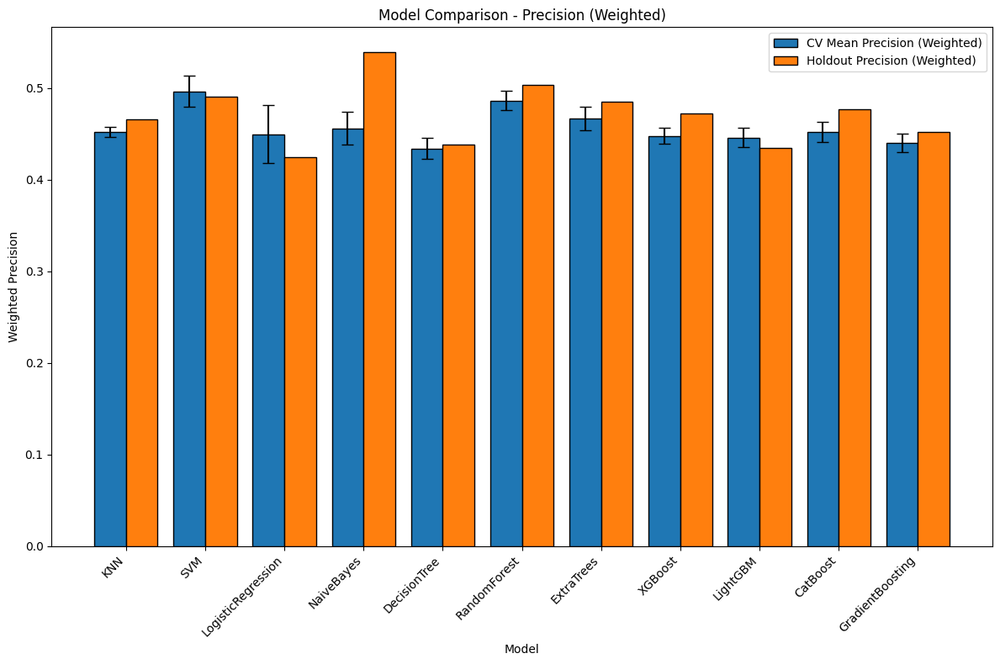

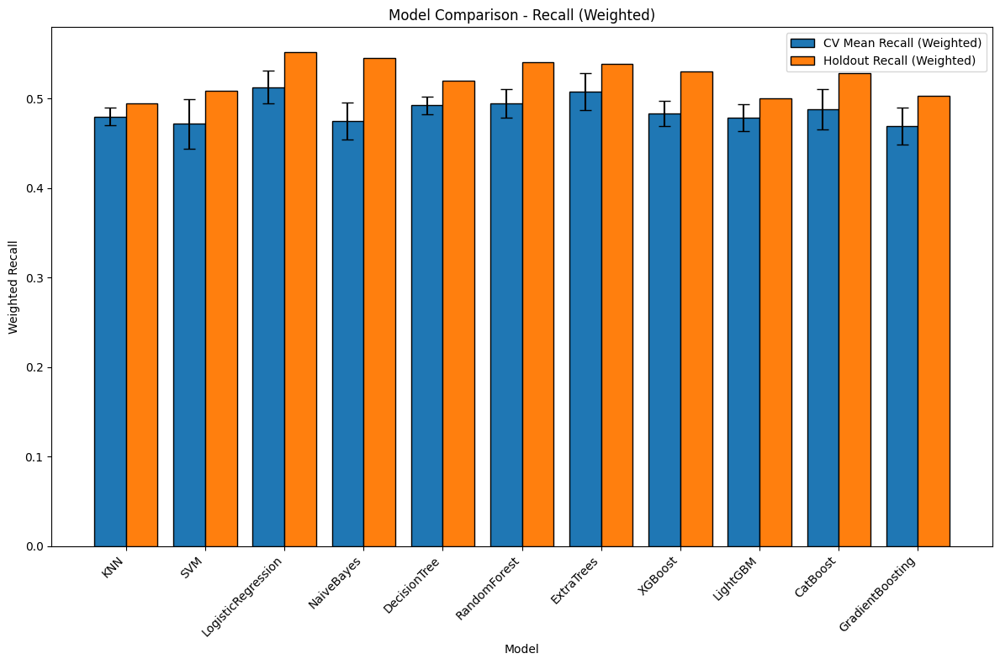

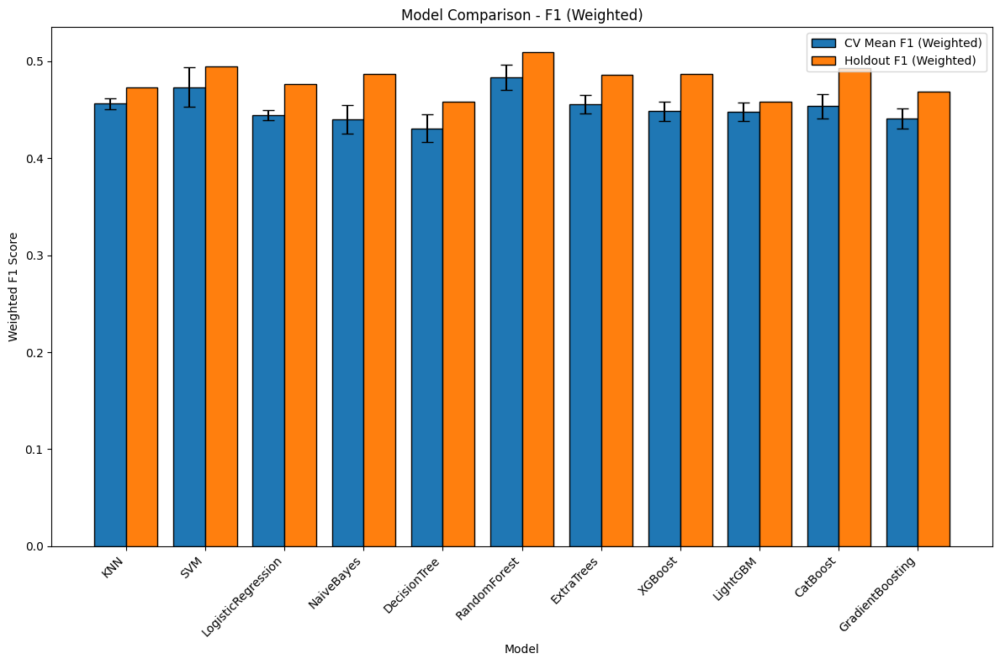

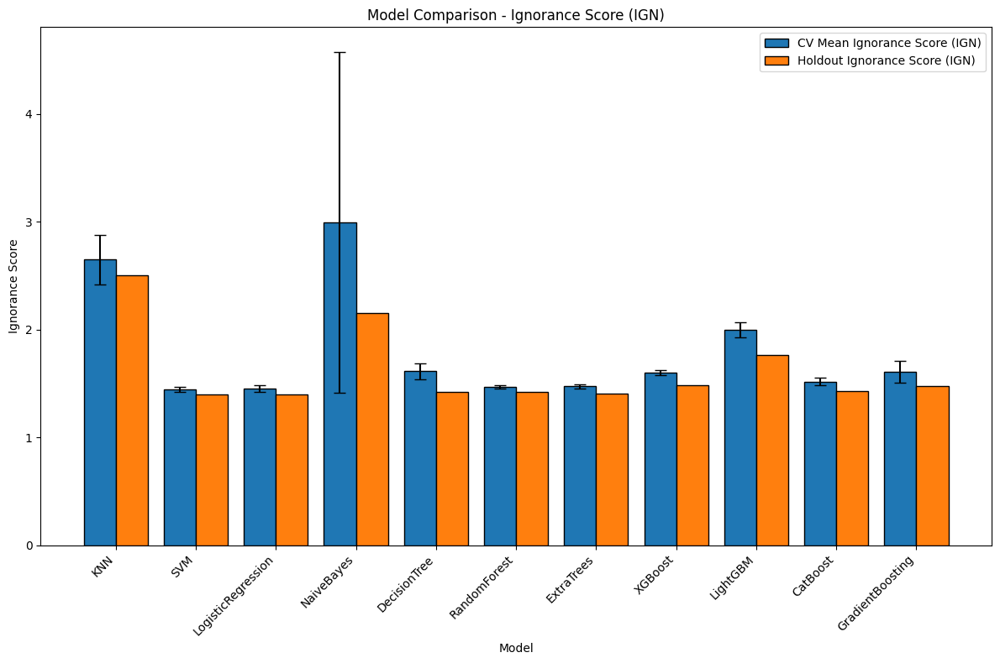

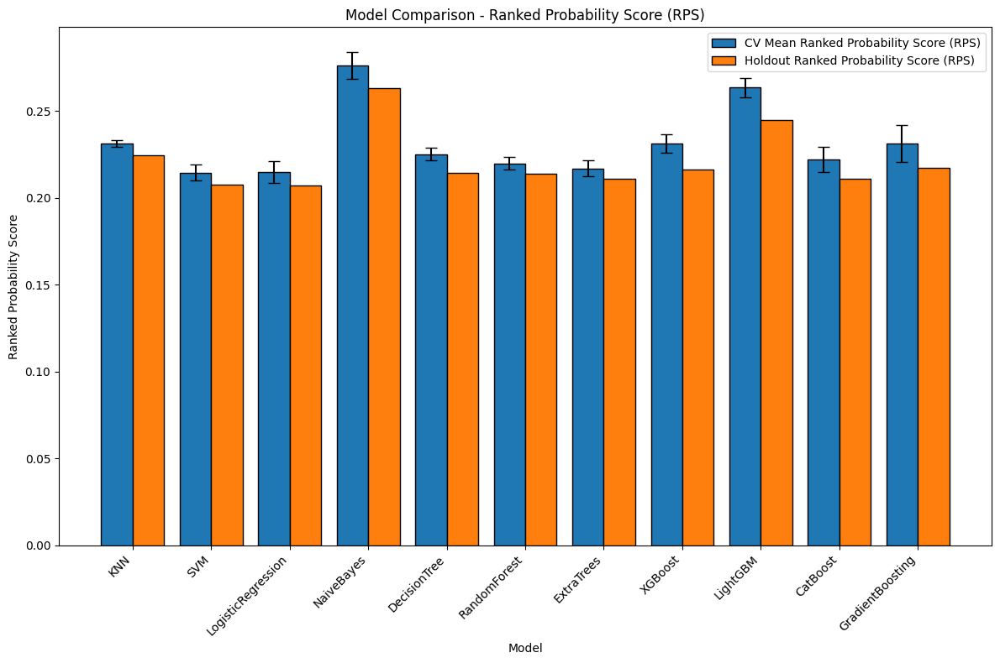

In [133]:
ml_metrics = [
    {
        'name': 'Accuracy',
        'cv_mean': ml_metrics_df['CV_Mean_Accuracy'],
        'cv_std': ml_metrics_df['CV_Std_Accuracy'],
        'holdout': ml_metrics_df['Holdout_Accuracy'],
        'ylabel': 'Accuracy'
    },
    {
        'name': 'Precision (Weighted)',
        'cv_mean': ml_metrics_df['CV_Mean_Precision'],
        'cv_std': ml_metrics_df['CV_Std_Precision'],
        'holdout': ml_metrics_df['Holdout_Precision'],
        'ylabel': 'Weighted Precision'
    },
    {
        'name': 'Recall (Weighted)',
        'cv_mean': ml_metrics_df['CV_Mean_Recall'],
        'cv_std': ml_metrics_df['CV_Std_Recall'],
        'holdout': ml_metrics_df['Holdout_Recall'],
        'ylabel': 'Weighted Recall'
    },
    {
        'name': 'F1 (Weighted)',
        'cv_mean': ml_metrics_df['CV_Mean_F1'],
        'cv_std': ml_metrics_df['CV_Std_F1'],
        'holdout': ml_metrics_df['Holdout_F1'],
        'ylabel': 'Weighted F1 Score'
    },
    {
        'name': 'Ignorance Score (IGN)',
        'cv_mean': ml_metrics_df['CV_Mean_Ignorances'],
        'cv_std': ml_metrics_df['CV_Std_Ignorances'],
        'holdout': ml_metrics_df['Holdout_ignorances'],
        'ylabel': 'Ignorance Score'
    },
    {
        'name': 'Ranked Probability Score (RPS)',
        'cv_mean': ml_metrics_df['CV_Mean_RPS'],
        'cv_std': ml_metrics_df['CV_Std_RPS'],
        'holdout': ml_metrics_df['Holdout_RPS'],
        'ylabel': 'Ranked Probability Score'
    }
]

model_names = ml_metrics_df['Model']

for metric in ml_metrics:
    plt.figure(figsize=(12, 8))
    x = np.arange(len(model_names))
    
    plt.bar(x - 0.2, metric['cv_mean'], width=0.4, label='CV Mean '+metric['name'], 
            yerr=metric['cv_std'], capsize=5, edgecolor='black')

    plt.bar(x + 0.2, metric['holdout'], width=0.4, label='Holdout '+metric['name'], edgecolor='black')

    plt.xticks(x, model_names, rotation=45, ha='right')
    plt.xlabel('Model')
    plt.ylabel(metric['ylabel'])
    plt.title('Model Comparison - ' + metric['name'])

    if metric['name'] == "Accuracy":
        plt.axhline(y=0.53, color='red', linestyle='--', linewidth=1.5, label='0.53')

    plt.legend()
    plt.tight_layout()
    plt.show()

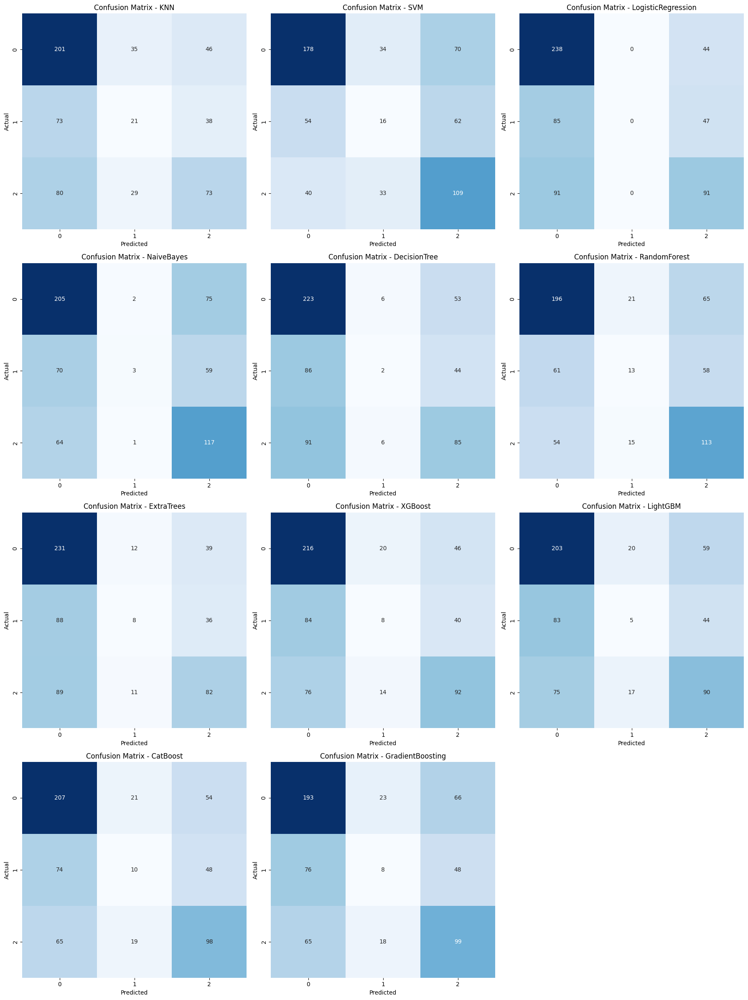

In [134]:
# Ploy Confusion Matrix
num_models = len(ml_holdout_cms)
cols = 3
rows = (num_models + cols - 1) // cols
fig, axes = plt.subplots(rows, cols, figsize=(cols*6, rows*6))

if rows * cols > 1:
    axes = axes.flatten()
else:
    axes = [axes]

for i, (m_name, m_cm) in enumerate(ml_holdout_cms):
    ax = axes[i] 
    sns.heatmap(m_cm, annot=True, fmt='d', cmap='Blues', cbar=False, ax=ax)
    ax.set_title(f'Confusion Matrix - {m_name}')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')

for j in range(len(ml_holdout_cms), len(axes)):
    axes[j].remove()

plt.tight_layout()
plt.show()

## 5.3 Deep Learning Models

### 5.3.1 Model Setup

In [135]:
# Keras Wrapper to fit Sklearn API
class KerasClassifierWrapper(BaseEstimator, ClassifierMixin):
    """
    A wrapper class to integrate Keras models with the Scikit-learn API.

    This class allows a Keras model to be used seamlessly with Scikit-learn's tools for model training, 
    evaluation, and hyperparameter tuning. It provides compatibility with Scikit-learn's `BaseEstimator` 
    and `ClassifierMixin`, enabling functionalities such as grid search and cross-validation.

    Attributes:
        build_fn (callable): A function to build and compile the Keras model. It must accept `input_shape` 
                             and `num_classes` as arguments.
        input_shape (tuple): The shape of the input data (excluding the batch size).
        num_classes (int): The number of classes for the classification task.
        epochs (int): Number of epochs for model training. Default is 30.
        batch_size (int): Batch size for model training. Default is 32.
        verbose (int): Verbosity mode for Keras training and prediction. Default is 0 (silent).
        model_ (Keras model): The compiled Keras model instance after calling `fit`.
    """

    def __init__(self, build_fn, input_shape, num_classes, epochs=30, batch_size=32, verbose=0):
        self.build_fn = build_fn
        self.input_shape = input_shape
        self.num_classes = num_classes
        self.epochs = epochs
        self.batch_size = batch_size
        self.verbose = verbose
        self.model_ = None

    def fit(self, X, y):
        classes = np.unique(y)
        num_classes = len(classes)
        y_cat = to_categorical(y, num_classes=num_classes)
        K.clear_session()
        self.model_ = self.build_fn(self.input_shape, self.num_classes)
        self.model_.fit(X, y_cat, epochs=self.epochs, batch_size=self.batch_size, verbose=self.verbose)
        return self
        
    # Predicts class labels
    def predict(self, X):
        y_pred_prob = self.model_.predict(X, verbose=0)
        y_pred = np.argmax(y_pred_prob, axis=1)
        return y_pred

    # Predicted probabilities for each class.
    def predict_proba(self, X):
        return self.model_.predict(X, verbose=0)

In [136]:
def build_optimized_1d_cnn(input_shape, num_classes):
    input_layer = Input(shape=input_shape)

    x = Conv1D(filters=96, kernel_size=3, activation='relu', padding='same')(input_layer)
    x = MaxPooling1D(pool_size=2)(x)
    x = Dropout(0.4693)(x)  # Optuna-optimized dropout_rate

    x = Flatten()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.4)(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.4)(x)

    output_layer = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=output_layer)

    # Optuna-optimized Params
    model.compile(
        loss='categorical_crossentropy',
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.00026715316714051124),
        metrics=['accuracy']
    )

    return model
    
def build_cnn_attention(input_shape, num_classes):
    input_layer = Input(shape=input_shape)  # (timesteps, features)
    x = Conv1D(filters=48, kernel_size=5, activation='relu')(input_layer)  # Referenced optimized filters and kernel_size
    x = BatchNormalization()(x)
    x = Dropout(0.3)(x)

    # Attention
    attention = Dense(x.shape[-1], activation='softmax')(x) 
    x = Multiply()([x, attention]) 

    x = GlobalAveragePooling1D()(x)  
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.4)(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.4)(x)

    output_layer = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=output_layer)
    model.compile(loss='categorical_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.00034), metrics=['accuracy'])
    return model

def build_optimized_ann(input_shape, num_classes):
    input_layer = Input(shape=input_shape)
    x = Flatten()(input_layer)

    # Optuna optimzied units and dropout_rate
    x = Dense(128, activation='relu')(x)  # units: 128
    x = Dropout(0.457)(x)  # dropout_rate: 0.457
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.457)(x)
    x = Dense(32, activation='relu')(x)
    x = Dropout(0.2)(x)

    output_layer = Dense(num_classes, activation='softmax')(x)
    
    # Optuna Optimized learning_rate
    model = Model(inputs=input_layer, outputs=output_layer)
    model.compile(loss='categorical_crossentropy', 
                  optimizer=tf.keras.optimizers.Adam(learning_rate=0.00289),  # learning_rate: 0.00289
                  metrics=['accuracy'])
    return model

In [137]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        print("GPU configured successfully!")
    except RuntimeError as e:
        print("Error in GPU configuration:", e)

dl_models = {
    'MLP': MLPClassifier(
        hidden_layer_sizes=(100,), 
        activation='tanh', 
        solver='sgd', 
        learning_rate_init=0.003075229364681813, 
        momentum=0.7190016375585988, 
        max_iter=500, 
        random_state=RANDOM_SEED
    ),
    'TabNet': TabNetClassifier(
        n_d=8,
        n_a=40,
        n_steps=7,
        gamma=1.2114361784859125,
        lambda_sparse=2.4081752465670033e-06,
        verbose=0,
        seed=RANDOM_SEED
    ),
    '1D_CNN': KerasClassifierWrapper(
        build_fn=build_optimized_1d_cnn, 
        input_shape=(X_train.shape[1], 1),
        num_classes=len(set(y_train)), 
        epochs=30,
        batch_size=32, 
        verbose=1
    ),
    'CNN_Attention': KerasClassifierWrapper(
        build_fn=build_cnn_attention,
        input_shape=(X_train.shape[1], 1),
        num_classes=len(set(y_train)),
        epochs=30,
        batch_size=32,
        verbose=1
    ),
    'ANN': KerasClassifierWrapper(
        build_fn=build_optimized_ann, 
        input_shape=(X_train.shape[1], ),
        num_classes=len(set(y_train)), 
        epochs=30, batch_size=32, verbose=1
    ),
}

### 5.3.2 Model Training and Validation

In [140]:
model_names = []
cv_mean_accuracies = []
cv_std_accuracies = []
cv_mean_precisions = []
cv_std_precisions = []
cv_mean_recalls = []
cv_std_recalls = []
cv_mean_f1s = []
cv_std_f1s = []
cv_mean_ignorances = []
cv_std_ignorances = []
cv_mean_rps_values = []
cv_std_rps_values = []

holdout_accuracies = []
holdout_precisions = []
holdout_recalls = []
holdout_f1s = []
holdout_cms = []
holdout_ignorances = []
holdout_rps_values = []



for model_name, model in tqdm(dl_models.items(), desc="Training on model:"):
    start_time = time.time()
    X_train_data, y_train_data = X_train.values, y_train.values
    X_val_data, y_val_data = X_val.values, y_val.values
        
    cv_results = cross_validate(model, X_train_data, y_train_data, cv=NUM_FOLD, scoring=scoring)

    # Compute mean and std for CV metrics
    cv_mean_accuracy = np.mean(cv_results['test_accuracy'])
    cv_std_accuracy = np.std(cv_results['test_accuracy'])
    cv_mean_precision = np.mean(cv_results['test_precision'])
    cv_std_precision = np.std(cv_results['test_precision'])
    cv_mean_recall = np.mean(cv_results['test_recall'])
    cv_std_recall = np.std(cv_results['test_recall'])
    cv_mean_f1 = np.mean(cv_results['test_f1_weighted'])
    cv_std_f1 = np.std(cv_results['test_f1_weighted'])
    cv_mean_ignorance = np.mean(cv_results['test_ignorance_score'])
    cv_std_ignorance = np.std(cv_results['test_ignorance_score'])
    cv_mean_rps = np.mean(cv_results['test_rps'])
    cv_std_rps = np.std(cv_results['test_rps'])

    print(f"{model_name} - CV Mean Accuracy: {cv_mean_accuracy:.4f}, "
          f"Precision: {cv_mean_precision:.4f}, Recall: {cv_mean_recall:.4f}, F1: {cv_mean_f1:.4f}, "
          f"Ignorance: {cv_mean_ignorance:.4f}, RPS: {cv_mean_rps:.4f}")

    # Train and evaluate on holdout set
    model.fit(X_train_data, y_train_data)
    y_pred = model.predict(X_val_data)
    y_pred_proba = model.predict_proba(X_val_data)

    # Holdout metrics
    holdout_acc = accuracy_score(y_val_data, y_pred)
    holdout_precision = precision_score(y_val_data, y_pred, average='weighted', zero_division=0)
    holdout_recall = recall_score(y_val_data, y_pred, average='weighted', zero_division=0)
    holdout_f1 = f1_score(y_val_data, y_pred, average='weighted', zero_division=0)
    holdout_ignorance = ignorance_score(y_val_data, y_pred_proba)
    holdout_rps = ranked_probability_score(y_val_data, y_pred_proba)

    holdout_cm = confusion_matrix(y_val_data, y_pred)

    print(f"{model_name} - Holdout Accuracy: {holdout_acc:.4f}, Precision: {holdout_precision:.4f}, "
          f"Recall: {holdout_recall:.4f}, F1-Score: {holdout_f1:.4f}, "
          f"Ignorance: {holdout_ignorance:.4f}, RPS: {holdout_rps:.4f}")


    with open(f'{model_name}.pkl', 'wb') as f:
        pickle.dump(model, f)

    # Append results
    model_names.append(model_name)
    cv_mean_accuracies.append(cv_mean_accuracy)
    cv_std_accuracies.append(cv_std_accuracy)
    cv_mean_precisions.append(cv_mean_precision)
    cv_std_precisions.append(cv_std_precision)
    cv_mean_recalls.append(cv_mean_recall)
    cv_std_recalls.append(cv_std_recall)
    cv_mean_f1s.append(cv_mean_f1)
    cv_std_f1s.append(cv_std_f1)
    cv_mean_ignorances.append(cv_mean_ignorance)
    cv_std_ignorances.append(cv_std_ignorance)
    cv_mean_rps_values.append(cv_mean_rps)
    cv_std_rps_values.append(cv_std_rps)

    holdout_accuracies.append(holdout_acc)
    holdout_precisions.append(holdout_precision)
    holdout_recalls.append(holdout_recall)
    holdout_f1s.append(holdout_f1)
    holdout_cms.append((model_name, holdout_cm))
    holdout_ignorances.append(holdout_ignorance)
    holdout_rps_values.append(holdout_rps)

    end_time = time.time()
    duration = end_time - start_time
    print(f"{model_name} completed in {duration:.2f} seconds.")


# Create summary dataframe
dl_metrics_df = pd.DataFrame({
    'Model': model_names,
    'CV_Mean_Accuracy': cv_mean_accuracies,
    'CV_Std_Accuracy': cv_std_accuracies,
    'CV_Mean_Precision': cv_mean_precisions,
    'CV_Std_Precision': cv_std_precisions,
    'CV_Mean_Recall': cv_mean_recalls,
    'CV_Std_Recall': cv_std_recalls,
    'CV_Mean_F1': cv_mean_f1s,
    'CV_Std_F1': cv_std_f1s,
    'CV_Mean_Ignorances': cv_mean_ignorances,
    'CV_Std_Ignorances': cv_std_ignorances,
    'CV_Mean_RPS': cv_mean_rps_values,
    'CV_Std_RPS': cv_std_rps_values,
    'Holdout_Accuracy': holdout_accuracies,
    'Holdout_Precision': holdout_precisions,
    'Holdout_Recall': holdout_recalls,
    'Holdout_F1': holdout_f1s,
    'Holdout_ignorances': holdout_ignorances,
    'Holdout_RPS': holdout_rps_values
})
dl_holdout_cms = holdout_cms.copy()
with open(os.path.join(model_dir, 'dl_holdout_cms.pkl'), 'wb') as f:
    pickle.dump(dl_holdout_cms, f)
dl_metrics_df.to_csv(os.path.join(model_dir, 'dl_model_metrics_summary.csv'), index=False)
dl_metrics_df.sort_values(by='Holdout_F1', ascending=False)

Training on model::   0%|                                                                        | 0/5 [00:00<?, ?it/s]

MLP - CV Mean Accuracy: 0.5183, Precision: 0.4002, Recall: 0.5183, F1: 0.4393, Ignorance: 1.4450, RPS: 0.2150


Training on model::  20%|████████████▊                                                   | 1/5 [01:01<04:05, 61.42s/it]

MLP - Holdout Accuracy: 0.5604, Precision: 0.4323, Recall: 0.5604, F1-Score: 0.4856, Ignorance: 1.3948, RPS: 0.2074
MLP completed in 61.42 seconds.
TabNet - CV Mean Accuracy: 0.5126, Precision: 0.4380, Recall: 0.5126, F1: 0.4328, Ignorance: nan, RPS: nan


Training on model::  40%|████████████████████████                                    | 2/5 [49:26<1:26:42, 1734.13s/it]

TabNet - Holdout Accuracy: 0.5503, Precision: 0.4722, Recall: 0.5503, F1-Score: 0.4762, Ignorance: 1.4030, RPS: 0.2081
TabNet completed in 2905.02 seconds.

Epoch 1/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - accuracy: 0.4497 - loss: 1.0656
Epoch 2/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4917 - loss: 1.0388
Epoch 3/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5093 - loss: 1.0192
Epoch 4/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5120 - loss: 1.0064
Epoch 5/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5183 - loss: 0.9994
Epoch 6/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5284 - loss: 0.9950
Epoch 7/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5062 - loss: 1.0195
Epoch 8/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5235 - loss: 1.0023
Epoch 9/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5144 - loss: 0.9988
Epoch 10/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.52

Training on model::  60%|█████████████████████████████████████▏                        | 3/5 [53:32<35:09, 1054.71s/it]

1D_CNN completed in 246.19 seconds.
Epoch 1/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - accuracy: 0.4364 - loss: 1.0855
Epoch 2/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.4601 - loss: 1.0590
Epoch 3/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4667 - loss: 1.0463
Epoch 4/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.4959 - loss: 1.0281
Epoch 5/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4992 - loss: 1.0223
Epoch 6/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4975 - loss: 1.0248
Epoch 7/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5104 - loss: 1.0172
Epoch 8/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4982 - loss: 1.0244
Epoch 9/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5202 - loss: 1.0021
Epoch 10/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5120 - loss: 1.0093
Epoch 11/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.5040 - loss: 1.0102
Epoch 12/30
214/

Training on model::  80%|██████████████████████████████████████████████████▍            | 4/5 [57:44<12:17, 737.92s/it]

CNN_Attention - Holdout Accuracy: 0.5369, Precision: 0.4113, Recall: 0.5369, F1-Score: 0.4594, Ignorance: 1.3965, RPS: 0.2079
CNN_Attention completed in 252.29 seconds.
Epoch 1/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.4503 - loss: 1.0694
Epoch 2/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.4968 - loss: 1.0211
Epoch 3/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4917 - loss: 1.0218
Epoch 4/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.5201 - loss: 1.0054
Epoch 5/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5125 - loss: 1.0113
Epoch 6/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4960 - loss: 1.0171
Epoch 7/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.5105 - loss: 1.0106
Epoch 8/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5263 - loss: 0.9964
Epoch 9/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5109 - loss: 1.0051
Epoch 10/30
214/214 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - ac

Training on model:: 100%|███████████████████████████████████████████████████████████████| 5/5 [59:55<00:00, 719.18s/it]

ANN - Holdout Accuracy: 0.5537, Precision: 0.4294, Recall: 0.5537, F1-Score: 0.4835, Ignorance: 1.4035, RPS: 0.2104
ANN completed in 130.96 seconds.


,Model,CV_Mean_Accuracy,CV_Std_Accuracy,CV_Mean_Precision,CV_Std_Precision,CV_Mean_Recall,CV_Std_Recall,CV_Mean_F1,CV_Std_F1,CV_Mean_Ignorances,CV_Std_Ignorances,CV_Mean_RPS,CV_Std_RPS,Holdout_Accuracy,Holdout_Precision,Holdout_Recall,Holdout_F1,Holdout_ignorances,Holdout_RPS
0,MLP,0.518302,0.012585,0.400153,0.021803,0.518302,0.012585,0.439289,0.009523,1.444977,0.016278,0.214973,0.00387,0.560403,0.432263,0.560403,0.485585,1.394816,0.207436
2,1D_CNN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.555369,0.430122,0.555369,0.484451,1.384287,0.205628
4,ANN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.553691,0.429400,0.553691,0.483534,1.403547,0.210382
1,TabNet,0.512554,0.014127,0.438036,0.088639,0.512554,0.014127,0.432808,0.021065,NaN,NaN,NaN,NaN,0.550336,0.472192,0.550336,0.476212,1.403008,0.208127
3,CNN_Attention,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.536913,0.411252,0.536913,0.459380,1.396496,0.207874


In [141]:
all_metrics_df = pd.concat([ml_metrics_df, dl_metrics_df], ignore_index=True)
all_metrics_df

,Model,CV_Mean_Accuracy,CV_Std_Accuracy,CV_Mean_Precision,CV_Std_Precision,CV_Mean_Recall,CV_Std_Recall,CV_Mean_F1,CV_Std_F1,CV_Mean_Ignorances,CV_Std_Ignorances,CV_Mean_RPS,CV_Std_RPS,Holdout_Accuracy,Holdout_Precision,Holdout_Recall,Holdout_F1,Holdout_ignorances,Holdout_RPS
0,KNN,0.479823,0.009594,0.451932,0.005452,0.479823,0.009594,0.456253,0.005462,2.647309,0.228801,0.231255,0.002127,0.494966,0.465360,0.494966,0.473452,2.499754,0.224228
1,SVM,0.471613,0.027533,0.496279,0.017033,0.471613,0.027533,0.473137,0.020372,1.445344,0.021040,0.214514,0.004718,0.508389,0.490445,0.508389,0.494390,1.397731,0.207639
2,LogisticRegression,0.512671,0.018022,0.449284,0.031500,0.512671,0.018022,0.444524,0.004846,1.449783,0.031171,0.214906,0.006362,0.552013,0.424691,0.552013,0.476279,1.396809,0.207133
3,NaiveBayes,0.474779,0.020631,0.455823,0.018138,0.474779,0.020631,0.439886,0.014739,2.992105,1.581562,0.276070,0.007899,0.545302,0.539207,0.545302,0.487044,2.155834,0.263014
4,DecisionTree,0.492374,0.009916,0.433863,0.011356,0.492374,0.009916,0.430952,0.014447,1.614505,0.072472,0.225085,0.003749,0.520134,0.438041,0.520134,0.458109,1.422213,0.214145
5,RandomForest,0.494839,0.015907,0.485901,0.010473,0.494839,0.015907,0.483309,0.013079,1.468963,0.015831,0.219755,0.003571,0.540268,0.503168,0.540268,0.509695,1.419921,0.213949
6,ExtraTrees,0.507744,0.020297,0.466375,0.012699,0.507744,0.020297,0.455591,0.009370,1.473488,0.019044,0.216896,0.004498,0.538591,0.484536,0.538591,0.486278,1.404807,0.210782
7,XGBoost,0.483226,0.014288,0.447381,0.008803,0.483226,0.014288,0.448475,0.009866,1.600863,0.026402,0.231049,0.005303,0.530201,0.471829,0.530201,0.487086,1.484448,0.216355
8,LightGBM,0.478650,0.014768,0.445725,0.010278,0.478650,0.014768,0.448075,0.009341,1.996199,0.071931,0.263468,0.005464,0.500000,0.434834,0.500000,0.458063,1.761356,0.244613
9,CatBoost,0.487919,0.022260,0.452155,0.010904,0.487919,0.022260,0.453818,0.012630,1.518133,0.037342,0.221938,0.007281,0.528523,0.476998,0.528523,0.492940,1.433472,0.210831


### 5.3.3 Results Evaluation

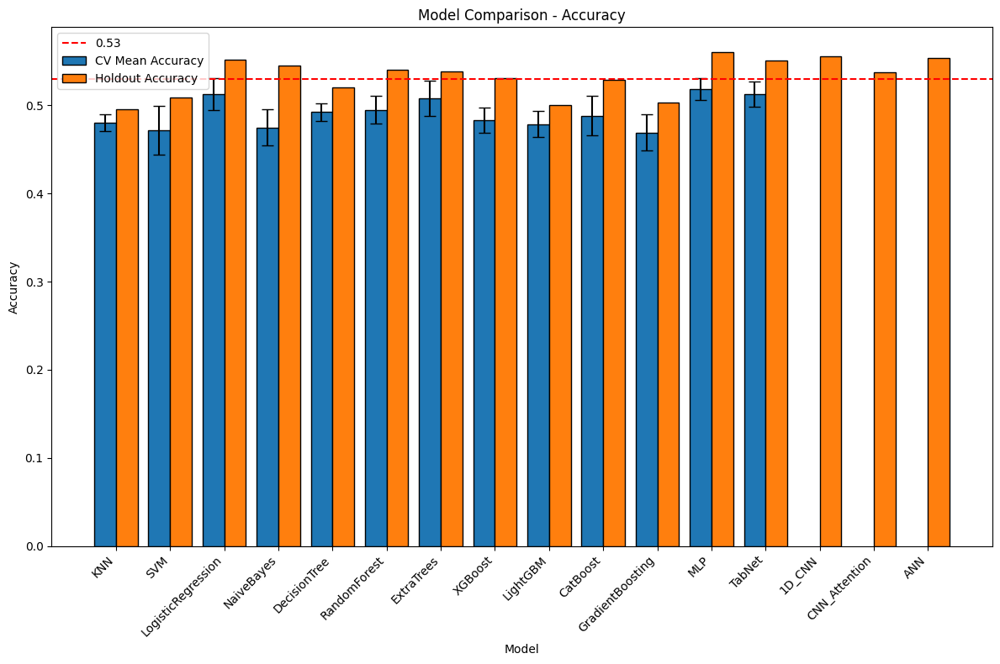

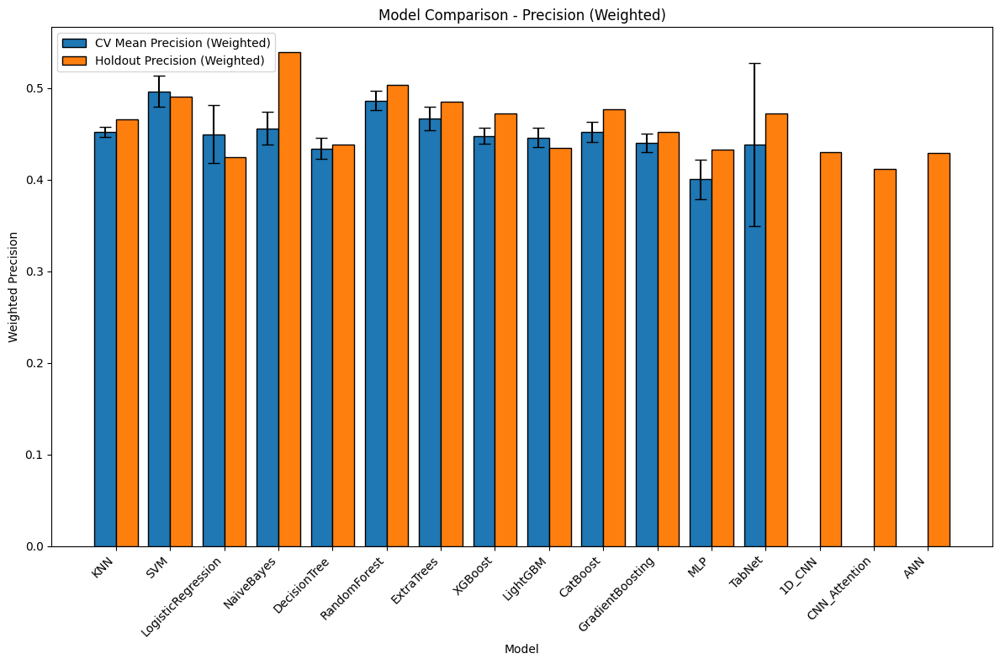

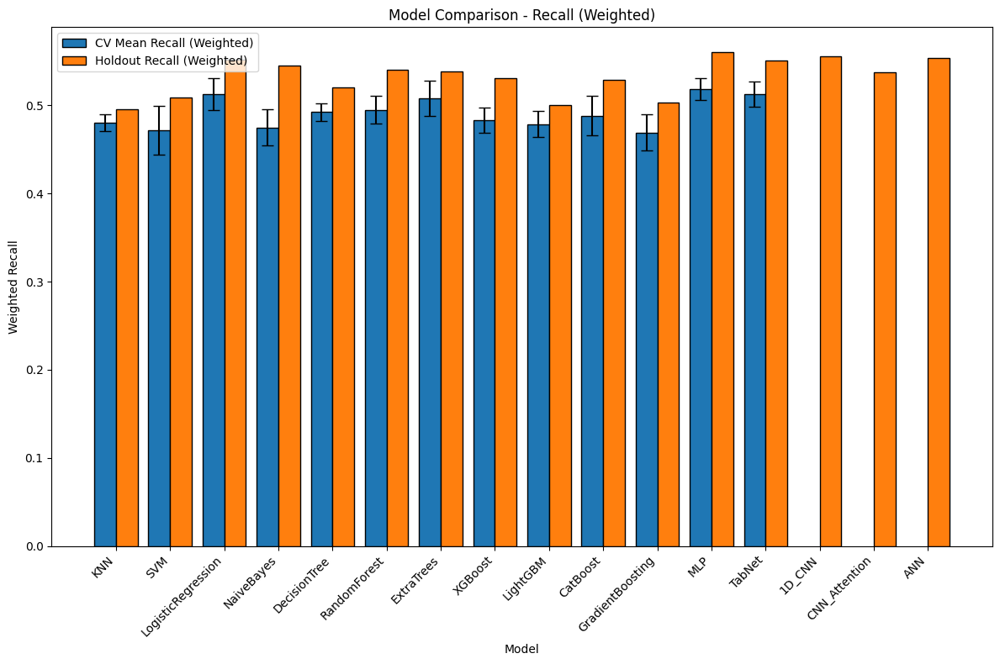

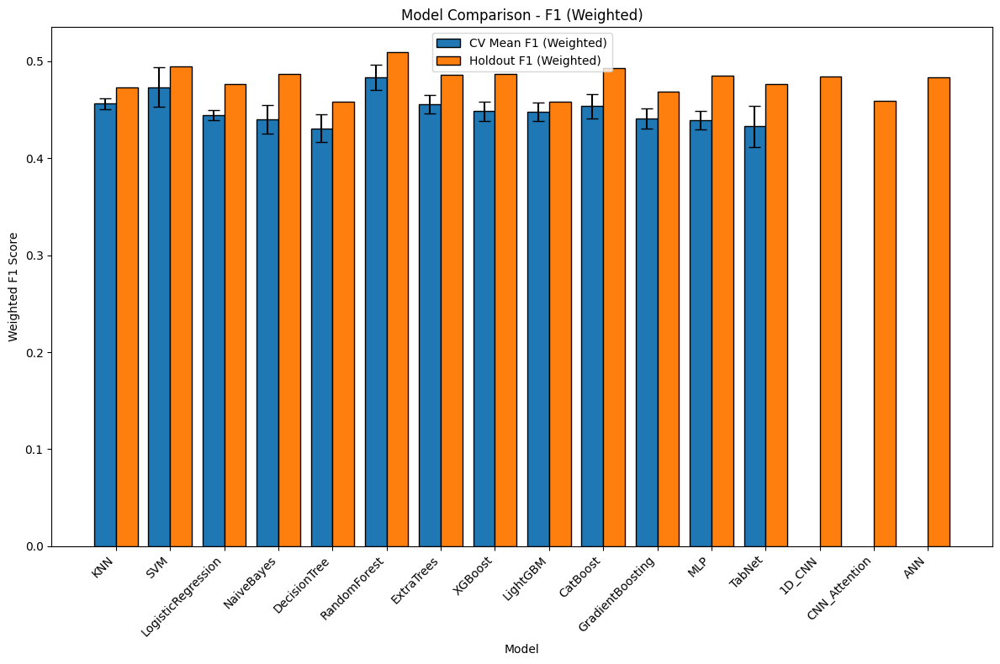

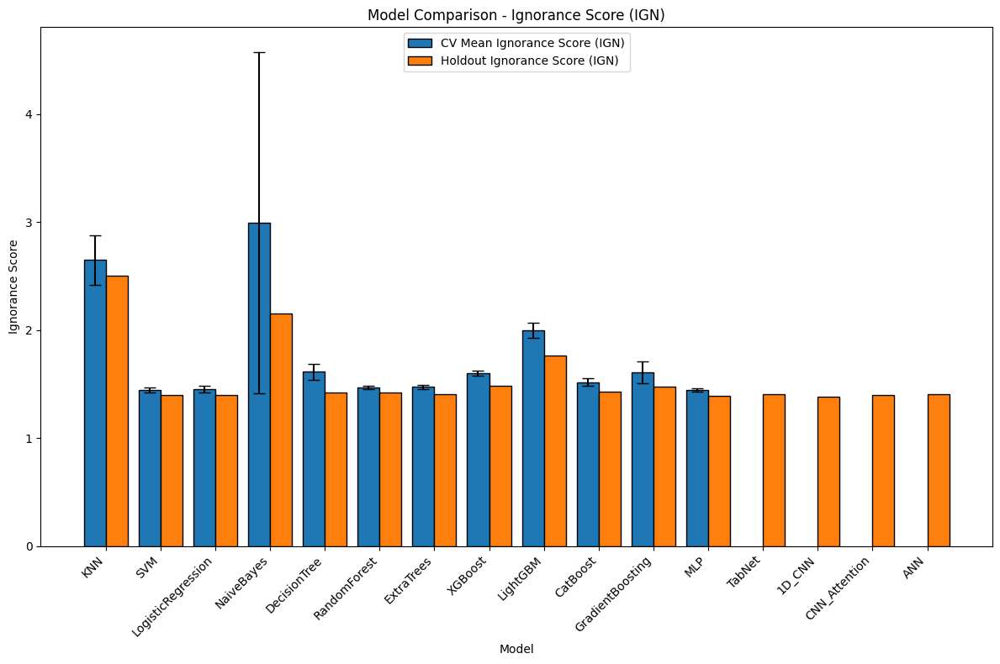

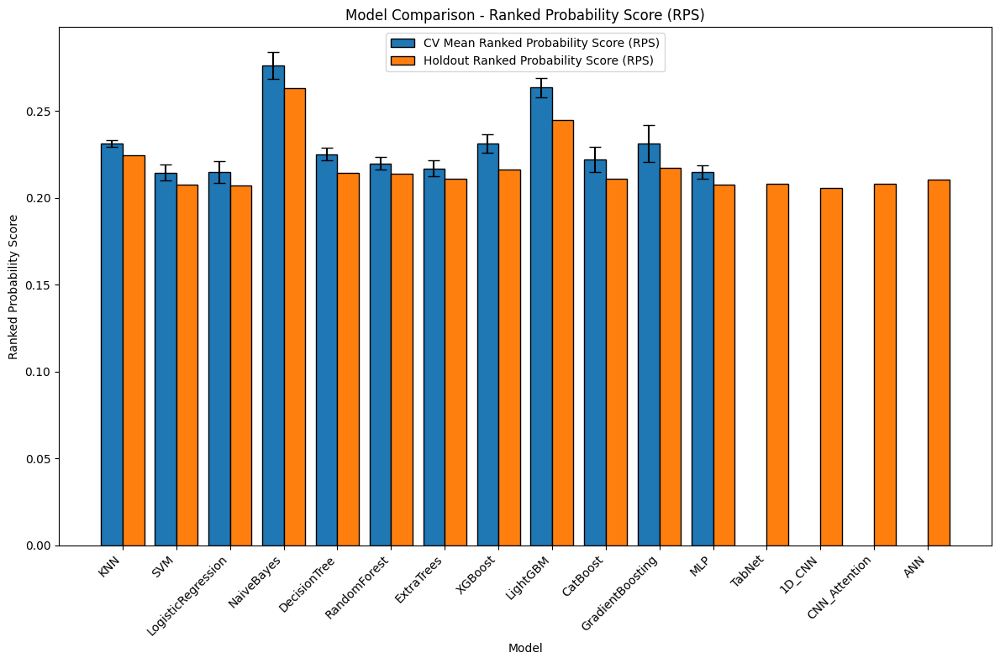

In [142]:
dl_metrics = [
    {
        'name': 'Accuracy',
        'cv_mean': all_metrics_df['CV_Mean_Accuracy'],
        'cv_std': all_metrics_df['CV_Std_Accuracy'],
        'holdout': all_metrics_df['Holdout_Accuracy'],
        'ylabel': 'Accuracy'
    },
    {
        'name': 'Precision (Weighted)',
        'cv_mean': all_metrics_df['CV_Mean_Precision'],
        'cv_std': all_metrics_df['CV_Std_Precision'],
        'holdout': all_metrics_df['Holdout_Precision'],
        'ylabel': 'Weighted Precision'
    },
    {
        'name': 'Recall (Weighted)',
        'cv_mean': all_metrics_df['CV_Mean_Recall'],
        'cv_std': all_metrics_df['CV_Std_Recall'],
        'holdout': all_metrics_df['Holdout_Recall'],
        'ylabel': 'Weighted Recall'
    },
    {
        'name': 'F1 (Weighted)',
        'cv_mean': all_metrics_df['CV_Mean_F1'],
        'cv_std': all_metrics_df['CV_Std_F1'],
        'holdout': all_metrics_df['Holdout_F1'],
        'ylabel': 'Weighted F1 Score'
    },
    {
        'name': 'Ignorance Score (IGN)',
        'cv_mean': all_metrics_df['CV_Mean_Ignorances'],
        'cv_std': all_metrics_df['CV_Std_Ignorances'],
        'holdout': all_metrics_df['Holdout_ignorances'],
        'ylabel': 'Ignorance Score'
    },
    {
        'name': 'Ranked Probability Score (RPS)',
        'cv_mean': all_metrics_df['CV_Mean_RPS'],
        'cv_std': all_metrics_df['CV_Std_RPS'],
        'holdout': all_metrics_df['Holdout_RPS'],
        'ylabel': 'Ranked Probability Score'
    }
]

model_names = all_metrics_df['Model']

for metric in dl_metrics:
    plt.figure(figsize=(12, 8))
    x = np.arange(len(model_names))

    plt.bar(x - 0.2, metric['cv_mean'], width=0.4, label='CV Mean '+metric['name'], 
            yerr=metric['cv_std'], capsize=5, edgecolor='black')
    plt.bar(x + 0.2, metric['holdout'], width=0.4, label='Holdout '+metric['name'], edgecolor='black')

    plt.xticks(x, model_names, rotation=45, ha='right')
    plt.xlabel('Model')
    plt.ylabel(metric['ylabel'])
    plt.title('Model Comparison - ' + metric['name'])

    if metric['name'] == "Accuracy":
        plt.axhline(y=0.53, color='red', linestyle='--', linewidth=1.5, label='0.53')

    plt.legend()
    plt.tight_layout()
    plt.show()

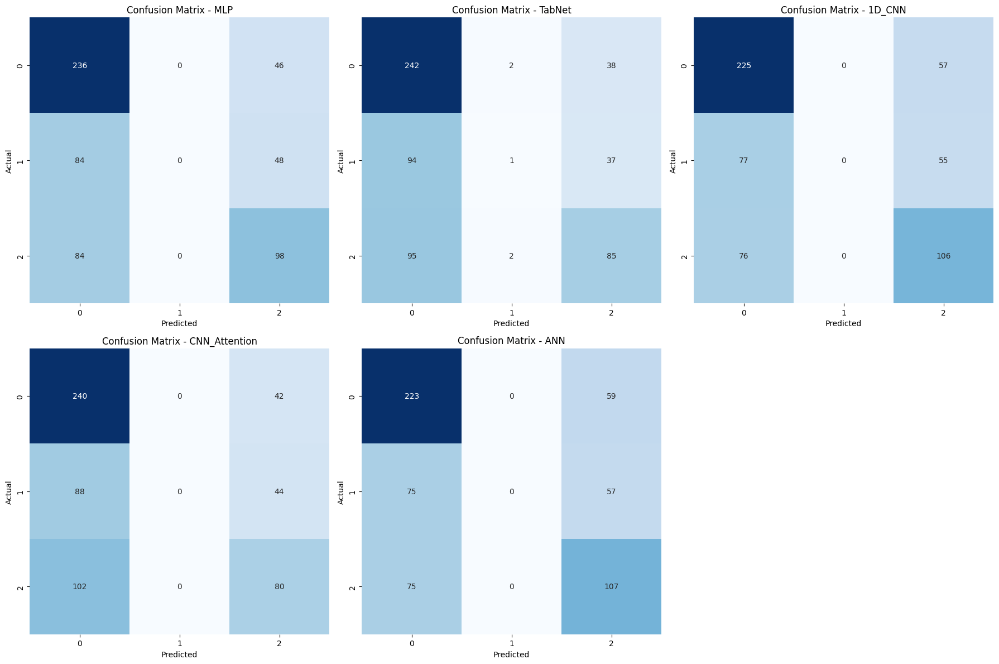

In [143]:
# Plot the confusion matrix
num_models = len(dl_holdout_cms)
cols = 3
rows = (num_models + cols - 1) // cols
fig, axes = plt.subplots(rows, cols, figsize=(cols*6, rows*6))

if rows * cols > 1:
    axes = axes.flatten()
else:
    axes = [axes]

for i, (m_name, m_cm) in enumerate(dl_holdout_cms):
    ax = axes[i] 
    sns.heatmap(m_cm, annot=True, fmt='d', cmap='Blues', cbar=False, ax=ax)
    ax.set_title(f'Confusion Matrix - {m_name}')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')

for j in range(len(dl_holdout_cms), len(axes)):
    axes[j].remove()

plt.tight_layout()
plt.show()

### 5.3.4 Auto Optimizer - Optuna

[I 2024-12-17 11:10:47,354] A new study created in memory with name: no-name-16e8b238-0cad-46d1-8234-729ecb1a1620


GPUs detected: 1


[I 2024-12-17 11:11:03,855] Trial 1 finished with value: 0.5109122700895528 and parameters: {'hidden_layer_sizes': (50, 50), 'activation': 'tanh', 'solver': 'sgd', 'learning_rate_init': 0.08220892327014875, 'momentum': 0.6783397750296645}. Best is trial 1 with value: 0.5109122700895528.
[I 2024-12-17 11:11:08,975] Trial 0 finished with value: 0.50410798020309 and parameters: {'hidden_layer_sizes': (10,), 'activation': 'tanh', 'solver': 'sgd', 'learning_rate_init': 0.0002763624728964547, 'momentum': 0.8754674300879413}. Best is trial 1 with value: 0.5109122700895528.
[I 2024-12-17 11:11:14,310] Trial 2 finished with value: 0.5076277849983771 and parameters: {'hidden_layer_sizes': (100,), 'activation': 'tanh', 'solver': 'adam', 'learning_rate_init': 0.000573218350117521, 'momentum': 0.8334783990637278}. Best is trial 1 with value: 0.5109122700895528.
[I 2024-12-17 11:11:30,310] Trial 4 finished with value: 0.5075094645997836 and parameters: {'hidden_layer_sizes': (50, 50), 'activation': 

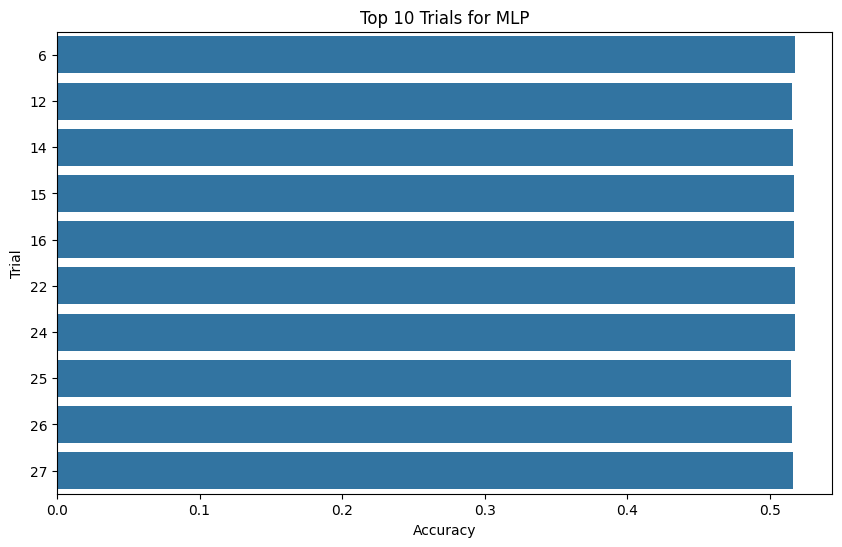

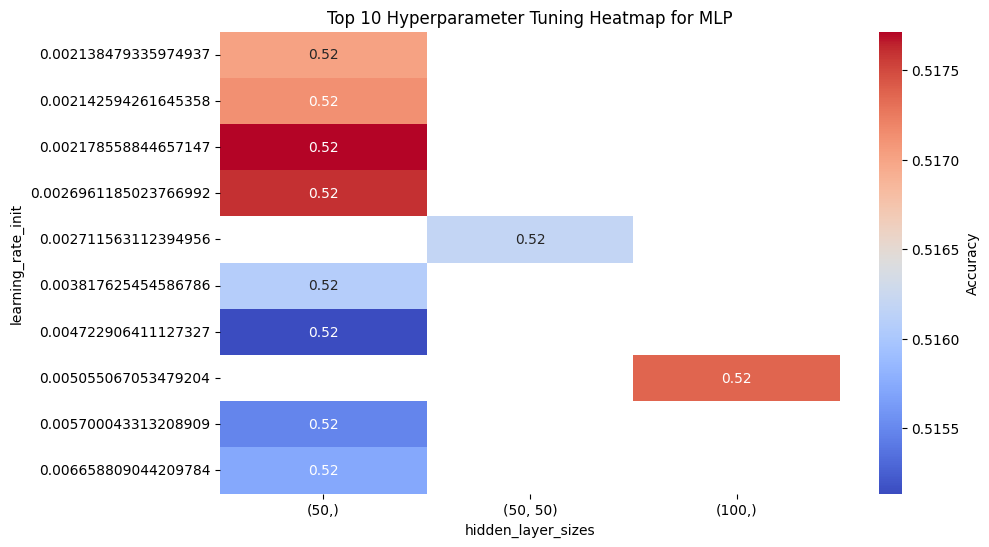

[I 2024-12-17 11:16:06,434] A new study created in memory with name: no-name-115c3b3c-443d-47f9-9947-40ff91f36ec5
[I 2024-12-17 11:21:35,730] Trial 0 finished with value: 0.5105601575007165 and parameters: {'n_d': 16, 'n_a': 16, 'n_steps': 6, 'gamma': 1.2712587879420216, 'lambda_sparse': 0.0007080857623976168}. Best is trial 0 with value: 0.5105601575007165.
[I 2024-12-17 11:21:35,731] Trial 1 finished with value: 0.5071566914644093 and parameters: {'n_d': 8, 'n_a': 32, 'n_steps': 6, 'gamma': 1.4012528734054204, 'lambda_sparse': 1.037287363875356e-06}. Best is trial 0 with value: 0.5105601575007165.
[I 2024-12-17 11:28:31,846] Trial 3 finished with value: 0.5028166117215799 and parameters: {'n_d': 32, 'n_a': 64, 'n_steps': 8, 'gamma': 1.5797353382225994, 'lambda_sparse': 0.00019033185071774326}. Best is trial 0 with value: 0.5105601575007165.
[I 2024-12-17 11:28:31,851] Trial 2 finished with value: 0.49953138351554927 and parameters: {'n_d': 24, 'n_a': 40, 'n_steps': 8, 'gamma': 1.6780

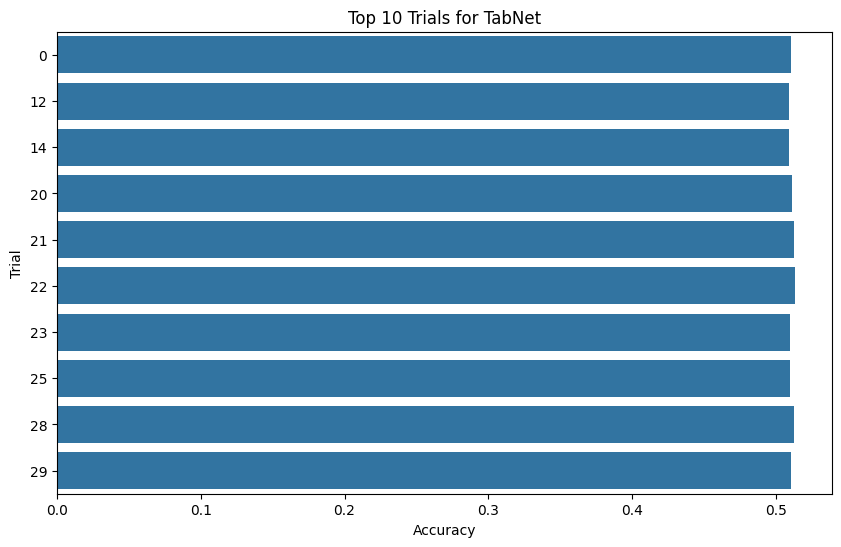

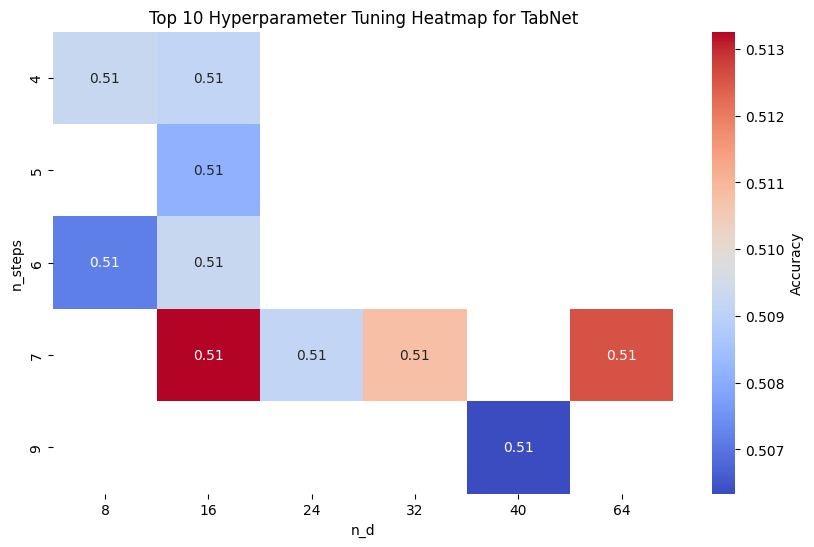

[I 2024-12-17 12:30:42,870] A new study created in memory with name: no-name-62f3b985-b8d7-4084-920c-5f5b218647b2
[W 2024-12-17 12:30:42,874] Trial 0 failed with parameters: {'filters': 16, 'kernel_size': 5, 'learning_rate': 0.001392533015870886, 'dropout_rate': 0.23044511479786772} because of the following error: TypeError("build_optimized_1d_cnn() got an unexpected keyword argument 'filters'").
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/optuna/study/_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
  File "<ipython-input-23-89843a09f5a2>", line 221, in objective
    return gpu_specific_trial(func, trial)
  File "<ipython-input-23-89843a09f5a2>", line 20, in gpu_specific_trial
    return func(trial)
  File "<ipython-input-23-89843a09f5a2>", line 125, in optimize_1d_cnn
    model = build_optimized_1d_cnn(
TypeError: build_optimized_1d_cnn() got an unexpected keyword argument 'filters'
[W 2024-12-17 12:30:42,876] Trial 0 fai

TypeError: build_optimized_1d_cnn() got an unexpected keyword argument 'filters'

In [23]:
import optuna
from tensorflow.keras import layers

# Configure GPUs for parallel processing
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        print(f"GPUs detected: {len(gpus)}")
    except RuntimeError as e:
        print(f"Error configuring GPUs: {e}")
else:
    print("No GPUs detected. Running on CPU.")

# Helper function to assign trials to specific GPUs
def gpu_specific_trial(func, trial):
    gpu_id = trial.number % len(gpus)  # Assign GPU based on trial number
    with tf.device(f'/GPU:{gpu_id}'):
        return func(trial)

# Define optimization functions
def optimize_mlp(trial):
    hidden_layer_sizes = trial.suggest_categorical("hidden_layer_sizes", [(10,), (50,), (100,), (50, 50)])
    activation = trial.suggest_categorical("activation", ["relu", "tanh"])
    solver = trial.suggest_categorical("solver", ["sgd", "adam"])
    learning_rate_init = trial.suggest_loguniform("learning_rate_init", 1e-4, 1e-1)
    momentum = trial.suggest_uniform("momentum", 0.5, 0.99)

    model = MLPClassifier(
        hidden_layer_sizes=hidden_layer_sizes,
        activation=activation,
        solver=solver,
        learning_rate_init=learning_rate_init,
        momentum=momentum,
        max_iter=500,
        random_state=42
    )

    # Convert inputs to NumPy arrays
    X_train_np = X_train.values
    y_train_np = y_train.values.ravel()
    X_val_np = X_val.values
    y_val_np = y_val.values.ravel()

    scores = cross_val_score(model, X_train_np, y_train_np, cv=3, scoring="accuracy")
    return scores.mean()

def optimize_tabnet(trial):
    n_d = trial.suggest_int("n_d", 8, 64, step=8)
    n_a = trial.suggest_int("n_a", 8, 64, step=8)
    n_steps = trial.suggest_int("n_steps", 3, 10)
    gamma = trial.suggest_uniform("gamma", 1.0, 2.0)
    lambda_sparse = trial.suggest_loguniform("lambda_sparse", 1e-6, 1e-3)

    model = TabNetClassifier(
        n_d=n_d,
        n_a=n_a,
        n_steps=n_steps,
        gamma=gamma,
        lambda_sparse=lambda_sparse,
        verbose=0,
        seed=42
    )

    # Convert inputs to NumPy arrays
    X_train_np = X_train.values
    y_train_np = y_train.values.ravel()
    X_val_np = X_val.values
    y_val_np = y_val.values.ravel()

    model.fit(X_train_np, y_train_np)
    scores = cross_val_score(model, X_train_np, y_train_np, cv=3, scoring="accuracy")
    return scores.mean()

# V1: CNN
# def optimize_1d_cnn(trial):
#     filters = trial.suggest_int("filters", 16, 128, step=16)
#     kernel_size = trial.suggest_int("kernel_size", 2, 5)
#     learning_rate = trial.suggest_loguniform("learning_rate", 1e-4, 1e-2)
#     dropout_rate = trial.suggest_uniform("dropout_rate", 0.1, 0.5)

#     model = tf.keras.Sequential([
#         layers.Conv1D(filters=filters, kernel_size=kernel_size, activation='relu', input_shape=(X_train.shape[1], 1)),
#         layers.MaxPooling1D(pool_size=2),
#         layers.Dropout(dropout_rate),
#         layers.Flatten(),
#         layers.Dense(len(set(y_train)), activation='softmax')
#     ])
#     model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
#                   loss='sparse_categorical_crossentropy', metrics=['accuracy'])

#     history = model.fit(X_train, y_train, epochs=10, batch_size=32, verbose=0, validation_data=(X_val, y_val))
#     val_accuracy = max(history.history['val_accuracy'])
#     return val_accuracy

# Parallel optimization function
def parallel_optimize(func, n_trials, n_jobs):
    study = optuna.create_study(direction="maximize")

    def objective(trial):
        return gpu_specific_trial(func, trial)

    study.optimize(objective, n_trials=n_trials, n_jobs=n_jobs)
    return study

# Visualization functions
def plot_optimization_results(study, model_name):
    df = study.trials_dataframe()
    df = df.sort_values("value", ascending=False)

    plt.figure(figsize=(10, 6))
    sns.barplot(data=df[:10], x="value", y=df.index[:10], orient="h")
    plt.title(f"Top 10 Trials for {model_name}")
    plt.xlabel("Accuracy")
    plt.ylabel("Trial")
    plt.show()

def plot_heatmap_results(study, param_x, param_y, model_name, top_n=10):
    df = study.trials_dataframe()
    df = df.dropna()

    # Extract parameter values and metric
    df[param_x] = df[f"params_{param_x}"]
    df[param_y] = df[f"params_{param_y}"]

    # Handle duplicates by grouping and averaging the accuracy
    df = df.groupby([param_x, param_y])["value"].mean().reset_index()

    # Select the top N combinations
    df = df.nlargest(top_n, "value")

    # Pivot the data to create the heatmap structure
    heatmap_data = df.pivot(index=param_y, columns=param_x, values="value").fillna(np.nan)

    # Skip plotting if the heatmap is empty
    if heatmap_data.empty:
        print(f"Not enough data to plot heatmap for {model_name}.")
        return

    # Plot the heatmap
    plt.figure(figsize=(10, 6))
    sns.heatmap(heatmap_data, annot=True, cmap="coolwarm", cbar_kws={"label": "Accuracy"}, fmt=".2f")
    plt.title(f"Top {top_n} Hyperparameter Tuning Heatmap for {model_name}")
    plt.xlabel(param_x)
    plt.ylabel(param_y)
    plt.show()


# Run parallel optimization for each model
mlp_study = parallel_optimize(optimize_mlp, n_trials=30, n_jobs=2)
plot_optimization_results(mlp_study, "MLP")
plot_heatmap_results(mlp_study, "hidden_layer_sizes", "learning_rate_init", "MLP")

tabnet_study = parallel_optimize(optimize_tabnet, n_trials=30, n_jobs=2)
plot_optimization_results(tabnet_study, "TabNet")
plot_heatmap_results(tabnet_study, "n_d", "n_steps", "TabNet")

[I 2024-12-17 13:11:26,263] A new study created in memory with name: no-name-6f923366-9a90-4be8-95be-f07bd9a09802
[I 2024-12-17 13:11:38,650] Trial 1 finished with value: 0.5620805621147156 and parameters: {'filters': 32, 'kernel_size': 3, 'learning_rate': 0.0004605173403011609, 'dropout_rate': 0.40020579750492047}. Best is trial 1 with value: 0.5620805621147156.
[I 2024-12-17 13:11:38,691] Trial 0 finished with value: 0.5402684807777405 and parameters: {'filters': 16, 'kernel_size': 3, 'learning_rate': 0.0003241962481333095, 'dropout_rate': 0.4502179035309358}. Best is trial 1 with value: 0.5620805621147156.
[I 2024-12-17 13:11:48,492] Trial 2 finished with value: 0.5520133972167969 and parameters: {'filters': 32, 'kernel_size': 2, 'learning_rate': 0.00022478867913255213, 'dropout_rate': 0.23022407766275288}. Best is trial 1 with value: 0.5620805621147156.
[I 2024-12-17 13:11:50,033] Trial 3 finished with value: 0.5587248206138611 and parameters: {'filters': 64, 'kernel_size': 2, 'lea

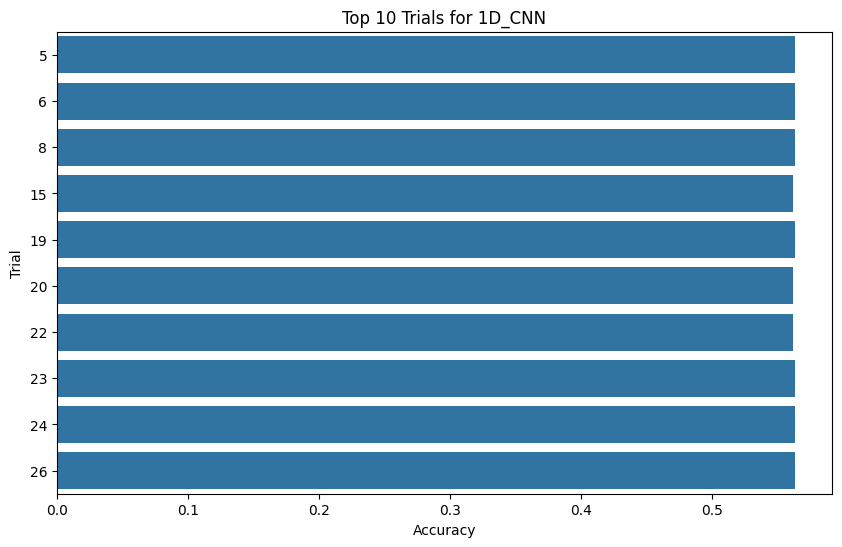

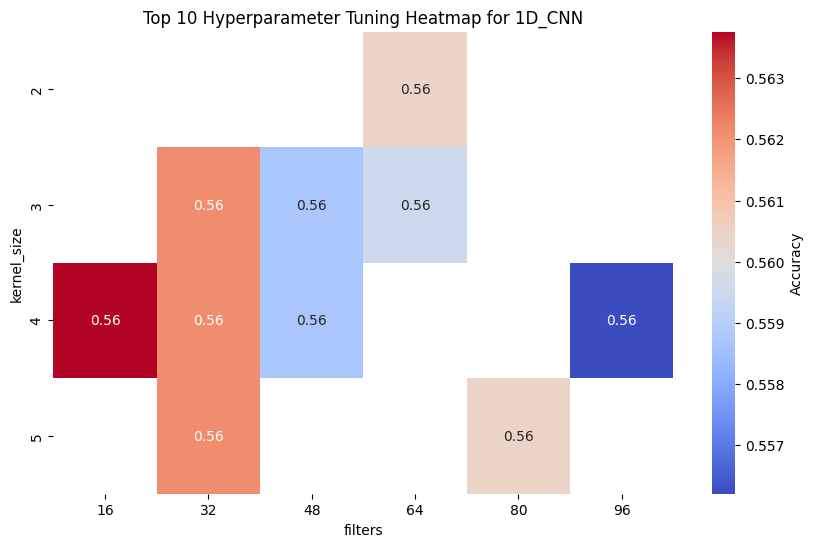

In [40]:
# V2: CNN
def optimize_1d_cnn(trial):
    filters = trial.suggest_int("filters", 16, 128, step=16)
    kernel_size = trial.suggest_int("kernel_size", 2, 5)
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-4, 1e-2)
    dropout_rate = trial.suggest_uniform("dropout_rate", 0.1, 0.5)

    model = tf.keras.Sequential([
        layers.Conv1D(filters=filters, kernel_size=kernel_size, activation='relu', input_shape=(X_train.shape[1], 1)),
        layers.MaxPooling1D(pool_size=2),
        layers.Dropout(dropout_rate),
        layers.Flatten(),
        layers.Dense(len(set(y_train)), activation='softmax')
    ])
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                  loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    history = model.fit(X_train, y_train, epochs=10, batch_size=32, verbose=0, validation_data=(X_val, y_val))
    val_accuracy = max(history.history['val_accuracy'])
    return val_accuracy


cnn_study = parallel_optimize(optimize_1d_cnn, n_trials=30, n_jobs=2)
plot_optimization_results(cnn_study, "1D_CNN")
plot_heatmap_results(cnn_study, "filters", "kernel_size", "1D_CNN")

[I 2024-12-17 12:51:31,531] A new study created in memory with name: no-name-2d805e35-58fb-4306-bb8a-ab6a6a56c8b7


GPUs detected: 1


[I 2024-12-17 12:51:44,289] Trial 0 finished with value: 0.47315436601638794 and parameters: {'filters': 32, 'kernel_size': 3, 'learning_rate': 0.00012137492708882318, 'attention_units': 80}. Best is trial 0 with value: 0.47315436601638794.
[I 2024-12-17 12:51:44,503] Trial 1 finished with value: 0.47315436601638794 and parameters: {'filters': 32, 'kernel_size': 5, 'learning_rate': 0.00022906858908550777, 'attention_units': 80}. Best is trial 0 with value: 0.47315436601638794.
[I 2024-12-17 12:51:57,958] Trial 2 finished with value: 0.47315436601638794 and parameters: {'filters': 64, 'kernel_size': 5, 'learning_rate': 0.00011107969223773199, 'attention_units': 128}. Best is trial 0 with value: 0.47315436601638794.
[I 2024-12-17 12:52:00,060] Trial 3 finished with value: 0.47315436601638794 and parameters: {'filters': 112, 'kernel_size': 3, 'learning_rate': 0.00772089863720499, 'attention_units': 128}. Best is trial 0 with value: 0.47315436601638794.
[I 2024-12-17 12:52:09,210] Trial 4 

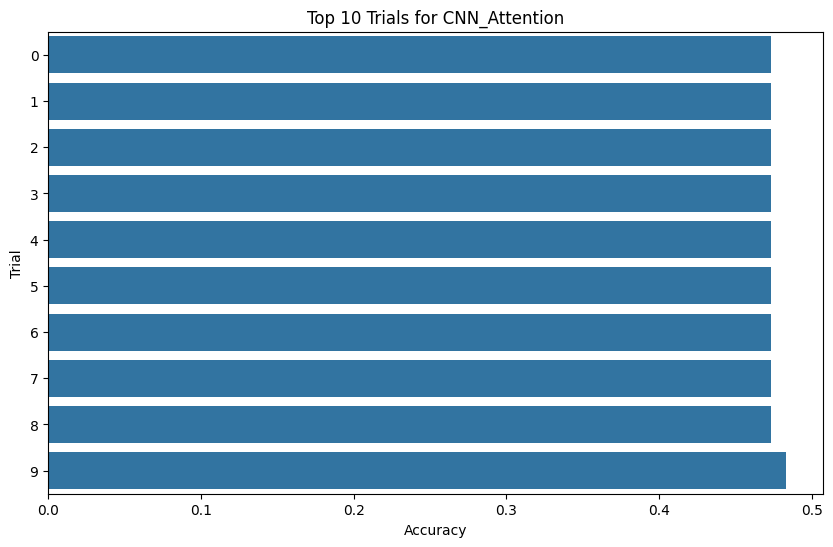

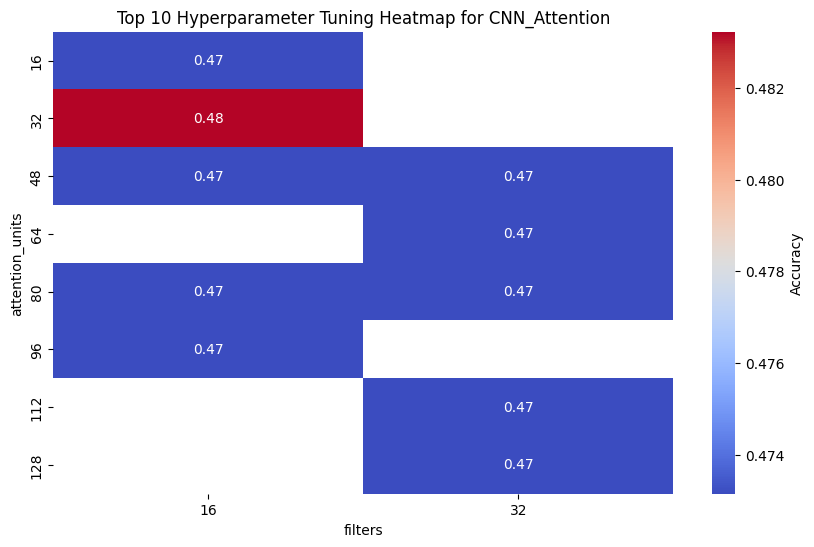

[I 2024-12-17 12:54:17,953] A new study created in memory with name: no-name-d425bd30-65a1-4140-a79e-16efee8a31c1
[I 2024-12-17 12:54:28,719] Trial 0 finished with value: 0.5570470094680786 and parameters: {'units': 96, 'learning_rate': 0.007656410017266745, 'dropout_rate': 0.45068394282652025}. Best is trial 0 with value: 0.5570470094680786.
[I 2024-12-17 12:54:30,523] Trial 1 finished with value: 0.5587248206138611 and parameters: {'units': 224, 'learning_rate': 0.004974521593192185, 'dropout_rate': 0.3175444371024001}. Best is trial 1 with value: 0.5587248206138611.
[I 2024-12-17 12:54:40,805] Trial 2 finished with value: 0.5620805621147156 and parameters: {'units': 192, 'learning_rate': 0.00024598429547943355, 'dropout_rate': 0.310005800480985}. Best is trial 2 with value: 0.5620805621147156.
[I 2024-12-17 12:54:42,684] Trial 3 finished with value: 0.5620805621147156 and parameters: {'units': 160, 'learning_rate': 0.0011320681293981573, 'dropout_rate': 0.31860637601613206}. Best is

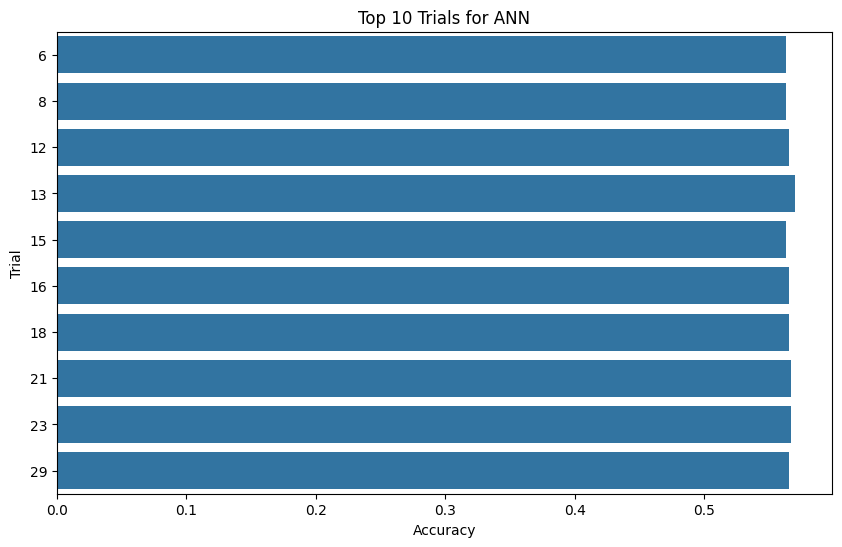

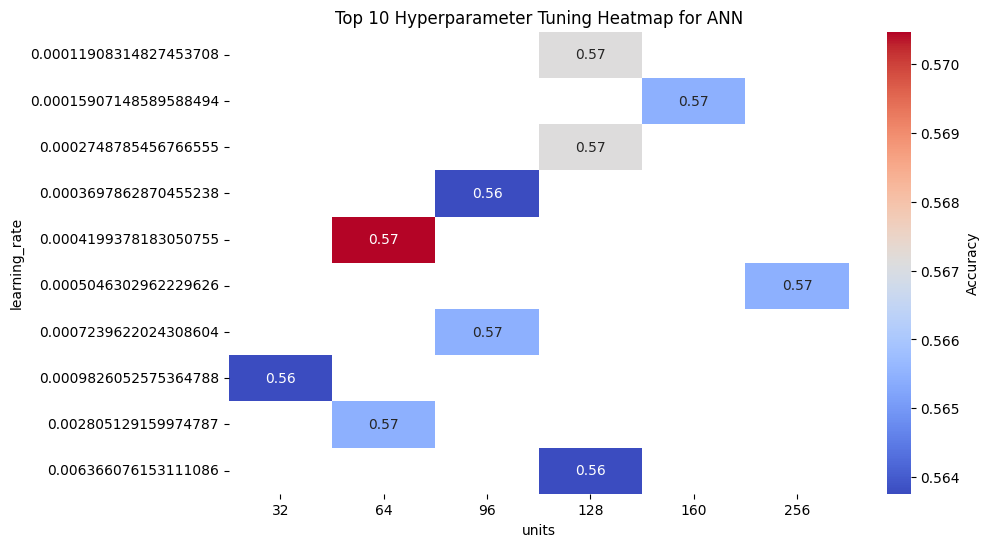

In [27]:
def optimize_cnn_attention(trial):
    # Suggest hyperparameters
    filters = trial.suggest_int("filters", 16, 128, step=16)
    kernel_size = trial.suggest_int("kernel_size", 2, 5)
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-4, 1e-2)
    attention_units = trial.suggest_int("attention_units", 16, 128, step=16)

    # Convert inputs to NumPy arrays
    X_train_np = X_train.values
    y_train_np = y_train.values.ravel()
    X_val_np = X_val.values
    y_val_np = y_val.values.ravel()

    # Build the model
    inputs = layers.Input(shape=(X_train_np.shape[1], 1))
    x = layers.Conv1D(filters=filters, kernel_size=kernel_size, activation='relu')(inputs)
    x = layers.GlobalAveragePooling1D()(x)

    # Align the shape of attention output with x
    attention = layers.Dense(filters, activation='softmax')(x)  # Match the shape of x

    # Multiply x with attention
    x = layers.Multiply()([x, attention])

    # Add the output layer
    outputs = layers.Dense(len(set(y_train)), activation='softmax')(x)
    model = tf.keras.Model(inputs, outputs)

    # Compile the model
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                  loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    # Train the model
    history = model.fit(X_train_np, y_train_np, epochs=10, batch_size=32, verbose=0, validation_data=(X_val_np, y_val_np))

    # Return the best validation accuracy
    val_accuracy = max(history.history['val_accuracy'])
    return val_accuracy

def optimize_ann(trial):
    units = trial.suggest_int("units", 32, 256, step=32)
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-4, 1e-2)
    dropout_rate = trial.suggest_uniform("dropout_rate", 0.1, 0.5)

    # Convert inputs to NumPy arrays
    X_train_np = X_train.values
    y_train_np = y_train.values.ravel()
    X_val_np = X_val.values
    y_val_np = y_val.values.ravel()

    model = tf.keras.Sequential([
        layers.Dense(units, activation='relu', input_shape=(X_train_np.shape[1],)),
        layers.Dropout(dropout_rate),
        layers.Dense(len(set(y_train_np)), activation='softmax')
    ])
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                  loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    history = model.fit(X_train_np, y_train_np, epochs=10, batch_size=32, verbose=0, validation_data=(X_val_np, y_val_np))
    val_accuracy = max(history.history['val_accuracy'])
    return val_accuracy


attention_study = parallel_optimize(optimize_cnn_attention, n_trials=30, n_jobs=2)
plot_optimization_results(attention_study, "CNN_Attention")
plot_heatmap_results(attention_study, "filters", "attention_units", "CNN_Attention")

ann_study = parallel_optimize(optimize_ann, n_trials=30, n_jobs=2)
plot_optimization_results(ann_study, "ANN")
plot_heatmap_results(ann_study, "units", "learning_rate", "ANN")

### 5.3.5 Counter Plot

In [41]:
from optuna.visualization import plot_contour
from IPython.display import Image, display

def plot_contour_results(study, param_x, param_y, model_name):
    # Ensure the parameters exist in the study
    all_params = [t.params.keys() for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE]
    flattened_params = set(p for sublist in all_params for p in sublist)

    if param_x not in flattened_params or param_y not in flattened_params:
        print(f"Parameters {param_x} and/or {param_y} are not available in the study.")
        return

    # Generate the contour plot using Optuna
    contour_plot = plot_contour(study, params=[param_x, param_y])

    # Save the plot to an image file
    image_path = f"{model_name}_contour_plot.png"
    # contour_plot.write_image(image_path)
    contour_plot.show()

    # Display the saved image
    # print(f"Contour plot saved to: {image_path}")
    # display(Image(image_path))


# Plot for MLP
plot_contour_results(mlp_study, "hidden_layer_sizes", "learning_rate_init", "MLP")

# Plot for TabNet
plot_contour_results(tabnet_study, "n_d", "n_steps", "TabNet")

# Plot for 1D_CNN
plot_contour_results(cnn_study, "filters", "kernel_size", "1D_CNN")

# Plot for CNN_Attention
plot_contour_results(attention_study, "filters", "attention_units", "CNN_Attention")

# Plot for ANN
plot_contour_results(ann_study, "units", "learning_rate", "ANN")

## 5.4 Combined Models

+ Voting
+ Stacking
+ 2-Step classifier

### 5.4.1 Model Setup

In [144]:
class TwoStepClassifier(BaseEstimator, ClassifierMixin):
    """
    A two-step classification model for hierarchical classification tasks.

    This classifier works in two steps:
      1. Step 1 predicts whether a sample belongs to the base class (class 0) or non-base classes (class 1 or 2).
      2. Step 2 refines predictions for samples classified as non-base, distinguishing between subclasses (class 1 and class 2).

    Attributes:
        step1_model (BaseEstimator): The first-step binary classification model used to distinguish class 0 vs. non-0.
        step2_model (BaseEstimator): The second-step binary classification model used to distinguish subclasses 1 and 2.
        is_step2_trained (bool): Indicates whether the second-step model has been trained (based on available samples).

    Methods:
        fit(X, y):
            Trains both step 1 and step 2 models sequentially.
            - Step 1 trains on the binary labels for class 0 vs. non-0.
            - Step 2 trains on the subclass labels (class 1 vs. class 2) for samples classified as non-zero.

            Args:
                X (array-like): Input data for training.
                y (array-like): Target labels. Expected values are 0, 1, and 2.

            Returns:
                self: The trained TwoStepClassifier instance.

        predict(X):
            Makes predictions for the input data.
            - Uses the step 1 model to classify samples as 0 or non-0.
            - For samples classified as non-zero, the step 2 model refines predictions to 1 or 2.

            Args:
                X (array-like): Input data for predictions.

            Returns:
                array: Predicted class labels for each sample.

        predict_proba(X):
            Predicts probabilities for each class (0, 1, 2) for the input data.
            - Step 1 computes probabilities for class 0 vs. non-0.
            - Step 2 computes probabilities for subclasses (class 1 and class 2) for samples classified as non-zero.

            Args:
                X (array-like): Input data for probability predictions.

            Returns:
                array: Predicted probabilities for each class. Shape: (n_samples, 3).
    """
    
    def __init__(self, step1_model, step2_model):
        self.step1_model = step1_model
        self.step2_model = step2_model
        self.is_step2_trained = False

    def fit(self, X, y):
        # Step 1: Binarize `y` for the first step (0 vs. non-0)
        y_step1 = (y == 0).astype(int)
        
        # Check for missing values
        if isinstance(y_step1, np.ndarray):
            assert not np.isnan(y_step1).any(), "y_step1 contains NaN values after mapping."
        else:
            assert y_step1.notnull().all(), "y_step1 contains NaN values after mapping."
        
        # Train the first-step model
        self.step1_model.fit(X, y_step1)

        # Use the first-step model to predict on the training set
        y_pred_step1 = self.step1_model.predict(X)
        non_zero_mask = (y_step1 == 0)
        X_step2 = X[non_zero_mask]
        y_step2 = y[non_zero_mask]

        # Train the second-step model if there are non-zero samples
        if len(X_step2) > 0 and len(np.unique(y_step2)) > 1:
            y_step2_mapped = (y_step2 - 1).astype(int)  # Map y_step2 to [0, 1]
            if isinstance(y_step2_mapped, np.ndarray):
                assert not np.isnan(y_step2_mapped).any(), "y_step2_mapped contains NaN values after mapping."
            else:
                assert y_step2_mapped.notnull().all(), "y_step2_mapped contains NaN values after mapping."
            self.step2_model.fit(X_step2, y_step2_mapped)
            self.is_step2_trained = True
        else:
            self.is_step2_trained = False

        return self

    def predict(self, X):
        # Step 1 predictions
        y_step1_pred = self.step1_model.predict(X)

        # Initialize final predictions as 0
        y_final = np.zeros_like(y_step1_pred)

        # Predict for non-zero classes using the second-step model
        if self.is_step2_trained:
            non_zero_mask = (y_step1_pred == 0)
            if np.sum(non_zero_mask) > 0:
                X_step2 = X[non_zero_mask]
                y_step2_pred_mapped = self.step2_model.predict(X_step2)
                y_step2_pred = (y_step2_pred_mapped + 1).astype(int)  # Map back to [1, 2]
                y_final[non_zero_mask] = y_step2_pred

        return y_final
    
    def predict_proba(self, X):
        """
        Predict probabilities for each class.
        Step 1 predicts probability for class 0 (vs non-0).
        Step 2 predicts probabilities for classes 1 and 2.
        """
        # Step 1 probabilities
        step1_proba = self.step1_model.predict_proba(X)  # shape: (n_samples, 2)
        proba_class_0 = step1_proba[:, 1]  # Probability of class 0
        proba_non_0 = step1_proba[:, 0]  # Probability of not class 0

        # Initialize probabilities with shape (n_samples, 3): class 0, 1, 2
        final_proba = np.zeros((X.shape[0], 3))
        final_proba[:, 0] = proba_class_0  # Class 0 probabilities

        # Step 2 probabilities for non-zero classes
        if self.is_step2_trained:
            non_zero_mask = (proba_non_0 > 0.5)  # Samples likely to be non-zero
            if np.sum(non_zero_mask) > 0:
                X_step2 = X[non_zero_mask]
                step2_proba = self.step2_model.predict_proba(X_step2)  # shape: (n_non_zero, 2)
                final_proba[non_zero_mask, 1] = step2_proba[:, 0] * proba_non_0[non_zero_mask]
                final_proba[non_zero_mask, 2] = step2_proba[:, 1] * proba_non_0[non_zero_mask]

        # Normalize probabilities to sum to 1
        final_proba = final_proba / final_proba.sum(axis=1, keepdims=True)
        return final_proba

In [145]:
voting_models = {
    'voting_lrm': VotingClassifier(estimators=[
        ('LogisticRegression', LogisticRegression().set_params(**best_params_dict['LogisticRegression'])),
        ('RandomForest', RandomForestClassifier().set_params(**best_params_dict['RandomForest'])),
        ('MLP', MLPClassifier(
            hidden_layer_sizes=(100,), 
            activation='tanh', 
            solver='sgd', 
            learning_rate_init=0.003075229364681813, 
            momentum=0.7190016375585988, 
            max_iter=500, 
            random_state=RANDOM_SEED
            )) # Optimized Param from Optuna
    ], voting='soft'),
    'voting_xlc': VotingClassifier(estimators=[
        ('XGBoost', XGBClassifier().set_params(**best_params_dict['XGBoost'])),
        ('LightGBM', LGBMClassifier().set_params(**best_params_dict['LightGBM'])),
        ('CatBoost', CatBoostClassifier().set_params(**best_params_dict['CatBoost']))
    ], voting='soft'),
    'voting_slc': VotingClassifier(estimators=[
        ('SVM', SVC().set_params(**best_params_dict['SVM'])),
        ('LightGBM', LGBMClassifier().set_params(**best_params_dict['LightGBM'])),
        ('CatBoost', CatBoostClassifier().set_params(**best_params_dict['CatBoost']))
    ], voting='soft'),
    'voting_sln': VotingClassifier(estimators=[
        ('LogisticRegression', LogisticRegression().set_params(**best_params_dict['LogisticRegression'])),
        ('SVM', SVC().set_params(**best_params_dict['SVM'])),
        ('NaiveBayes', GaussianNB().set_params(**best_params_dict['NaiveBayes']))
    ], voting='soft'),
    'voting_sl': VotingClassifier(estimators=[
        ('LogisticRegression', LogisticRegression().set_params(**best_params_dict['LogisticRegression'])),
        ('SVM', SVC().set_params(**best_params_dict['SVM'])),
    ], voting='soft'),
    'voting_sn': VotingClassifier(estimators=[
        ('NaiveBayes', GaussianNB().set_params(**best_params_dict['NaiveBayes'])),
        ('SVM', SVC().set_params(**best_params_dict['SVM'])),
    ], voting='soft'),
    'voting_sr': VotingClassifier(estimators=[
        ('RandomForest', RandomForestClassifier().set_params(**best_params_dict['RandomForest'])),
        ('SVM', SVC().set_params(**best_params_dict['SVM'])),
    ], voting='soft'),
    'voting_lgbms': VotingClassifier(estimators=[
        ('LightGBM', LGBMClassifier().set_params(**best_params_dict['LightGBM'])),
        ('SVM', SVC().set_params(**best_params_dict['SVM'])),
    ], voting='soft'),
    'voting_final': VotingClassifier(estimators=[
        ('LogisticRegression', LogisticRegression().set_params(**best_params_dict['LogisticRegression'])),
        ('RandomForest', RandomForestClassifier().set_params(**best_params_dict['RandomForest'])),
        ('XGBoost', XGBClassifier().set_params(**best_params_dict['XGBoost'])),
        ('ExtraTrees', ExtraTreesClassifier().set_params(**best_params_dict['ExtraTrees'])),
        ('LightGBM', LGBMClassifier().set_params(**best_params_dict['LightGBM'])),
        ('2step_cr', TwoStepClassifier(
            step1_model=CatBoostClassifier().set_params(**best_params_dict['CatBoost']),
            step2_model=RandomForestClassifier().set_params(**best_params_dict['RandomForest'])
        )),
        ('stack_sl', StackingClassifier(
            estimators=[
                ('LogisticRegression', LogisticRegression().set_params(**best_params_dict['LogisticRegression'])),
                ('SVM', SVC().set_params(**best_params_dict['SVM']))
            ],
            final_estimator=RandomForestClassifier(random_state=RANDOM_SEED)
        ))
    ], voting='soft')
}

stacking_models = {
    'stack_lrm': StackingClassifier(
        estimators=[
            ('SVM', SVC().set_params(**best_params_dict['SVM'])),
            ('MLP', MLPClassifier(
                hidden_layer_sizes=(100,), 
                activation='tanh', 
                solver='sgd', 
                learning_rate_init=0.003075229364681813, 
                momentum=0.7190016375585988, 
                max_iter=500, 
                random_state=RANDOM_SEED
                )),
            ('LogisticRegression', LogisticRegression().set_params(**best_params_dict['LogisticRegression']))
        ],
        final_estimator= RandomForestClassifier(random_state=RANDOM_SEED, verbose=0)
    ),
    'stack_xlc': StackingClassifier(
        estimators=[
            ('XGBoost', XGBClassifier().set_params(**best_params_dict['XGBoost'])),
            ('LightGBM', LGBMClassifier().set_params(**best_params_dict['LightGBM'])),
            ('CatBoost', CatBoostClassifier().set_params(**best_params_dict['CatBoost']))
        ],
        final_estimator= RandomForestClassifier(random_state=RANDOM_SEED, verbose=0)
    ),
    'stack_slc': StackingClassifier(
        estimators=[
            ('SVM', SVC().set_params(**best_params_dict['SVM'])),
            ('LightGBM', LGBMClassifier().set_params(**best_params_dict['LightGBM'])),
            ('CatBoost', CatBoostClassifier().set_params(**best_params_dict['CatBoost']))
        ],
        final_estimator= RandomForestClassifier(random_state=RANDOM_SEED, verbose=0)
    ),
    'stack_sl': StackingClassifier(
        estimators=[
            ('LogisticRegression', LogisticRegression().set_params(**best_params_dict['LogisticRegression'])),
            ('SVM', SVC().set_params(**best_params_dict['SVM'])),
        ],
        final_estimator= RandomForestClassifier(random_state=RANDOM_SEED, verbose=0)
    ),
    'stack_sn': StackingClassifier(
        estimators=[
            ('SVM', SVC().set_params(**best_params_dict['SVM'])),
            ('NaiveBayes', GaussianNB().set_params(**best_params_dict['NaiveBayes']))
        ],
        final_estimator=RandomForestClassifier(random_state=RANDOM_SEED, verbose=0)
    ),
    'stack_sr': StackingClassifier(
        estimators=[
            ('RandomForest', RandomForestClassifier().set_params(**best_params_dict['RandomForest'])),
            ('SVM', SVC().set_params(**best_params_dict['SVM'])),
        ],
        final_estimator= RandomForestClassifier(random_state=RANDOM_SEED, verbose=0)
    ),
    'stack_lgbms': StackingClassifier(
        estimators=[
            ('LightGBM', LGBMClassifier().set_params(**best_params_dict['LightGBM'])),
            ('SVM', SVC().set_params(**best_params_dict['SVM'])),
        ],
        final_estimator= RandomForestClassifier(random_state=RANDOM_SEED, verbose=0)
    )
}

two_step_models = {
    '2step_cr': TwoStepClassifier(
        step1_model=CatBoostClassifier().set_params(**best_params_dict['CatBoost']),
        step2_model=RandomForestClassifier().set_params(**best_params_dict['RandomForest'])
    ),
    '2step_clgbm': TwoStepClassifier(
        step1_model=CatBoostClassifier().set_params(**best_params_dict['CatBoost']),
        step2_model=LGBMClassifier().set_params(**best_params_dict['LightGBM'])
    ),
    '2step_cs': TwoStepClassifier(
        step1_model=CatBoostClassifier().set_params(**best_params_dict['CatBoost']),
        step2_model=SVC().set_params(**best_params_dict['SVM'])
    ),
    '2step_sr': TwoStepClassifier(
        step1_model=RandomForestClassifier().set_params(**best_params_dict['RandomForest']),
        step2_model=SVC().set_params(**best_params_dict['SVM'])
    ),
    '2step_sn': TwoStepClassifier(
        step1_model=GaussianNB().set_params(**best_params_dict['NaiveBayes']),
        step2_model=SVC().set_params(**best_params_dict['SVM'])
    ),
    '2step_sl': TwoStepClassifier(
        step1_model=LogisticRegression().set_params(**best_params_dict['LogisticRegression']),
        step2_model= SVC().set_params(**best_params_dict['SVM'])
    ),
    '2step_ln': TwoStepClassifier(
        step1_model=LogisticRegression().set_params(**best_params_dict['LogisticRegression']),
        step2_model= GaussianNB().set_params(**best_params_dict['NaiveBayes'])
    ),
    '2step_lgbms': TwoStepClassifier(
        step1_model=CatBoostClassifier().set_params(**best_params_dict['CatBoost']),
        step2_model=SVC().set_params(**best_params_dict['SVM'])
    )
}

combined_models = {
    **voting_models,
    **stacking_models,
    **two_step_models
}

### 5.4.2 Model Training and Validation

In [146]:
model_names = []
cv_mean_accuracies = []
cv_std_accuracies = []
cv_mean_precisions = []
cv_std_precisions = []
cv_mean_recalls = []
cv_std_recalls = []
cv_mean_f1s = []
cv_std_f1s = []
cv_mean_ignorances = []
cv_std_ignorances = []
cv_mean_rps_values = []
cv_std_rps_values = []

holdout_accuracies = []
holdout_precisions = []
holdout_recalls = []
holdout_f1s = []
holdout_cms = []
holdout_ignorances = []
holdout_rps_values = []

for model_name, model in tqdm(combined_models.items(), desc="Training on model:"):
    start_time = time.time()
    X_train_data, y_train_data = X_train, y_train
    X_val_data, y_val_data = X_val, y_val
        
    cv_results = cross_validate(model, X_train_data, y_train_data, cv=NUM_FOLD, scoring=scoring, n_jobs=-1)

    # Compute mean and std for CV metrics
    cv_mean_accuracy = np.mean(cv_results['test_accuracy'])
    cv_std_accuracy = np.std(cv_results['test_accuracy'])
    cv_mean_precision = np.mean(cv_results['test_precision'])
    cv_std_precision = np.std(cv_results['test_precision'])
    cv_mean_recall = np.mean(cv_results['test_recall'])
    cv_std_recall = np.std(cv_results['test_recall'])
    cv_mean_f1 = np.mean(cv_results['test_f1_weighted'])
    cv_std_f1 = np.std(cv_results['test_f1_weighted'])
    cv_mean_ignorance = np.mean(cv_results['test_ignorance_score'])
    cv_std_ignorance = np.std(cv_results['test_ignorance_score'])
    cv_mean_rps = np.mean(cv_results['test_rps'])
    cv_std_rps = np.std(cv_results['test_rps'])

    print(f"{model_name} - CV Mean Accuracy: {cv_mean_accuracy:.4f}, "
          f"Precision: {cv_mean_precision:.4f}, Recall: {cv_mean_recall:.4f}, F1: {cv_mean_f1:.4f}, "
          f"Ignorance: {cv_mean_ignorance:.4f}, RPS: {cv_mean_rps:.4f}")

    # Train and evaluate on holdout set
    model.fit(X_train_data, y_train_data)
    y_pred = model.predict(X_val_data)
    y_pred_proba = model.predict_proba(X_val_data)

    # Holdout metrics
    holdout_acc = accuracy_score(y_val_data, y_pred)
    holdout_precision = precision_score(y_val_data, y_pred, average='weighted', zero_division=0)
    holdout_recall = recall_score(y_val_data, y_pred, average='weighted', zero_division=0)
    holdout_f1 = f1_score(y_val_data, y_pred, average='weighted', zero_division=0)
    holdout_ignorance = ignorance_score(y_val_data, y_pred_proba)
    holdout_rps = ranked_probability_score(y_val_data, y_pred_proba)

    holdout_cm = confusion_matrix(y_val_data, y_pred)

    print(f"{model_name} - Holdout Accuracy: {holdout_acc:.4f}, Precision: {holdout_precision:.4f}, "
          f"Recall: {holdout_recall:.4f}, F1-Score: {holdout_f1:.4f}, "
          f"Ignorance: {holdout_ignorance:.4f}, RPS: {holdout_rps:.4f}")

    with open(os.path.join(model_dir, f'{model_name}.pkl'), 'wb') as f:
        pickle.dump(model, f)

    # Append results
    model_names.append(model_name)
    cv_mean_accuracies.append(cv_mean_accuracy)
    cv_std_accuracies.append(cv_std_accuracy)
    cv_mean_precisions.append(cv_mean_precision)
    cv_std_precisions.append(cv_std_precision)
    cv_mean_recalls.append(cv_mean_recall)
    cv_std_recalls.append(cv_std_recall)
    cv_mean_f1s.append(cv_mean_f1)
    cv_std_f1s.append(cv_std_f1)
    cv_mean_ignorances.append(cv_mean_ignorance)
    cv_std_ignorances.append(cv_std_ignorance)
    cv_mean_rps_values.append(cv_mean_rps)
    cv_std_rps_values.append(cv_std_rps)

    holdout_accuracies.append(holdout_acc)
    holdout_precisions.append(holdout_precision)
    holdout_recalls.append(holdout_recall)
    holdout_f1s.append(holdout_f1)
    holdout_cms.append((model_name, holdout_cm))
    holdout_ignorances.append(holdout_ignorance)
    holdout_rps_values.append(holdout_rps)

    end_time = time.time()
    duration = end_time - start_time
    print(f"{model_name} completed in {duration:.2f} seconds.")

# Create summary dataframe
combined_metrics_df = pd.DataFrame({
    'Model': model_names,
    'CV_Mean_Accuracy': cv_mean_accuracies,
    'CV_Std_Accuracy': cv_std_accuracies,
    'CV_Mean_Precision': cv_mean_precisions,
    'CV_Std_Precision': cv_std_precisions,
    'CV_Mean_Recall': cv_mean_recalls,
    'CV_Std_Recall': cv_std_recalls,
    'CV_Mean_F1': cv_mean_f1s,
    'CV_Std_F1': cv_std_f1s,
    'CV_Mean_Ignorances': cv_mean_ignorances,
    'CV_Std_Ignorances': cv_std_ignorances,
    'CV_Mean_RPS': cv_mean_rps_values,
    'CV_Std_RPS': cv_std_rps_values,
    'Holdout_Accuracy': holdout_accuracies,
    'Holdout_Precision': holdout_precisions,
    'Holdout_Recall': holdout_recalls,
    'Holdout_F1': holdout_f1s,
    'Holdout_ignorances': holdout_ignorances,
    'Holdout_RPS': holdout_rps_values
})

combined_holdout_cms = holdout_cms.copy()
with open('combined_holdout_cms.pkl', 'wb') as f:
    pickle.dump(combined_holdout_cms, f)
combined_metrics_df.to_csv('combined_model_metrics_summary.csv', index=False)
combined_metrics_df.sort_values(by='Holdout_F1', ascending=False)

Training on model::   0%|                                                                       | 0/24 [00:00<?, ?it/s]

voting_lrm - CV Mean Accuracy: 0.5148, Precision: 0.5252, Recall: 0.5148, F1: 0.4481, Ignorance: 1.4426, RPS: 0.2140


Training on model::   4%|██▋                                                            | 1/24 [00:54<20:48, 54.28s/it]

voting_lrm - Holdout Accuracy: 0.5570, Precision: 0.4310, Recall: 0.5570, F1-Score: 0.4849, Ignorance: 1.3937, RPS: 0.2073
voting_lrm completed in 54.28 seconds.
voting_xlc - CV Mean Accuracy: 0.4897, Precision: 0.4549, Recall: 0.4897, F1: 0.4531, Ignorance: 1.5821, RPS: 0.2296
voting_xlc - Holdout Accuracy: 0.5201, Precision: 0.4463, Recall: 0.5201, F1-Score: 0.4725, Ignorance: 1.4669, RPS: 0.2152


Training on model::   8%|█████▎                                                         | 2/24 [02:35<30:01, 81.91s/it]

voting_xlc completed in 101.25 seconds.
voting_slc - CV Mean Accuracy: 0.4989, Precision: 0.4653, Recall: 0.4989, F1: 0.4554, Ignorance: 1.5044, RPS: 0.2211


Training on model::  12%|███████▊                                                      | 3/24 [05:21<42:02, 120.12s/it]

voting_slc - Holdout Accuracy: 0.5235, Precision: 0.4427, Recall: 0.5235, F1-Score: 0.4705, Ignorance: 1.4211, RPS: 0.2099
voting_slc completed in 165.60 seconds.
voting_sln - CV Mean Accuracy: 0.4978, Precision: 0.4515, Recall: 0.4978, F1: 0.4438, Ignorance: 1.4859, RPS: 0.2212


Training on model::  17%|██████████▎                                                   | 4/24 [06:46<35:27, 106.36s/it]

voting_sln - Holdout Accuracy: 0.5436, Precision: 0.4241, Recall: 0.5436, F1-Score: 0.4765, Ignorance: 1.4161, RPS: 0.2117
voting_sln completed in 85.26 seconds.
voting_sl - CV Mean Accuracy: 0.5130, Precision: 0.4590, Recall: 0.5130, F1: 0.4445, Ignorance: 1.4467, RPS: 0.2146


Training on model::  21%|█████████████▏                                                 | 5/24 [08:11<31:13, 98.61s/it]

voting_sl - Holdout Accuracy: 0.5537, Precision: 0.4260, Recall: 0.5537, F1-Score: 0.4776, Ignorance: 1.3967, RPS: 0.2073
voting_sl completed in 84.85 seconds.
voting_sn - CV Mean Accuracy: 0.4893, Precision: 0.4431, Recall: 0.4893, F1: 0.4410, Ignorance: 1.5318, RPS: 0.2293


Training on model::  25%|███████████████▊                                               | 6/24 [09:35<28:07, 93.76s/it]

voting_sn - Holdout Accuracy: 0.5487, Precision: 0.5403, Recall: 0.5487, F1-Score: 0.4843, Ignorance: 1.4542, RPS: 0.2192
voting_sn completed in 84.36 seconds.
voting_sr - CV Mean Accuracy: 0.5138, Precision: 0.4653, Recall: 0.5138, F1: 0.4592, Ignorance: 1.4467, RPS: 0.2149


Training on model::  29%|██████████████████▍                                            | 7/24 [11:14<27:00, 95.29s/it]

voting_sr - Holdout Accuracy: 0.5604, Precision: 0.4352, Recall: 0.5604, F1-Score: 0.4895, Ignorance: 1.3980, RPS: 0.2084
voting_sr completed in 98.45 seconds.
voting_lgbms - CV Mean Accuracy: 0.4964, Precision: 0.4579, Recall: 0.4964, F1: 0.4542, Ignorance: 1.5209, RPS: 0.2245


Training on model::  33%|████████████████████▋                                         | 8/24 [13:32<29:02, 108.89s/it]

voting_lgbms - Holdout Accuracy: 0.5235, Precision: 0.4433, Recall: 0.5235, F1-Score: 0.4696, Ignorance: 1.4394, RPS: 0.2132
voting_lgbms completed in 138.00 seconds.
voting_final - CV Mean Accuracy: 0.5090, Precision: 0.4599, Recall: 0.5090, F1: 0.4558, Ignorance: 1.4669, RPS: 0.2167
voting_final - Holdout Accuracy: 0.5419, Precision: 0.4636, Recall: 0.5419, F1-Score: 0.4773, Ignorance: 1.3942, RPS: 0.2069


Training on model::  38%|███████████████████████▎                                      | 9/24 [21:13<54:45, 219.05s/it]

voting_final completed in 461.27 seconds.
stack_lrm - CV Mean Accuracy: 0.4736, Precision: 0.4389, Recall: 0.4736, F1: 0.4454, Ignorance: 1.5836, RPS: 0.2270


Training on model::  42%|████████████████████████▌                                  | 10/24 [28:55<1:08:35, 293.99s/it]

stack_lrm - Holdout Accuracy: 0.5386, Precision: 0.5000, Recall: 0.5386, F1-Score: 0.5050, Ignorance: 1.4781, RPS: 0.2177
stack_lrm completed in 461.78 seconds.
stack_xlc - CV Mean Accuracy: 0.4727, Precision: 0.4301, Recall: 0.4727, F1: 0.4343, Ignorance: 1.5206, RPS: 0.2277
stack_xlc - Holdout Accuracy: 0.5000, Precision: 0.4476, Recall: 0.5000, F1-Score: 0.4618, Ignorance: 1.4543, RPS: 0.2162


Training on model::  46%|███████████████████████████                                | 11/24 [39:25<1:26:00, 396.96s/it]

stack_xlc completed in 630.43 seconds.
stack_slc - CV Mean Accuracy: 0.4878, Precision: 0.4458, Recall: 0.4878, F1: 0.4494, Ignorance: 1.5197, RPS: 0.2232
stack_slc - Holdout Accuracy: 0.5503, Precision: 0.5092, Recall: 0.5503, F1-Score: 0.5162, Ignorance: 1.4182, RPS: 0.2080


Training on model::  50%|█████████████████████████████▌                             | 12/24 [54:44<1:51:09, 555.80s/it]

stack_slc completed in 919.08 seconds.
stack_sl - CV Mean Accuracy: 0.4667, Precision: 0.4344, Recall: 0.4667, F1: 0.4423, Ignorance: 1.6473, RPS: 0.2322


Training on model::  54%|██████████████████████████████▊                          | 13/24 [1:00:44<1:30:59, 496.35s/it]

stack_sl - Holdout Accuracy: 0.5319, Precision: 0.5052, Recall: 0.5319, F1-Score: 0.5116, Ignorance: 1.6307, RPS: 0.2187
stack_sl completed in 359.55 seconds.
stack_sn - CV Mean Accuracy: 0.4699, Precision: 0.4387, Recall: 0.4699, F1: 0.4453, Ignorance: 1.5909, RPS: 0.2307


Training on model::  58%|█████████████████████████████████▎                       | 14/24 [1:06:35<1:15:25, 452.52s/it]

stack_sn - Holdout Accuracy: 0.5000, Precision: 0.4634, Recall: 0.5000, F1-Score: 0.4760, Ignorance: 1.5747, RPS: 0.2176
stack_sn completed in 351.24 seconds.
stack_sr - CV Mean Accuracy: 0.4756, Precision: 0.4400, Recall: 0.4756, F1: 0.4465, Ignorance: 1.5788, RPS: 0.2273


Training on model::  62%|███████████████████████████████████▋                     | 15/24 [1:13:27<1:06:01, 440.19s/it]

stack_sr - Holdout Accuracy: 0.5067, Precision: 0.4619, Recall: 0.5067, F1-Score: 0.4706, Ignorance: 1.5462, RPS: 0.2159
stack_sr completed in 411.62 seconds.
stack_lgbms - CV Mean Accuracy: 0.4767, Precision: 0.4436, Recall: 0.4767, F1: 0.4497, Ignorance: 1.5477, RPS: 0.2284
stack_lgbms - Holdout Accuracy: 0.5084, Precision: 0.4638, Recall: 0.5084, F1-Score: 0.4781, Ignorance: 1.4667, RPS: 0.2175


Training on model::  67%|██████████████████████████████████████                   | 16/24 [1:25:47<1:10:44, 530.59s/it]

stack_lgbms completed in 740.51 seconds.
2step_cr - CV Mean Accuracy: nan, Precision: nan, Recall: nan, F1: nan, Ignorance: nan, RPS: nan


Training on model::  71%|█████████████████████████████████████████▊                 | 17/24 [1:26:11<44:08, 378.32s/it]

2step_cr - Holdout Accuracy: 0.5185, Precision: 0.4280, Recall: 0.5185, F1-Score: 0.4601, Ignorance: 9.5611, RPS: 0.2761
2step_cr completed in 24.20 seconds.
2step_clgbm - CV Mean Accuracy: nan, Precision: nan, Recall: nan, F1: nan, Ignorance: nan, RPS: nan


Training on model::  75%|████████████████████████████████████████████▎              | 18/24 [1:26:55<27:46, 277.73s/it]

2step_clgbm - Holdout Accuracy: 0.5151, Precision: 0.4923, Recall: 0.5151, F1-Score: 0.4963, Ignorance: 9.6429, RPS: 0.2781
2step_clgbm completed in 43.57 seconds.
2step_cs - CV Mean Accuracy: nan, Precision: nan, Recall: nan, F1: nan, Ignorance: nan, RPS: nan


Training on model::  79%|██████████████████████████████████████████████▋            | 19/24 [1:27:44<17:25, 209.01s/it]

2step_cs - Holdout Accuracy: 0.5201, Precision: 0.4264, Recall: 0.5201, F1-Score: 0.4593, Ignorance: 9.5644, RPS: 0.2760
2step_cs completed in 48.92 seconds.
2step_sr - CV Mean Accuracy: nan, Precision: nan, Recall: nan, F1: nan, Ignorance: nan, RPS: nan


Training on model::  83%|█████████████████████████████████████████████████▏         | 20/24 [1:28:24<10:32, 158.22s/it]

2step_sr - Holdout Accuracy: 0.5487, Precision: 0.4267, Recall: 0.5487, F1-Score: 0.4801, Ignorance: 13.0568, RPS: 0.3025
2step_sr completed in 39.82 seconds.
2step_sn - CV Mean Accuracy: nan, Precision: nan, Recall: nan, F1: nan, Ignorance: nan, RPS: nan


Training on model::  88%|███████████████████████████████████████████████████▋       | 21/24 [1:28:50<05:56, 118.70s/it]

2step_sn - Holdout Accuracy: 0.5117, Precision: 0.4225, Recall: 0.5117, F1-Score: 0.4537, Ignorance: 9.8016, RPS: 0.2894
2step_sn completed in 26.56 seconds.
2step_sl - CV Mean Accuracy: nan, Precision: nan, Recall: nan, F1: nan, Ignorance: nan, RPS: nan


Training on model::  92%|███████████████████████████████████████████████████████     | 22/24 [1:29:19<03:03, 91.58s/it]

2step_sl - Holdout Accuracy: 0.5235, Precision: 0.4461, Recall: 0.5235, F1-Score: 0.4635, Ignorance: 7.5967, RPS: 0.2447
2step_sl completed in 28.35 seconds.
2step_ln - CV Mean Accuracy: nan, Precision: nan, Recall: nan, F1: nan, Ignorance: nan, RPS: nan


Training on model::  96%|█████████████████████████████████████████████████████████▌  | 23/24 [1:29:19<01:04, 64.29s/it]

2step_ln - Holdout Accuracy: 0.5101, Precision: 0.5083, Recall: 0.5101, F1-Score: 0.5005, Ignorance: 7.7020, RPS: 0.2471
2step_ln completed in 0.62 seconds.
2step_lgbms - CV Mean Accuracy: nan, Precision: nan, Recall: nan, F1: nan, Ignorance: nan, RPS: nan


Training on model:: 100%|███████████████████████████████████████████████████████████| 24/24 [1:30:09<00:00, 225.38s/it]

2step_lgbms - Holdout Accuracy: 0.5201, Precision: 0.4264, Recall: 0.5201, F1-Score: 0.4593, Ignorance: 9.5644, RPS: 0.2760
2step_lgbms completed in 49.55 seconds.


,Model,CV_Mean_Accuracy,CV_Std_Accuracy,CV_Mean_Precision,CV_Std_Precision,CV_Mean_Recall,CV_Std_Recall,CV_Mean_F1,CV_Std_F1,CV_Mean_Ignorances,CV_Std_Ignorances,CV_Mean_RPS,CV_Std_RPS,Holdout_Accuracy,Holdout_Precision,Holdout_Recall,Holdout_F1,Holdout_ignorances,Holdout_RPS
11,stack_slc,0.487801,0.018256,0.445750,0.017738,0.487801,0.018256,0.449403,0.016393,1.519745,0.025423,0.223240,0.005103,0.550336,0.509248,0.550336,0.516157,1.418236,0.208039
12,stack_sl,0.466682,0.014392,0.434432,0.019080,0.466682,0.014392,0.442327,0.017882,1.647291,0.034033,0.232160,0.003562,0.531879,0.505214,0.531879,0.511623,1.630737,0.218677
9,stack_lrm,0.473606,0.014938,0.438865,0.010065,0.473606,0.014938,0.445387,0.010437,1.583560,0.045396,0.227033,0.004684,0.538591,0.500024,0.538591,0.504977,1.478087,0.217688
22,2step_ln,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.510067,0.508323,0.510067,0.500528,7.701998,0.247081
17,2step_clgbm,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.515101,0.492321,0.515101,0.496269,9.642875,0.278099
6,voting_sr,0.513844,0.015658,0.465285,0.020621,0.513844,0.015658,0.459170,0.011084,1.446728,0.018142,0.214902,0.004018,0.560403,0.435196,0.560403,0.489481,1.397995,0.208399
0,voting_lrm,0.514783,0.016958,0.525191,0.094807,0.514783,0.016958,0.448115,0.005165,1.442615,0.019820,0.213983,0.004212,0.557047,0.430980,0.557047,0.484855,1.393661,0.207340
5,voting_sn,0.489325,0.020516,0.443059,0.041057,0.489325,0.020516,0.441010,0.010726,1.531783,0.046911,0.229339,0.005862,0.548658,0.540258,0.548658,0.484269,1.454156,0.219170
19,2step_sr,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.548658,0.426739,0.548658,0.480069,13.056790,0.302475
15,stack_lgbms,0.476656,0.013434,0.443617,0.014805,0.476656,0.013434,0.449700,0.012645,1.547748,0.036609,0.228376,0.004385,0.508389,0.463849,0.508389,0.478107,1.466675,0.217466


### 5.4.3 All models Comparison Visualization

,Model,CV_Mean_Accuracy,CV_Std_Accuracy,CV_Mean_Precision,CV_Std_Precision,CV_Mean_Recall,CV_Std_Recall,CV_Mean_F1,CV_Std_F1,CV_Mean_Ignorances,CV_Std_Ignorances,CV_Mean_RPS,CV_Std_RPS,Holdout_Accuracy,Holdout_Precision,Holdout_Recall,Holdout_F1,Holdout_ignorances,Holdout_RPS
27,stack_slc,0.487801,0.018256,0.445750,0.017738,0.487801,0.018256,0.449403,0.016393,1.519745,0.025423,0.223240,0.005103,0.550336,0.509248,0.550336,0.516157,1.418236,0.208039
28,stack_sl,0.466682,0.014392,0.434432,0.019080,0.466682,0.014392,0.442327,0.017882,1.647291,0.034033,0.232160,0.003562,0.531879,0.505214,0.531879,0.511623,1.630737,0.218677
5,RandomForest,0.494839,0.015907,0.485901,0.010473,0.494839,0.015907,0.483309,0.013079,1.468963,0.015831,0.219755,0.003571,0.540268,0.503168,0.540268,0.509695,1.419921,0.213949
25,stack_lrm,0.473606,0.014938,0.438865,0.010065,0.473606,0.014938,0.445387,0.010437,1.583560,0.045396,0.227033,0.004684,0.538591,0.500024,0.538591,0.504977,1.478087,0.217688
38,2step_ln,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.510067,0.508323,0.510067,0.500528,7.701998,0.247081
33,2step_clgbm,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.515101,0.492321,0.515101,0.496269,9.642875,0.278099
1,SVM,0.471613,0.027533,0.496279,0.017033,0.471613,0.027533,0.473137,0.020372,1.445344,0.021040,0.214514,0.004718,0.508389,0.490445,0.508389,0.494390,1.397731,0.207639
9,CatBoost,0.487919,0.022260,0.452155,0.010904,0.487919,0.022260,0.453818,0.012630,1.518133,0.037342,0.221938,0.007281,0.528523,0.476998,0.528523,0.492940,1.433472,0.210831
22,voting_sr,0.513844,0.015658,0.465285,0.020621,0.513844,0.015658,0.459170,0.011084,1.446728,0.018142,0.214902,0.004018,0.560403,0.435196,0.560403,0.489481,1.397995,0.208399
7,XGBoost,0.483226,0.014288,0.447381,0.008803,0.483226,0.014288,0.448475,0.009866,1.600863,0.026402,0.231049,0.005303,0.530201,0.471829,0.530201,0.487086,1.484448,0.216355


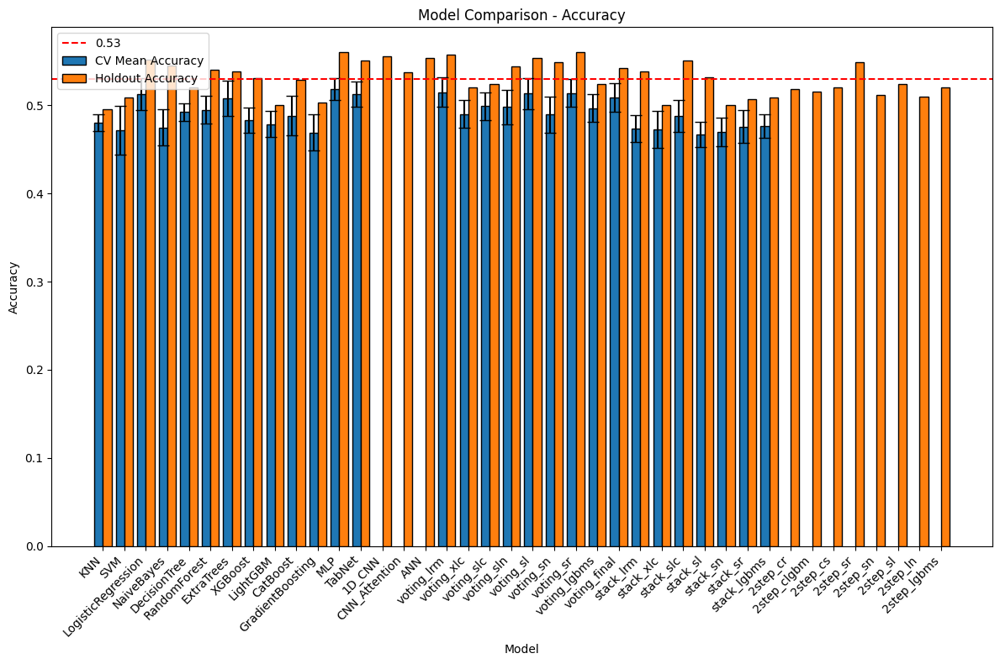

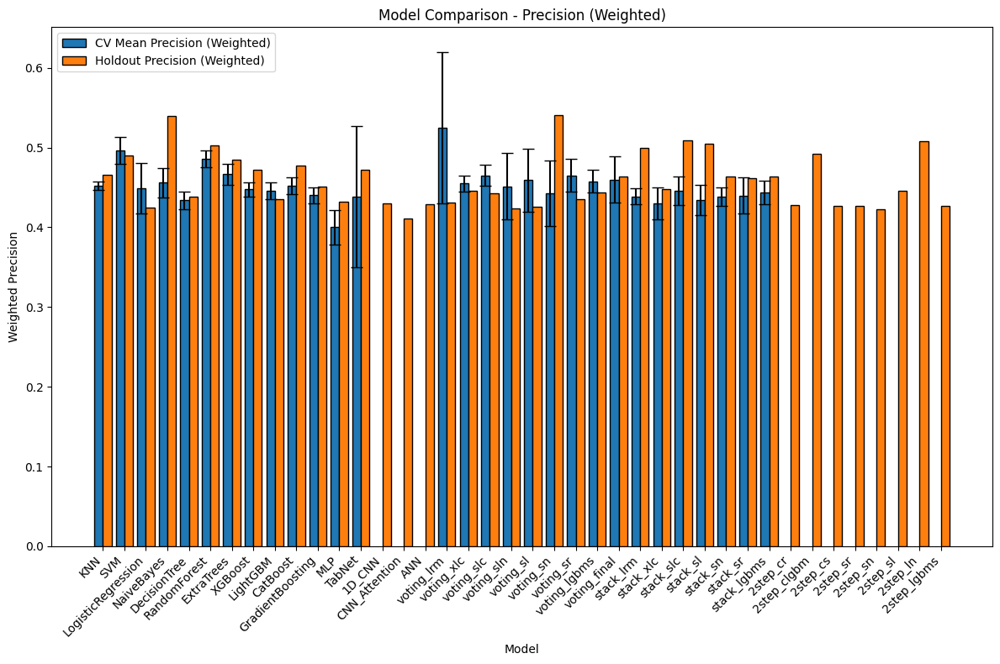

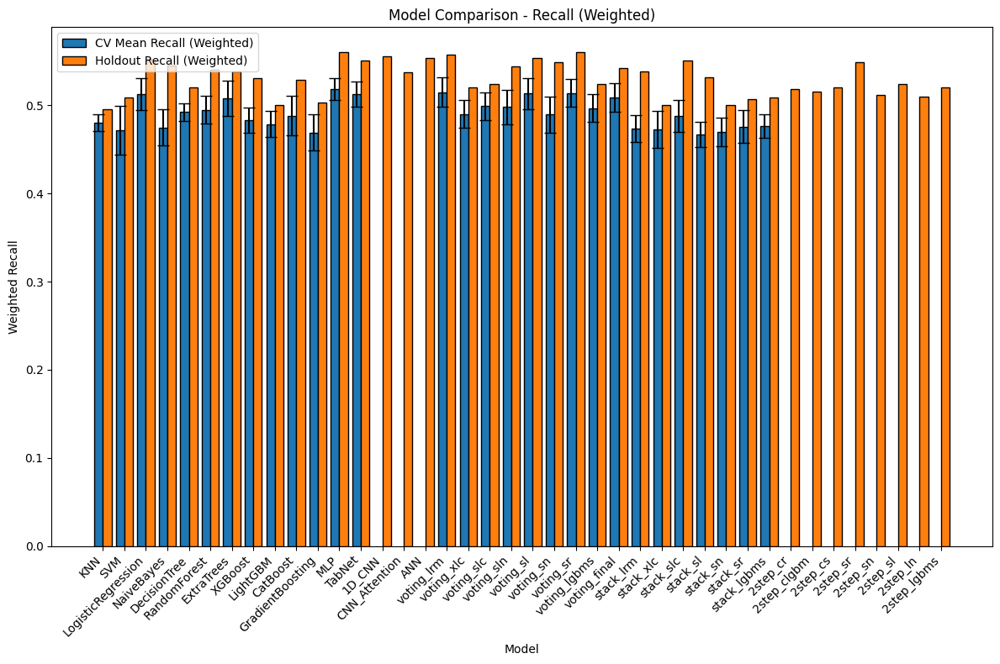

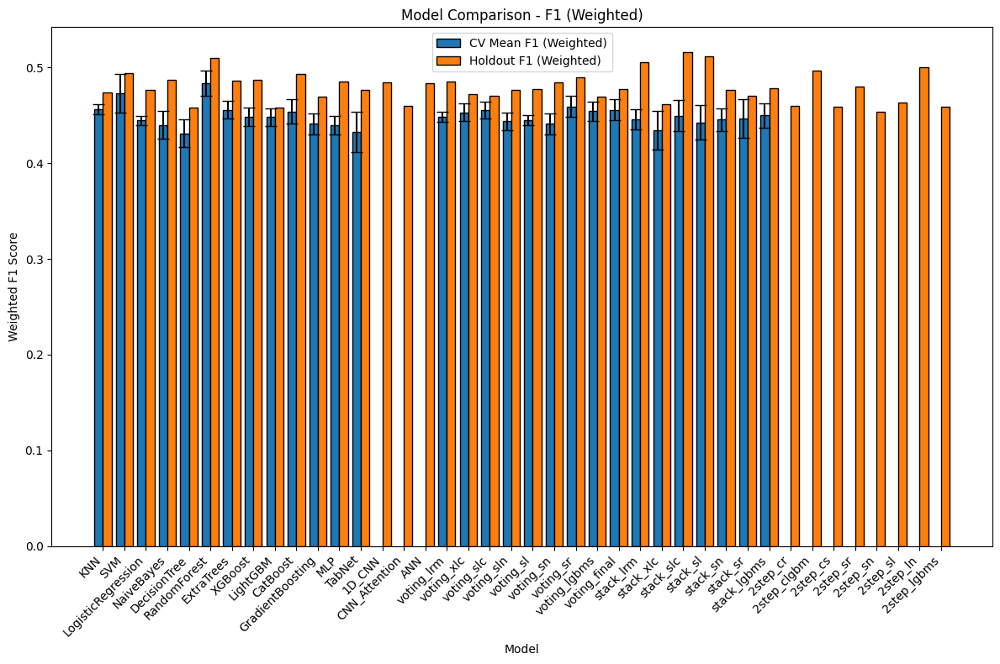

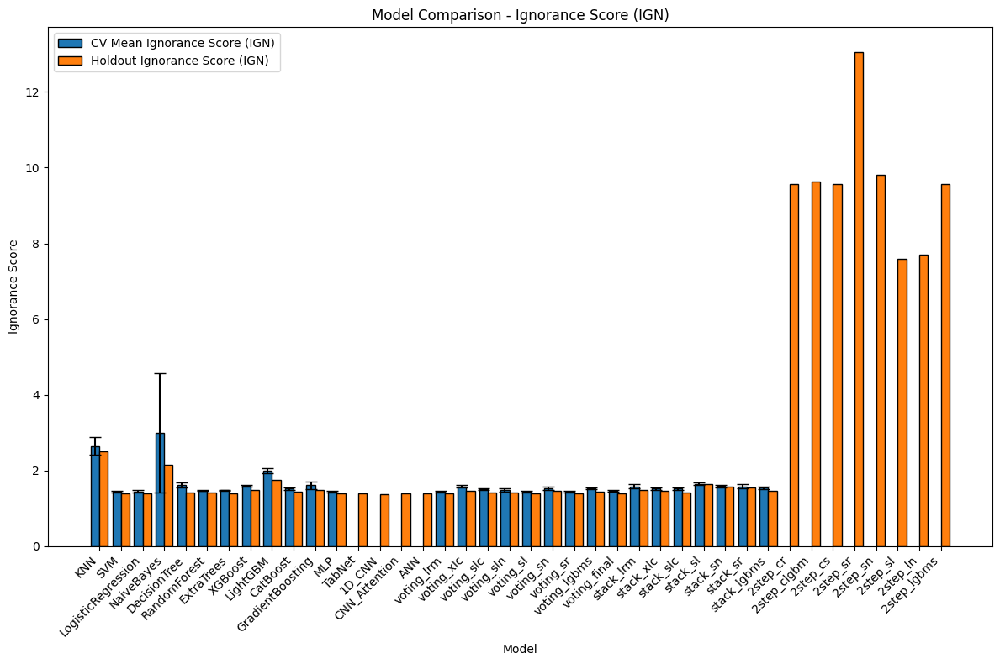

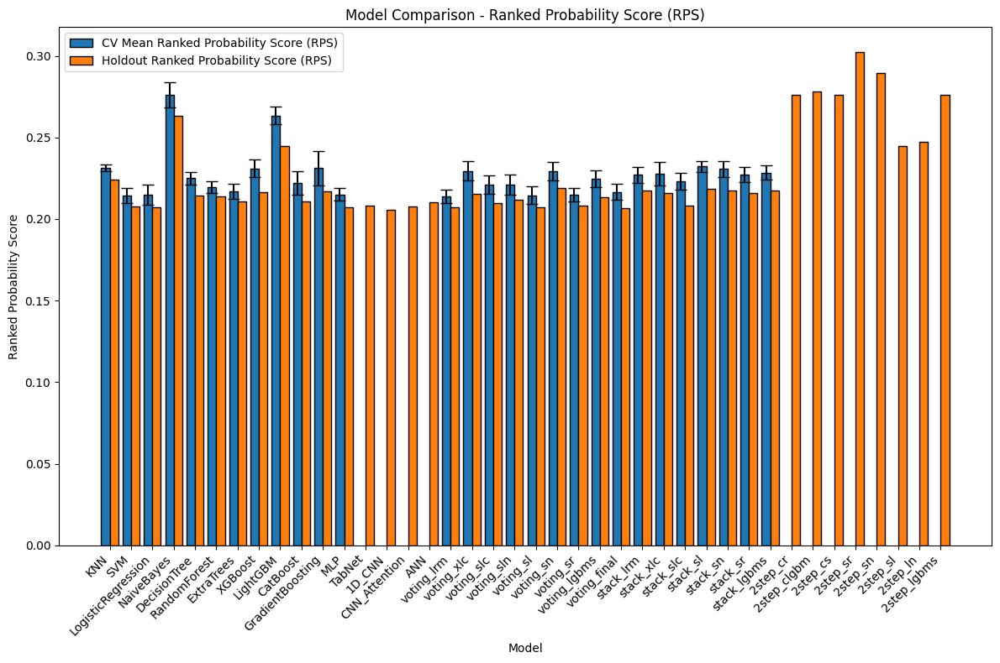

In [147]:
all_metrics_df = pd.concat([all_metrics_df, combined_metrics_df], ignore_index=True)
display(all_metrics_df.sort_values(by='Holdout_F1', ascending=False))
all_metrics_df.to_csv('all_model_metrics_summary.csv', index=False)

combined_metrics = [
    {
        'name': 'Accuracy',
        'cv_mean': all_metrics_df['CV_Mean_Accuracy'],
        'cv_std': all_metrics_df['CV_Std_Accuracy'],
        'holdout': all_metrics_df['Holdout_Accuracy'],
        'ylabel': 'Accuracy'
    },
    {
        'name': 'Precision (Weighted)',
        'cv_mean': all_metrics_df['CV_Mean_Precision'],
        'cv_std': all_metrics_df['CV_Std_Precision'],
        'holdout': all_metrics_df['Holdout_Precision'],
        'ylabel': 'Weighted Precision'
    },
    {
        'name': 'Recall (Weighted)',
        'cv_mean': all_metrics_df['CV_Mean_Recall'],
        'cv_std': all_metrics_df['CV_Std_Recall'],
        'holdout': all_metrics_df['Holdout_Recall'],
        'ylabel': 'Weighted Recall'
    },
    {
        'name': 'F1 (Weighted)',
        'cv_mean': all_metrics_df['CV_Mean_F1'],
        'cv_std': all_metrics_df['CV_Std_F1'],
        'holdout': all_metrics_df['Holdout_F1'],
        'ylabel': 'Weighted F1 Score'
    },
    {
        'name': 'Ignorance Score (IGN)',
        'cv_mean': all_metrics_df['CV_Mean_Ignorances'],
        'cv_std': all_metrics_df['CV_Std_Ignorances'],
        'holdout': all_metrics_df['Holdout_ignorances'],
        'ylabel': 'Ignorance Score'
    },
    {
        'name': 'Ranked Probability Score (RPS)',
        'cv_mean': all_metrics_df['CV_Mean_RPS'],
        'cv_std': all_metrics_df['CV_Std_RPS'],
        'holdout': all_metrics_df['Holdout_RPS'],
        'ylabel': 'Ranked Probability Score'
    }
]

model_names = all_metrics_df['Model']

for metric in combined_metrics:
    plt.figure(figsize=(12, 8))
    x = np.arange(len(model_names))

    plt.bar(x - 0.2, metric['cv_mean'], width=0.4, label='CV Mean '+metric['name'], 
            yerr=metric['cv_std'], capsize=5, edgecolor='black')
    plt.bar(x + 0.2, metric['holdout'], width=0.4, label='Holdout '+metric['name'], edgecolor='black')

    plt.xticks(x, model_names, rotation=45, ha='right')
    plt.xlabel('Model')
    plt.ylabel(metric['ylabel'])
    plt.title('Model Comparison - ' + metric['name'])

    if metric['name'] == "Accuracy":
        plt.axhline(y=0.53, color='red', linestyle='--', linewidth=1.5, label='0.53')

    plt.legend()
    plt.tight_layout()
    plt.show()

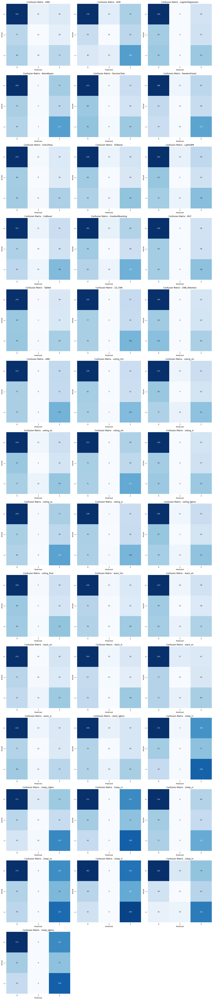

In [148]:
# Plot confusion matrix
all_holdout_cms = ml_holdout_cms + dl_holdout_cms + combined_holdout_cms
num_models = len(all_holdout_cms)
cols = 3
rows = (num_models + cols - 1) // cols
fig, axes = plt.subplots(rows, cols, figsize=(cols*6, rows*6))

if rows * cols > 1:
    axes = axes.flatten()
else:
    axes = [axes]

for i, (m_name, m_cm) in enumerate(all_holdout_cms ):
    ax = axes[i] 
    sns.heatmap(m_cm, annot=True, fmt='d', cmap='Blues', cbar=False, ax=ax)
    ax.set_title(f'Confusion Matrix - {m_name}')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')

for j in range(len(all_holdout_cms ), len(axes)):
    axes[j].remove()

plt.tight_layout()
plt.show()

## 5.5 Feature Importance Analysis

### 5.5.1 Load All the Trained Models

In [150]:
has_gpu = torch.cuda.is_available()
print("GPU Available:", has_gpu)
gpu_only_models = ['1D_CNN_GPU', 'CNN_GPU', 'ANN_GPU', 'CNN_Attention_GPU', 'TabNet_GPU']
cpu_only_models = ['1D_CNN', 'CNN', 'ANN', 'CNN_Attention', 'TabNet']

models_dict = {}

for file_name in os.listdir(model_dir):
    if file_name.endswith('.pkl'):
        model_name = os.path.splitext(file_name)[0]
        
        if has_gpu and model_name in cpu_only_models:
            print(f"Skipping CPU-only model: {model_name} (GPU available)")
            continue
        elif not has_gpu and model_name in gpu_only_models:
            print(f"Skipping GPU-only model: {model_name} (No GPU available)")
            continue

        file_path = os.path.join(model_dir, file_name)
        with open(file_path, 'rb') as file:
            models_dict[model_name] = pickle.load(file)

models_dict = {name: models_dict[name] for name in model_names if name in models_dict} # sort according to model type defined
print("Loaded models:", list(models_dict.keys()))

GPU Available: False
Loaded models: ['KNN', 'SVM', 'LogisticRegression', 'NaiveBayes', 'DecisionTree', 'RandomForest', 'ExtraTrees', 'XGBoost', 'LightGBM', 'CatBoost', 'GradientBoosting', 'voting_lrm', 'voting_xlc', 'voting_slc', 'voting_sln', 'voting_sl', 'voting_sn', 'voting_sr', 'voting_lgbms', 'voting_final', 'stack_lrm', 'stack_xlc', 'stack_slc', 'stack_sl', 'stack_sn', 'stack_sr', 'stack_lgbms', '2step_cr', '2step_clgbm', '2step_cs', '2step_sr', '2step_sn', '2step_sl', '2step_ln', '2step_lgbms']


### 5.5.2 Importance Visualizations

Evaluating importance for Models:  77%|█████████████████████████████████████           | 27/35 [31:44<09:24, 70.55s/it]


AttributeError: 'TwoStepClassifier' object has no attribute 'classes_'

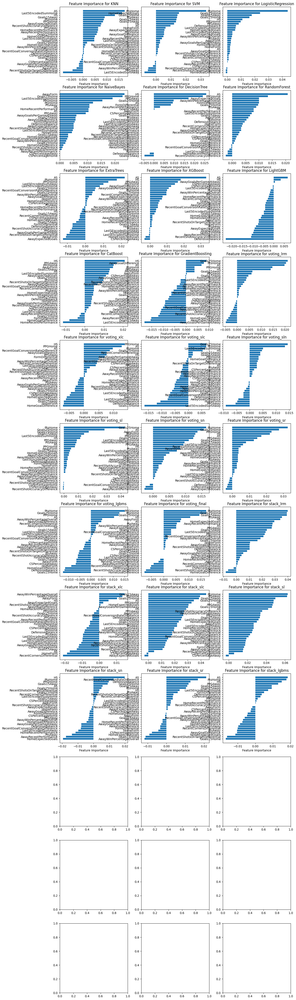

In [152]:
def plot_model_importance(models, X_val, y_val):
    """
    Plots the feature importance for a given set of models using permutation importance.

    This function evaluates the importance of each feature for multiple models based on their 
    predictive accuracy. It generates bar plots showing the relative importance of features 
    for each model.

    Parameters:
        models (dict): A dictionary of models to evaluate, where keys are model names and 
                       values are the model instances.
        X_val (array-like or DataFrame): Validation data containing the features.
        y_val (array-like): Validation target values.
    """

    n_models = len(models)
    n_cols = 3 
    n_rows = (n_models + 1) // n_cols 
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(14, 5 * n_rows))
    axes = axes.ravel() 

    for i, (model_name, model) in enumerate(tqdm(models.items(), desc="Evaluating importance for Models")):
        
        result = permutation_importance(model, X_val, y_val, scoring='accuracy')
        feature_names = X_val.columns if hasattr(X_val, 'columns') else [f"Feature {j}" for j in range(X_val.shape[1])]
        importance = result.importances_mean
        
        sorted_idx = np.argsort(importance)[::-1]
        
        axes[i].barh(np.array(feature_names)[sorted_idx], importance[sorted_idx])
        axes[i].set_title(f'Feature Importance for {model_name}')
        axes[i].set_xlabel('Feature Importance')
        axes[i].invert_yaxis()

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

plot_model_importance(models_dict, X_val, y_val)

Evaluating least important features: 100%|██████████| 40/40 [15:30<00:00, 23.27s/it]


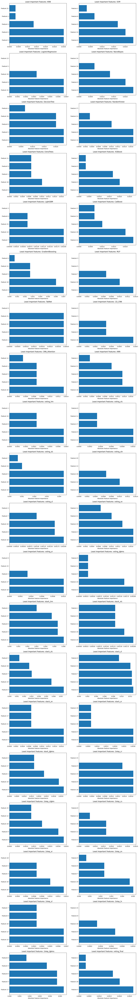

Unique least important features across models:
{'Feature 22', 'Feature 13', 'Feature 4', 'Feature 19', 'Feature 14', 'Feature 1', 'Feature 9', 'Feature 3', 'Feature 8', 'Feature 21', 'Feature 10', 'Feature 11', 'Feature 18', 'Feature 12', 'Feature 17', 'Feature 16', 'Feature 5', 'Feature 0', 'Feature 20', 'Feature 7', 'Feature 15', 'Feature 2', 'Feature 6'}


In [99]:
def get_least_important_features(models, X_val, y_val, n_least=5):
    """
    Analyze and visualize the least important features for each model.
    
    Parameters:
    - models: dict, {model_name: model}
    - X_val: validation data features
    - y_val: validation data target
    - n_least: number of least important features to extract per model
    
    Returns:
    - feature_set: set, unique least important features across models
    """
    feature_set = set()  
    n_models = len(models)
    n_cols = 2
    n_rows = (n_models + n_cols - 1) // n_cols

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(14, 5 * n_rows))
    axes = axes.ravel()

    for i, (model_name, model) in enumerate(tqdm(models.items(), desc="Evaluating least important features")):
        # 计算 permutation importance
        result = permutation_importance(model, X_val, y_val, scoring='accuracy')
        feature_names = X_val.columns if hasattr(X_val, 'columns') else [f"Feature {j}" for j in range(X_val.shape[1])]
        importance = result.importances_mean

        sorted_idx = np.argsort(np.abs(importance))[:n_least]
        least_features = np.array(feature_names)[sorted_idx]
        feature_set.update(least_features)

        axes[i].barh(least_features, np.abs(importance[sorted_idx]))
        axes[i].set_title(f'Least Important Features: {model_name}')
        axes[i].set_xlabel('Absolute Feature Importance')
        axes[i].invert_yaxis()

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()
    
    return feature_set

# Call the function and print the least important features across models
least_important_features = get_least_important_features(models_dict, X_val, y_val)
print("Unique least important features across models:")
print(least_important_features)

# 6. Results

In [153]:
final_decision_models = ["voting_final"]

# 7. Final Predictions on Test Set

## 7.1 Clean the Test Data

In [154]:
corrected_team_names = {
    "AFC Bournemouth": "Bournemouth",
    "Spurs": "Tottenham",
    "Leicester City": "Leicester",
    "Ipswich Town": "Ipswich",
    "Man Utd": "Man United",
    "Nottingham Forest": "Nott'm Forest"
}
test_data['HomeTeam'] = test_data['HomeTeam'].replace(corrected_team_names)
test_data['AwayTeam'] = test_data['AwayTeam'].replace(corrected_team_names)
test_data["Date"] = pd.to_datetime(test_data["Date"], dayfirst=True)
test_data['Year'] = test_data['Date'].dt.year
test_data

,Date,HomeTeam,AwayTeam,Year
0,2025-02-01,Bournemouth,Liverpool,2025
1,2025-02-01,Arsenal,Man City,2025
2,2025-02-01,Brentford,Tottenham,2025
3,2025-02-01,Chelsea,West Ham,2025
4,2025-02-01,Everton,Leicester,2025
5,2025-02-01,Ipswich,Southampton,2025
6,2025-02-01,Man United,Crystal Palace,2025
7,2025-02-01,Newcastle,Fulham,2025
8,2025-02-01,Nott'm Forest,Brighton,2025
9,2025-02-01,Wolves,Aston Villa,2025


In [155]:
training_data = pd.read_csv(os.path.join(data_dir, "epl-training.csv"))
training_data = training_data.dropna()
training_data["Date"] = pd.to_datetime(training_data["Date"], format='mixed', dayfirst=True)
training_data = training_data.sort_values(by='Date').reset_index(drop=True)
training_data = training_data.drop_duplicates(subset=['Date', 'HomeTeam', 'AwayTeam'])
training_data = training_data.drop_duplicates(subset=['Date', 'HomeTeam'])
training_data = training_data.drop_duplicates(subset=['Date', 'AwayTeam'])
print(training_data.duplicated(subset=['Date', 'HomeTeam']).sum())  # Should be 0
print(training_data.duplicated(subset=['Date', 'AwayTeam']).sum())  # Should be 0
ftr_mapping = {'H': 0, 'D': 1, 'A': 2}
training_data['FTREncoded'] = training_data['FTR'].map(ftr_mapping)
training_data['Year'] = training_data['Date'].dt.year
training_data

0
0


,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,Referee,...,HC,AC,HF,AF,HY,AY,HR,AR,FTREncoded,Year
0,2000-08-19,Charlton,Man City,4.0,0.0,H,2.0,0.0,H,Rob Harris,...,6.0,6.0,13.0,12.0,1.0,2.0,0.0,0.0,0,2000
1,2000-08-19,Chelsea,West Ham,4.0,2.0,H,1.0,0.0,H,Graham Barber,...,7.0,7.0,19.0,14.0,1.0,2.0,0.0,0.0,0,2000
2,2000-08-19,Coventry,Middlesbrough,1.0,3.0,A,1.0,1.0,D,Barry Knight,...,8.0,4.0,15.0,21.0,5.0,3.0,1.0,0.0,2,2000
3,2000-08-19,Derby,Southampton,2.0,2.0,D,1.0,2.0,A,Andy D'Urso,...,5.0,8.0,11.0,13.0,1.0,1.0,0.0,0.0,1,2000
4,2000-08-19,Leeds,Everton,2.0,0.0,H,2.0,0.0,H,Dermot Gallagher,...,6.0,4.0,21.0,20.0,1.0,3.0,0.0,0.0,0,2000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9215,2024-05-19,Brighton,Man United,0.0,2.0,A,0.0,0.0,D,C Pawson,...,10.0,9.0,7.0,5.0,1.0,3.0,0.0,0.0,2,2024
9216,2024-05-19,Brentford,Newcastle,2.0,4.0,A,0.0,3.0,A,S Hooper,...,15.0,11.0,3.0,0.0,4.0,4.0,0.0,0.0,2,2024
9217,2024-05-19,Arsenal,Everton,2.0,1.0,H,1.0,1.0,D,M Oliver,...,8.0,11.0,8.0,1.0,4.0,3.0,0.0,0.0,0,2024
9218,2024-05-19,Burnley,Nott'm Forest,1.0,2.0,A,0.0,2.0,A,G Scott,...,11.0,5.0,4.0,3.0,1.0,0.0,0.0,0.0,2,2024


## 7.2 Compute Test Features

In [156]:
def calculate_historical_features_test(df, history_df):
    # Ensure Date is in datetime format and sort the dataframe
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.sort_values(by='Date').reset_index(drop=True)

    # Initialize features in the dataframe
    features = ['HomeGoalsPerGame', 'HomeGoalsConcededPerGame', 'HomeWinPercentage',
                'AwayWinPercentage', 'AwayWinPercentageAtAwayVsHome', 'HomeWinPercentageAtHomeVsAway',
                'AwayGoalsPerGameAtAway', 'AwayWinPercentageOverall', 'HomeWinPercentageOverall']
    for feature in features:
        df[feature] = 0.0

    # Iterate through each row to compute historical features
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Historical data only
        historical_data = history_df[history_df['Date'] < current_date]

        # Historical data for the home team
        home_hist = historical_data[(historical_data['HomeTeam'] == home_team) | 
                                    (historical_data['AwayTeam'] == home_team)]

        # Compute Home Team Features
        if not home_hist.empty:
            home_games_at_home = home_hist[home_hist['HomeTeam'] == home_team]
            home_games_as_away = home_hist[home_hist['AwayTeam'] == home_team]

            goals_scored_at_home = home_games_at_home['FTHG'].sum()
            matches_played_at_home = len(home_games_at_home)
            goals_conceded_at_home = home_games_at_home['FTAG'].sum()

            total_home_wins = home_games_at_home[home_games_at_home['FTR'] == 'H'].shape[0]
            total_matches_home_team = len(home_hist)

            df.at[idx, 'HomeGoalsPerGame'] = goals_scored_at_home / matches_played_at_home if matches_played_at_home > 0 else 0
            df.at[idx, 'HomeGoalsConcededPerGame'] = goals_conceded_at_home / matches_played_at_home if matches_played_at_home > 0 else 0
            df.at[idx, 'HomeWinPercentage'] = total_home_wins / matches_played_at_home if matches_played_at_home > 0 else 0
            df.at[idx, 'HomeWinPercentageOverall'] = total_home_wins / total_matches_home_team if total_matches_home_team > 0 else 0

        # Historical data for the away team
        away_hist = historical_data[(historical_data['HomeTeam'] == away_team) | 
                                    (historical_data['AwayTeam'] == away_team)]

        # Compute Away Team Features
        if not away_hist.empty:
            away_games_as_away = away_hist[away_hist['AwayTeam'] == away_team]
            away_games_at_home = away_hist[away_hist['HomeTeam'] == away_team]

            goals_scored_at_away = away_games_as_away['FTAG'].sum()
            matches_played_at_away = len(away_games_as_away)

            total_away_wins = away_games_as_away[away_games_as_away['FTR'] == 'A'].shape[0]
            total_matches_away_team = len(away_hist)

            df.at[idx, 'AwayGoalsPerGameAtAway'] = goals_scored_at_away / matches_played_at_away if matches_played_at_away > 0 else 0
            df.at[idx, 'AwayWinPercentage'] = total_away_wins / matches_played_at_away if matches_played_at_away > 0 else 0
            df.at[idx, 'AwayWinPercentageOverall'] = total_away_wins / total_matches_away_team if total_matches_away_team > 0 else 0

        # Compute Comparative Features (Home vs Away)
        home_win_percentage_at_home = df.at[idx, 'HomeWinPercentage'] if not pd.isna(df.at[idx, 'HomeWinPercentage']) else 0
        away_win_percentage_at_away = df.at[idx, 'AwayWinPercentage'] if not pd.isna(df.at[idx, 'AwayWinPercentage']) else 0

        df.at[idx, 'AwayWinPercentageAtAwayVsHome'] = away_win_percentage_at_away - home_win_percentage_at_home
        df.at[idx, 'HomeWinPercentageAtHomeVsAway'] = home_win_percentage_at_home - away_win_percentage_at_away

    return df

test_data = calculate_historical_features_test(test_data, training_data)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,HomeWinPercentageOverall
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,1.614035,0.232456,0.176692
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,1.629291,0.229977,0.339912
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,1.390351,0.176535,0.192982
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,1.085213,0.122807,0.319079
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,1.328947,0.140351,0.242325
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,1.039474,0.121711,0.223684
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,1.114035,0.133772,0.344298
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,0.925697,0.082043,0.230861
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,1.097744,0.124060,0.171053
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,1.140351,0.134085,0.189474


In [157]:
def calculate_h2h_features_test(df, history_df):
    # Initialize columns for the new features
    df['H2HAwayWin'] = 0
    df['H2HHomeWin'] = 0
    df['H2HDraw'] = 0
    df['H2HFTRMode'] = 1
    df['H2HCornerDominance'] = 0.0

    # Iterate through each row to calculate features
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Filter historical matches between the two teams
        h2h_matches = history_df[(history_df['Date'] < current_date) & (
            ((history_df['HomeTeam'] == home_team) & (history_df['AwayTeam'] == away_team)) |
            ((history_df['HomeTeam'] == away_team) & (history_df['AwayTeam'] == home_team))
        )]

        if not h2h_matches.empty:
            # Head-to-Head Away Win
            away_wins = h2h_matches[
                ((h2h_matches['HomeTeam'] == away_team) & (h2h_matches['FTR'] == 'H')) |
                ((h2h_matches['AwayTeam'] == away_team) & (h2h_matches['FTR'] == 'A'))
            ].shape[0]

            # Head-to-Head Home Win
            home_wins = h2h_matches[
                ((h2h_matches['HomeTeam'] == home_team) & (h2h_matches['FTR'] == 'H')) |
                ((h2h_matches['AwayTeam'] == home_team) & (h2h_matches['FTR'] == 'A'))
            ].shape[0]

            # Head-to-Head Draw
            draws = h2h_matches[h2h_matches['FTR'] == 'D'].shape[0]

            # Head-to-Head FTR Mode
            ftr_mode = h2h_matches['FTREncoded'].mode().iloc[0] if not h2h_matches['FTREncoded'].mode().empty else 1

            # Head-to-Head Corner Dominance
            total_corners_home = h2h_matches.loc[h2h_matches['HomeTeam'] == home_team, 'HC'].sum() + \
                                 h2h_matches.loc[h2h_matches['AwayTeam'] == home_team, 'AC'].sum()
            total_corners_away = h2h_matches.loc[h2h_matches['HomeTeam'] == away_team, 'HC'].sum() + \
                                 h2h_matches.loc[h2h_matches['AwayTeam'] == away_team, 'AC'].sum()

            corner_dominance = total_corners_home / (total_corners_home + total_corners_away) if (total_corners_home + total_corners_away) > 0 else np.nan

            # Assign values to the dataframe
            df.at[idx, 'H2HAwayWin'] = away_wins
            df.at[idx, 'H2HHomeWin'] = home_wins
            df.at[idx, 'H2HDraw'] = draws
            df.at[idx, 'H2HFTRMode'] = ftr_mode
            df.at[idx, 'H2HCornerDominance'] = corner_dominance

    return df

test_data = calculate_h2h_features_test(test_data, training_data)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,HomeWinPercentageOverall,H2HAwayWin,H2HHomeWin,H2HDraw,H2HFTRMode,H2HCornerDominance
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,1.614035,0.232456,0.176692,11,2,1,0,0.363057
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,1.629291,0.229977,0.339912,19,18,9,0,0.481928
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,1.390351,0.176535,0.192982,2,1,3,1,0.472727
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,1.085213,0.122807,0.319079,10,25,7,0,0.563441
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,1.328947,0.140351,0.242325,6,9,9,1,0.531835
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,1.039474,0.121711,0.223684,1,2,1,2,0.631579
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,1.114035,0.133772,0.344298,5,14,5,0,0.634409
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,0.925697,0.082043,0.230861,12,15,5,0,0.592208
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,1.097744,0.124060,0.171053,2,1,1,0,0.439394
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,1.140351,0.134085,0.189474,6,6,6,2,0.491525


In [158]:
def calculate_league_points_test(df, team_col, year_col, ftr_col):
    # Assign points based on FTR (Win = 3, Draw = 1, Loss = 0)
    df['Points'] = df[ftr_col].map({'H': 3, 'D': 1, 'A': 0})
    
    # Group by team and year to calculate total points
    league_points = df.groupby([team_col, year_col])['Points'].sum().reset_index()
    league_points.rename(columns={'Points': 'TotalPoints', team_col: 'Team'}, inplace=True)
    
    return league_points

# Calculate league points for home and away teams separately
home_points = calculate_league_points_test(
    training_data[['HomeTeam', 'Year', 'FTR']].rename(columns={'HomeTeam': 'Team'}),
    team_col='Team', year_col='Year', ftr_col='FTR'
)

away_points = calculate_league_points_test(
    training_data[['AwayTeam', 'Year', 'FTR']].rename(columns={'AwayTeam': 'Team', 'FTR': 'FTR_Away'}),
    team_col='Team', year_col='Year', ftr_col='FTR_Away'
)

# Combine home and away points to get total league points per team per year
league_points = pd.concat([home_points, away_points])
league_points = league_points.groupby(['Team', 'Year'])['TotalPoints'].sum().reset_index()

def get_last_season_points_test(row, league_points, team_col):
    team = row[team_col]
    year = row['Year']
    previous_season_points = league_points[(league_points['Team'] == team) & (league_points['Year'] == year - 1)]
    
    if not previous_season_points.empty:
        return previous_season_points['TotalPoints'].values[0]
    return 1  # Default to 1 (Draw) if no data is available

# Add features for last season league points
test_data['AwayTeamLastSeasonPoints'] = test_data.apply(lambda row: get_last_season_points_test(row, league_points, 'AwayTeam'), axis=1)
test_data['HomeTeamLastSeasonPoints'] = test_data.apply(lambda row: get_last_season_points_test(row, league_points, 'HomeTeam'), axis=1)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,HomeWinPercentageOverall,H2HAwayWin,H2HHomeWin,H2HDraw,H2HFTRMode,H2HCornerDominance,AwayTeamLastSeasonPoints,HomeTeamLastSeasonPoints
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,1.614035,0.232456,0.176692,11,2,1,0,0.363057,34,32
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,1.629291,0.229977,0.339912,19,18,9,0,0.481928,27,25
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,1.390351,0.176535,0.192982,2,1,3,1,0.472727,33,29
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,1.085213,0.122807,0.319079,10,25,7,0,0.563441,31,32
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,1.328947,0.140351,0.242325,6,9,9,1,0.531835,1,37
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,1.039474,0.121711,0.223684,1,2,1,2,0.631579,1,1
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,1.114035,0.133772,0.344298,5,14,5,0,0.634409,34,26
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,0.925697,0.082043,0.230861,12,15,5,0,0.592208,23,31
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,1.097744,0.124060,0.171053,2,1,1,0,0.439394,30,25
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,1.140351,0.134085,0.189474,6,6,6,2,0.491525,23,24


In [159]:
def calculate_streak_features_test(df, history_df, k=5):
    # Initialize columns
    df['HomeStreak'] = 0.0
    df['HomeWeightedStreak'] = 0.0
    df['HomeLast2WinStreak'] = 0.0
    df['AwayStreak'] = 0.0
    df['AwayWeightedStreak'] = 0.0
    df['AwayLast2WinStreak'] = 0.0

    # Expand dataset for team-level calculation
    expanded_data = pd.concat([
        history_df[['Date', 'HomeTeam', 'FTR']].rename(columns={'HomeTeam': 'Team'}),
        history_df[['Date', 'AwayTeam', 'FTR']].rename(columns={'AwayTeam': 'Team'})
    ]).sort_values('Date').reset_index(drop=True)

    # Reverse FTR for away team
    expanded_data['ReversedFTR'] = expanded_data.apply(
        lambda row: 'H' if row['FTR'] == 'A' else ('A' if row['FTR'] == 'H' else 'D'), axis=1
    )
    expanded_data['Result'] = np.where(expanded_data['FTR'] == 'A', expanded_data['ReversedFTR'], expanded_data['FTR'])

    # Map results to scores
    expanded_data['ResultScore'] = expanded_data['Result'].map({'H': 3, 'D': 1, 'A': 0})

    # Group by team for streak calculations
    grouped = expanded_data.groupby('Team')

    # Create a dictionary for faster lookup
    streak_dict = {}
    for team, matches in grouped:
        matches = matches.sort_values('Date').reset_index(drop=True)
        streaks = []
        weighted_streaks = []
        last_2_streaks = []

        for idx in range(len(matches)):
            if idx == 0:
                streaks.append(0.0)
                weighted_streaks.append(0.0)
                last_2_streaks.append(0.0)
            else:
                # Filter historical data strictly before the current date
                recent_matches = matches.loc[max(0, idx - k):idx - 1]

                # Calculate streak
                recent_scores = recent_matches['ResultScore']
                streak = recent_scores.sum() / (3 * k)

                # Calculate weighted streak
                weights = 2 * (np.arange(1, len(recent_scores) + 1)) / (3 * k * (k + 1))
                weighted_streak = (recent_scores * weights).sum()

                # Calculate last 2 matches win streak
                last_2_matches = recent_scores.tail(2)
                last_2_win_streak = (last_2_matches == 3).sum()

                streaks.append(streak)
                weighted_streaks.append(weighted_streak)
                last_2_streaks.append(last_2_win_streak)

        matches['Streak'] = streaks
        matches['WeightedStreak'] = weighted_streaks
        matches['Last2MatchesWinStreak'] = last_2_streaks
        streak_dict[team] = matches[['Date', 'Streak', 'WeightedStreak', 'Last2MatchesWinStreak']]

    # Assign streak features to the main dataframe
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Home team streak features
        if home_team in streak_dict:
            home_streaks = streak_dict[home_team]
            home_past = home_streaks[home_streaks['Date'] < current_date]
            if not home_past.empty:
                df.at[idx, 'HomeStreak'] = home_past['Streak'].iloc[-1]
                df.at[idx, 'HomeWeightedStreak'] = home_past['WeightedStreak'].iloc[-1]
                df.at[idx, 'HomeLast2WinStreak'] = home_past['Last2MatchesWinStreak'].iloc[-1]

        # Away team streak features
        if away_team in streak_dict:
            away_streaks = streak_dict[away_team]
            away_past = away_streaks[away_streaks['Date'] < current_date]
            if not away_past.empty:
                df.at[idx, 'AwayStreak'] = away_past['Streak'].iloc[-1]
                df.at[idx, 'AwayWeightedStreak'] = away_past['WeightedStreak'].iloc[-1]
                df.at[idx, 'AwayLast2WinStreak'] = away_past['Last2MatchesWinStreak'].iloc[-1]

    return df

# Calculate streak features
test_data = calculate_streak_features_test(test_data, training_data, k=20)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,...,H2HFTRMode,H2HCornerDominance,AwayTeamLastSeasonPoints,HomeTeamLastSeasonPoints,HomeStreak,HomeWeightedStreak,HomeLast2WinStreak,AwayStreak,AwayWeightedStreak,AwayLast2WinStreak
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,...,0,0.363057,34,32,0.833333,0.869841,2.0,0.833333,0.796825,1.0
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,...,0,0.481928,27,25,0.933333,0.958730,2.0,0.900000,0.904762,2.0
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,...,1,0.472727,33,29,0.833333,0.774603,1.0,0.900000,0.926984,2.0
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,...,0,0.563441,31,32,0.833333,0.819048,2.0,0.766667,0.787302,2.0
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,...,1,0.531835,1,37,0.766667,0.796825,1.0,0.833333,0.790476,1.0
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,...,2,0.631579,1,1,0.900000,0.863492,2.0,0.900000,0.888889,2.0
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,...,0,0.634409,34,26,0.833333,0.803175,2.0,0.833333,0.841270,2.0
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,...,0,0.592208,23,31,0.866667,0.853968,1.0,0.833333,0.806349,1.0
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,...,0,0.439394,30,25,0.866667,0.850794,2.0,0.766667,0.796825,1.0
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,...,2,0.491525,23,24,0.900000,0.898413,2.0,0.800000,0.777778,1.0


In [160]:
def calculate_recent_performance_features_test(df, history_df, k=5):
    # Initialize columns for recent performance features
    df['HomeRecentPerformance'] = 0.0
    df['AwayRecentPerformance'] = 0.0
    df['RecentGoalDifference'] = 0.0
    df['RecentCornersDifferential'] = 0.0
    df['RecentShotsOnTargetDifferential'] = 0.0
    df['RecentShotAccuracyDifference'] = 0.0
    df['RecentGoalConversionRateDifference'] = 0.0

    def compute_recent_features(row):
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Filter historical data
        historical_data = history_df[history_df['Date'] < current_date]

        # Historical data for home team
        home_hist = historical_data[
            (historical_data['HomeTeam'] == home_team) |
            (historical_data['AwayTeam'] == home_team)
        ].sort_values('Date', ascending=False).head(k)

        # Historical data for away team
        away_hist = historical_data[
            (historical_data['HomeTeam'] == away_team) |
            (historical_data['AwayTeam'] == away_team)
        ].sort_values('Date', ascending=False).head(k)

        # Compute home team metrics
        home_corners = home_hist['HC'][(home_hist['HomeTeam'] == home_team)].sum() + \
                       home_hist['AC'][(home_hist['AwayTeam'] == home_team)].sum()

        home_shots_on_target = home_hist['HST'][(home_hist['HomeTeam'] == home_team)].sum() + \
                               home_hist['AST'][(home_hist['AwayTeam'] == home_team)].sum()

        home_goals = home_hist['FTHG'][(home_hist['HomeTeam'] == home_team)].sum() + \
                     home_hist['FTAG'][(home_hist['AwayTeam'] == home_team)].sum()

        home_total_shots = home_hist['HS'][(home_hist['HomeTeam'] == home_team)].sum() + \
                           home_hist['AS'][(home_hist['AwayTeam'] == home_team)].sum()

        # Compute away team metrics
        away_corners = away_hist['HC'][(away_hist['HomeTeam'] == away_team)].sum() + \
                       away_hist['AC'][(away_hist['AwayTeam'] == away_team)].sum()

        away_shots_on_target = away_hist['HST'][(away_hist['HomeTeam'] == away_team)].sum() + \
                               away_hist['AST'][(away_hist['AwayTeam'] == away_team)].sum()

        away_goals = away_hist['FTHG'][(away_hist['HomeTeam'] == away_team)].sum() + \
                     away_hist['FTAG'][(away_hist['AwayTeam'] == away_team)].sum()

        away_total_shots = away_hist['HS'][(away_hist['HomeTeam'] == away_team)].sum() + \
                           away_hist['AS'][(away_hist['AwayTeam'] == away_team)].sum()

        # Calculate performance metrics
        recent_performance_home = (home_goals + home_corners + home_shots_on_target) / k
        recent_performance_away = (away_goals + away_corners + away_shots_on_target) / k

        goal_difference = (home_goals - away_goals) / k
        corners_differential = (home_corners - away_corners) / k
        shots_on_target_differential = (home_shots_on_target - away_shots_on_target) / k

        # Calculate shot accuracy and goal conversion rates
        home_shot_accuracy = home_shots_on_target / home_total_shots if home_total_shots > 0 else 0
        away_shot_accuracy = away_shots_on_target / away_total_shots if away_total_shots > 0 else 0
        shot_accuracy_difference = home_shot_accuracy - away_shot_accuracy

        home_goal_conversion_rate = home_goals / home_shots_on_target if home_shots_on_target > 0 else 0
        away_goal_conversion_rate = away_goals / away_shots_on_target if away_shots_on_target > 0 else 0
        goal_conversion_rate_difference = home_goal_conversion_rate - away_goal_conversion_rate

        return {
            'HomeRecentPerformance': recent_performance_home,
            'AwayRecentPerformance': recent_performance_away,
            'RecentGoalDifference': goal_difference,
            'RecentCornersDifferential': corners_differential,
            'RecentShotsOnTargetDifferential': shots_on_target_differential,
            'RecentShotAccuracyDifference': shot_accuracy_difference,
            'RecentGoalConversionRateDifference': goal_conversion_rate_difference
        }

    # Apply the computation to each row
    performance_features = df.apply(compute_recent_features, axis=1)

    # Update the DataFrame with the new features
    for key in performance_features.iloc[0].keys():
        df[key] = performance_features.apply(lambda x: x[key])

    return df

test_data = calculate_recent_performance_features_test(test_data, training_data, k=10)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,...,AwayStreak,AwayWeightedStreak,AwayLast2WinStreak,HomeRecentPerformance,AwayRecentPerformance,RecentGoalDifference,RecentCornersDifferential,RecentShotsOnTargetDifferential,RecentShotAccuracyDifference,RecentGoalConversionRateDifference
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,...,0.833333,0.796825,1.0,19.4,23.0,-0.8,1.3,-4.1,-0.029873,0.044703
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,...,0.900000,0.904762,2.0,20.3,17.3,-1.2,6.6,-2.4,-0.119221,-0.040370
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,...,0.900000,0.926984,2.0,16.5,18.7,0.1,-1.8,-0.5,0.042417,0.053708
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,...,0.766667,0.787302,2.0,19.1,15.2,1.3,0.3,2.3,0.046175,0.073626
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,...,0.833333,0.790476,1.0,16.1,9.5,-0.1,8.1,-1.4,-0.112281,0.078014
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,...,0.900000,0.888889,2.0,9.4,8.5,-0.7,1.3,0.3,-0.001665,-0.207265
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,...,0.833333,0.841270,2.0,17.8,19.5,-0.6,-1.3,0.2,-0.050193,-0.123016
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,...,0.833333,0.806349,1.0,19.7,17.0,1.1,0.0,1.6,0.028128,0.093942
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,...,0.766667,0.796825,1.0,17.2,15.7,1.0,-0.4,0.9,0.058588,0.181122
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,...,0.800000,0.777778,1.0,18.2,15.9,-0.9,2.7,0.5,0.077204,-0.294872


In [161]:
def calculate_defensive_and_aggression_features_test(df, history_df):
    # Initialize new columns
    df['HomeDefensiveStrength'] = 0.0
    df['AwayDefensiveStrength'] = 0.0
    df['HomeAggressionIndex'] = 0.0
    df['AwayAggressionIndex'] = 0.0
    df['DefensiveBalance'] = 0.0

    def compute_features(row):
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Filter historical data
        historical_data = history_df[history_df['Date'] < current_date]

        # Historical data for the home team
        home_hist = historical_data[
            (historical_data['HomeTeam'] == home_team) |
            (historical_data['AwayTeam'] == home_team)
        ]

        # Historical data for the away team
        away_hist = historical_data[
            (historical_data['HomeTeam'] == away_team) |
            (historical_data['AwayTeam'] == away_team)
        ]

        # Defensive Strength
        home_defensive_strength = home_hist['FTAG'][(home_hist['HomeTeam'] == home_team)].sum() / \
                                  max(1, len(home_hist[home_hist['HomeTeam'] == home_team]))
        away_defensive_strength = home_hist['FTHG'][(home_hist['AwayTeam'] == home_team)].sum() / \
                                  max(1, len(away_hist[away_hist['AwayTeam'] == away_team]))

        # Aggression Index
        normalized_aggression = historical_data[['HF', 'HY', 'HR']].mean().sum()
        home_aggression = (home_hist['HF'][(home_hist['HomeTeam'] == home_team)].sum() +
                           2 * home_hist['HY'][(home_hist['HomeTeam'] == home_team)].sum() +
                           4 * home_hist['HR'][(home_hist['HomeTeam'] == home_team)].sum()) / \
                          max(1, len(home_hist[home_hist['HomeTeam'] == home_team]) * normalized_aggression)

        away_aggression = (away_hist['AF'][(away_hist['AwayTeam'] == away_team)].sum() +
                           2 * away_hist['AY'][(away_hist['AwayTeam'] == away_team)].sum() +
                           4 * away_hist['AR'][(away_hist['AwayTeam'] == away_team)].sum()) / \
                          max(1, len(away_hist[away_hist['AwayTeam'] == away_team]) * normalized_aggression)
        
        # Compute Defensive Balance
        defensive_balance = abs(home_hist['HST'].mean() - away_hist['AST'].mean()) or 0.0

        return {
            'HomeDefensiveStrength': home_defensive_strength,
            'AwayDefensiveStrength': away_defensive_strength,
            'HomeAggressionIndex': home_aggression,
            'AwayAggressionIndex': away_aggression,
            'DefensiveBalance': defensive_balance
        }

    # Apply the computation to each row
    features = df.apply(compute_features, axis=1)

    # Update the DataFrame with the new features
    for key in features.iloc[0].keys():
        df[key] = features.apply(lambda x: x[key])

    return df

test_data = calculate_defensive_and_aggression_features_test(test_data, training_data)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,...,RecentGoalDifference,RecentCornersDifferential,RecentShotsOnTargetDifferential,RecentShotAccuracyDifference,RecentGoalConversionRateDifference,HomeDefensiveStrength,AwayDefensiveStrength,HomeAggressionIndex,AwayAggressionIndex,DefensiveBalance
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,...,-0.8,1.3,-4.1,-0.029873,0.044703,1.533835,0.578947,1.002991,1.152816,0.059054
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,...,-1.2,6.6,-2.4,-0.119221,-0.040370,0.894737,1.235698,1.074782,1.188824,1.366466
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,...,0.1,-1.8,-0.5,0.042417,0.053708,1.280702,0.206140,0.915594,1.185416,0.091009
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,...,1.3,0.3,2.3,0.046175,0.073626,0.839912,1.213033,1.081198,1.181948,1.317513
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,...,-0.1,8.1,-1.4,-0.112281,0.078014,1.105263,2.907895,1.152122,1.210734,1.844298
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,...,-0.7,1.3,0.3,-0.001665,-0.207265,1.026316,0.220395,0.907270,1.231890,1.917763
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,...,-0.6,-1.3,0.2,-0.050193,-0.123016,0.802632,2.267544,1.077903,1.188538,2.560307
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,...,1.1,0.0,1.6,0.028128,0.093942,1.193780,2.154799,1.149600,1.213039,1.248522
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,...,1.0,-0.4,0.9,0.058588,0.181122,1.421053,0.609023,0.996749,1.077309,0.796992
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,...,-0.9,2.7,0.5,0.077204,-0.294872,1.421053,0.789474,1.114527,1.322855,0.875313


In [162]:
def calculate_expected_goals_test(df, history_df):
    # Ensure 'Date' column is in datetime format
    df['Date'] = pd.to_datetime(df['Date'])
    history_df['Date'] = pd.to_datetime(history_df['Date'])

    # Expand the dataset for team-level calculations
    expanded_data = pd.concat([
        history_df[['Date', 'HomeTeam', 'HS', 'HST', 'FTHG']].rename(columns={
            'HomeTeam': 'Team', 'HS': 'Shots', 'HST': 'ShotsOnTarget', 'FTHG': 'Goals'
        }),
        history_df[['Date', 'AwayTeam', 'AS', 'AST', 'FTAG']].rename(columns={
            'AwayTeam': 'Team', 'AS': 'Shots', 'AST': 'ShotsOnTarget', 'FTAG': 'Goals'
        })
    ]).sort_values('Date').reset_index(drop=True)

    # Add xG probability for each match
    expanded_data['xGProb'] = expanded_data.apply(calculate_xg_probability, axis=1)

    # Group by team and calculate cumulative xG up to the current date
    grouped = expanded_data.groupby('Team')
    xg_cumulative = []
    for team, matches in grouped:
        matches = matches.sort_values('Date').reset_index(drop=True)
        xg_values = []
        for idx in range(len(matches)):
            if idx == 0:
                xg_values.append(0.0)  # No historical data for the first match
            else:
                recent_matches = matches.iloc[:idx]
                xg = (recent_matches['ShotsOnTarget'] * recent_matches['xGProb']).sum() / len(recent_matches)
                xg_values.append(xg)
        matches['CumulativeExpectedGoals'] = xg_values
        xg_cumulative.append(matches[['Team', 'CumulativeExpectedGoals', 'Date']])

    # Concatenate cumulative xG results
    xg_cumulative = pd.concat(xg_cumulative)

    # Calculate the most recent xG for each team
    most_recent_xg = xg_cumulative.groupby('Team')['CumulativeExpectedGoals'].last().reset_index()

    # Add xG back to the test data
    df = df.merge(most_recent_xg.rename(columns={'Team': 'HomeTeam', 'CumulativeExpectedGoals': 'HomeExpectedGoals'}),
                  on='HomeTeam', how='left')
    df = df.merge(most_recent_xg.rename(columns={'Team': 'AwayTeam', 'CumulativeExpectedGoals': 'AwayExpectedGoals'}),
                  on='AwayTeam', how='left')

    return df

# Apply the function
test_data = calculate_expected_goals_test(test_data, training_data)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,...,RecentShotsOnTargetDifferential,RecentShotAccuracyDifference,RecentGoalConversionRateDifference,HomeDefensiveStrength,AwayDefensiveStrength,HomeAggressionIndex,AwayAggressionIndex,DefensiveBalance,HomeExpectedGoals,AwayExpectedGoals
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,...,-4.1,-0.029873,0.044703,1.533835,0.578947,1.002991,1.152816,0.059054,1.605391,3.465217
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,...,-2.4,-0.119221,-0.040370,0.894737,1.235698,1.074782,1.188824,1.366466,3.578450,3.317539
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,...,-0.5,0.042417,0.053708,1.280702,0.206140,0.915594,1.185416,0.091009,1.829784,3.316748
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,...,2.3,0.046175,0.073626,0.839912,1.213033,1.081198,1.181948,1.317513,3.380469,2.395009
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,...,-1.4,-0.112281,0.078014,1.105263,2.907895,1.152122,1.210734,1.844298,2.739783,2.036255
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,...,0.3,-0.001665,-0.207265,1.026316,0.220395,0.907270,1.231890,1.917763,2.764658,2.233717
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,...,0.2,-0.050193,-0.123016,0.802632,2.267544,1.077903,1.188538,2.560307,3.642577,1.600894
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,...,1.6,0.028128,0.093942,1.193780,2.154799,1.149600,1.213039,1.248522,2.722156,2.781613
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,...,0.9,0.058588,0.181122,1.421053,0.609023,0.996749,1.077309,0.796992,1.351114,1.600170
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,...,0.5,0.077204,-0.294872,1.421053,0.789474,1.114527,1.322855,0.875313,2.195911,2.608640


In [163]:
def calculate_goal_difference_test(df, history_df):
    # Initialize columns for goal difference
    df['HomeGoalDifference'] = 0.0
    df['AwayGoalDifference'] = 0.0

    def calculate_team_goal_difference(row, team_col):
        team = row[team_col]
        current_date = row['Date']

        # Filter historical matches for this team up to the current date
        historical_matches = pd.concat([
            history_df[(history_df['HomeTeam'] == team) & (history_df['Date'] < current_date)][['FTHG', 'FTAG']],
            history_df[(history_df['AwayTeam'] == team) & (history_df['Date'] < current_date)][['FTAG', 'FTHG']].rename(columns={'FTAG': 'FTHG', 'FTHG': 'FTAG'})
        ])
        
        if not historical_matches.empty:
            goals_scored = historical_matches['FTHG'].sum()
            goals_conceded = historical_matches['FTAG'].sum()
            matches_played = len(historical_matches)
            return (goals_scored - goals_conceded) / matches_played
        else:
            return 0.0

    # Apply the helper function for both home and away teams
    df['HomeGoalDifference'] = df.apply(lambda row: calculate_team_goal_difference(row, 'HomeTeam'), axis=1)
    df['AwayGoalDifference'] = df.apply(lambda row: calculate_team_goal_difference(row, 'AwayTeam'), axis=1)

    return df

test_data = calculate_goal_difference_test(test_data, training_data)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,...,RecentGoalConversionRateDifference,HomeDefensiveStrength,AwayDefensiveStrength,HomeAggressionIndex,AwayAggressionIndex,DefensiveBalance,HomeExpectedGoals,AwayExpectedGoals,HomeGoalDifference,AwayGoalDifference
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,...,0.044703,1.533835,0.578947,1.002991,1.152816,0.059054,1.605391,3.465217,-0.511278,0.856360
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,...,-0.040370,0.894737,1.235698,1.074782,1.188824,1.366466,3.578450,3.317539,0.868421,0.863844
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,...,0.053708,1.280702,0.206140,0.915594,1.185416,0.091009,1.829784,3.316748,-0.043860,0.364035
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,...,0.073626,0.839912,1.213033,1.081198,1.181948,1.317513,3.380469,2.395009,0.861842,-0.224311
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,...,0.078014,1.105263,2.907895,1.152122,1.210734,1.844298,2.739783,2.036255,0.009868,-0.057018
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,...,-0.207265,1.026316,0.220395,0.907270,1.231890,1.917763,2.764658,2.233717,-0.105263,-0.233553
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,...,-0.123016,0.802632,2.267544,1.077903,1.188538,2.560307,3.642577,1.600894,0.870614,-0.278509
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,...,0.093942,1.193780,2.154799,1.149600,1.213039,1.248522,2.722156,2.781613,-0.118421,-0.315789
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,...,0.181122,1.421053,0.609023,0.996749,1.077309,0.796992,1.351114,1.600170,-0.631579,-0.210526
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,...,-0.294872,1.421053,0.789474,1.114527,1.322855,0.875313,2.195911,2.608640,-0.463158,-0.154135


In [164]:
def calculate_htr_features_test(df, history_df):
    # Initialize features
    df['HTRtoFTRTransition'] = 0.0
    df['WeightedHTRTransition'] = 0.0
    df['PressureIndex'] = 0.0
    df['HTRtoFTRConditioned'] = 0.0

    # Prepare a list to store feature values
    results = []

    # Iterate through each row in the DataFrame
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Historical data strictly before the current match date
        historical_data = history_df[history_df['Date'] < current_date].copy()

        if historical_data.empty:
            results.append({
                'HTRtoFTRTransition': 0.0,
                'WeightedHTRTransition': 0.0,
                'PressureIndex': 0.0,
                'HTRtoFTRConditioned': 0.0
            })
            continue

        # Transform FTR to align with the current team perspective
        historical_data['TransformedFTR'] = historical_data.apply(
            lambda x: x['FTR'] if x['HomeTeam'] == home_team else 
                      ('H' if x['FTR'] == 'A' else 'A' if x['FTR'] == 'H' else 'D'),
            axis=1
        )

        # Calculate HTR transitions for matches with HTR 'D'
        htr_d_matches = historical_data[historical_data['HTR'] == 'D']
        if not htr_d_matches.empty:
            transition_count = htr_d_matches['TransformedFTR'].isin(['H', 'A']).sum()
            htr_to_ftr_transition = transition_count / len(htr_d_matches)
        else:
            htr_to_ftr_transition = 0.0

        # Calculate Weighted Influence of HTR Transitions
        recent_goals = (
            historical_data[historical_data['HomeTeam'] == home_team]['FTHG'].sum() +
            historical_data[historical_data['AwayTeam'] == home_team]['FTAG'].sum()
        )
        goal_difference = (
            historical_data[historical_data['HomeTeam'] == home_team]['FTHG'].sum() -
            historical_data[historical_data['AwayTeam'] == home_team]['FTAG'].sum()
        )
        weighted_htr_transition = htr_to_ftr_transition * (recent_goals + goal_difference)

        # Calculate Pressure Index
        hst = historical_data[historical_data['HomeTeam'] == home_team]['HST'].sum()
        ast = historical_data[historical_data['AwayTeam'] == home_team]['AST'].sum()
        corners = (
            historical_data[historical_data['HomeTeam'] == home_team]['HC'].sum() +
            historical_data[historical_data['AwayTeam'] == home_team]['AC'].sum()
        )
        pressure_index = (hst + ast + corners)

        # Calculate HTR to FTR Conditioned on Shots Difference
        shots_diff_matches = htr_d_matches[
            (htr_d_matches['HST'] - htr_d_matches['AST']) > 0
        ]
        if not shots_diff_matches.empty:
            conditioned_transitions = shots_diff_matches['TransformedFTR'].isin(['H', 'A']).sum()
            htr_to_ftr_conditioned = conditioned_transitions / len(shots_diff_matches)
        else:
            htr_to_ftr_conditioned = 0.0

        # Append results for the current row
        results.append({
            'HTRtoFTRTransition': htr_to_ftr_transition,
            'WeightedHTRTransition': weighted_htr_transition,
            'PressureIndex': pressure_index,
            'HTRtoFTRConditioned': htr_to_ftr_conditioned
        })

    # Create a DataFrame from results and merge back into the original DataFrame
    results_df = pd.DataFrame(results)
    df = pd.concat([df.reset_index(drop=True), results_df], axis=1)

    return df

test_data = calculate_htr_features_test(test_data, training_data)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,...,HomeGoalDifference,AwayGoalDifference,HTRtoFTRTransition,WeightedHTRTransition,PressureIndex,HTRtoFTRConditioned,HTRtoFTRTransition,WeightedHTRTransition,PressureIndex,HTRtoFTRConditioned
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,...,-0.511278,0.856360,0.0,0.0,0.0,0.0,0.632746,231.584936,2696.0,0.643503
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,...,0.868421,0.863844,0.0,0.0,0.0,0.0,0.632746,1256.633013,11967.0,0.643503
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,...,-0.043860,0.364035,0.0,0.0,0.0,0.0,0.632746,108.832265,1186.0,0.643503
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,...,0.861842,-0.224311,0.0,0.0,0.0,0.0,0.632746,1184.500000,11897.0,0.643503
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,...,0.009868,-0.057018,0.0,0.0,0.0,0.0,0.632746,878.251068,10024.0,0.643503
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,...,-0.105263,-0.233553,0.0,0.0,0.0,0.0,0.632746,64.540064,845.0,0.643503
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,...,0.870614,-0.278509,0.0,0.0,0.0,0.0,0.632746,1190.827457,12087.0,0.643503
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,...,-0.118421,-0.315789,0.0,0.0,0.0,0.0,0.632746,806.118056,8967.0,0.643503
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,...,-0.631579,-0.210526,0.0,0.0,0.0,0.0,0.632746,68.336538,796.0,0.643503
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,...,-0.463158,-0.154135,0.0,0.0,0.0,0.0,0.632746,286.001068,3915.0,0.643503


In [165]:
def calculate_form_features_test(df, history_df, gamma=0.1):
    # Select relevant columns from historical data
    relevant_columns = ['Date', 'HomeTeam', 'AwayTeam', 'FTR']
    history_df = history_df[relevant_columns].copy()

    # Ensure unique indices and consistent Date format
    history_df['Date'] = pd.to_datetime(history_df['Date'])
    df['Date'] = pd.to_datetime(df['Date'])

    # Initialize form values for all teams
    teams = pd.concat([history_df['HomeTeam'], history_df['AwayTeam']]).unique()
    form_values = {team: 1.0 for team in teams}

    # Initialize new columns for form features in the test data
    df['HomeForm'] = 0.0
    df['AwayForm'] = 0.0
    df['FormDifferential'] = 0.0

    # Process matches sequentially
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeam']
        away_team = row['AwayTeam']

        # Calculate form features using historical data only
        home_form = form_values.get(home_team, 1.0)
        away_form = form_values.get(away_team, 1.0)

        # Assign form features to the test data
        df.at[idx, 'HomeForm'] = home_form
        df.at[idx, 'AwayForm'] = away_form
        df.at[idx, 'FormDifferential'] = home_form - away_form

        # Update form values based on historical data up to the current test match date
        relevant_matches = history_df[history_df['Date'] < current_date]

        for _, match in relevant_matches.iterrows():
            h_team = match['HomeTeam']
            a_team = match['AwayTeam']
            result = match['FTR']

            if result == 'H':  # Home win
                form_values[h_team] += gamma * form_values[a_team]
                form_values[a_team] -= gamma * form_values[a_team]
            elif result == 'A':  # Away win
                form_values[h_team] -= gamma * form_values[h_team]
                form_values[a_team] += gamma * form_values[h_team]
            elif result == 'D':  # Draw
                form_diff = form_values[h_team] - form_values[a_team]
                form_values[h_team] -= gamma * form_diff
                form_values[a_team] += gamma * form_diff

    return df

# Apply the function
test_data = calculate_form_features_test(test_data, training_data, gamma=0.1)
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,...,WeightedHTRTransition,PressureIndex,HTRtoFTRConditioned,HTRtoFTRTransition,WeightedHTRTransition,PressureIndex,HTRtoFTRConditioned,HomeForm,AwayForm,FormDifferential
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,...,0.0,0.0,0.0,0.632746,231.584936,2696.0,0.643503,1.000000,1.000000,0.000000
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,...,0.0,0.0,0.0,0.632746,1256.633013,11967.0,0.643503,2.131269,2.503034,-0.371765
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,...,0.0,0.0,0.0,0.632746,108.832265,1186.0,0.643503,0.245932,0.369678,-0.123746
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,...,0.0,0.0,0.0,0.632746,1184.500000,11897.0,0.643503,0.306724,0.155561,0.151163
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,...,0.0,0.0,0.0,0.632746,878.251068,10024.0,0.643503,0.091035,0.066808,0.024227
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,...,0.0,0.0,0.0,0.632746,64.540064,845.0,0.643503,0.062581,0.031833,0.030748
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,...,0.0,0.0,0.0,0.632746,1190.827457,12087.0,0.643503,0.036972,0.036763,0.000210
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,...,0.0,0.0,0.0,0.632746,806.118056,8967.0,0.643503,0.018266,0.011703,0.006563
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,...,0.0,0.0,0.0,0.632746,68.336538,796.0,0.643503,0.004034,0.005565,-0.001531
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,...,0.0,0.0,0.0,0.632746,286.001068,3915.0,0.643503,0.002366,0.006209,-0.003843


In [166]:
# Yearly Weighted Features
test_with_avg = []
num_games = 10

# Ensure consistent columns
home_features = list(home_features)
away_features = list(away_features)
all_features = home_features + away_features + ['HomeYearDiffMean', 'AwayYearDiffMean']

# Iterate through each match to compute historical weighted average features
for index, row in tqdm(test_data.iterrows(), total=len(test_data)):
    home_team = row['HomeTeam']
    away_team = row['AwayTeam']
    match_date = row['Date']
    match_year = row['Year']

    # Get the historical match records
    past_home_matches = training_data[(training_data['HomeTeam'] == home_team) & 
                                      (training_data['Date'] < match_date)]
    past_away_matches = training_data[(training_data['AwayTeam'] == away_team) & 
                                      (training_data['Date'] < match_date)]

    # Get the recent matches
    recent_home_matches = past_home_matches.sort_values(by='Date').tail(num_games)
    recent_away_matches = past_away_matches.sort_values(by='Date').tail(num_games)

    # Create a new row and initialize all features
    new_row = row.to_dict()
    for feature in all_features:
        new_row[feature] = 0.0

    # Compute historical features for home team
    if not recent_home_matches.empty:
        year_diffs_home = match_year - recent_home_matches['Year']
        weights_home = 1 / (year_diffs_home + 1)
        weights_home /= weights_home.sum()
        for feature in home_features:
            if feature in recent_home_matches.columns:
                new_row[feature] = (recent_home_matches[feature] * weights_home).sum()
        new_row['HomeYearDiffMean'] = year_diffs_home.mean()

    # Compute historical features for away team
    if not recent_away_matches.empty:
        year_diffs_away = match_year - recent_away_matches['Year']
        weights_away = 1 / (year_diffs_away + 1)
        weights_away /= weights_away.sum()
        for feature in away_features:
            if feature in recent_away_matches.columns:
                new_row[feature] = (recent_away_matches[feature] * weights_away).sum()
        new_row['AwayYearDiffMean'] = year_diffs_away.mean()

    # Append to results
    test_with_avg.append(new_row)

# Convert to DataFrame
test_with_avg_df = pd.DataFrame(test_with_avg)

# Reset index to avoid conflicts
test_with_avg_df.reset_index(drop=True, inplace=True)

# Check for missing values
missing_columns = test_with_avg_df.columns[test_with_avg_df.isnull().any()]
print("Missing values in columns:", missing_columns)

# Fill missing values with 0.0
test_with_avg_df.fillna(0.0, inplace=True)
test_with_avg_df

100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 38.29it/s]

Missing values in columns: Index([], dtype='object')


,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,...,HTAG,AST,AR,AY,FTAG,AS,AC,AF,HomeYearDiffMean,AwayYearDiffMean
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,...,0.689655,6.275862,0.103448,1.620690,2.206897,18.689655,12.275862,7.206897,1.0,1.1
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,...,1.034483,7.965517,0.000000,1.275862,2.689655,16.482759,6.137931,7.206897,1.1,1.1
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,...,0.517241,4.965517,0.000000,2.103448,1.586207,13.724138,10.965517,5.896552,1.1,1.1
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,...,0.586207,3.206897,0.206897,1.758621,1.482759,10.862069,9.034483,3.620690,1.1,1.1
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,...,0.300000,2.900000,0.000000,2.000000,1.100000,10.600000,3.900000,11.200000,1.1,2.0
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,...,0.500000,4.000000,0.000000,3.100000,1.100000,10.500000,4.100000,12.800000,23.2,2.0
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,...,0.482759,3.655172,0.103448,1.689655,1.000000,9.275862,13.206897,4.034483,1.1,1.1
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,...,0.517241,5.793103,0.000000,2.000000,1.551724,17.000000,10.827586,7.172414,1.1,1.1
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,...,0.500000,5.000000,0.000000,2.300000,0.900000,15.700000,10.000000,4.600000,1.1,1.0
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,...,0.965517,4.310345,0.000000,2.379310,1.586207,10.620690,10.620690,5.172414,1.1,1.1


In [167]:
# Ensure both DataFrames have the same number of rows
assert len(test_with_avg_df) == len(test_data), "DataFrames must have the same number of rows"

# Replace columns in `test_data` with corresponding columns from `test_with_avg`
for column in test_with_avg_df.columns:
    test_data[column] = test_with_avg_df[column]
test_data

,Date,HomeTeam,AwayTeam,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,...,HTAG,AST,AR,AY,FTAG,AS,AC,AF,HomeYearDiffMean,AwayYearDiffMean
0,2025-02-01,Bournemouth,Liverpool,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,...,0.689655,6.275862,0.103448,1.620690,2.206897,18.689655,12.275862,7.206897,1.0,1.1
1,2025-02-01,Arsenal,Man City,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,...,1.034483,7.965517,0.000000,1.275862,2.689655,16.482759,6.137931,7.206897,1.1,1.1
2,2025-02-01,Brentford,Tottenham,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,...,0.517241,4.965517,0.000000,2.103448,1.586207,13.724138,10.965517,5.896552,1.1,1.1
3,2025-02-01,Chelsea,West Ham,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,...,0.586207,3.206897,0.206897,1.758621,1.482759,10.862069,9.034483,3.620690,1.1,1.1
4,2025-02-01,Everton,Leicester,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,...,0.300000,2.900000,0.000000,2.000000,1.100000,10.600000,3.900000,11.200000,1.1,2.0
5,2025-02-01,Ipswich,Southampton,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,...,0.500000,4.000000,0.000000,3.100000,1.100000,10.500000,4.100000,12.800000,23.2,2.0
6,2025-02-01,Man United,Crystal Palace,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,...,0.482759,3.655172,0.103448,1.689655,1.000000,9.275862,13.206897,4.034483,1.1,1.1
7,2025-02-01,Newcastle,Fulham,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,...,0.517241,5.793103,0.000000,2.000000,1.551724,17.000000,10.827586,7.172414,1.1,1.1
8,2025-02-01,Nott'm Forest,Brighton,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,...,0.500000,5.000000,0.000000,2.300000,0.900000,15.700000,10.000000,4.600000,1.1,1.0
9,2025-02-01,Wolves,Aston Villa,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,...,0.965517,4.310345,0.000000,2.379310,1.586207,10.620690,10.620690,5.172414,1.1,1.1


In [168]:
# Encode the teams
test_data['HomeTeamEncoded'] = test_data['HomeTeam'].map(team_mapping)
test_data['AwayTeamEncoded'] = test_data['AwayTeam'].map(team_mapping)

# Drop duplicate columns while keeping the last occurrence
test_data = test_data.loc[:, ~test_data.columns.duplicated(keep='last')]
test_data.drop(columns=['HomeTeam', 'AwayTeam'], inplace=True)
test_data

,Date,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,...,AR,AY,FTAG,AS,AC,AF,HomeYearDiffMean,AwayYearDiffMean,HomeTeamEncoded,AwayTeamEncoded
0,2025-02-01,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,1.614035,0.232456,...,0.103448,1.620690,2.206897,18.689655,12.275862,7.206897,1.0,1.1,40,6
1,2025-02-01,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,1.629291,0.229977,...,0.000000,1.275862,2.689655,16.482759,6.137931,7.206897,1.1,1.1,10,14
2,2025-02-01,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,1.390351,0.176535,...,0.000000,2.103448,1.586207,13.724138,10.965517,5.896552,1.1,1.1,43,8
3,2025-02-01,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,1.085213,0.122807,...,0.206897,1.758621,1.482759,10.862069,9.034483,3.620690,1.1,1.1,1,17
4,2025-02-01,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,1.328947,0.140351,...,0.000000,2.000000,1.100000,10.600000,3.900000,11.200000,1.1,2.0,16,5
5,2025-02-01,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,1.039474,0.121711,...,0.000000,3.100000,1.100000,10.500000,4.100000,12.800000,23.2,2.0,12,15
6,2025-02-01,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,1.114035,0.133772,...,0.103448,1.689655,1.000000,9.275862,13.206897,4.034483,1.1,1.1,9,28
7,2025-02-01,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,0.925697,0.082043,...,0.000000,2.000000,1.551724,17.000000,10.827586,7.172414,1.1,1.1,18,22
8,2025-02-01,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,1.097744,0.124060,...,0.000000,2.300000,0.900000,15.700000,10.000000,4.600000,1.1,1.0,44,41
9,2025-02-01,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,1.140351,0.134085,...,0.000000,2.379310,1.586207,10.620690,10.620690,5.172414,1.1,1.1,26,19


In [174]:
def calculate_team_features_for_all_data_test(df, histrocial_df):
    # Initialize columns for new features
    feature_columns = [
        'MPHome', 'WHome', 'DHome', 'LHome', 'GFHome', 'GAHome', 'GDHome', 'PtsHome',
        'PPGHome', 'CSPercentageHome', 'BTTSPercentageHome', 'Goals15Home', 'Goals25Home', 'AVGHome',
        'MPAway', 'WAway', 'DAway', 'LAway', 'GFAway', 'GAAway', 'GDAway', 'PtsAway',
        'PPGAway', 'CSPercentageAway', 'BTTSPercentageAway', 'Goals15Away', 'Goals25Away', 'AVGAway'
    ]
    for col in feature_columns:
        df[col] = 0.0

    # Iterate over each row in the dataset
    for idx, row in df.iterrows():
        home_team = row['HomeTeamEncoded']
        away_team = row['AwayTeamEncoded']
        current_year = row['Year']
        current_date = row['Date']

        # Select historical data for the previous year
        last_year_data = histrocial_df[(df['Year'] == current_year - 1) & (histrocial_df['Date'] < current_date)]

        # Filter home and away matches for the current home team
        home_team_matches = last_year_data[
            (last_year_data['HomeTeam'] == home_team) | (last_year_data['AwayTeam'] == home_team)
        ]
        # Calculate features for the home team
        home_matches_played = len(home_team_matches)
        home_wins = ((home_team_matches['HomeTeam'] == home_team) & (home_team_matches['FTR'] == 'H')).sum() + \
                    ((home_team_matches['AwayTeam'] == home_team) & (home_team_matches['FTR'] == 'A')).sum()
        home_draws = ((home_team_matches['FTR'] == 'D')).sum()
        home_losses = home_matches_played - home_wins - home_draws
        home_goals_for = home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTHG'].sum() + \
                         home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTAG'].sum()
        home_goals_against = home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTAG'].sum() + \
                             home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTHG'].sum()
        home_goal_difference = home_goals_for - home_goals_against
        home_points = 3 * home_wins + home_draws
        home_ppg = home_points / home_matches_played if home_matches_played > 0 else 0
        home_clean_sheets = ((home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTAG'] == 0).sum() +
                             (home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTHG'] == 0).sum())
        home_clean_sheet_percentage = home_clean_sheets / home_matches_played if home_matches_played > 0 else 0
        home_btts = (((home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTHG'] > 0) &
                      (home_team_matches.loc[home_team_matches['HomeTeam'] == home_team, 'FTAG'] > 0)).sum() +
                     ((home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTAG'] > 0) &
                      (home_team_matches.loc[home_team_matches['AwayTeam'] == home_team, 'FTHG'] > 0)).sum())
        home_btts_percentage = home_btts / home_matches_played if home_matches_played > 0 else 0
        home_goals_15 = ((home_team_matches['FTHG'] + home_team_matches['FTAG']) > 1.5).sum()
        home_goals_25 = ((home_team_matches['FTHG'] + home_team_matches['FTAG']) > 2.5).sum()
        home_avg_goals = (home_goals_for + home_goals_against) / home_matches_played if home_matches_played > 0 else 0

        # Update the current row with home team features
        df.at[idx, 'MPHome'] = home_matches_played
        df.at[idx, 'WHome'] = home_wins
        df.at[idx, 'DHome'] = home_draws
        df.at[idx, 'LHome'] = home_losses
        df.at[idx, 'GFHome'] = home_goals_for
        df.at[idx, 'GAHome'] = home_goals_against
        df.at[idx, 'GDHome'] = home_goal_difference
        df.at[idx, 'PtsHome'] = home_points
        df.at[idx, 'PPGHome'] = home_ppg
        df.at[idx, 'CSPercentageHome'] = home_clean_sheet_percentage
        df.at[idx, 'BTTSPercentageHome'] = home_btts_percentage
        df.at[idx, 'Goals15Home'] = home_goals_15
        df.at[idx, 'Goals25Home'] = home_goals_25
        df.at[idx, 'AVGHome'] = home_avg_goals

        # Filter home and away matches for the current away team
        away_team_matches = last_year_data[
            (last_year_data['HomeTeam'] == away_team) | (last_year_data['AwayTeam'] == away_team)
        ]
        # Calculate features for the away team
        away_matches_played = len(away_team_matches)
        away_wins = ((away_team_matches['HomeTeam'] == away_team) & (away_team_matches['FTR'] == 'H')).sum() + \
                    ((away_team_matches['AwayTeam'] == away_team) & (away_team_matches['FTR'] == 'A')).sum()
        away_draws = ((away_team_matches['FTR'] == 'D')).sum()
        away_losses = away_matches_played - away_wins - away_draws
        away_goals_for = away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTHG'].sum() + \
                         away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTAG'].sum()
        away_goals_against = away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTAG'].sum() + \
                             away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTHG'].sum()
        away_goal_difference = away_goals_for - away_goals_against
        away_points = 3 * away_wins + away_draws
        away_ppg = away_points / away_matches_played if away_matches_played > 0 else 0
        away_clean_sheets = ((away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTAG'] == 0).sum() +
                             (away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTHG'] == 0).sum())
        away_clean_sheet_percentage = away_clean_sheets / away_matches_played if away_matches_played > 0 else 0
        away_btts = (((away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTHG'] > 0) &
                      (away_team_matches.loc[away_team_matches['HomeTeam'] == away_team, 'FTAG'] > 0)).sum() +
                     ((away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTAG'] > 0) &
                      (away_team_matches.loc[away_team_matches['AwayTeam'] == away_team, 'FTHG'] > 0)).sum())
        away_btts_percentage = away_btts / away_matches_played if away_matches_played > 0 else 0
        away_goals_15 = ((away_team_matches['FTHG'] + away_team_matches['FTAG']) > 1.5).sum()
        away_goals_25 = ((away_team_matches['FTHG'] + away_team_matches['FTAG']) > 2.5).sum()
        away_avg_goals = (away_goals_for + away_goals_against) / away_matches_played if away_matches_played > 0 else 0

        # Update the current row with away team features
        df.at[idx, 'MPAway'] = away_matches_played
        df.at[idx, 'WAway'] = away_wins
        df.at[idx, 'DAway'] = away_draws
        df.at[idx, 'LAway'] = away_losses
        df.at[idx, 'GFAway'] = away_goals_for
        df.at[idx, 'GAAway'] = away_goals_against
        df.at[idx, 'GDAway'] = away_goal_difference
        df.at[idx, 'PtsAway'] = away_points
        df.at[idx, 'PPGAway'] = away_ppg
        df.at[idx, 'CSPercentageAway'] = away_clean_sheet_percentage
        df.at[idx, 'BTTSPercentageAway'] = away_btts_percentage
        df.at[idx, 'Goals15Away'] = away_goals_15
        df.at[idx, 'Goals25Away'] = away_goals_25
        df.at[idx, 'AVGAway'] = away_avg_goals

    return df

# Apply the function to compute features and append them
test_data = calculate_team_features_for_all_data_test(test_data, training_data)
test_data

,Date,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,...,GFAway,GAAway,GDAway,PtsAway,PPGAway,CSPercentageAway,BTTSPercentageAway,Goals15Away,Goals25Away,AVGAway
0,2025-02-01,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,1.614035,0.232456,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2025-02-01,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,1.629291,0.229977,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2025-02-01,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,1.390351,0.176535,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2025-02-01,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,1.085213,0.122807,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2025-02-01,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,1.328947,0.140351,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,2025-02-01,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,1.039474,0.121711,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,2025-02-01,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,1.114035,0.133772,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,2025-02-01,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,0.925697,0.082043,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,2025-02-01,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,1.097744,0.124060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,2025-02-01,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,1.140351,0.134085,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [176]:
def compute_last_5_features_test(df, historical_df):
    # Initialize new columns
    df['Last5WeightedSumHome'] = 0.0
    df['Last5EncodedSumHome'] = 0.0
    df['Last5WeightedSumAway'] = 0.0
    df['Last5EncodedSumAway'] = 0.0

    # Map FTR to results for home and away
    def map_results(row, is_home=True):
        if is_home:
            return 'W' if row['FTR'] == 'H' else ('L' if row['FTR'] == 'A' else 'D')
        else:
            return 'W' if row['FTR'] == 'A' else ('L' if row['FTR'] == 'H' else 'D')

    # Process each row to compute features
    for idx, row in df.iterrows():
        current_date = row['Date']
        home_team = row['HomeTeamEncoded']
        away_team = row['AwayTeamEncoded']

        # Get historical matches for the home team
        home_matches = historical_df[
            ((historical_df['HomeTeam'] == home_team) | (historical_df['AwayTeam'] == home_team)) &
            (historical_df['Date'] < current_date)
        ].sort_values('Date')

        # Align FTR results for home team perspective
        home_matches['Result'] = home_matches.apply(
            lambda x: map_results(x, is_home=(x['HomeTeam'] == home_team)), axis=1
        )

        # Get historical matches for the away team
        away_matches = historical_df[
            ((historical_df['HomeTeam'] == away_team) | (historical_df['AwayTeam'] == away_team)) &
            (historical_df['Date'] < current_date)
        ].sort_values('Date')

        # Align FTR results for away team perspective
        away_matches['Result'] = away_matches.apply(
            lambda x: map_results(x, is_home=(x['HomeTeam'] == away_team)), axis=1
        )

        # Compute features for the home team
        home_last5 = home_matches.tail(5)
        home_weights = np.arange(5, 0, -1)[:len(home_last5)]
        home_result_mapping = {'W': 3, 'D': 1, 'L': 0}
        home_encoded_sum = home_last5['Result'].map(home_result_mapping).sum()
        home_weighted_sum = np.dot(home_last5['Result'].map(home_result_mapping), home_weights) / sum(home_weights) \
            if len(home_weights) > 0 else 0

        # Compute features for the away team
        away_last5 = away_matches.tail(5)
        away_weights = np.arange(5, 0, -1)[:len(away_last5)]
        away_result_mapping = {'W': 3, 'D': 1, 'L': 0}
        away_encoded_sum = away_last5['Result'].map(away_result_mapping).sum()
        away_weighted_sum = np.dot(away_last5['Result'].map(away_result_mapping), away_weights) / sum(away_weights) \
            if len(away_weights) > 0 else 0

        # Add features to the current row
        df.at[idx, 'Last5WeightedSumHome'] = home_weighted_sum
        df.at[idx, 'Last5EncodedSumHome'] = home_encoded_sum
        df.at[idx, 'Last5WeightedSumAway'] = away_weighted_sum
        df.at[idx, 'Last5EncodedSumAway'] = away_encoded_sum

    return df

test_data = compute_last_5_features_test(test_data, training_data)
test_data

,Date,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,...,PPGAway,CSPercentageAway,BTTSPercentageAway,Goals15Away,Goals25Away,AVGAway,Last5WeightedSumHome,Last5EncodedSumHome,Last5WeightedSumAway,Last5EncodedSumAway
0,2025-02-01,2025,1.375940,1.533835,0.353383,0.464912,0.111529,-0.111529,1.614035,0.232456,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2025-02-01,2025,2.177632,0.894737,0.679825,0.459954,-0.219870,0.219870,1.629291,0.229977,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2025-02-01,2025,1.508772,1.280702,0.385965,0.353070,-0.032895,0.032895,1.390351,0.176535,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2025-02-01,2025,2.052632,0.839912,0.638158,0.245614,-0.392544,0.392544,1.085213,0.122807,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2025-02-01,2025,1.521930,1.105263,0.484649,0.280702,-0.203947,0.203947,1.328947,0.140351,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,2025-02-01,2025,1.342105,1.026316,0.447368,0.243421,-0.203947,0.203947,1.039474,0.121711,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,2025-02-01,2025,2.063596,0.802632,0.688596,0.267544,-0.421053,0.421053,1.114035,0.133772,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,2025-02-01,2025,1.523923,1.193780,0.461722,0.164087,-0.297636,0.297636,0.925697,0.082043,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,2025-02-01,2025,1.421053,1.421053,0.342105,0.248120,-0.093985,0.093985,1.097744,0.124060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,2025-02-01,2025,1.189474,1.421053,0.378947,0.268170,-0.110777,0.110777,1.140351,0.134085,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [177]:
# Convert all float64 columns to float32
float64_cols = test_data.select_dtypes(include=['float64']).columns
test_data[float64_cols] = test_data[float64_cols].astype('float32')

# Round all float32 columns to 2 decimal places
float32_cols = test_data.select_dtypes(include=['float32']).columns
test_data[float32_cols] = test_data[float32_cols].round(2)

# Convert all int64 columns to int32
int64_cols = test_data.select_dtypes(include=['int64']).columns
test_data[int64_cols] = test_data[int64_cols].astype('int32')
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 99 columns):
 #   Column                              Non-Null Count  Dtype         
---  ------                              --------------  -----         
 0   Date                                10 non-null     datetime64[ns]
 1   Year                                10 non-null     int32         
 2   HomeGoalsPerGame                    10 non-null     float32       
 3   HomeGoalsConcededPerGame            10 non-null     float32       
 4   HomeWinPercentage                   10 non-null     float32       
 5   AwayWinPercentage                   10 non-null     float32       
 6   AwayWinPercentageAtAwayVsHome       10 non-null     float32       
 7   HomeWinPercentageAtHomeVsAway       10 non-null     float32       
 8   AwayGoalsPerGameAtAway              10 non-null     float32       
 9   AwayWinPercentageOverall            10 non-null     float32       
 10  HomeWinPercentageOverall     

In [178]:
print("Infinite values in X_test:", np.isinf(test_data).sum().sum())
print("NaN values in X_test:", np.isnan(test_data).sum().sum())

Infinite values in X_test: 0
NaN values in X_test: 0


In [179]:
test_data.to_csv(os.path.join(data_dir, "epl_test_features.csv"), index=False)
test_data

,Date,Year,HomeGoalsPerGame,HomeGoalsConcededPerGame,HomeWinPercentage,AwayWinPercentage,AwayWinPercentageAtAwayVsHome,HomeWinPercentageAtHomeVsAway,AwayGoalsPerGameAtAway,AwayWinPercentageOverall,...,PPGAway,CSPercentageAway,BTTSPercentageAway,Goals15Away,Goals25Away,AVGAway,Last5WeightedSumHome,Last5EncodedSumHome,Last5WeightedSumAway,Last5EncodedSumAway
0,2025-02-01,2025,1.38,1.53,0.35,0.46,0.11,-0.11,1.61,0.23,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2025-02-01,2025,2.18,0.89,0.68,0.46,-0.22,0.22,1.63,0.23,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2025-02-01,2025,1.51,1.28,0.39,0.35,-0.03,0.03,1.39,0.18,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2025-02-01,2025,2.05,0.84,0.64,0.25,-0.39,0.39,1.09,0.12,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2025-02-01,2025,1.52,1.11,0.48,0.28,-0.20,0.20,1.33,0.14,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,2025-02-01,2025,1.34,1.03,0.45,0.24,-0.20,0.20,1.04,0.12,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,2025-02-01,2025,2.06,0.80,0.69,0.27,-0.42,0.42,1.11,0.13,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,2025-02-01,2025,1.52,1.19,0.46,0.16,-0.30,0.30,0.93,0.08,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,2025-02-01,2025,1.42,1.42,0.34,0.25,-0.09,0.09,1.10,0.12,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,2025-02-01,2025,1.19,1.42,0.38,0.27,-0.11,0.11,1.14,0.13,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## 7.3 Get All Model Prediction

In [182]:
# Read and preprocess the test data
selected_columns_test = [col for col in selected_columns if col != 'FTREncoded']
test_data = test_data[selected_columns_test]
test_predictions = {'Index': test_data.index}

# Scale the test data and convert it to a NumPy array
test_data_scaled = scaler.transform(test_data)  # This returns a NumPy array

# Mapping from numerical predictions back to FTR labels
ftr_mapping_back = {0: 'H', 1: 'D', 2: 'A'}

# Iterate over each trained model in models_dict and make predictions on test data
for model_name, model in models_dict.items():
    # Predict on test data
    y_test_pred = model.predict(test_data_scaled)  # Now passing a NumPy array

    if len(y_test_pred.shape) > 1:
        y_test_pred = [p[0] for p in y_test_pred]

    # Map numeric predictions to FTR labels
    y_test_ftr = [ftr_mapping_back[pred] for pred in y_test_pred]
    
    # Store predictions in the dictionary
    test_predictions[model_name] = y_test_ftr

# Convert predictions dictionary to DataFrame
test_results_df = pd.DataFrame(test_predictions)

# Align with test_data rows
test_results_df['Index'] = test_results_df['Index'].astype(int)
test_results_df = test_results_df.set_index('Index').reindex(test_data.index)
# Save results to a CSV file
test_results_df.to_csv(os.path.join(data_dir, 'test_predictions.csv'), index=False)
test_results_df

,KNN,SVM,LogisticRegression,NaiveBayes,DecisionTree,RandomForest,ExtraTrees,XGBoost,LightGBM,CatBoost,...,stack_sr,stack_lgbms,2step_cr,2step_clgbm,2step_cs,2step_sr,2step_sn,2step_sl,2step_ln,2step_lgbms
0,D,A,A,A,A,H,H,D,A,D,...,H,D,A,A,A,A,A,A,A,A
1,A,H,H,H,A,H,H,H,H,H,...,H,H,D,D,A,A,A,H,H,A
2,H,A,H,A,A,A,A,A,A,A,...,H,A,A,A,A,A,A,A,A,A
3,D,H,H,H,H,H,H,D,D,D,...,H,H,D,D,A,H,H,H,H,A
4,H,H,H,H,H,H,H,H,H,D,...,H,H,D,D,A,H,H,H,H,A
5,H,H,H,H,H,H,H,A,A,A,...,H,H,A,A,A,H,H,H,H,A
6,H,H,H,H,H,H,H,H,D,D,...,H,H,D,D,A,H,H,H,H,A
7,D,H,H,H,A,H,A,A,D,D,...,H,A,D,A,A,A,H,A,D,A
8,H,A,H,H,A,A,A,D,D,D,...,A,A,A,A,A,A,H,A,D,A
9,H,H,H,H,H,H,H,A,A,D,...,H,H,A,A,A,A,H,H,H,A


## 7.4 Prediction Analysis

In [183]:
# Calculate row-wise statistics (proportions of each category per row)
row_statistics = test_results_df.apply(
    lambda row: row.value_counts(normalize=True), axis=1
).fillna(0)

# Calculate column-wise statistics (proportions of each category per column)
column_statistics = test_results_df.apply(
    lambda col: col.value_counts(normalize=True), axis=0
).fillna(0)

combined_statistics = {
    "Row-wise Statistics": row_statistics,
    "Column-wise Statistics": column_statistics
}

for stat_name, stat_df in combined_statistics.items():
    print(f"--- {stat_name} ---")
    print(stat_df)
    print("\n")

--- Row-wise Statistics ---
          A         D         H
0  0.685714  0.171429  0.142857
1  0.285714  0.057143  0.657143
2  0.742857  0.000000  0.257143
3  0.057143  0.342857  0.600000
4  0.057143  0.171429  0.771429
5  0.371429  0.028571  0.600000
6  0.085714  0.200000  0.714286
7  0.285714  0.285714  0.428571
8  0.428571  0.228571  0.342857
9  0.371429  0.028571  0.600000


--- Column-wise Statistics ---
   KNN  SVM  LogisticRegression  NaiveBayes  DecisionTree  RandomForest  \
A  0.1  0.3                 0.1         0.2           0.5           0.2   
D  0.3  0.0                 0.0         0.0           0.0           0.0   
H  0.6  0.7                 0.9         0.8           0.5           0.8   

   ExtraTrees  XGBoost  LightGBM  CatBoost  ...  stack_sr  stack_lgbms  \
A         0.3      0.4       0.4       0.2  ...       0.1          0.3   
D         0.0      0.3       0.4       0.7  ...       0.0          0.1   
H         0.7      0.3       0.2       0.1  ...       0.9       

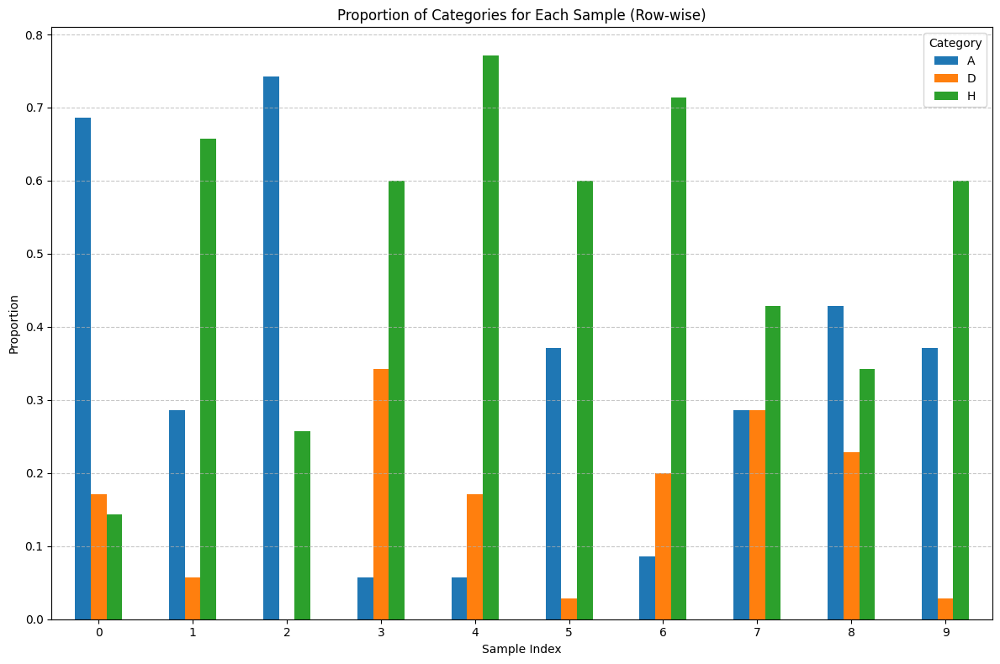

In [184]:
row_statistics.plot(kind='bar', figsize=(12, 8))
plt.title('Proportion of Categories for Each Sample (Row-wise)')
plt.xlabel('Sample Index')
plt.ylabel('Proportion')
plt.xticks(rotation=0)
plt.legend(title='Category')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

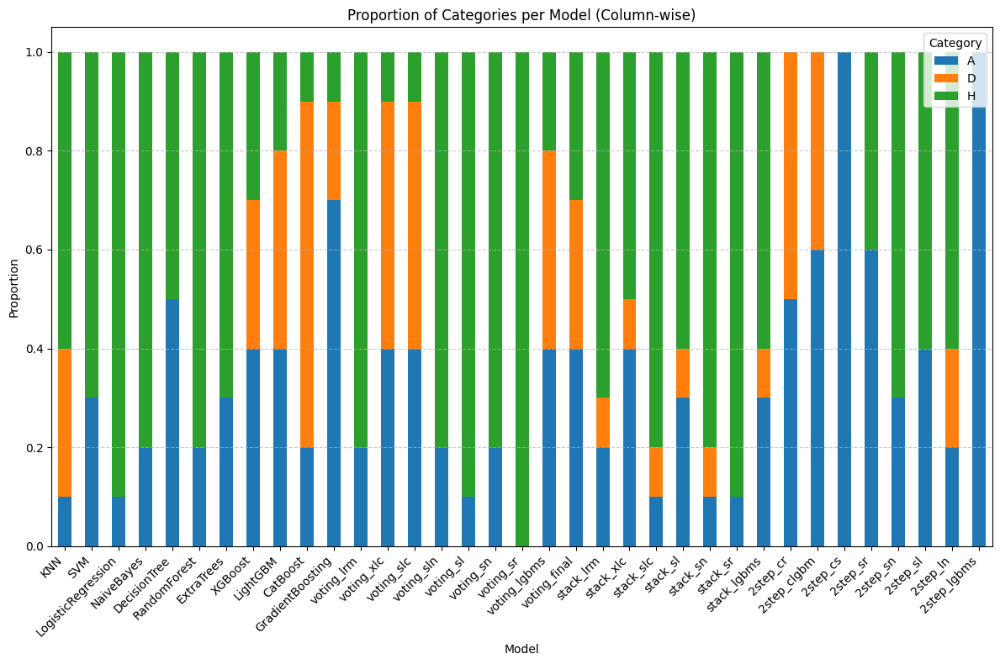

In [185]:
column_statistics.T.plot(kind='bar', stacked=True, figsize=(12, 8))
plt.title('Proportion of Categories per Model (Column-wise)')
plt.xlabel('Model')
plt.ylabel('Proportion')
plt.legend(title='Category')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

## 7.5 Final Prediction

In [186]:
submission = pd.read_csv(os.path.join(data_dir, 'sample-submission.csv'))

final_decision_models = ['voting_final']

final_predictions = test_results_df[final_decision_models]

# Fill the 'FTR' column in the submission DataFrame
submission['FTR'] = final_predictions

submission.to_csv(os.path.join(data_dir, 'submission.csv'))
submission

,Date,HomeTeam,AwayTeam,FTR
0,01-Feb-25,AFC Bournemouth,Liverpool,A
1,01-Feb-25,Arsenal,Man City,H
2,01-Feb-25,Brentford,Spurs,A
3,01-Feb-25,Chelsea,West Ham,D
4,01-Feb-25,Everton,Leicester City,H
5,01-Feb-25,Ipswich Town,Southampton,A
6,01-Feb-25,Man Utd,Crystal Palace,H
7,01-Feb-25,Newcastle,Fulham,D
8,01-Feb-25,Nottingham Forest,Brighton,D
9,01-Feb-25,Wolves,Aston Villa,A
